In [2]:
# general dependencies for Python and MNE (Python native fNIRS wavelet analysis)
import numpy as np
import pandas as pd
import mne
import os
from glob import glob
from itertools import compress
from tqdm import tqdm

In [3]:
#Python version
from platform import python_version
python_version()

'3.7.16'

In [4]:
#dependencies for PyCWT, another wavelet analysis package
import pycwt as wavelet
from pycwt.helpers import find

In [5]:
import io
from copy import copy
from collections import OrderedDict
import requests

In [6]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

In [14]:
# LCBD dependencies
# add relative path to our toolbox
import sys
sys.path.append('../../')
from LCBDtools.src import argParser
from LCBDtools.src import Plots

In [15]:
# Important configuration variables
study_dir = "data/NIRS_data_clean"
participant_num_len = 4 # default length of participant numbers
ex_subs = [] # any subjects to not include in the dataset

# set block durations (these are actually trial durations, an entire block was 4 trials, approx 480 seconds for each dyad)
durations = {
    'Block 1': 120,
    'Block 2': 120,
    'Block 3': 120}

In [16]:
# set the channels for each ROI
ROIs = {
    'Left Frontal': ['S3_D2 hbo', 'S4_D2 hbo'],
    'Right Frontal': ['S5_D3 hbo', 'S6_D3 hbo'],
    'Left Temporal': ['S1_D1 hbo', 'S2_D1 hbo', 'S2_D2 hbo'],
    'Right Temporal': ['S7_D3 hbo', 'S7_D4 hbo', 'S8_D4 hbo']}

In [17]:
# make a list of all matching session paths for each subject
#session_dirs = [d for d in glob(study_dir+"/*/*_fNIRS")]
session_dirs = [d for d in glob(study_dir + "/*/*") if d.endswith("-C") or d.endswith("-P")]


subjects = list(set([os.path.basename(d)[:participant_num_len] for d in session_dirs]))

In [18]:
session_dirs

['data/NIRS_data_clean/1264/1264-P',
 'data/NIRS_data_clean/1264/1264-C',
 'data/NIRS_data_clean/1263/1263-C',
 'data/NIRS_data_clean/1263/1263-P',
 'data/NIRS_data_clean/1255/1255-P',
 'data/NIRS_data_clean/1255/1255-C',
 'data/NIRS_data_clean/1252/1252-C',
 'data/NIRS_data_clean/1252/1252-P',
 'data/NIRS_data_clean/1239/1239-C',
 'data/NIRS_data_clean/1239/1239-P',
 'data/NIRS_data_clean/1237/1237-P',
 'data/NIRS_data_clean/1237/1237-C',
 'data/NIRS_data_clean/1253/1253-C',
 'data/NIRS_data_clean/1253/1253-P',
 'data/NIRS_data_clean/1254/1254-P',
 'data/NIRS_data_clean/1254/1254-C',
 'data/NIRS_data_clean/1265/1265-P',
 'data/NIRS_data_clean/1265/1265-C',
 'data/NIRS_data_clean/1231/1231-C',
 'data/NIRS_data_clean/1231/1231-P',
 'data/NIRS_data_clean/1236/1236-P',
 'data/NIRS_data_clean/1236/1236-C',
 'data/NIRS_data_clean/1209/1209-C',
 'data/NIRS_data_clean/1209/1209-P',
 'data/NIRS_data_clean/1200/1200-C',
 'data/NIRS_data_clean/1200/1200-P',
 'data/NIRS_data_clean/1207/1207-P',
 

In [19]:
len(session_dirs)

240

In [20]:
len(session_dirs)/2

120.0

In [21]:
for dyad_dir in list(set([os.path.split(ses)[0] 
                          for ses in session_dirs])):
    
    config_files = glob(os.path.join(dyad_dir, "*[CP]", "*config*"))
    print (config_files)
     

['data/NIRS_data_clean/1255/1255-P/NIRS-2022-12-16_001_config.txt', 'data/NIRS_data_clean/1255/1255-C/NIRS-2022-12-16_001_config.txt']
['data/NIRS_data_clean/1109/1109-P/NIRS-2022-01-21_001_config.txt', 'data/NIRS_data_clean/1109/1109-C/NIRS-2022-01-21_001_config.txt']
['data/NIRS_data_clean/1127/1127-P/NIRS-2022-03-13_001_config.txt', 'data/NIRS_data_clean/1127/1127-C/NIRS-2022-03-13_001_config.txt']
['data/NIRS_data_clean/1162/1162-P/NIRS-2022-08-01_001_config.txt', 'data/NIRS_data_clean/1162/1162-C/NIRS-2022-08-01_001_config.txt']
['data/NIRS_data_clean/1207/1207-P/NIRS-2022-04-02_001_config.txt', 'data/NIRS_data_clean/1207/1207-C/NIRS-2022-04-02_001_config.txt']
['data/NIRS_data_clean/1211/1211-P/NIRS-2022-03-29_001_config.txt', 'data/NIRS_data_clean/1211/1211-C/NIRS-2022-03-29_001_config.txt']
['data/NIRS_data_clean/1205/1205-P/NIRS-2022-04-24_001_config.txt', 'data/NIRS_data_clean/1205/1205-C/NIRS-2022-04-24_001_config.txt']
['data/NIRS_data_clean/1137/1137-C/NIRS-2022-04-10_001_

In [22]:
# This line creates an empty list called scans where all the loaded scans will be stored.
scans = []

# This line loops over all the unique parent directories (dyads) of the session directories
for dyad_dir in list(set([os.path.split(ses)[0] for ses in session_dirs])):
    try:
        
        # This line extracts the participant number (specified by the variable participant_num_len) 
        # from the basename of the parent directory.
        sub = os.path.basename(dyad_dir)[:participant_num_len]
        visit = os.path.basename(dyad_dir)

        # determining whether sub is Child or Parent can be done by reading the config file in the .nirx directory 
        # This line searches for config files in the parent directory that contain either "C" or "P" in their names.
        config_files = glob(os.path.join(dyad_dir, "*[CP]", "*config*"))
        
        # open the file and read the line with Subject= in it
        for config in config_files:
            # This line opens the config file and assigns it to the variable f.
            with open(config, 'r') as f:
                # This line reads the next line of the file using the readline() method
                # and stores it in a variable called line.
                line = f.readline()
                # This line reads each line of the config file until a line containing the string "Subject=" is found.
                while "Subject=" not in line:
                    line = f.readline()
                # This line removes any leading or trailing whitespace from the line.
                line = line.strip()
                # This line removes the string "Subject=" from the line.
                line = line.replace("Subject=", "")
                
                # if the line is 1 it's the child
                if line == "1":
                    sub1 = os.path.dirname(config) # child
                elif line == "2":
                    sub2 = os.path.dirname(config) # parent
                    
        # make sure it has 'modern' .evt files??? 
        evts = glob(sub1 + "/*.evt")
        if len(evts) != 2:
            print("There should be 2 evt files. Skipping:", os.path.basename(sub1))
            continue

        # These lines load the fNIRS data for the child and parent, 
        # respectively, using the mne.io.read_raw_nirx function from MNE-Python.
        fnirs_participant_1 = mne.io.read_raw_nirx(sub1, preload=False, verbose="warning") # child
        fnirs_participant_1.info['subject_info']['his_id'] = f"{sub[:participant_num_len]}c"
        
        fnirs_participant_2 = mne.io.read_raw_nirx(sub2, preload=False, verbose="warning") # parent
        fnirs_participant_2.info['subject_info']['his_id'] = f"{sub[:participant_num_len]}p"
        
        # This line appends a tuple containing the fNIRS data for the child and parent to the scans list.
        scans.append((fnirs_participant_1, fnirs_participant_2))
        
    # If any errors occur during the loading of the fNIRS data for a session, 
    #this code will print a message indicating that the session is being skipped and continue to the next session.
    except:
        print("skipping session:", dyad_dir)
        continue

There should be 2 evt files. Skipping: 1109-C
There should be 2 evt files. Skipping: 1102-C


/var/folders/bj/k48c5pg95p3f66x8j20kgs2sf68j1h/T/ipykernel_94266/2602704431.py:46: RuntimeWarning: A single dat file was expected in the specified path, but got 0. This may indicate that the file structure has been modified since the measurement was saved.
  fnirs_participant_1 = mne.io.read_raw_nirx(sub1, preload=False, verbose="warning") # child
/var/folders/bj/k48c5pg95p3f66x8j20kgs2sf68j1h/T/ipykernel_94266/2602704431.py:49: RuntimeWarning: A single dat file was expected in the specified path, but got 0. This may indicate that the file structure has been modified since the measurement was saved.
  fnirs_participant_2 = mne.io.read_raw_nirx(sub2, preload=False, verbose="warning") # parent
/var/folders/bj/k48c5pg95p3f66x8j20kgs2sf68j1h/T/ipykernel_94266/2602704431.py:49: RuntimeWarning: A single dat file was expected in the specified path, but got 0. This may indicate that the file structure has been modified since the measurement was saved.
  fnirs_participant_2 = mne.io.read_raw_ni

There should be 2 evt files. Skipping: 1103-C
There should be 2 evt files. Skipping: 1112-C
There should be 2 evt files. Skipping: 1104-C


/var/folders/bj/k48c5pg95p3f66x8j20kgs2sf68j1h/T/ipykernel_94266/2602704431.py:46: RuntimeWarning: Omitted 14 annotation(s) that were outside data range.
  fnirs_participant_1 = mne.io.read_raw_nirx(sub1, preload=False, verbose="warning") # child
/var/folders/bj/k48c5pg95p3f66x8j20kgs2sf68j1h/T/ipykernel_94266/2602704431.py:49: RuntimeWarning: Omitted 14 annotation(s) that were outside data range.
  fnirs_participant_2 = mne.io.read_raw_nirx(sub2, preload=False, verbose="warning") # parent


There should be 2 evt files. Skipping: 1243-C


/var/folders/bj/k48c5pg95p3f66x8j20kgs2sf68j1h/T/ipykernel_94266/2602704431.py:46: RuntimeWarning: Omitted 8 annotation(s) that were outside data range.
  fnirs_participant_1 = mne.io.read_raw_nirx(sub1, preload=False, verbose="warning") # child
/var/folders/bj/k48c5pg95p3f66x8j20kgs2sf68j1h/T/ipykernel_94266/2602704431.py:49: RuntimeWarning: Omitted 8 annotation(s) that were outside data range.
  fnirs_participant_2 = mne.io.read_raw_nirx(sub2, preload=False, verbose="warning") # parent
/var/folders/bj/k48c5pg95p3f66x8j20kgs2sf68j1h/T/ipykernel_94266/2602704431.py:46: RuntimeWarning: Omitted 16 annotation(s) that were outside data range.
  fnirs_participant_1 = mne.io.read_raw_nirx(sub1, preload=False, verbose="warning") # child
/var/folders/bj/k48c5pg95p3f66x8j20kgs2sf68j1h/T/ipykernel_94266/2602704431.py:49: RuntimeWarning: Omitted 16 annotation(s) that were outside data range.
  fnirs_participant_2 = mne.io.read_raw_nirx(sub2, preload=False, verbose="warning") # parent
/var/folders

In [23]:
scans

[(<RawNIRX | 1255-C, 20 x 15331 (1962.2 s), ~31 kB, data not loaded>,
  <RawNIRX | 1255-P, 20 x 15331 (1962.2 s), ~31 kB, data not loaded>),
 (<RawNIRX | 1127-C, 20 x 14347 (1836.3 s), ~31 kB, data not loaded>,
  <RawNIRX | 1127-P, 20 x 14347 (1836.3 s), ~31 kB, data not loaded>),
 (<RawNIRX | 1162-C, 20 x 15255 (1952.5 s), ~31 kB, data not loaded>,
  <RawNIRX | 1162-P, 20 x 15255 (1952.5 s), ~31 kB, data not loaded>),
 (<RawNIRX | 1207-C, 20 x 15701 (2009.6 s), ~31 kB, data not loaded>,
  <RawNIRX | 1207-P, 20 x 15701 (2009.6 s), ~31 kB, data not loaded>),
 (<RawNIRX | 1211-C, 20 x 17287 (2212.6 s), ~31 kB, data not loaded>,
  <RawNIRX | 1211-P, 20 x 17287 (2212.6 s), ~31 kB, data not loaded>),
 (<RawNIRX | 1205-C, 20 x 15070 (1928.8 s), ~31 kB, data not loaded>,
  <RawNIRX | 1205-P, 20 x 15070 (1928.8 s), ~31 kB, data not loaded>),
 (<RawNIRX | 1137-C, 20 x 14001 (1792.0 s), ~31 kB, data not loaded>,
  <RawNIRX | 1137-P, 20 x 14001 (1792.0 s), ~31 kB, data not loaded>),
 (<RawNIRX | 

The number of dyads in this sample is:

In [24]:
len(scans)

114

In [25]:
#Basic identifying information for sample (first number sets the dyad, second number allows you to choose child (0) or parent(1))
scans[7][0]

<RawNIRX | 1252-C, 20 x 15993 (2047.0 s), ~31 kB, data not loaded>

In [26]:
# sets X value for data - gives data as an array below to be used later
X = scans[0][0].get_data()

In [27]:
# finds time index
t = scans[0][0].times

In [28]:
scans[0][0].ch_names

['S1_D1 760',
 'S1_D1 850',
 'S2_D1 760',
 'S2_D1 850',
 'S2_D2 760',
 'S2_D2 850',
 'S3_D2 760',
 'S3_D2 850',
 'S4_D2 760',
 'S4_D2 850',
 'S5_D3 760',
 'S5_D3 850',
 'S6_D3 760',
 'S6_D3 850',
 'S7_D3 760',
 'S7_D3 850',
 'S7_D4 760',
 'S7_D4 850',
 'S8_D4 760',
 'S8_D4 850']

In [29]:
scans[63][0].info['subject_info']

{'his_id': '1148c',
 'first_name': '1148-Child\\0A\\0A1148-Child',
 'sex': 0 (FIFFV_SUBJ_SEX_UNKNOWN),
 'birthday': (2022, 5, 21)}

In [30]:
#When you initially check annotations, you will notice a large number of STOP annotations (12 in our case) that needed to be removed
scans[0][0].annotations

<Annotations | 24 segments: 1.0 (4), 128.0 (12), 2.0 (4), 4.0 (4)>

In [31]:
#if annotations don't match across subjects, need to check the evt files for consistency, run a event conversion script for the data
for scan in scans:
    print(scan[0].info['subject_info']['his_id'],scan[0].annotations)


1255c <Annotations | 24 segments: 1.0 (4), 128.0 (12), 2.0 (4), 4.0 (4)>
1127c <Annotations | 24 segments: 1.0 (4), 128.0 (12), 2.0 (4), 4.0 (4)>
1162c <Annotations | 24 segments: 1.0 (4), 128.0 (12), 2.0 (4), 4.0 (4)>
1207c <Annotations | 24 segments: 1.0 (4), 128.0 (12), 2.0 (4), 4.0 (4)>
1211c <Annotations | 24 segments: 1.0 (4), 128.0 (12), 2.0 (4), 4.0 (4)>
1205c <Annotations | 24 segments: 1.0 (4), 128.0 (12), 2.0 (4), 4.0 (4)>
1137c <Annotations | 24 segments: 1.0 (4), 128.0 (12), 2.0 (4), 4.0 (4)>
1252c <Annotations | 24 segments: 1.0 (4), 128.0 (12), 2.0 (4), 4.0 (4)>
1213c <Annotations | 24 segments: 1.0 (4), 128.0 (12), 2.0 (4), 4.0 (4)>
1220c <Annotations | 24 segments: 1.0 (4), 128.0 (12), 2.0 (4), 4.0 (4)>
1133c <Annotations | 24 segments: 1.0 (4), 128.0 (12), 2.0 (4), 4.0 (4)>
1126c <Annotations | 24 segments: 1.0 (4), 128.0 (12), 2.0 (4), 4.0 (4)>
1231c <Annotations | 24 segments: 1.0 (4), 128.0 (12), 2.0 (4), 4.0 (4)>
1244c <Annotations | 24 segments: 1.0 (4), 128.0 (1

In [32]:
# rename events and set durations for all blocks

# if we can't load in the annotations right, we'll remove them from our list of scans
bads = []

for i, dscan in enumerate(scans):
    
    try:
        for scan in dscan:

            # rename the binary annotations with actual names
            scan.annotations.rename({
                '1.0': 'Block 1',
                '2.0': 'Block 2',
                '4.0': 'Block 3'})

            # remove any STOP annotations
            scan.annotations.delete(scan.annotations.description == '128.0')

            # set the durations based off the durations dictionary
            scan.annotations.set_durations(durations, verbose=True)
    
    except:
        bads.append(i)
        
for i in sorted(bads, reverse=True):
    del scans[i]

In [33]:
#stop durations are now removed and Blocks are now named correctly
scans[0][0].annotations

<Annotations | 12 segments: Block 1 (4), Block 2 (4), Block 3 (4)>

In [34]:
from typing import Union

# function to do Continuous Wavelet Transform on a single signal
def mne_wavelet_transform(sig1: [mne.io.Raw, mne.Epochs], plot: bool = True,
                      chs: Union[str] = None):
    """
    Perform a continuous wavelet transform based off data in mne Raw object
    """
    
    # set time ##t0 = start time and dt = distance in time from t0. N is length
    t0 = sig1.times[0]
    dt = sig1.times[1] - t0
    N = len(sig1.times)
#     t = np.arange(0, N) * dt + t0
    t = sig1.times
    
    # define wavelet analysis parameters ## Clayton Add reference for parameters? 
    mother = wavelet.Morlet(6)
    s0 = 2 * dt # starting scale, in this case 2 * 0.128 s = 0.256 s
    dj = 1 / 12 # twelve sub-octaves per octaves
    J = 10 / dj # ten powers of 2 with dj sub-octaves
    
    if chs is None:
        chs = sig1.info['ch_names']
    
    for ch in chs:
        dat = np.squeeze(sig1.get_data(picks=[ch])) * 1e5
        
        # detrend and normalize the input data by its standard deviation
        p = np.polyfit(t - t0, dat, 1)
        dat_notrend = dat - np.polyval(p, t - t0)
        std = dat_notrend.std() # standard deviation
        var = std ** 2 # variance
        dat_norm = dat_notrend / std # normalized dataset
        
        alpha, _, _ = wavelet.ar1(dat) # lag-1 autocorrelation for red noise
        
        wave, scales, freqs, coi, fft, fftfreqs = wavelet.cwt(
            dat_norm, dt, dj, s0, J, mother)
        iwave = wavelet.icwt(wave, scales, dt, dj, mother) * std
    
        power = (np.abs(wave)) ** 2
        fft_power = np.abs(fft) ** 2
        period = 1 / freqs
        power /= scales[:, None] # optional according to Liu et al. (2007)
        
        # power significance test
        signif, fft_theor = wavelet.significance(
            1.0, dt, scales, 0, alpha,
            significance_level=0.95, 
            wavelet=mother)
        sig95 = np.ones([1, N]) * signif[:, None]
        sig95 = power / sig95
        
        # calculate global wavelet spectrum and determine its significance level
        glbl_power = power.mean(axis=1)
        dof = N - scales # correction for padding at edges
        glbl_signif, tmp = wavelet.significance(var, dt, scales, 1, alpha,
                                                significance_level=0.95, dof=dof,
                                                wavelet=mother)
        
        # calculate scale average and its significance level
        sel = find((period >= 10) & (period < 50))
        Cdelta = mother.cdelta
        scale_avg = (scales * np.ones((N, 1))).transpose()
        scale_avg = power / scale_avg # As in Torrence and Compo (1998) equation 24
        scale_avg = var * dj * dt / Cdelta * scale_avg[sel, :].sum(axis=0)
        scale_avg_signif, tmp = wavelet.significance(var, dt, scales, 2, alpha,
                                                    significance_level=0.95,
                                                    dof=[scales[sel[0]],
                                                        scales[sel[-1]]],
                                                    wavelet=mother)
        
        if plot is True:
            
            title = f"{sig1.info['subject_info']['his_id']} Channel {ch} Continuous Wavelet Transform"
            label = ""
            units = 'Absorbance Units (AU)'
            
            # prepare the figure
            plt.close('all')
            plt.ioff()
            figprops = dict(figsize=(11, 8), dpi=72)
            fig = plt.figure(**figprops)
            
            # first sub-plot, the original time series
            ax = plt.axes([0.1, 0.75, 0.65, 0.2])
            ax.plot(t, dat, 'k', linewidth=1.5)
            ax.set_title('a) {}'.format(title))
            ax.set_ylabel(r'{} [{}]'.format(label, units))
            
            # second sub-plot, the normalized wavelet power spectrum and significance
            # level contour lines and cone of influence hatched area. Note that period
            # scale is logarithmic
            bx = plt.axes([0.1, 0.37, 0.65, 0.28], sharex=ax)
            levels = [0.0625, 0.125, 0.25, 0.5, 1, 2, 4, 8, 16]
            conmap = bx.contourf(t, np.log2(period), np.log2(power), np.log2(levels), 
                        extend='both', cmap=plt.cm.jet)
#             plt.colorbar(conmap)
            extent = [t.min(), t.max(), 0, max(period)]
            bx.contour(t, np.log2(period), sig95, [-99, 1], colors='k', linewidths=2,
                                  extent=extent)
            bx.fill(np.concatenate([t, t[-1:] + dt, t[-1:] + dt,
                                   t[:1] - dt, t[:1] - dt]),
                    np.concatenate([np.log2(coi), [1e-9], np.log2(period[-1:]),
                                    np.log2(period[-1:]), [1e-9]]),
                    'k', alpha=0.3, hatch='x')
            bx.set_title('b) {} Wavelet Power Spectrum ({})'.format(label, mother.name))
            bx.set_ylabel('Frequency (Hz)')
            
            Yticks = 2 ** np.arange(np.ceil(np.log2(period.min())),
                                    np.ceil(np.log2(period.max())))
            
            bx.set_yticks(np.log2(Yticks))
            bx.set_yticklabels(1/Yticks)
            
            # third sub-plot, the global wavelet and Fourier power spectra and theoretical
            # noise spectra. Note that period scale is logarithmic
            cx = plt.axes([0.77, 0.37, 0.2, 0.28], sharey=bx)
            cx.plot(glbl_signif, np.log2(period), 'k--')
            cx.plot(var * fft_theor, np.log2(period), '--', color='#cccccc')
            cx.plot(var * fft_power, np.log2(1./fftfreqs), '-', color='#cccccc',
                    linewidth=1.)
            cx.plot(var * glbl_power, np.log2(period), 'k-', linewidth=1.5)
            cx.set_title('c) Global Wavelet Spectrum')
            cx.set_xlabel(r'Power [({})^2]'.format(units))
            cx.set_xlim([0, glbl_power.max() + var])
            cx.set_ylim(np.log2([period.min(), period.max()]))
            cx.set_yticks(np.log2(Yticks))
            cx.set_yticklabels(1/Yticks)
            plt.setp(cx.get_yticklabels(), visible=False)
            
            # Fourth sub-plot, the scale averaged wavelet spectrum.
            dx = plt.axes([0.1, 0.07, 0.65, 0.2], sharex=ax)
            dx.axhline(scale_avg_signif, color='k', linestyle='--', linewidth=1.)
            dx.plot(t, scale_avg, 'k-', linewidth=1.5)
            dx.set_title('d) {}--{} second scale-averaged power'.format(2, 8))
            dx.set_xlabel('Time (seconds)')
            dx.set_ylabel(r'Average variance [{}]'.format(units))
            ax.set_xlim([t.min(), t.max()])

            plt.show()
    
    return wave, scales, freqs, coi, fft, fftfreqs


# function to do wavelet coherence transform on 2 signals
def mne_wavelet_coherence_transform(sig1: [mne.io.Raw, mne.Epochs],
        sig2: [mne.io.Raw, mne.Epochs],
        plot: bool = True, fig_fname: str = None,
        chs: Union[str] = None):
    
    t0 = sig1.times[0]
    dt = sig1.times[1] - t0
    N = len(sig1.times)
#     t = np.arange(0, N) * dt + t0
    t = sig1.times
    
    # define wavelet analysis parameters
    mother = wavelet.Morlet(6)
    s0 = 2 * dt # starting scale, in this case 2 * 0.128 s = 0.256 s
    dj = 1 / 12 # twelve sub-octaves per octaves
    J = 10 / dj # ten powers of 2 with dj sub-octaves
    
    if chs is None:
        chs = sig1.info['ch_names']
        
    for ch in chs:
        dat1 = np.squeeze(sig1.get_data(picks=[ch]))
        dat2 = np.squeeze(sig2.get_data(picks=[ch]))
        
        if np.isnan(dat1).any():
            print("Dat 1 contains NaN values")
            raise ValueError
            
        if np.isnan(dat2).any():
            print("Dat 2 contains NaN values")
            raise ValueError
        
        # detrend and normalize the input data by its standard deviation
        p1 = np.polyfit(t - t0, dat1, 1)
        dat_notrend1 = dat1 - np.polyval(p1, t - t0)
        std1 = dat_notrend1.std() # standard deviation
        var1 = std1 ** 2 # variance
        dat_norm1 = dat_notrend1 / std1 # normalized dataset
        
        # detrend and normalize the input data by its standard deviation
        p2 = np.polyfit(t - t0, dat2, 1)
        dat_notrend2 = dat2 - np.polyval(p2, t - t0)
        std2 = dat_notrend2.std() # standard deviation
        var2 = std2 ** 2 # variance
        dat_norm2 = dat_notrend2 / std2 # normalized dataset
        
        WCT, aWCT, coi, freqs, sig95 = wavelet.wct(
            dat_norm1, dat_norm2,
            dt, dj=dj, s0=s0, J=J, sig=False,
            significance_level=0.95, wavelet='morlet',
            normalize=True)
        
        period = 1 / freqs
        
        if plot is True:
            
            title = f"{sig1.info['subject_info']['his_id']} / {sig2.info['subject_info']['his_id']} Channel {ch} Wavelet Coherence Transform"
            label = f"{sig1.info['subject_info']['his_id']} {sig2.info['subject_info']['his_id']} {ch}"
            units = 'Absorbance Units (AU)'
            
            # prepare the figure
            plt.close('all')
            plt.ioff()
            figprops = dict(figsize=(11, 8), dpi=72)
            fig = plt.figure(**figprops)
            
            # first sub-plot, the normalized wavelet power spectrum and significance
            # level contour lines and cone of influence hatched area. Note that period
            # scale is logarithmic
            ax = plt.axes([0.1, 0.37, 0.65, 0.28])
#             levels = [0.0625, 0.125, 0.25, 0.5, 1, 2, 4, 8, 16]
            levels = list(np.arange(0.1, 1, step=0.1))
            conmap = ax.contourf(t, np.log2(period), WCT, levels, 
                        extend='both', cmap=plt.cm.jet)
            plt.colorbar(conmap)
            extent = [t.min(), t.max(), 0, max(period)]
#             ax.contour(t, np.log2(period), sig95, [-99, 1], colors='k', linewidths=2,
#                                   extent=extent)
            ax.fill(np.concatenate([t, t[-1:] + dt, t[-1:] + dt,
                                   t[:1] - dt, t[:1] - dt]),
                    np.concatenate([np.log2(coi), [1e-9], np.log2(period[-1:]),
                                    np.log2(period[-1:]), [1e-9]]),
                    'k', alpha=0.3, hatch='x')
            ax.set_title('b) {} Wavelet Coherence Spectrum ({})'.format(label, mother.name))
            ax.set_ylabel('Frequency (Hz)')
            
            Yticks = 2 ** np.arange(np.ceil(np.log2(period.min())),
                                    np.ceil(np.log2(period.max())))
            
            ax.set_yticks(np.log2(Yticks))
            ax.set_yticklabels(1/Yticks)
            ax.set_xlim([t.min(), t.max()])
            ax.set_ylim(np.log2([period.min(), period.max()]))
            
            if fig_fname is None:
                plt.show()
            else:
                plt.savefig(fig_fname)
            
    return WCT, aWCT, coi, freqs, sig95 

In [35]:
scans[32][0].ch_names

['S1_D1 760',
 'S1_D1 850',
 'S2_D1 760',
 'S2_D1 850',
 'S2_D2 760',
 'S2_D2 850',
 'S3_D2 760',
 'S3_D2 850',
 'S4_D2 760',
 'S4_D2 850',
 'S5_D3 760',
 'S5_D3 850',
 'S6_D3 760',
 'S6_D3 850',
 'S7_D3 760',
 'S7_D3 850',
 'S7_D4 760',
 'S7_D4 850',
 'S8_D4 760',
 'S8_D4 850']

Using matplotlib as 2D backend.


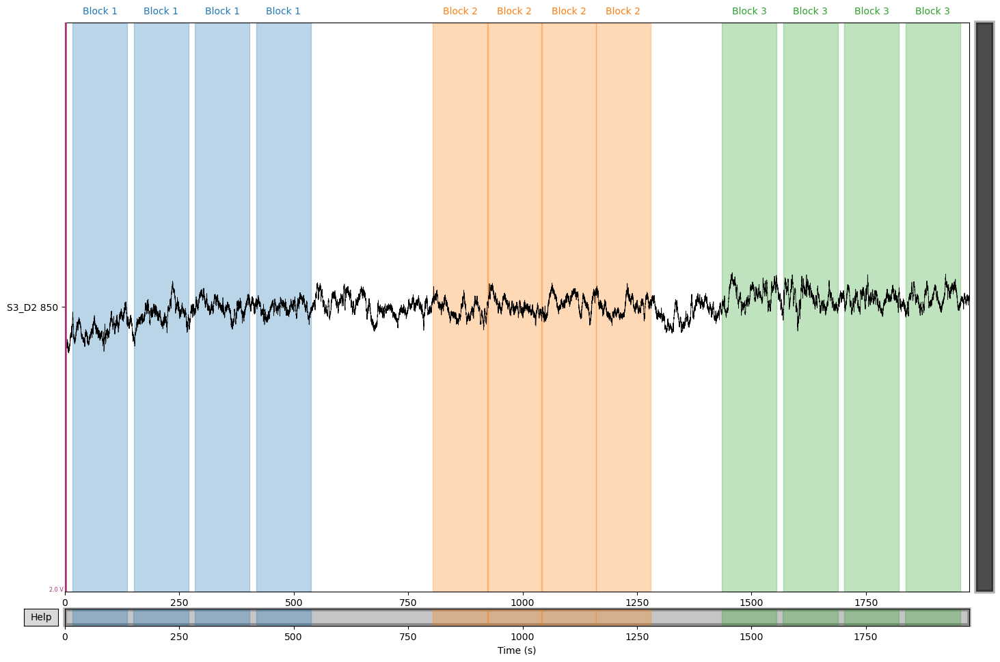

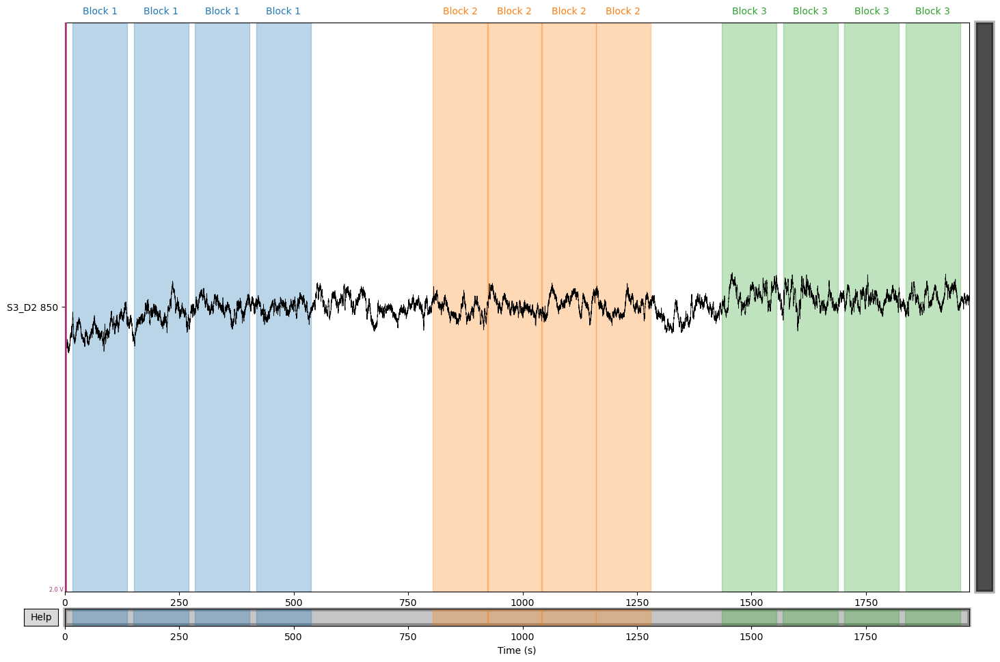

In [36]:
# example Block plot for 3000 seconds
scans[10][0].copy().pick(['S3_D2 850']).plot(duration=3000, scalings=1)

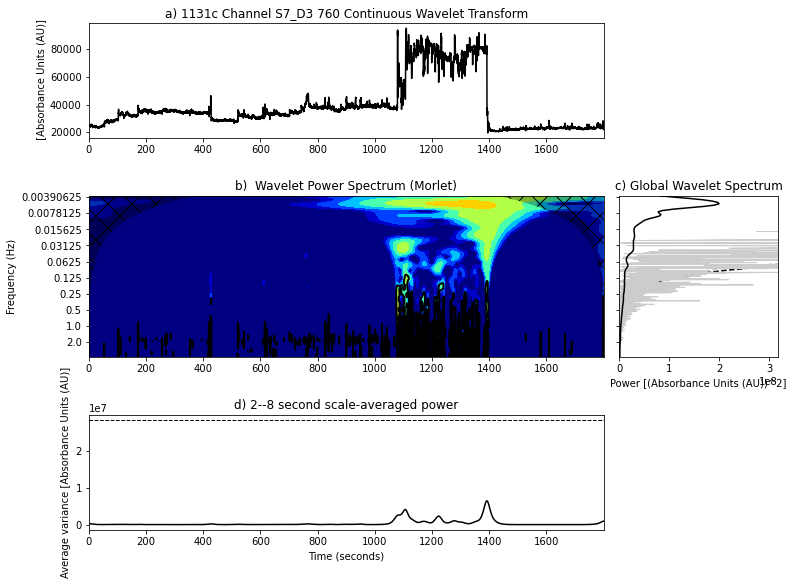

In [38]:
# example wavelet transform for 1800 seconds
wave, scales, freqs, coi, fft, fftfreqs = mne_wavelet_transform(
    scans[32][0].copy().crop(tmax=1800),
    plot=True,
    chs=['S7_D3 760']
)

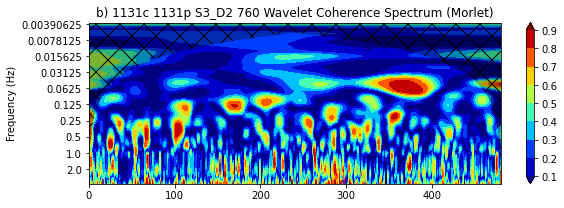

In [39]:
# example coherence transform from a real dyad with 400 seconds

WCT, aWCT, coi, freqs, sig95 = mne_wavelet_coherence_transform(
    scans[32][0].copy().pick(['S3_D2 760']).crop(tmax=480),
    scans[32][1].copy().pick(['S3_D2 760']).crop(tmax=480),
    plot=True)

# Preprocessing Step

Now that data are loaded in and events are correctly distinct, we iterate through each dyad and each individual scan to apply LCBD-standard preprocessing functions. 
- Convert to Optical Density
- Record Scalp-Coupling Index and Mark Channels < 0.5
- Temporal Derivative Distribution Repair
- Beer Lambert Law to Convert to Haemoglobin
- Bandpass Filter 0.01-0.5 Hz

and append those dyads to a list of preprocessed scans. 

In [40]:
# make a list where the preprocessed scans will go
pps = []

# for each dyad scan in scans
for dscan in scans:

    ppdscan = [] # make a list for the preprocessed dyad's scans
    
    # individually preprocess each subject in dyad
    for scan in dscan:
        
        # convert to optical density
        raw_od = mne.preprocessing.nirs.optical_density(scan)

        # scalp coupling index
        sci = mne.preprocessing.nirs.scalp_coupling_index(raw_od)
        raw_od.info['bads'] = list(compress(raw_od.ch_names, sci < 0.5))
        
        # linear detrend, par example
#         raw.data[:] = scipy.signal.detrend(raw.get_data(), axis=-1, fit='linear')

        #bad channel labelling
        if len(raw_od.info['bads']) > 0:
            print("--->>>>Bad channels in subject", raw_od.info['subject_info']['his_id'], ":", raw_od.info['bads'])
        
        # temporal derivative distribution repair (motion attempt)
        tddr_od = mne.preprocessing.nirs.tddr(raw_od)
#         print("tddr")
#         tddr_od.plot(
#             n_channels=len(tddr_od.ch_names),
#             scalings=0.1,
#             duration=100,
#             show_scrollbars=False)
        
        # savgol filter (linear polynomial smoothing)
#         sav_od = raw_od.savgol_filter(0.5)
#         print("savgol filtering")
#         sav_od.plot(
#             n_channels=len(sav_od.ch_names),
#             scalings=0.1,
#             duration=100,
#             show_scrollbars=False)

        #bandpass filtering
        bp_od = tddr_od.filter(0.01, 0.5)
#         print("bandpass")
#         bp_od.plot(
#             n_channels=len(bp_od.ch_names),
#             duration=100,
#             scalings=0.1,
#             show_scrollbars=False)
    
        # haemoglobin conversion
        haemo = mne.preprocessing.nirs.beer_lambert_law(bp_od, ppf=0.1)
#         print("haemo")
#         haemo.plot(
#             n_channels=len(haemo.ch_names),
#             duration=100,
#             scalings=0.0001,
#             show_scrollbars=False)

#         print("PSD")
#         haemo_lp.plot_psd(average=True)
        
        ppdscan.append(haemo)
        
    pps.append(ppdscan)

Reading 0 ... 15330  =      0.000 ...  1962.240 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15330  =      0.000 ...  1962.240 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14346  =      0.000 ...  1836.288 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1127c : ['S1_D1 760', 'S1_D1 850', 'S2_D1 760', 'S2_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14346  =      0.000 ...  1836.288 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15254  =      0.000 ...  1952.512 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1162c : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15254  =      0.000 ...  1952.512 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1162p : ['S7_D3 760', 'S7_D3 850', 'S7_D4 760', 'S7_D4 850', 'S8_D4 760', 'S8_D4 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15700  =      0.000 ...  2009.600 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15700  =      0.000 ...  2009.600 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1207p : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 17286  =      0.000 ...  2212.608 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 17286  =      0.000 ...  2212.608 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15069  =      0.000 ...  1928.832 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15069  =      0.000 ...  1928.832 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14000  =      0.000 ...  1792.000 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1137c : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14000  =      0.000 ...  1792.000 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1137p : ['S8_D4 760', 'S8_D4 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15992  =      0.000 ...  2046.976 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1252c : ['S3_D2 760', 'S3_D2 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15992  =      0.000 ...  2046.976 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14942  =      0.000 ...  1912.576 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14942  =      0.000 ...  1912.576 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15752  =      0.000 ...  2016.256 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15752  =      0.000 ...  2016.256 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15437  =      0.000 ...  1975.936 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1133c : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15437  =      0.000 ...  1975.936 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14391  =      0.000 ...  1842.048 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1126c : ['S2_D2 760', 'S2_D2 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14391  =      0.000 ...  1842.048 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14991  =      0.000 ...  1918.848 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14991  =      0.000 ...  1918.848 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1231p : ['S3_D2 760', 'S3_D2 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14539  =      0.000 ...  1860.992 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14539  =      0.000 ...  1860.992 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15497  =      0.000 ...  1983.616 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15497  =      0.000 ...  1983.616 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15369  =      0.000 ...  1967.232 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15369  =      0.000 ...  1967.232 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1186p : ['S2_D2 760', 'S2_D2 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15217  =      0.000 ...  1947.776 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15217  =      0.000 ...  1947.776 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16003  =      0.000 ...  2048.384 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16003  =      0.000 ...  2048.384 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14801  =      0.000 ...  1894.528 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1146c : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14801  =      0.000 ...  1894.528 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15844  =      0.000 ...  2028.032 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15844  =      0.000 ...  2028.032 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15387  =      0.000 ...  1969.536 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15387  =      0.000 ...  1969.536 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14326  =      0.000 ...  1833.728 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1194c : ['S2_D1 760', 'S2_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14326  =      0.000 ...  1833.728 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16728  =      0.000 ...  2141.184 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16728  =      0.000 ...  2141.184 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1182p : ['S3_D2 760', 'S3_D2 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15597  =      0.000 ...  1996.416 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15597  =      0.000 ...  1996.416 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14640  =      0.000 ...  1873.920 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14640  =      0.000 ...  1873.920 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14870  =      0.000 ...  1903.360 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1124c : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14870  =      0.000 ...  1903.360 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16020  =      0.000 ...  2050.560 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1151c : ['S7_D3 760', 'S7_D3 850', 'S7_D4 760', 'S7_D4 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16020  =      0.000 ...  2050.560 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15985  =      0.000 ...  2046.080 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1228c : ['S3_D2 760', 'S3_D2 850', 'S6_D3 760', 'S6_D3 850', 'S8_D4 760', 'S8_D4 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15985  =      0.000 ...  2046.080 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15840  =      0.000 ...  2027.520 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1167c : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15840  =      0.000 ...  2027.520 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1167p : ['S1_D1 760', 'S1_D1 850', 'S7_D4 760', 'S7_D4 850', 'S8_D4 760', 'S8_D4 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15211  =      0.000 ...  1947.008 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15211  =      0.000 ...  1947.008 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15084  =      0.000 ...  1930.752 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15084  =      0.000 ...  1930.752 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15366  =      0.000 ...  1966.848 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15366  =      0.000 ...  1966.848 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16246  =      0.000 ...  2079.488 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1131c : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16246  =      0.000 ...  2079.488 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14716  =      0.000 ...  1883.648 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14716  =      0.000 ...  1883.648 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14533  =      0.000 ...  1860.224 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1139c : ['S1_D1 760', 'S1_D1 850', 'S2_D1 760', 'S2_D1 850', 'S2_D2 760', 'S2_D2 850', 'S3_D2 760', 'S3_D2 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14533  =      0.000 ...  1860.224 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1139p : ['S8_D4 760', 'S8_D4 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14749  =      0.000 ...  1887.872 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14749  =      0.000 ...  1887.872 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14796  =      0.000 ...  1893.888 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1180c : ['S1_D1 760', 'S1_D1 850', 'S8_D4 760', 'S8_D4 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14796  =      0.000 ...  1893.888 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15670  =      0.000 ...  2005.760 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15670  =      0.000 ...  2005.760 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14664  =      0.000 ...  1876.992 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14664  =      0.000 ...  1876.992 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14888  =      0.000 ...  1905.664 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1117c : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14888  =      0.000 ...  1905.664 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1117p : ['S1_D1 760', 'S1_D1 850', 'S2_D1 760', 'S2_D1 850', 'S2_D2 760', 'S2_D2 850', 'S3_D2 760', 'S3_D2 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14738  =      0.000 ...  1886.464 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14738  =      0.000 ...  1886.464 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15325  =      0.000 ...  1961.600 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15325  =      0.000 ...  1961.600 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1254p : ['S6_D3 760', 'S6_D3 850', 'S8_D4 760', 'S8_D4 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 17643  =      0.000 ...  2258.304 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 17643  =      0.000 ...  2258.304 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15080  =      0.000 ...  1930.240 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15080  =      0.000 ...  1930.240 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14727  =      0.000 ...  1885.056 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14727  =      0.000 ...  1885.056 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14937  =      0.000 ...  1911.936 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14937  =      0.000 ...  1911.936 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16098  =      0.000 ...  2060.544 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16098  =      0.000 ...  2060.544 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1234p : ['S1_D1 760', 'S1_D1 850', 'S2_D2 760', 'S2_D2 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14399  =      0.000 ...  1843.072 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14399  =      0.000 ...  1843.072 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14539  =      0.000 ...  1860.992 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14539  =      0.000 ...  1860.992 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1172p : ['S1_D1 760', 'S1_D1 850', 'S2_D1 760', 'S2_D1 850', 'S4_D2 760', 'S4_D2 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14000  =      0.000 ...  1792.000 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14000  =      0.000 ...  1792.000 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1189p : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15527  =      0.000 ...  1987.456 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15527  =      0.000 ...  1987.456 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1178p : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15218  =      0.000 ...  1947.904 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15218  =      0.000 ...  1947.904 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14923  =      0.000 ...  1910.144 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14923  =      0.000 ...  1910.144 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15870  =      0.000 ...  2031.360 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15870  =      0.000 ...  2031.360 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14850  =      0.000 ...  1900.800 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1129c : ['S2_D2 760', 'S2_D2 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14850  =      0.000 ...  1900.800 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14154  =      0.000 ...  1811.712 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14154  =      0.000 ...  1811.712 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14561  =      0.000 ...  1863.808 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1122c : ['S7_D4 760', 'S7_D4 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14561  =      0.000 ...  1863.808 secs...


/var/folders/bj/k48c5pg95p3f66x8j20kgs2sf68j1h/T/ipykernel_94266/2844854310.py:13: RuntimeWarning: Negative intensities encountered. Setting to abs(x)
  raw_od = mne.preprocessing.nirs.optical_density(scan)
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14821  =      0.000 ...  1897.088 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14821  =      0.000 ...  1897.088 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1173p : ['S7_D3 760', 'S7_D3 850', 'S7_D4 760', 'S7_D4 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16162  =      0.000 ...  2068.736 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16162  =      0.000 ...  2068.736 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1216p : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14333  =      0.000 ...  1834.624 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1174c : ['S8_D4 760', 'S8_D4 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14333  =      0.000 ...  1834.624 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14091  =      0.000 ...  1803.648 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14091  =      0.000 ...  1803.648 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1164p : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15071  =      0.000 ...  1929.088 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1144c : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15071  =      0.000 ...  1929.088 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14134  =      0.000 ...  1809.152 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14134  =      0.000 ...  1809.152 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1148p : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15339  =      0.000 ...  1963.392 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15339  =      0.000 ...  1963.392 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1160p : ['S1_D1 760', 'S1_D1 850', 'S2_D1 760', 'S2_D1 850', 'S2_D2 760', 'S2_D2 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15419  =      0.000 ...  1973.632 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15419  =      0.000 ...  1973.632 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15507  =      0.000 ...  1984.896 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1193c : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15507  =      0.000 ...  1984.896 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15038  =      0.000 ...  1924.864 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15038  =      0.000 ...  1924.864 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1176p : ['S2_D2 760', 'S2_D2 850', 'S3_D2 760', 'S3_D2 850', 'S4_D2 760', 'S4_D2 850', 'S7_D4 760', 'S7_D4 850', 'S8_D4 760', 'S8_D4 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15132  =      0.000 ...  1936.896 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15132  =      0.000 ...  1936.896 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15261  =      0.000 ...  1953.408 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15261  =      0.000 ...  1953.408 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15396  =      0.000 ...  1970.688 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15396  =      0.000 ...  1970.688 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14850  =      0.000 ...  1900.800 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14850  =      0.000 ...  1900.800 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14943  =      0.000 ...  1912.704 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14943  =      0.000 ...  1912.704 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14539  =      0.000 ...  1860.992 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14539  =      0.000 ...  1860.992 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1149p : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14692  =      0.000 ...  1880.576 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14692  =      0.000 ...  1880.576 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1130p : ['S1_D1 760', 'S1_D1 850', 'S2_D1 760', 'S2_D1 850', 'S2_D2 760', 'S2_D2 850', 'S3_D2 760', 'S3_D2 850', 'S4_D2 760', 'S4_D2 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15434  =      0.000 ...  1975.552 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15434  =      0.000 ...  1975.552 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1251p : ['S1_D1 760', 'S1_D1 850', 'S8_D4 760', 'S8_D4 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15357  =      0.000 ...  1965.696 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15357  =      0.000 ...  1965.696 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15961  =      0.000 ...  2043.008 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15961  =      0.000 ...  2043.008 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1110p : ['S1_D1 760', 'S1_D1 850', 'S3_D2 760', 'S3_D2 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15431  =      0.000 ...  1975.168 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15431  =      0.000 ...  1975.168 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14851  =      0.000 ...  1900.928 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14851  =      0.000 ...  1900.928 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1159p : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15076  =      0.000 ...  1929.728 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1154c : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15076  =      0.000 ...  1929.728 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1154p : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14574  =      0.000 ...  1865.472 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14574  =      0.000 ...  1865.472 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15700  =      0.000 ...  2009.600 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15700  =      0.000 ...  2009.600 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16546  =      0.000 ...  2117.888 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16546  =      0.000 ...  2117.888 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14357  =      0.000 ...  1837.696 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14357  =      0.000 ...  1837.696 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15612  =      0.000 ...  1998.336 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15612  =      0.000 ...  1998.336 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15890  =      0.000 ...  2033.920 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15890  =      0.000 ...  2033.920 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15813  =      0.000 ...  2024.064 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1270c : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15813  =      0.000 ...  2024.064 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14629  =      0.000 ...  1872.512 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14629  =      0.000 ...  1872.512 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15079  =      0.000 ...  1930.112 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15079  =      0.000 ...  1930.112 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14844  =      0.000 ...  1900.032 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14844  =      0.000 ...  1900.032 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15516  =      0.000 ...  1986.048 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15516  =      0.000 ...  1986.048 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15047  =      0.000 ...  1926.016 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15047  =      0.000 ...  1926.016 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14707  =      0.000 ...  1882.496 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14707  =      0.000 ...  1882.496 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15524  =      0.000 ...  1987.072 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1115c : ['S1_D1 760', 'S1_D1 850', 'S2_D1 760', 'S2_D1 850', 'S2_D2 760', 'S2_D2 850', 'S3_D2 760', 'S3_D2 850', 'S4_D2 760', 'S4_D2 850', 'S5_D3 760', 'S5_D3 850', 'S6_D3 760', 'S6_D3 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15524  =      0.000 ...  1987.072 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1115p : ['S8_D4 760', 'S8_D4 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16941  =      0.000 ...  2168.448 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16941  =      0.000 ...  2168.448 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16976  =      0.000 ...  2172.928 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1168c : ['S2_D1 760', 'S2_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 16976  =      0.000 ...  2172.928 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15224  =      0.000 ...  1948.672 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15224  =      0.000 ...  1948.672 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15718  =      0.000 ...  2011.904 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15718  =      0.000 ...  2011.904 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15931  =      0.000 ...  2039.168 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15931  =      0.000 ...  2039.168 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15119  =      0.000 ...  1935.232 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15119  =      0.000 ...  1935.232 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1141p : ['S6_D3 760', 'S6_D3 850', 'S8_D4 760', 'S8_D4 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14994  =      0.000 ...  1919.232 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14994  =      0.000 ...  1919.232 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14821  =      0.000 ...  1897.088 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14821  =      0.000 ...  1897.088 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14600  =      0.000 ...  1868.800 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14600  =      0.000 ...  1868.800 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14555  =      0.000 ...  1863.040 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 14555  =      0.000 ...  1863.040 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1147p : ['S1_D1 760', 'S1_D1 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15912  =      0.000 ...  2036.736 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15912  =      0.000 ...  2036.736 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15447  =      0.000 ...  1977.216 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1250c : ['S6_D3 760', 'S6_D3 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15447  =      0.000 ...  1977.216 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15412  =      0.000 ...  1972.736 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 15412  =      0.000 ...  1972.736 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


--->>>>Bad channels in subject 1200p : ['S1_D1 760', 'S1_D1 850', 'S6_D3 760', 'S6_D3 850', 'S8_D4 760', 'S8_D4 850']
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 12557  =      0.000 ...  1607.296 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)

Reading 0 ... 12557  =      0.000 ...  1607.296 secs...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.5 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.50 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.50 Hz)
- Filter length: 2579 samples (330.112 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.0s finished


In [41]:
#Creating a dictionary variable to store bad channels for later
bad_channels_dict = {}

for dscan in pps:
    
    for scan in dscan:
        
        bads = scan.info['bads']
        bad_channels_dict[scan.info['subject_info']['his_id']] = \
            bads
        

In [42]:
bad_channels_dict['1121p']

[]

In [43]:
pps[7][0].info['subject_info']

{'his_id': '1252c',
 'first_name': '1252-child',
 'sex': 1 (FIFFV_SUBJ_SEX_MALE),
 'birthday': (2016, 12, 17)}

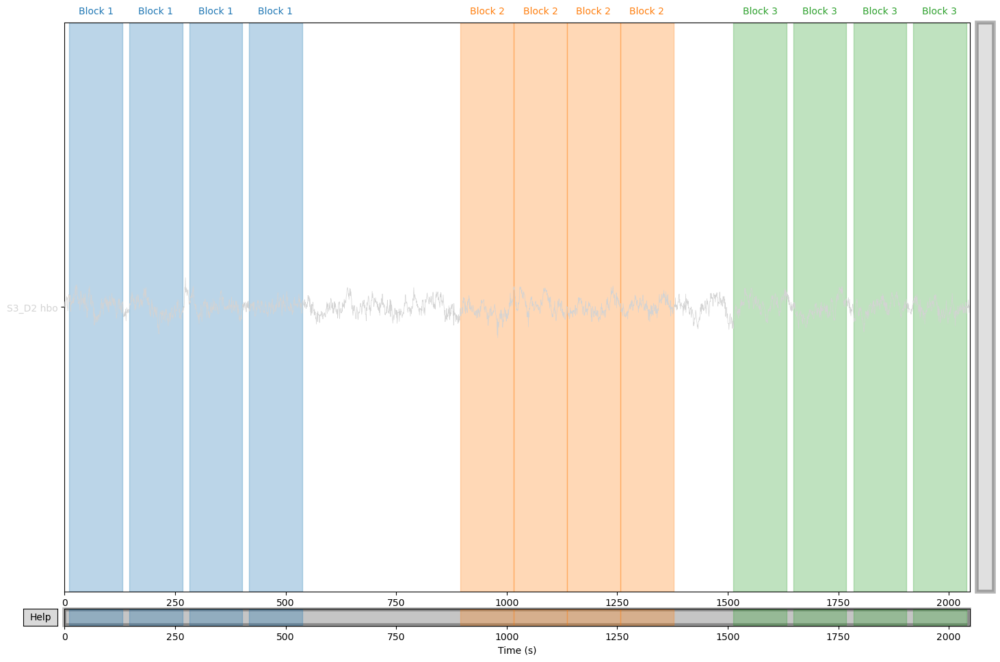

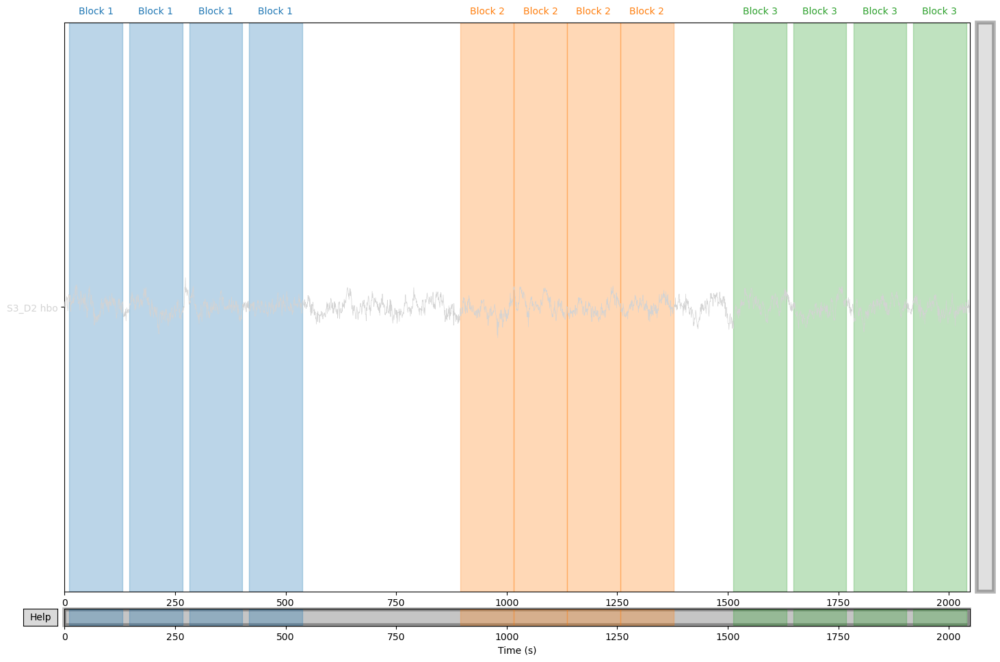

In [44]:
# example plot for 3000 seconds
pps[7][0].copy().pick(['S3_D2 hbo']).plot(duration=3000, scalings=0.001)

In [45]:
sampling_rate = pps[0][0].info['sfreq']
print(sampling_rate)

7.8125


In [46]:
# make a dictionary where all of the epoch'd data will go
epoch_df = {}

# loop over the dyads in the preprocessed list
for dscan in pps:
    
    # February 9th 2023
    # Clayton update to prune subjects who have
    # >= 10 channels dropped from the SCI function during preprocessing
    max_bad = max([len(scan.info['bads']) for scan in dscan])
    # whichever number is higher ^, num. of channels dropped in
    # either parent or child
    
    if max_bad >= 10:
        for scan in dscan:
            sub_num = scan.info['subject_info']['his_id']
            print("Subject {} was dropped from further analysis.".format(sub_num))
        
        continue # skip this dyad
        # if max_bad is greater than or equal to 10
    
    # for each scan in the dyad
    for scan in dscan:
    
        # set their location in the epoch df to a dictionary
        epoch_df[scan.info['subject_info']['his_id']] = {}
    
#        for i, ROI in enumerate(ROIs.keys()):

        # loop over ROIs (channels here)
        for i, ROI in enumerate([ch for ch in scan.info['ch_names'] if "hbo" in ch]):
            
            epoch_df[scan.info['subject_info']['his_id']][ROI] = []
        
            # get their events and set block durations
            events, event_dict = mne.events_from_annotations(dscan[0], verbose=False)
            reject_criteria = dict(hbo=200e-6)
            tmin, puzzletmax, playtmax = -5, 105, 120
            
            # use the mne.Epochs function / object to generate epochs
            preplay_epochs = mne.Epochs(
                scan, # the scan object
                events, # its events
#                 picks=ROIs[ROI],
                picks=[ROI], # the channels
                event_id={list(event_dict.keys())[0]: list(event_dict.values())[0]}, # the first event key
                tmin=tmin, # epoch relative start time
                tmax=playtmax, # epoch relative end time
                baseline= (None, 0), # baseline window to subtract
#                 reject=reject_criteria,
                reject_by_annotation=True,
                detrend=1, # linear detrend
                verbose=False, 
                preload=False, # don't actually load it yet (saves memory)
                event_repeated='merge')
            
            epoch_df[scan.info['subject_info']['his_id']][ROI].append(preplay_epochs)
            
            puzzle_epochs = mne.Epochs(
                scan,
                events,
#                 picks=ROIs[ROI],
                picks=[ROI],
                event_id={list(event_dict.keys())[1]: list(event_dict.values())[1]},
                tmin=tmin,
                tmax=puzzletmax,
                baseline= (None, 0),
#                 reject=reject_criteria,
                reject_by_annotation=True,
                detrend=1,
                verbose=False,
                preload=False,
                event_repeated='merge')
            
            epoch_df[scan.info['subject_info']['his_id']][ROI].append(puzzle_epochs)
            
            postplay_epochs = mne.Epochs(
                scan,
                events,
#                 picks=ROIs[ROI],
                picks=[ROI],
                event_id={list(event_dict.keys())[2]: list(event_dict.values())[2]},
                tmin=tmin,
                tmax=playtmax,
                baseline=(None, 0),
#                 reject=reject_criteria,
                reject_by_annotation=True,
                detrend=1,
                verbose=False,
                preload=False,
                event_repeated='merge')
            
            epoch_df[scan.info['subject_info']['his_id']][ROI].append(postplay_epochs)

Subject 1176c was dropped from further analysis.
Subject 1176p was dropped from further analysis.
Subject 1130c was dropped from further analysis.
Subject 1130p was dropped from further analysis.
Subject 1115c was dropped from further analysis.
Subject 1115p was dropped from further analysis.


In [47]:
# here is the way to access information in the epoch dictionary

In [48]:
#Will telll you how many dyads are retaining for further analyses
len([sub for sub in epoch_df.keys() if "c" in sub])

105

In [49]:
# a single subject 
epoch_df['1200c']

{'S1_D1 hbo': [<Epochs |  4 events (good & bad), -4.992 - 120.064 sec, baseline -4.992 – 0 sec, ~13 kB, data not loaded,
   'Block 1': 4>,
  <Epochs |  4 events (good & bad), -4.992 - 104.96 sec, baseline -4.992 – 0 sec, ~13 kB, data not loaded,
   'Block 2': 4>,
  <Epochs |  4 events (good & bad), -4.992 - 120.064 sec, baseline -4.992 – 0 sec, ~13 kB, data not loaded,
   'Block 3': 4>],
 'S2_D1 hbo': [<Epochs |  4 events (good & bad), -4.992 - 120.064 sec, baseline -4.992 – 0 sec, ~13 kB, data not loaded,
   'Block 1': 4>,
  <Epochs |  4 events (good & bad), -4.992 - 104.96 sec, baseline -4.992 – 0 sec, ~13 kB, data not loaded,
   'Block 2': 4>,
  <Epochs |  4 events (good & bad), -4.992 - 120.064 sec, baseline -4.992 – 0 sec, ~13 kB, data not loaded,
   'Block 3': 4>],
 'S2_D2 hbo': [<Epochs |  4 events (good & bad), -4.992 - 120.064 sec, baseline -4.992 – 0 sec, ~13 kB, data not loaded,
   'Block 1': 4>,
  <Epochs |  4 events (good & bad), -4.992 - 104.96 sec, baseline -4.992 – 0 se

In [50]:
# a specific channel from the subject
epoch_df['1200c']['S1_D1 hbo']

[<Epochs |  4 events (good & bad), -4.992 - 120.064 sec, baseline -4.992 – 0 sec, ~13 kB, data not loaded,
  'Block 1': 4>,
 <Epochs |  4 events (good & bad), -4.992 - 104.96 sec, baseline -4.992 – 0 sec, ~13 kB, data not loaded,
  'Block 2': 4>,
 <Epochs |  4 events (good & bad), -4.992 - 120.064 sec, baseline -4.992 – 0 sec, ~13 kB, data not loaded,
  'Block 3': 4>]

In [51]:
# a specific block at that subject / channel, in this case the first (0) is pre-play
epoch_df['1202c']['S1_D1 hbo'][0]

Number of events,4
Events,Block 1: 4
Time range,-4.992 – 120.064 sec
Baseline,-4.992 – 0.000 sec


In [52]:
# a specific iteration/trial of that block at that subject / channel, in this case the first (0) is pre-play, we look at the 4th (3) iteration of the block
epoch_df['1202c']['S1_D1 hbo'][0][3]

Number of events,1
Events,Block 1: 1
Time range,-4.992 – 120.064 sec
Baseline,-4.992 – 0.000 sec


In [53]:
event_dict

{'Block 1': 1, 'Block 2': 2, 'Block 3': 3}

Using data from preloaded Raw for 1 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 1 events and 978 original time points ...
0 bad epochs dropped


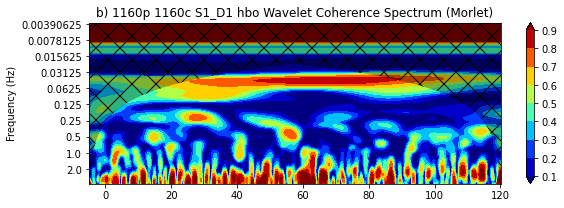

Using data from preloaded Raw for 1 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 1 events and 978 original time points ...
0 bad epochs dropped


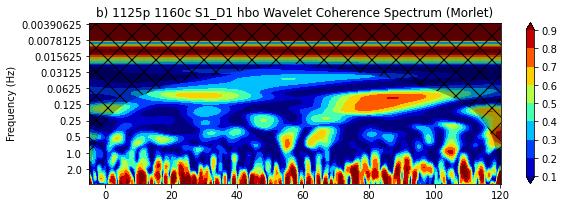

In [54]:
# example WCT between a real dyad, puzzle block (1), iteration/trial 0 (0)
WCT, aWCT, coi, freqs, sig95 = mne_wavelet_coherence_transform(
    epoch_df['1160p']['S1_D1 hbo'][2][3].copy(),
    epoch_df['1160c']['S1_D1 hbo'][2][3].copy(),
    plot=True)

# same WCT but a random false dyad
WCT, aWCT, coi, freqs, sig95 = mne_wavelet_coherence_transform(
    epoch_df['1125p']['S1_D1 hbo'][2][3].copy(),
    epoch_df['1160c']['S1_D1 hbo'][2][3].copy(),
    plot=True)

In [55]:
# list out all the subjects in the epoch df
epoch_df.keys()

dict_keys(['1255c', '1255p', '1127c', '1127p', '1162c', '1162p', '1207c', '1207p', '1211c', '1211p', '1205c', '1205p', '1137c', '1137p', '1252c', '1252p', '1213c', '1213p', '1220c', '1220p', '1133c', '1133p', '1126c', '1126p', '1231c', '1231p', '1244c', '1244p', '1232c', '1232p', '1186c', '1186p', '1113c', '1113p', '1202c', '1202p', '1146c', '1146p', '1187c', '1187p', '1214c', '1214p', '1194c', '1194p', '1182c', '1182p', '1185c', '1185p', '1258c', '1258p', '1124c', '1124p', '1151c', '1151p', '1228c', '1228p', '1167c', '1167p', '1204c', '1204p', '1179c', '1179p', '1175c', '1175p', '1131c', '1131p', '1246c', '1246p', '1139c', '1139p', '1266c', '1266p', '1180c', '1180p', '1269c', '1269p', '1116c', '1116p', '1117c', '1117p', '1145c', '1145p', '1254c', '1254p', '1203c', '1203p', '1223c', '1223p', '1268c', '1268p', '1236c', '1236p', '1234c', '1234p', '1226c', '1226p', '1172c', '1172p', '1189c', '1189p', '1178c', '1178p', '1253c', '1253p', '1248c', '1248p', '1134c', '1134p', '1129c', '1129p',

In [56]:
# delete things we don't need anymore to save memory (ONLY RUN THIS IF YOU NEED TO CONDUCT A NEW PERMUTATION ANALYSIS)
del scans
del pps

In [57]:
import random

In [58]:
# ATTENTION READ THE FOLLOWING COMMENT CAREFULLY BEFORE PROCEEDING

In [59]:
# for each parent

    # real kid's synchrony value
    
    # 80 false dyad synchrony values
    
    # 

In [60]:
# make a new dictionary where the synchrony values will be stored
sync_df = {}
block_types = ['Block 1', 'Block 2', 'Block 3']
perm_df = {}

# THIS TAKES A REALLY LONG TIME TO COMPUTE. AROUND 14 HOURS ON A DECENT NETWORK
# SKIP DOWN TO USE THE SAVED VERSIONS!

#real vs single false dyad test of a myriad of real and fake dyad pairs

# for every parent subject
for parent in tqdm([sub for sub in sorted(epoch_df.keys()) if "p" in sub]):
    
    print(parent)
    sync_df[parent] = {}
    perm_df[parent] = []

    
    # pick two children, one real and one random
    children = []
    
#     children.append(parent.replace("p", "c")) # real child
    
    # random sample of N children
    # could be repeated, could be the real dyad 
    randoms = random.choices(
        [sub for sub in epoch_df.keys() if "c" in sub],
        k=999) # N of random 
    
   
    #randoms = list(randoms).insert(0, parent.replace("p", "c"))
    perm_df[parent] = list(randoms)
    

    
    # only going to do synchrony once per kid
    # we can count # of repeats from perm_df[parent]
    for child in list(set(randoms)):
        children.append(child)
    
    # old version that just does 1 random non-real child per parent
#     children.append(
#         random.choice([sub for sub in epoch_df.keys() if "c" in sub \
#             and parent.replace("p", "") not in sub])) # random pick
    
    # loop over these 2 selected children (1 real, N random)
    for child in children:
        
        # and make them a location in the sync dictionary under this parent
        sync_df[parent][child] = {}
        
        # for every block type (pre-play, puzzle, post-play)
        for block_num, block in enumerate(block_types):
            
            # make this parent/child combo a location for this block type, also a dictionary
            sync_df[parent][child][block] = {}
                
            # for each channel available with this subject (not dropped)
            for ch in epoch_df[parent].keys():
                
                # our sync value is going to go here
                # sync_df[parent][child][block][ch]
                # i.e. averaging over the 4 block iterations
                
                # so start keeping track of values to average now
                pc_wcts = []
                
                # load in their epoched data for this subject / channel / block
                p_epoch = epoch_df[parent][ch][block_num].load_data()
                c_epoch = epoch_df[child][ch][block_num].load_data()
                
                # for each iteration of this block (max 4)
                for block_it in np.arange(0, np.min([
                    len(p_epoch),
                    len(c_epoch)])):
                    
                    # try to do the WCT with these epochs
                    try:
                        WCT, aWCT, coi, freqs, sig95 = mne_wavelet_coherence_transform(
                            p_epoch[block_it],
                            c_epoch[block_it],
                            plot = False)
                            #plot=True if "S5_D3" in ch else False, # save plots but only for some random channel because otherwise it's an insane amount
                            #fig_fname=f"/sync_figs/{parent}_{child}_{ch.replace(' ', '_')}_{block_num}_{block_it}.png")

                        # make values outside COI = np.nan
                        nanWCT = WCT
                        for t in range(nanWCT.shape[1]):
                            nanWCT[np.where(freqs>coi[t]), t] = np.nan
                        # also set to nan outside frequencies of interest
                        
                        # TASK RELATED FREQUENCIES ARE ARBITRARILY DETERMINED here
                        WCT[(2>(1/freqs))|((1/freqs)>13), :] = np.nan
                        
                        # between periods of 2s and 13s (.08 -.5 Hz; flip for sec) which is based on Reindl et al 2018 paper (in Reindl study a single trial typcially took 5-8 sec)
                        #also in Reindl paper, significant coherence values were identifed above .65 (can be between 0 and 1)
                       

                        # average inside cone of influence
                        # and within values from freq range determined above
                        pc_wcts.append(np.nanmean(nanWCT))
    #                     print(np.nanmean(nanWCT))
    
                    # if anything with the WCT fails, say so
                    except:
                        print(f"Fail @ parent {parent}, child {child}, block {block}, channel {ch}, block it {block_it}")
#                 print(np.average(pc_wcts))  
                sync_df[parent][child][block][ch] = np.average(pc_wcts)


  0%|                                                   | 0/105 [00:00<?, ?it/s]

1110p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1214c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1214c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original 

0 bad epochs dropped
Fail @ parent 1110p, child 1247c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1110p, child 1247c, block Block 2, channel S6_D3 hbo, block it 3
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1247c, block Block 2, channel S8_D4 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original tim

/Users/jfr5989/opt/anaconda3/envs/nirs/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/Users/jfr5989/opt/anaconda3/envs/nirs/lib/python3.7/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Fail @ parent 1110p, child 1189c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1110p, child 1189c, block Block 1, channel S2_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1189c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1110p, child 1189c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1110p, child 1189c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1110p, child 1189c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1189c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1110p, child 1189c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1110p, child 1189c, block Block 1, channel S4_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs droppe

0 bad epochs dropped
Fail @ parent 1110p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1110p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1110p, child 1116c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1110p, child 1116c, bloc

0 bad epochs dropped
Fail @ parent 1110p, child 1263c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1110p, child 1263c, block Block 1, channel S5_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1263c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1110p, child 1263c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1110p, child 1263c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1110p, child 1263c, block Block 1, channel S6_D3 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from prel

1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Fail @ parent 1110p, child 1172c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Fail @ parent 1110p, child 1172c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Fail @ parent 1110p, child 1172c, block Block 1, channel S3_D2 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Fail @ parent 1110p, child 1172c, block Block 1, channel S4_D2 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad

Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1141c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 8

Fail @ parent 1110p, child 1122c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1110p, child 1122c, block Block 3, channel S3_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1122c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1110p, child 1122c, block Block 3, channel S5_D3 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1122c, block Block 3, channel S6_D3 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 event

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1229c, block Block 3, channel S3_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1229c, block Block 3, channel S5_D3 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events an

Fail @ parent 1110p, child 1258c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1110p, child 1258c, block Block 2, channel S6_D3 hbo, block it 3
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1258c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1110p, child 1258c, block Block 3, channel S3_D2 hbo, block it 2
Fail 

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1177c, block Block 3, channel S6_D3 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded R

0 bad epochs dropped
Fail @ parent 1110p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1110p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Us

0 bad epochs dropped
Fail @ parent 1110p, child 1232c, block Block 3, channel S6_D3 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1209c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1209c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1209c, block Block 1, channel S3_D2 

Fail @ parent 1110p, child 1133c, block Block 2, channel S7_D4 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1133c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1110p, child 1133c, block Block 2, channel S8_D4 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1133c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1110p, child 1133c, block Block 3, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1133c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1110p, child 1133c, block Block 3, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original

0 bad epochs dropped
Fail @ parent 1110p, child 1264c, block Block 2, channel S4_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1264c, block Block 2, channel S6_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events an

Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1151c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1151c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1151c, block Block 1, channel S5_D3 hbo

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1154c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1154c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events an

Fail @ parent 1110p, child 1204c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 8

0 bad epochs dropped
Fail @ parent 1110p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1144c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1144c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original tim

Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1113c, block Block 2, channel S6_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 9

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1202c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1202c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events an

0 bad epochs dropped
Fail @ parent 1110p, child 1180c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded R

Fail @ parent 1110p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1187c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, ch

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1126c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1126c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events an

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1164c, block Block 2, channel S2_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1164c, block Block 2, channel S3_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1164c, block Block 2, channel S4_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original tim

0 bad epochs dropped
Fail @ parent 1110p, child 1223c, block Block 2, channel S3_D2 hbo, block it 0
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1223c, block Block 2, channel S4_D2 hbo, block it 0
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1223c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1110p, child 1223c, block Block 2, channel S6_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1148c, block Block 2, channel S2_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1148c, block Block 2, channel S6_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events an

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1121c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1110p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1110p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1110p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fa

Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1227c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1110p, child 1227c, block Block 3, channel S4_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1227c, block Block 3, channel S5_D3 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad ep

Fail @ parent 1110p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1235c, block Block 2, channel S6_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1235c, block Block 3, channel S1_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1235c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1110p, ch

0 bad epochs dropped
Fail @ parent 1110p, child 1110c, block Block 2, channel S6_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded R

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1137c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1137c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events an

0 bad epochs dropped
Fail @ parent 1110p, child 1250c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1250c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1110p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1110p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p,

Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 123

Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1174c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1110p, child 1174c, block Block 3, channel S3_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad ep

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1175c, block Block 1, channel S1_D1 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1175c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1175c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1175c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1110p, child 1175c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1110p, child 1175c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p,

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded R

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1252c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded R

0 bad epochs dropped
Fail @ parent 1110p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1110p, child 1190c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1110p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1110p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1110p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1110p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1110p, child 1190c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1110p, child 1190c, block Block 1, channel S4_D2 hbo, block 

Fail @ parent 1110p, child 1205c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1205c, block Block 1, channel S5_D3 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1205c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1110p, child 1205c, block Block 1, channel S6_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1205c, block Block 1, channel S7_D3 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1205c, block Block 1, channel S7_D4 hbo, block it 0
Using data from preloaded Raw for 4 event

Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1253c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time p

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1222c, block Block 2, channel S1_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1222c, block Block 2, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1222c, block Block 2, channel S2_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original tim

0 bad epochs dropped
Fail @ parent 1110p, child 1267c, block Block 2, channel S2_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1267c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1110p, child 1267c, block Block 2, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1267c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1110p, child 1267c, block Block 2, channel S6_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fa

Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1155c, block Block 2, channel S6_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 9

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1129c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1110p, child 1129c, block Block 3, channel S6_D3 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1129c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1110p, child 1129c, block Block 3, channel S7_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1129c, block Block 3, channel S8_D4 hbo, block it 1
Us

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1270c, block Block 2, channel S2_D1 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1270c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1110p, child 1270c, block Block 2, channel S2_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1270c, block Block 2, channel S3_D2 hbo, block it 0
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad

Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1165c, block Block 2, channel S2_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 8

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1159c, block Block 2, channel S6_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded R

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1124c, block Block 3, channel S3_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded R

0 bad epochs dropped
Fail @ parent 1110p, child 1188c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1110p, child 1188c, block Block 2, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1188c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1110p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1110p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1188c, bloc

0 bad epochs dropped
Fail @ parent 1110p, child 1246c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1110p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1110p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1110p, child 1246c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1110p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1110p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1110p, child 1246c, block Block 2, channel

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 860 original time points ...
0 bad epochs dropped
Fail @ parent 1110p, child 1225c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1110p, child 1225c, block Block 2, channel S8_D4 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events an

0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped



  1%|▎                                      | 1/105 [11:23<19:45:21, 683.86s/it]

1113p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1113p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1113p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1113p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1113p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1113p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1113p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1113p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1113p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1113p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1113p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1113p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1113p, child 1116c, block Block 2, cha

Fail @ parent 1113p, child 1125c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1141c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1113p, child 1141c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1113p, child 1141c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1113p, child 1141c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1113p, child 1141c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1122c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1113p, child 1122c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1113p, child 1122c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1113p, child 1122c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1113p, child 1122c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1113p, child 1122c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1113p, child 1122c, block Block 1, cha

Fail @ parent 1113p, child 1258c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1113p, child 1258c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1113p, child 1258c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1113p, child 1258c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1113p, child 1258c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1113p, child 1258c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1113p, child 1258c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1113p, child 1258c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1113p, child 1258c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1113p, child 1258c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1113p, child 1258c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1113p, child 1258c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1255c, block Block 1, cha

Fail @ parent 1113p, child 1133c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1113p, child 1133c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1133c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1113p, child 1133c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1113p, child 1133c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1113p, child 1133c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1113p, child 1133c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1113p, child 1133c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1113p, child 1133c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1113p, child 1133c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1113p, child 1133c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1113p, child 1133c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1113p, child 1133c, block Block 3, cha

Fail @ parent 1113p, child 1204c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1113p, child 1204c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1113p, child 1204c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1269c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1113p, child 1269c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1113p, child 1269c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1113p, child 1269c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1113p, child 1269c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1113p, child 1269c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1113p, child 1269c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1269c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1113p, child 1269c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1113p, child 1269c, block Block 2, cha

Fail @ parent 1113p, child 1147c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1113p, child 1147c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1113p, child 1147c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1113p, child 1147c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1113p, child 1147c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1113p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1113p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1113p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1113p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1113p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1113p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1113p, child 1187c, block Block 2, cha

Fail @ parent 1113p, child 1148c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1113p, child 1148c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1216c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1113p, child 1216c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1113p, child 1216c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1113p, child 1216c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1113p, child 1216c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1113p, child 1216c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1254c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1113p, child 1254c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1113p, child 1254c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1113p, child 1254c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1113p, child 1254c, block Block 3, cha

Fail @ parent 1113p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1113p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1113p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1113p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1113p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1113p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1113p, child 1235c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1113p, child 1235c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1113p, child 1235c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1113p, child 1235c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1113p, child 1235c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1113p, child 1235c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1113p, child 1235c, block Block 3, cha

Fail @ parent 1113p, child 1193c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1113p, child 1193c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1113p, child 1193c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1113p, child 1193c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1113p, child 1193c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1113p, child 1193c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1173c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1113p, child 1173c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1113p, child 1173c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1113p, child 1173c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1174c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1113p, child 1174c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1113p, child 1174c, block Block 1, cha

Fail @ parent 1113p, child 1178c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1113p, child 1178c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1113p, child 1178c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1113p, child 1178c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1113p, child 1178c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1113p, child 1178c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1113p, child 1178c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1113p, child 1178c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1113p, child 1178c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1113p, child 1178c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1178c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1113p, child 1178c, block Block 2, cha

Fail @ parent 1113p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1113p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1113p, child 1205c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1113p, child 1205c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1113p, child 1205c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1265c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1113p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1113p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1113p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1113p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1113p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1113p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1113p, child 1265c, block Block 2, cha

Fail @ parent 1113p, child 1129c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1113p, child 1129c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1113p, child 1129c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1113p, child 1129c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1113p, child 1129c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1129c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1113p, child 1129c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1113p, child 1129c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1113p, child 1129c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1129c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1113p, child 1129c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1113p, child 1129c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1113p, child 1149c, block Block 1, cha

Fail @ parent 1113p, child 1146c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1113p, child 1146c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1113p, child 1146c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1113p, child 1146c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1113p, child 1146c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1113p, child 1146c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1113p, child 1146c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1113p, child 1146c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1113p, child 1146c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1113p, child 1146c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1113p, child 1146c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1113p, child 1146c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1113p, child 1146c, block Block 3, cha

Fail @ parent 1113p, child 1134c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1113p, child 1134c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1113p, child 1134c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1113p, child 1134c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1113p, child 1134c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1113p, child 1134c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1113p, child 1134c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1113p, child 1134c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1113p, child 1134c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1113p, child 1134c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1113p, child 1134c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1113p, child 1134c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1113p, child 1134c, block Block 3, cha


  2%|▋                                      | 2/105 [22:26<19:12:16, 671.23s/it]

1114p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1114p, child 1214c, block Block 1, channel S1_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1114p, child 1214c, block Block 1, channel S6_D3 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1114p, child 1214c, block Block 1, channel S7_

Fail @ parent 1114p, child 1189c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1114p, child 1189c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1114p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1114p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1114p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1114p, child 1189c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1114p, child 1189c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1114p, child 1189c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1114p, child 1189c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1114p, child 1189c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1114p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1114p, child 1189c, block Block 3, cha

Fail @ parent 1114p, child 1251c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1114p, child 1251c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1114p, child 1251c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1114p, child 1251c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1114p, child 1251c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1114p, child 1251c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1114p, child 1251c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1251c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1114p, child 1251c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1114p, child 1251c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1114p, child 1251c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1251c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1114p, child 1251c, block Block 1, cha

Fail @ parent 1114p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1114p, child 1122c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1114p, child 1122c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1114p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1114p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1114p, child 1122c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1122c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1114p, child 1122c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1114p, child 1122c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1114p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1114p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1114p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1114p, child 1122c, block Block 2, cha

Fail @ parent 1114p, child 1258c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1114p, child 1258c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1258c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1114p, child 1258c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1114p, child 1258c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1114p, child 1258c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1114p, child 1258c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1114p, child 1258c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1114p, child 1258c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1114p, child 1258c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1114p, child 1258c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1114p, child 1258c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1114p, child 1258c, block Block 2, cha

Fail @ parent 1114p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1114p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1114p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1114p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1114p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1114p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1268c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1114p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1114p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1114p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1114p, child 1268c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1114p, child 1268c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1268c, block Block 3, cha

Fail @ parent 1114p, child 1133c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1114p, child 1133c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1114p, child 1133c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1114p, child 1133c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1114p, child 1133c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1114p, child 1133c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1114p, child 1133c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1114p, child 1133c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1114p, child 1133c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1114p, child 1133c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1114p, child 1133c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1114p, child 1133c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1133c, block Block 3, cha

Fail @ parent 1114p, child 1213c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1213c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1114p, child 1213c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1114p, child 1213c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1114p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1114p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1213c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1114p, child 1213c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1114p, child 1213c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1114p, child 1213c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1114p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1114p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1114p, child 1213c, block Block 2, cha

Fail @ parent 1114p, child 1269c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1114p, child 1269c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1114p, child 1269c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1114p, child 1269c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1114p, child 1269c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1114p, child 1269c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1114p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1114p, child 1144c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1114p, child 1144c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1144c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1114p, child 1144c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1114p, child 1144c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1144c, block Block 1, cha

Fail @ parent 1114p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1114p, child 1231c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1114p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1114p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1114p, child 1231c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1114p, child 1231c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1114p, child 1231c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1114p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1180c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1114p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1114p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1114p, child 1180c, block Block 1, cha

Fail @ parent 1114p, child 1244c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1114p, child 1244c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1114p, child 1244c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1244c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1114p, child 1244c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1114p, child 1244c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1114p, child 1244c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1114p, child 1244c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1244c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1114p, child 1244c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1114p, child 1244c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1114p, child 1244c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1114p, child 1126c, block Block 1, cha

Fail @ parent 1114p, child 1266c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1114p, child 1266c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1114p, child 1266c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1114p, child 1266c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1266c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1114p, child 1266c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1114p, child 1266c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1114p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1114p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1114p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1114p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1114p, child 1266c, block Block 2, cha

Fail @ parent 1114p, child 1240c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1114p, child 1240c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1240c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1114p, child 1240c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1114p, child 1240c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1114p, child 1240c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1114p, child 1240c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1114p, child 1240c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1114p, child 1240c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1240c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1114p, child 1240c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1114p, child 1240c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1114p, child 1240c, block Block 2, cha

Fail @ parent 1114p, child 1235c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1235c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1114p, child 1235c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1114p, child 1235c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1114p, child 1235c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1114p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1114p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1114p, child 1235c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1114p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1114p, child 1235c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1114p, child 1235c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1235c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1114p, child 1235c, block Block 3, cha

Fail @ parent 1114p, child 1137c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1114p, child 1242c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1114p, child 1242c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1114p, child 1242c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1242c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1114p, child 1242c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1114p, child 1242c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1114p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1114p, child 1242c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1242c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1114p, child 1242c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1114p, child 1242c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1114p, child 1242c, block Block 2, cha

Fail @ parent 1114p, child 1174c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1114p, child 1174c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1114p, child 1174c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1114p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1114p, child 1174c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1114p, child 1174c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1114p, child 1174c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1114p, child 1174c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1114p, child 1174c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1114p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1114p, child 1174c, block Block 3, cha

Fail @ parent 1114p, child 1175c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1175c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1114p, child 1175c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1114p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1114p, child 1138c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1114p, child 1138c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1138c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1114p, child 1138c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1114p, child 1138c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1138c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1114p, child 1138c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1114p, child 1138c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1114p, child 1138c, block Block 2, cha

Fail @ parent 1114p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1114p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1114p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1114p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1114p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1114p, child 1190c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1114p, child 1190c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1114p, child 1190c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1114p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1114p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1114p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1114p, child 1190c, block Block 1, cha

Fail @ parent 1114p, child 1265c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1114p, child 1265c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1114p, child 1265c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1114p, child 1265c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1265c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1114p, child 1265c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1114p, child 1265c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1114p, child 1265c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1114p, child 1265c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1265c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1114p, child 1265c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1114p, child 1253c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1114p, child 1253c, block Block 1, cha

Fail @ parent 1114p, child 1267c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1114p, child 1267c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1114p, child 1267c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1114p, child 1267c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1114p, child 1267c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1114p, child 1267c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1114p, child 1267c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1114p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1114p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1114p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1248c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1114p, child 1248c, block Block 1, cha

Fail @ parent 1114p, child 1149c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1114p, child 1149c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1114p, child 1149c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1149c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1114p, child 1149c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1114p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1114p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1114p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1114p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1114p, child 1149c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1114p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1114p, child 1149c, block Block 2, cha

Fail @ parent 1114p, child 1162c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1114p, child 1162c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1162c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1114p, child 1159c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1114p, child 1159c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1114p, child 1159c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1114p, child 1159c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1114p, child 1159c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1114p, child 1159c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1159c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1114p, child 1159c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1114p, child 1159c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1114p, child 1159c, block Block 1, cha

Fail @ parent 1114p, child 1246c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1114p, child 1256c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1114p, child 1256c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1114p, child 1256c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1114p, child 1256c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1114p, child 1256c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1114p, child 1256c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1256c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1114p, child 1256c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1114p, child 1256c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1114p, child 1256c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1114p, child 1256c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1256c, block Block 1, cha

Fail @ parent 1114p, child 1134c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1114p, child 1134c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1114p, child 1134c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1114p, child 1134c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1114p, child 1134c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1114p, child 1134c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1114p, child 1134c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1114p, child 1134c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1114p, child 1134c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1114p, child 1134c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1114p, child 1134c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1114p, child 1134c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1114p, child 1134c, block Block 2, cha


  3%|█                                      | 3/105 [33:26<18:52:23, 666.11s/it]

1116p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1116p, child 1214c, block Block 1, channel S2_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1116p, child 1214c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1116p, child 1214c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1116p, child 1214c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1214c, block Block 1, channel S4_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 111

Fail @ parent 1116p, child 1189c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1116p, child 1189c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1116p, child 1189c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1116p, child 1189c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1116p, child 1189c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1116p, child 1189c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1116p, child 1189c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1116p, child 1189c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1116p, child 1189c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1116p, child 1189c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1116p, child 1189c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1189c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1116p, child 1189c, block Block 2, cha

Fail @ parent 1116p, child 1116c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1116p, child 1116c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1116p, child 1116c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1116p, child 1116c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1116p, child 1116c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1116p, child 1116c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1116p, child 1116c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1116p, child 1116c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1116p, child 1116c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1116c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1116c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1116c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1116p, child 1116c, block Block 3, cha

Fail @ parent 1116p, child 1172c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1116p, child 1172c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1172c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1172c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1172c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1116p, child 1172c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1172c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1116p, child 1125c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1116p, child 1125c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1125c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1125c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1125c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1125c, block Block 1, cha

Fail @ parent 1116p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1116p, child 1122c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1116p, child 1122c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1116p, child 1122c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1116p, child 1122c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1122c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1116p, child 1122c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1116p, child 1122c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1116p, child 1122c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1116p, child 1229c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1116p, child 1229c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1116p, child 1229c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1229c, block Block 1, cha

Fail @ parent 1116p, child 1258c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1116p, child 1258c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1116p, child 1258c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1116p, child 1258c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1116p, child 1258c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1116p, child 1258c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1258c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1116p, child 1258c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1116p, child 1258c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1258c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1258c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1258c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1258c, block Block 2, cha

Fail @ parent 1116p, child 1114c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1116p, child 1114c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1116p, child 1114c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1116p, child 1114c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1114c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1114c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1114c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1114c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1114c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1116p, child 1114c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1114c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1116p, child 1114c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1116p, child 1268c, block Block 1, cha

Fail @ parent 1116p, child 1209c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1209c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1209c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1209c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1209c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1116p, child 1209c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1116p, child 1209c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1116p, child 1209c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1116p, child 1209c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1116p, child 1209c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1116p, child 1209c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1116p, child 1209c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1209c, block Block 2, cha

Fail @ parent 1116p, child 1168c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1168c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1168c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1116p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1116p, child 1168c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1116p, child 1168c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1116p, child 1168c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1116p, child 1168c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1116p, child 1168c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1116p, child 1168c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1116p, child 1168c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1168c, block Block 2, cha

Fail @ parent 1116p, child 1213c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1116p, child 1213c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1213c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1213c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1213c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1213c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1116p, child 1213c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1116p, child 1213c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1116p, child 1213c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1116p, child 1213c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1116p, child 1213c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1116p, child 1213c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1213c, block Block 1, cha

Fail @ parent 1116p, child 1204c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1204c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1204c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1204c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1204c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1116p, child 1204c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1204c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1116p, child 1269c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1116p, child 1269c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1269c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1116p, child 1269c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1269c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1269c, block Block 1, cha

Fail @ parent 1116p, child 1113c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1116p, child 1113c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1116p, child 1113c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1116p, child 1113c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1116p, child 1113c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1116p, child 1113c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1113c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1113c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1116p, child 1113c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1116p, child 1113c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1116p, child 1113c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1116p, child 1113c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1113c, block Block 3, cha

Fail @ parent 1116p, child 1231c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1116p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1116p, child 1231c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1116p, child 1231c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1116p, child 1231c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1116p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1231c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1231c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1116p, child 1231c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1231c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1116p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1116p, child 1180c, block Block 1, cha

Fail @ parent 1116p, child 1187c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1116p, child 1187c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1116p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1116p, child 1187c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1116p, child 1187c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1116p, child 1187c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1116p, child 1187c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1187c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1187c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1116p, child 1187c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1187c, block Block 3, cha

Fail @ parent 1116p, child 1164c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1116p, child 1164c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1116p, child 1164c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1116p, child 1164c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1164c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1164c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1116p, child 1164c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1164c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1116p, child 1164c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1116p, child 1164c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1116p, child 1164c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1116p, child 1164c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1164c, block Block 3, cha

Fail @ parent 1116p, child 1266c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1116p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1116p, child 1266c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1116p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1116p, child 1266c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1116p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1266c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1266c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1266c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1266c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1116p, child 1266c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1266c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1116p, child 1266c, block Block 3, cha

Fail @ parent 1116p, child 1121c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1116p, child 1121c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1116p, child 1121c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1116p, child 1121c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1116p, child 1121c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1121c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1121c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1121c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1121c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1116p, child 1121c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1121c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1116p, child 1121c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1116p, child 1121c, block Block 3, cha

Fail @ parent 1116p, child 1203c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1203c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1203c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1203c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1203c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1116p, child 1170c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1116p, child 1170c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1170c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1170c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1170c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1116p, child 1170c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1116p, child 1170c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1116p, child 1170c, block Block 1, cha

Fail @ parent 1116p, child 1226c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1226c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1226c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1226c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1116p, child 1226c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1226c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1116p, child 1226c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1116p, child 1110c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1116p, child 1110c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1110c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1110c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1110c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1116p, child 1110c, block Block 1, cha

Fail @ parent 1116p, child 1242c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1242c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1242c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1242c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1116p, child 1242c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1116p, child 1242c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1116p, child 1242c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1116p, child 1242c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1116p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1116p, child 1242c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1116p, child 1242c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1116p, child 1242c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1116p, child 1242c, block Block 2, cha

Fail @ parent 1116p, child 1193c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1116p, child 1193c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1193c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1193c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1193c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1193c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1116p, child 1173c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1116p, child 1173c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1173c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1173c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1173c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1116p, child 1173c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1116p, child 1173c, block Block 1, cha

Fail @ parent 1116p, child 1156c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1116p, child 1156c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1116p, child 1156c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1116p, child 1156c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1116p, child 1156c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1116p, child 1156c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1156c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1156c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1116p, child 1156c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1116p, child 1156c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1116p, child 1156c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1116p, child 1156c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1116p, child 1156c, block Block 3, cha

Fail @ parent 1116p, child 1178c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1116p, child 1178c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1116p, child 1178c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1116p, child 1178c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1116p, child 1178c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1116p, child 1178c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1178c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1178c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1116p, child 1178c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1116p, child 1178c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1116p, child 1178c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1116p, child 1178c, block Block 2, cha

Fail @ parent 1116p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1116p, child 1190c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1116p, child 1190c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1116p, child 1190c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1116p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1116p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1116p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1116p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1190c, block Block 1, cha

Fail @ parent 1116p, child 1253c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1116p, child 1253c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1116p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1116p, child 1253c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1116p, child 1253c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1116p, child 1253c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1116p, child 1253c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1116p, child 1253c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1253c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1116p, child 1253c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1116p, child 1253c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1116p, child 1253c, block Block 2, cha

Fail @ parent 1116p, child 1222c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1116p, child 1222c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1222c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1222c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1222c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1222c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1116p, child 1222c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1222c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1116p, child 1145c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1116p, child 1145c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1145c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1145c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1145c, block Block 1, cha

Fail @ parent 1116p, child 1155c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1155c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1155c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1116p, child 1155c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1116p, child 1155c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1116p, child 1155c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1116p, child 1155c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1116p, child 1155c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1116p, child 1155c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1116p, child 1155c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1155c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1155c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1116p, child 1155c, block Block 2, cha

Fail @ parent 1116p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1116p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1116p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1116p, child 1149c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1116p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1116p, child 1149c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1149c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1116p, child 1149c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1116p, child 1149c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1149c, block Block 3, cha

Fail @ parent 1116p, child 1165c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1116p, child 1165c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1116p, child 1165c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1116p, child 1165c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1165c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1165c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1165c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1165c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1116p, child 1162c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1116p, child 1162c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1162c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1116p, child 1162c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1116p, child 1162c, block Block 1, cha

Fail @ parent 1116p, child 1124c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1124c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1124c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1116p, child 1124c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1116p, child 1124c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1116p, child 1124c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1116p, child 1124c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1124c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1124c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1124c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1124c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1116p, child 1256c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1116p, child 1256c, block Block 1, cha

Fail @ parent 1116p, child 1167c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1167c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1116p, child 1167c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1116p, child 1167c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1116p, child 1167c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1116p, child 1167c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1116p, child 1167c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1116p, child 1167c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1116p, child 1167c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1167c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1116p, child 1246c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1116p, child 1246c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1246c, block Block 1, cha

Fail @ parent 1116p, child 1134c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1116p, child 1134c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1116p, child 1134c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1116p, child 1134c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1116p, child 1134c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1116p, child 1134c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1116p, child 1134c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1116p, child 1134c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1116p, child 1134c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1116p, child 1134c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1116p, child 1134c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1116p, child 1134c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1116p, child 1134c, block Block 2, cha


  4%|█▍                                     | 4/105 [44:17<18:31:36, 660.36s/it]

1117p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1117p, chi

Fail @ parent 1117p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1117p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1117p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1117p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1117p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1117p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1117p, child 1116c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1117p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1117p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1117p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1117p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1117p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1117p, child 1116c, block Block 2, cha

Fail @ parent 1117p, child 1122c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1117p, child 1122c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1117p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1117p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1117p, child 1122c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1117p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1117p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1117p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1117p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1117p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1117p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1117p, child 1122c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1117p, child 1122c, block Block 2, cha

Fail @ parent 1117p, child 1255c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1117p, child 1255c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1117p, child 1255c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1117p, child 1255c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1117p, child 1177c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1117p, child 1177c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1117p, child 1177c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1117p, child 1177c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1117p, child 1177c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1117p, child 1177c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1117p, child 1177c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1117p, child 1114c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1117p, child 1114c, block Block 1, cha

Fail @ parent 1117p, child 1133c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1117p, child 1133c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1117p, child 1133c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1117p, child 1133c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1117p, child 1133c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1117p, child 1133c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1117p, child 1184c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1117p, child 1184c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1117p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1117p, child 1184c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1117p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1117p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1117p, child 1168c, block Block 1, cha

Fail @ parent 1117p, child 1269c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1117p, child 1269c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1117p, child 1269c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1117p, child 1269c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1117p, child 1269c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1117p, child 1269c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1117p, child 1269c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1117p, child 1269c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1117p, child 1269c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1117p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1117p, child 1144c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1117p, child 1144c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1117p, child 1131c, block Block 1, cha

Fail @ parent 1117p, child 1244c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1117p, child 1126c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1117p, child 1126c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1117p, child 1200c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1117p, child 1200c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1117p, child 1200c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1117p, child 1200c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1117p, child 1200c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1117p, child 1200c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1117p, child 1200c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1117p, child 1164c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1117p, child 1164c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1117p, child 1164c, block Block 1, cha

Fail @ parent 1117p, child 1240c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1117p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1117p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1117p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1117p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1117p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1117p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1117p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1117p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1117p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1117p, child 1203c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1117p, child 1203c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1117p, child 1203c, block Block 2, cha

Fail @ parent 1117p, child 1242c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1117p, child 1242c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1117p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1117p, child 1242c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1117p, child 1242c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1117p, child 1242c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1117p, child 1242c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1117p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1117p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1117p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1117p, child 1242c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1117p, child 1242c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1117p, child 1242c, block Block 3, cha

Fail @ parent 1117p, child 1175c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1117p, child 1175c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1117p, child 1175c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1117p, child 1175c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1117p, child 1175c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1117p, child 1175c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1117p, child 1175c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1117p, child 1175c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1117p, child 1175c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1117p, child 1175c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1117p, child 1175c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1117p, child 1175c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1117p, child 1175c, block Block 2, cha

Fail @ parent 1117p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1117p, child 1190c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1117p, child 1190c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1117p, child 1190c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1117p, child 1190c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1117p, child 1190c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1117p, child 1190c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1117p, child 1190c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1117p, child 1190c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1117p, child 1190c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1117p, child 1190c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1117p, child 1190c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1117p, child 1190c, block Block 3, cha

Fail @ parent 1117p, child 1267c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1117p, child 1267c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1117p, child 1267c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1117p, child 1267c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1117p, child 1267c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1117p, child 1267c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1117p, child 1267c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1117p, child 1267c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1117p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1117p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1117p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1117p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1117p, child 1248c, block Block 1, cha

Fail @ parent 1117p, child 1195c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1117p, child 1195c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1117p, child 1195c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1117p, child 1195c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1117p, child 1195c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1117p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1117p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1117p, child 1195c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1117p, child 1195c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1117p, child 1195c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1117p, child 1195c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1117p, child 1195c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1117p, child 1195c, block Block 3, cha

Fail @ parent 1117p, child 1256c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1117p, child 1256c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1117p, child 1256c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1117p, child 1256c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1117p, child 1256c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1117p, child 1256c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1117p, child 1256c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1117p, child 1256c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1117p, child 1256c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1117p, child 1256c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1117p, child 1256c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1117p, child 1256c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1117p, child 1256c, block Block 2, cha


  5%|█▊                                     | 5/105 [55:21<18:22:51, 661.72s/it]

1121p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1121p, child 1214c, block Block 1, channel S4_D2 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1121p, child 1214c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1214c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1214c, block Block 1, channel S6_D3 hbo, block it 3

Fail @ parent 1121p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1121p, child 1189c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1121p, child 1189c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1189c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1189c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1189c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1189c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1121p, child 1189c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1121p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1121p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1121p, child 1189c, block Block 3, cha

Fail @ parent 1121p, child 1263c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1263c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1121p, child 1263c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1251c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1121p, child 1251c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1121p, child 1251c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1121p, child 1251c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1121p, child 1251c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1251c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1251c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1251c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1121p, child 1251c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1251c, block Block 1, cha

Fail @ parent 1121p, child 1122c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1121p, child 1122c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1121p, child 1122c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1121p, child 1122c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1121p, child 1122c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1122c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1121p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1121p, child 1122c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1121p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1121p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1122c, block Block 1, cha

Fail @ parent 1121p, child 1182c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1182c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1121p, child 1182c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1182c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1182c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1182c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1121p, child 1182c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1121p, child 1182c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1182c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1121p, child 1182c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1182c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1121p, child 1182c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1258c, block Block 1, cha

Fail @ parent 1121p, child 1177c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1177c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1121p, child 1177c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1177c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1121p, child 1177c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1177c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1177c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1121p, child 1177c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1121p, child 1177c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1177c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1121p, child 1177c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1268c, block Block 1, cha

Fail @ parent 1121p, child 1133c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1133c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1121p, child 1133c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1121p, child 1133c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1121p, child 1133c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1121p, child 1133c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1121p, child 1133c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1121p, child 1133c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1121p, child 1133c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1121p, child 1133c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1133c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1133c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1121p, child 1133c, block Block 2, cha

Fail @ parent 1121p, child 1207c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1207c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1207c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1207c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1121p, child 1207c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1121p, child 1207c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1121p, child 1207c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1207c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1207c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1121p, child 1207c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1207c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1207c, block Block 2, cha

Fail @ parent 1121p, child 1154c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1154c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1121p, child 1154c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1154c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1154c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1154c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1121p, child 1154c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1121p, child 1154c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1154c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1204c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1204c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1204c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1204c, block Block 1, cha

Fail @ parent 1121p, child 1113c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1113c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1121p, child 1113c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1113c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1113c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1113c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1121p, child 1113c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1121p, child 1113c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1113c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1139c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1139c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1139c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1139c, block Block 1, cha

Fail @ parent 1121p, child 1180c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1121p, child 1180c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1121p, child 1180c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1121p, child 1180c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1121p, child 1180c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1121p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1121p, child 1180c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1121p, child 1180c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1121p, child 1180c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1180c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1147c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1121p, child 1147c, block Block 1, cha

Fail @ parent 1121p, child 1126c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1126c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1121p, child 1126c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1126c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1126c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1126c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1121p, child 1126c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1121p, child 1126c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1126c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1200c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1200c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1200c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1200c, block Block 1, cha

Fail @ parent 1121p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1266c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1266c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1121p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1121p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1121p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1121p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1266c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1121p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1121p, child 1266c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1121p, child 1266c, block Block 2, cha

Fail @ parent 1121p, child 1121c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1121p, child 1121c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1121p, child 1121c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1121c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1121c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1121c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1121p, child 1121c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1121p, child 1121c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1121p, child 1121c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1121p, child 1240c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1240c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1121p, child 1240c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1240c, block Block 1, cha

Fail @ parent 1121p, child 1170c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1121p, child 1170c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1121p, child 1170c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1170c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1121p, child 1170c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1235c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1121p, child 1235c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1121p, child 1235c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1121p, child 1235c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1121p, child 1235c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1121p, child 1235c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1121p, child 1235c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1121p, child 1235c, block Block 1, cha

Fail @ parent 1121p, child 1211c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1211c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1211c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1211c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1121p, child 1211c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1121p, child 1211c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1211c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1121p, child 1211c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1121p, child 1211c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1121p, child 1211c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1211c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1211c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1211c, block Block 3, cha

Fail @ parent 1121p, child 1250c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1193c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1121p, child 1193c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1193c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1193c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1193c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1193c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1121p, child 1193c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1121p, child 1193c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1121p, child 1193c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1121p, child 1193c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1121p, child 1193c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1121p, child 1193c, block Block 2, cha

Fail @ parent 1121p, child 1174c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1121p, child 1174c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1121p, child 1174c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1156c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1156c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1156c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1156c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1156c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1156c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1121p, child 1156c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1121p, child 1156c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1121p, child 1156c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1121p, child 1156c, block Block 2, cha

Fail @ parent 1121p, child 1178c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1178c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1121p, child 1178c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1121p, child 1178c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1178c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1121p, child 1178c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1121p, child 1178c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1178c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1178c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1178c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1121p, child 1178c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1121p, child 1178c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1121p, child 1178c, block Block 2, cha

Fail @ parent 1121p, child 1190c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1121p, child 1190c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1121p, child 1190c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1121p, child 1190c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1121p, child 1190c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1190c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1190c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1121p, child 1190c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1121p, child 1190c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1121p, child 1190c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1121p, child 1190c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1121p, child 1190c, block Block 2, cha

Fail @ parent 1121p, child 1253c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1253c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1121p, child 1253c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1253c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1253c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1121p, child 1253c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1121p, child 1253c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1253c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1194c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1121p, child 1194c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1121p, child 1194c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1194c, block Block 1, cha

Fail @ parent 1121p, child 1267c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1121p, child 1267c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1121p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1121p, child 1267c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1267c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1121p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1121p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1121p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1121p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1248c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1248c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1248c, block Block 1, cha

Fail @ parent 1121p, child 1149c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1121p, child 1149c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1121p, child 1149c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1121p, child 1149c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1121p, child 1149c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1121p, child 1149c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1121p, child 1149c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1149c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1149c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1121p, child 1149c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1149c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1121p, child 1149c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1121p, child 1149c, block Block 2, cha

Fail @ parent 1121p, child 1165c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1165c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1121p, child 1165c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1165c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1165c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1165c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1121p, child 1165c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1121p, child 1165c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1165c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1162c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1162c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1162c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1162c, block Block 1, cha

Fail @ parent 1121p, child 1188c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1121p, child 1188c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1121p, child 1188c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1121p, child 1188c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1121p, child 1188c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1121p, child 1188c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1121p, child 1188c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1188c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1121p, child 1188c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1121p, child 1188c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1121p, child 1188c, block Block 2, cha

Fail @ parent 1121p, child 1219c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1121p, child 1219c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1121p, child 1219c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1121p, child 1219c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1121p, child 1219c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1121p, child 1219c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1121p, child 1219c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1121p, child 1219c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1121p, child 1219c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1121p, child 1134c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1121p, child 1134c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1121p, child 1134c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1121p, child 1134c, block Block 1, cha


  6%|██                                   | 6/105 [1:06:19<18:09:44, 660.44s/it]

1122p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1122p, child 1214c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1214c, block Block 1, channel S2_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1122p, child 1214c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1122p, child 1214c, block Block 1, channel S3_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped

Fail @ parent 1122p, child 1189c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1122p, child 1189c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1122p, child 1189c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1122p, child 1189c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1122p, child 1189c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1189c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1122p, child 1189c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1122p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1122p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1122p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1122p, child 1189c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1122p, child 1189c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1122p, child 1189c, block Block 2, cha

Fail @ parent 1122p, child 1263c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1122p, child 1263c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1122p, child 1263c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1122p, child 1263c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1122p, child 1263c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1122p, child 1263c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1122p, child 1263c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1122p, child 1263c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1122p, child 1263c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1263c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1263c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1122p, child 1263c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1122p, child 1263c, block Block 2, cha

Fail @ parent 1122p, child 1125c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1122p, child 1125c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1122p, child 1125c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1122p, child 1141c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1141c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1122p, child 1141c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1122p, child 1141c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1141c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1122p, child 1141c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1122p, child 1141c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1122p, child 1141c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1122p, child 1141c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1122p, child 1141c, block Block 2, cha

Fail @ parent 1122p, child 1229c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1122p, child 1179c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1179c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1122p, child 1179c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1122p, child 1179c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1179c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1122p, child 1179c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1122p, child 1179c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1122p, child 1179c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1122p, child 1179c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1122p, child 1179c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1122p, child 1179c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1122p, child 1179c, block Block 2, cha

Fail @ parent 1122p, child 1255c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1122p, child 1255c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1255c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1255c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1122p, child 1255c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1122p, child 1255c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1122p, child 1255c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1122p, child 1255c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1122p, child 1177c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1177c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1122p, child 1177c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1122p, child 1177c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1177c, block Block 1, cha

Fail @ parent 1122p, child 1117c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1122p, child 1117c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1122p, child 1117c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1122p, child 1232c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1232c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1122p, child 1232c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1122p, child 1232c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1232c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1122p, child 1232c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1122p, child 1232c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1122p, child 1232c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1122p, child 1232c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1122p, child 1232c, block Block 2, cha

Fail @ parent 1122p, child 1264c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1122p, child 1264c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1122p, child 1264c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1122p, child 1264c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1122p, child 1264c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1122p, child 1264c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1122p, child 1264c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1122p, child 1264c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1122p, child 1264c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1264c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1122p, child 1264c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1264c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1122p, child 1264c, block Block 2, cha

Fail @ parent 1122p, child 1213c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1122p, child 1213c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1122p, child 1213c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1122p, child 1213c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1122p, child 1213c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1122p, child 1213c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1122p, child 1213c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1122p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1122p, child 1213c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1122p, child 1213c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1122p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1122p, child 1213c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1122p, child 1213c, block Block 1, cha

Fail @ parent 1122p, child 1269c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1122p, child 1269c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1269c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1122p, child 1269c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1269c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1122p, child 1269c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1122p, child 1269c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1122p, child 1269c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1122p, child 1269c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1122p, child 1269c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1122p, child 1269c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1122p, child 1269c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1122p, child 1269c, block Block 2, cha

Fail @ parent 1122p, child 1234c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1122p, child 1234c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1122p, child 1234c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1234c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1122p, child 1234c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1234c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1122p, child 1234c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1122p, child 1234c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1122p, child 1234c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1122p, child 1234c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1122p, child 1234c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1122p, child 1234c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1122p, child 1234c, block Block 2, cha

Fail @ parent 1122p, child 1147c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1122p, child 1147c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1122p, child 1147c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1122p, child 1147c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1122p, child 1147c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1122p, child 1147c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1122p, child 1147c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1122p, child 1147c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1122p, child 1147c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1122p, child 1147c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1122p, child 1147c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1122p, child 1147c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1122p, child 1147c, block Block 3, cha

Fail @ parent 1122p, child 1200c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1200c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1122p, child 1200c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1122p, child 1200c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1122p, child 1200c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1122p, child 1200c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1122p, child 1200c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1122p, child 1200c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1122p, child 1200c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1122p, child 1200c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1122p, child 1164c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1164c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1122p, child 1164c, block Block 1, cha

Fail @ parent 1122p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1122p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1122p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1122p, child 1266c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1122p, child 1266c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1122p, child 1266c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1122p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1122p, child 1266c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1122p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1122p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1122p, child 1266c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1266c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1122p, child 1266c, block Block 3, cha

Fail @ parent 1122p, child 1240c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1122p, child 1240c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1240c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1122p, child 1240c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1122p, child 1240c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1122p, child 1240c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1122p, child 1240c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1122p, child 1240c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1122p, child 1240c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1122p, child 1240c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1122p, child 1240c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1122p, child 1240c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1240c, block Block 2, cha

Fail @ parent 1122p, child 1235c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1122p, child 1235c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1235c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1122p, child 1235c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1122p, child 1235c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1122p, child 1235c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1235c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1122p, child 1235c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1122p, child 1235c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1122p, child 1235c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1122p, child 1235c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1122p, child 1235c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1122p, child 1235c, block Block 1, cha

Fail @ parent 1122p, child 1211c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1122p, child 1211c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1122p, child 1211c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1122p, child 1211c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1122p, child 1211c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1122p, child 1211c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1122p, child 1211c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1122p, child 1211c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1122p, child 1211c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1122p, child 1220c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1220c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1122p, child 1220c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1122p, child 1220c, block Block 1, cha

Fail @ parent 1122p, child 1250c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1122p, child 1250c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1122p, child 1250c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1122p, child 1250c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1122p, child 1250c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1122p, child 1250c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1122p, child 1173c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1173c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1122p, child 1173c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1122p, child 1173c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1173c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1122p, child 1173c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1122p, child 1173c, block Block 1, cha

Fail @ parent 1122p, child 1193c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1122p, child 1193c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1122p, child 1193c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1122p, child 1193c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1122p, child 1193c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1122p, child 1193c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1122p, child 1193c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1122p, child 1193c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1122p, child 1156c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1156c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1122p, child 1156c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1122p, child 1156c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1156c, block Block 1, cha

Fail @ parent 1122p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1122p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1122p, child 1178c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1122p, child 1178c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1122p, child 1178c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1122p, child 1178c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1122p, child 1178c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1122p, child 1178c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1122p, child 1178c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1122p, child 1178c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1178c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1122p, child 1178c, block Block 2, cha

Fail @ parent 1122p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1122p, child 1190c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1122p, child 1190c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1122p, child 1190c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1122p, child 1190c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1122p, child 1190c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1122p, child 1190c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1122p, child 1190c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1122p, child 1190c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1122p, child 1190c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1190c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1122p, child 1190c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1122p, child 1190c, block Block 2, cha

Fail @ parent 1122p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1122p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1122p, child 1265c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1122p, child 1265c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1122p, child 1265c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1122p, child 1265c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1122p, child 1265c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1122p, child 1265c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1122p, child 1265c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1265c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1122p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1122p, child 1265c, block Block 2, cha

Fail @ parent 1122p, child 1267c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1122p, child 1267c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1122p, child 1267c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1122p, child 1267c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1122p, child 1267c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1122p, child 1267c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1122p, child 1267c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1122p, child 1267c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1122p, child 1267c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1267c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1267c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1122p, child 1267c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1122p, child 1267c, block Block 2, cha

Fail @ parent 1122p, child 1129c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1122p, child 1129c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1122p, child 1129c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1122p, child 1129c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1122p, child 1129c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1122p, child 1129c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1122p, child 1129c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1122p, child 1129c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1122p, child 1149c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1149c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1122p, child 1149c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1122p, child 1149c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1122p, child 1149c, block Block 1, cha

Fail @ parent 1122p, child 1195c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1122p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1122p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1195c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1195c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1122p, child 1195c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1122p, child 1195c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1122p, child 1195c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1122p, child 1195c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1122p, child 1195c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1122p, child 1165c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1165c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1122p, child 1165c, block Block 1, cha

Fail @ parent 1122p, child 1124c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1122p, child 1124c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1124c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1122p, child 1124c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1122p, child 1124c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1122p, child 1124c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1122p, child 1124c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1122p, child 1124c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1122p, child 1124c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1124c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1124c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1122p, child 1124c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1122p, child 1124c, block Block 2, cha

Fail @ parent 1122p, child 1167c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1122p, child 1167c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1122p, child 1167c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1122p, child 1246c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1246c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1122p, child 1246c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1122p, child 1246c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1246c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1122p, child 1246c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1122p, child 1246c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1122p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1122p, child 1246c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1122p, child 1246c, block Block 1, cha

Fail @ parent 1122p, child 1134c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1122p, child 1143c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1143c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1122p, child 1143c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1122p, child 1143c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1122p, child 1143c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1122p, child 1143c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1122p, child 1143c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1122p, child 1143c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1122p, child 1143c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1122p, child 1143c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1122p, child 1143c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1122p, child 1143c, block Block 2, cha


  7%|██▍                                  | 7/105 [1:17:14<17:55:50, 658.67s/it]

1124p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1124p, child 1214c, block Block 1, channel S1_D1 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1124p, child 1214c, block Block 1, channel S2_D1 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1124p, child 1214c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 

Fail @ parent 1124p, child 1189c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1124p, child 1189c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1189c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1189c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1189c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1124p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1124p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1124p, child 1189c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1124p, child 1189c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1189c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1124p, child 1189c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1189c, block Block 2, cha

Fail @ parent 1124p, child 1263c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1263c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1263c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1263c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1124p, child 1263c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1263c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1124p, child 1263c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1124p, child 1263c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1124p, child 1263c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1124p, child 1263c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1263c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1263c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1263c, block Block 3, cha

Fail @ parent 1124p, child 1141c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1141c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1124p, child 1141c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1124p, child 1141c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1141c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1141c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1141c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1141c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1141c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1141c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1124p, child 1141c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1124p, child 1122c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1124p, child 1122c, block Block 1, cha

Fail @ parent 1124p, child 1179c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1124p, child 1179c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1179c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1124p, child 1179c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1124p, child 1182c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1124p, child 1182c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1124p, child 1182c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1182c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1124p, child 1182c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1124p, child 1182c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1182c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1182c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1182c, block Block 2, cha

Fail @ parent 1124p, child 1177c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1124p, child 1177c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1124p, child 1114c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1124p, child 1114c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1124p, child 1114c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1114c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1114c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1124p, child 1114c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1124p, child 1114c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1114c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1114c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1114c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1114c, block Block 2, cha

Fail @ parent 1124p, child 1209c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1124p, child 1209c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1209c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1124p, child 1209c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1133c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1124p, child 1133c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1124p, child 1133c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1124p, child 1133c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1133c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1133c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1133c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1133c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1133c, block Block 1, cha

Fail @ parent 1124p, child 1184c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1124p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1184c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1184c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1184c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1184c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1124p, child 1184c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1124p, child 1184c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1184c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1184c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1184c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1184c, block Block 3, cha

Fail @ parent 1124p, child 1154c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1154c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1124p, child 1154c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1124p, child 1127c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1124p, child 1127c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1124p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1127c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1124p, child 1127c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1124p, child 1127c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1124p, child 1127c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1124p, child 1127c, block Block 2, cha

Fail @ parent 1124p, child 1131c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1124p, child 1131c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1131c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1124p, child 1131c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1131c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1131c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1131c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1131c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1124p, child 1131c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1124p, child 1131c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1131c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1131c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1131c, block Block 3, cha

Fail @ parent 1124p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1231c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1231c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1124p, child 1231c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1124p, child 1180c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1124p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1124p, child 1180c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1124p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1124p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1124p, child 1180c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1180c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1124p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1180c, block Block 2, cha

Fail @ parent 1124p, child 1244c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1124p, child 1244c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1124p, child 1244c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1124p, child 1244c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1124p, child 1244c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1244c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1244c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1244c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1244c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1124p, child 1244c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1244c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1124p, child 1244c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1124p, child 1126c, block Block 1, cha

Fail @ parent 1124p, child 1223c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1223c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1223c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1223c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1223c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1124p, child 1223c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1223c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1124p, child 1223c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1124p, child 1223c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1124p, child 1223c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1223c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1223c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1223c, block Block 3, cha

Fail @ parent 1124p, child 1121c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1124p, child 1121c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1121c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1121c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1121c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1124p, child 1121c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1121c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1124p, child 1121c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1124p, child 1121c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1124p, child 1121c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1121c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1121c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1121c, block Block 2, cha

Fail @ parent 1124p, child 1203c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1203c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1124p, child 1203c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1124p, child 1170c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1124p, child 1170c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1124p, child 1170c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1170c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1124p, child 1170c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1124p, child 1170c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1124p, child 1170c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1124p, child 1170c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1170c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1170c, block Block 2, cha

Fail @ parent 1124p, child 1110c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1110c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1124p, child 1110c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1124p, child 1110c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1110c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1110c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1110c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1110c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1110c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1124p, child 1110c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1124p, child 1211c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1124p, child 1211c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1124p, child 1211c, block Block 1, cha

Fail @ parent 1124p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1124p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1250c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1124p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1250c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1124p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1124p, child 1250c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1124p, child 1250c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1250c, block Block 2, cha

Fail @ parent 1124p, child 1174c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1174c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1124p, child 1174c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1124p, child 1236c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1124p, child 1236c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1124p, child 1236c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1124p, child 1236c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1124p, child 1236c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1124p, child 1236c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1236c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1236c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1124p, child 1236c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1124p, child 1236c, block Block 2, cha

Fail @ parent 1124p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1124p, child 1138c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1138c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1124p, child 1138c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1124p, child 1138c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1138c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1138c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1138c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1124p, child 1138c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1138c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1124p, child 1138c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1124p, child 1178c, block Block 1, cha

Fail @ parent 1124p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1124p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1124p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1124p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1124p, child 1190c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1124p, child 1190c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1124p, child 1190c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1124p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1124p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1124p, child 1190c, block Block 1, cha

Fail @ parent 1124p, child 1265c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1124p, child 1265c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1124p, child 1265c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1124p, child 1265c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1124p, child 1265c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1124p, child 1265c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1265c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1265c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1265c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1265c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1124p, child 1265c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1124p, child 1265c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1265c, block Block 3, cha

Fail @ parent 1124p, child 1267c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1124p, child 1267c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1267c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1124p, child 1267c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1124p, child 1267c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1124p, child 1267c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1124p, child 1267c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1124p, child 1267c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1124p, child 1267c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1124p, child 1267c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1267c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1267c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1267c, block Block 2, cha

Fail @ parent 1124p, child 1129c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1124p, child 1129c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1129c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1129c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1129c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1129c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1124p, child 1129c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1129c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1124p, child 1129c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1124p, child 1129c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1124p, child 1129c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1124p, child 1129c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1124p, child 1129c, block Block 3, cha

Fail @ parent 1124p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1124p, child 1195c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1124p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1124p, child 1195c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1195c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1195c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1195c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1195c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1124p, child 1195c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1124p, child 1195c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1195c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1124p, child 1195c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1124p, child 1195c, block Block 3, cha

Fail @ parent 1124p, child 1146c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1124p, child 1124c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1124p, child 1124c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1124p, child 1124c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1124c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1124p, child 1124c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1124c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1124c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1124c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1124c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1124p, child 1124c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1124p, child 1124c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1124c, block Block 3, cha

Fail @ parent 1124p, child 1167c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1167c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1124p, child 1167c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1124p, child 1246c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1124p, child 1246c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1124p, child 1246c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1246c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1246c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1124p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1124p, child 1246c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1124p, child 1246c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1124p, child 1246c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1246c, block Block 2, cha

Fail @ parent 1124p, child 1134c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1124p, child 1134c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1124p, child 1134c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1124p, child 1134c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1124p, child 1143c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1124p, child 1143c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1124p, child 1143c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1143c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1124p, child 1143c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1124p, child 1143c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1124p, child 1143c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1124p, child 1143c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1124p, child 1143c, block Block 2, cha


  8%|██▊                                  | 8/105 [1:28:10<17:43:11, 657.65s/it]

Fail @ parent 1124p, child 1143c, block Block 3, channel S8_D4 hbo, block it 2
1125p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1125p, child 1214c, block Block 1, channel S4_D2 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1125p, child 1214c, block Block 1, channel S5_D3 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 

Fail @ parent 1125p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1125p, child 1189c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1189c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1125p, child 1189c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1125p, child 1189c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1125p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1189c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1125p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1125p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1125p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1125p, child 1189c, block Block 3, cha

Fail @ parent 1125p, child 1172c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1125p, child 1172c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1125p, child 1172c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1172c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1125p, child 1172c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1172c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1125p, child 1172c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1172c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1125p, child 1172c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1125p, child 1172c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1125p, child 1172c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1125p, child 1172c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1172c, block Block 3, cha

Fail @ parent 1125p, child 1229c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1125p, child 1179c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1125p, child 1179c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1179c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1179c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1125p, child 1179c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1125p, child 1179c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1179c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1179c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1179c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1125p, child 1179c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1125p, child 1179c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1125p, child 1179c, block Block 3, cha

Fail @ parent 1125p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1125p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1125p, child 1268c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1125p, child 1268c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1125p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1125p, child 1268c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1125p, child 1268c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1125p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1125p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1268c, block Block 2, cha

Fail @ parent 1125p, child 1133c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1125p, child 1184c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1125p, child 1184c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1184c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1125p, child 1184c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1184c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1184c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1125p, child 1184c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1125p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1184c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1264c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1125p, child 1264c, block Block 1, cha

Fail @ parent 1125p, child 1127c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1125p, child 1154c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1154c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1125p, child 1154c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1154c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1154c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1154c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1125p, child 1154c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1125p, child 1154c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1204c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1204c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1125p, child 1204c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1204c, block Block 2, cha

Fail @ parent 1125p, child 1202c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1125p, child 1202c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1125p, child 1202c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1231c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1125p, child 1231c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1231c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1125p, child 1231c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1231c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1231c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1231c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1125p, child 1231c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1125p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1125p, child 1231c, block Block 2, cha

Fail @ parent 1125p, child 1244c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1125p, child 1126c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1126c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1125p, child 1126c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1126c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1126c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1126c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1125p, child 1126c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1125p, child 1126c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1200c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1200c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1125p, child 1200c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1125p, child 1200c, block Block 2, cha

Fail @ parent 1125p, child 1216c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1125p, child 1216c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1125p, child 1216c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1216c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1216c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1216c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1125p, child 1216c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1125p, child 1216c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1125p, child 1216c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1254c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1254c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1125p, child 1254c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1125p, child 1254c, block Block 2, cha

Fail @ parent 1125p, child 1170c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1170c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1170c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1125p, child 1170c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1125p, child 1170c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1125p, child 1170c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1125p, child 1170c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1125p, child 1170c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1125p, child 1170c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1170c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1125p, child 1235c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1125p, child 1235c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1125p, child 1235c, block Block 1, cha

Fail @ parent 1125p, child 1137c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1125p, child 1137c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1125p, child 1137c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1242c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1242c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1242c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1125p, child 1242c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1125p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1125p, child 1242c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1242c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1242c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1125p, child 1242c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1242c, block Block 2, cha

Fail @ parent 1125p, child 1174c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1174c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1174c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1125p, child 1174c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1125p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1125p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1125p, child 1174c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1125p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1125p, child 1174c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1125p, child 1174c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1174c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1173c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1173c, block Block 1, cha

Fail @ parent 1125p, child 1178c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1125p, child 1178c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1125p, child 1178c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1125p, child 1178c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1125p, child 1178c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1125p, child 1178c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1125p, child 1178c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1245c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1245c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1125p, child 1245c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1245c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1245c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1245c, block Block 2, cha

Fail @ parent 1125p, child 1205c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1205c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1205c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1205c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1125p, child 1205c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1125p, child 1205c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1125p, child 1205c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1125p, child 1205c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1125p, child 1205c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1125p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1125p, child 1205c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1125p, child 1205c, block Block 2, cha

Fail @ parent 1125p, child 1267c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1125p, child 1267c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1267c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1267c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1267c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1125p, child 1267c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1125p, child 1267c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1125p, child 1267c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1125p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1125p, child 1267c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1125p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1125p, child 1267c, block Block 3, cha

Fail @ parent 1125p, child 1149c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1125p, child 1149c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1125p, child 1149c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1125p, child 1270c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1125p, child 1270c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1270c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1125p, child 1270c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1125p, child 1270c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1270c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1125p, child 1270c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1125p, child 1270c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1125p, child 1270c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1270c, block Block 2, cha

Fail @ parent 1125p, child 1124c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1124c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1125p, child 1124c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1124c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1124c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1124c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1125p, child 1124c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1125p, child 1124c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1124c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1256c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1256c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1125p, child 1256c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1125p, child 1256c, block Block 1, cha

Fail @ parent 1125p, child 1225c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1125p, child 1225c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1125p, child 1225c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1125p, child 1225c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1125p, child 1225c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1125p, child 1225c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1125p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1125p, child 1225c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1125p, child 1225c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1125p, child 1225c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1125p, child 1225c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1125p, child 1225c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1125p, child 1225c, block Block 2, cha


  9%|███▏                                 | 9/105 [1:39:05<17:31:07, 656.95s/it]

1126p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1126p, child 1214c, block Block 1, channel S3_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events

Fail @ parent 1126p, child 1116c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1126p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1126p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1126p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1126p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1126p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1126p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1126p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1126p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1126p, child 1116c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1126p, child 1116c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1126p, child 1116c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1126p, child 1116c, block Block 2, cha

Fail @ parent 1126p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1126p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1126p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1126p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1126p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1126p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1126p, child 1122c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1126p, child 1122c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1126p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1126p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1126p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1126p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1126p, child 1122c, block Block 2, cha

Fail @ parent 1126p, child 1114c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1126p, child 1114c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1126p, child 1114c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1126p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1126p, child 1268c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1126p, child 1268c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1126p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1126p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1126p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1126p, child 1268c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1126p, child 1268c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1126p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1126p, child 1268c, block Block 2, cha

Fail @ parent 1126p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1126p, child 1207c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1126p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1126p, child 1151c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1126p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1126p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1126p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1126p, child 1151c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1126p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1126p, child 1151c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1126p, child 1151c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1126p, child 1151c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1126p, child 1151c, block Block 3, cha

Fail @ parent 1126p, child 1180c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1126p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1126p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1126p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1126p, child 1180c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1126p, child 1180c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1126p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1126p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1126p, child 1180c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1126p, child 1180c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1126p, child 1180c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1126p, child 1147c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1126p, child 1147c, block Block 1, cha

Fail @ parent 1126p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1126p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1126p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1126p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1126p, child 1266c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1126p, child 1266c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1126p, child 1266c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1126p, child 1266c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1126p, child 1148c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1126p, child 1216c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1126p, child 1216c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1126p, child 1216c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1126p, child 1216c, block Block 2, cha

Fail @ parent 1126p, child 1235c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1126p, child 1235c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1126p, child 1235c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1126p, child 1235c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1126p, child 1235c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1126p, child 1235c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1126p, child 1235c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1126p, child 1235c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1126p, child 1235c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1126p, child 1235c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1126p, child 1235c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1126p, child 1235c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1126p, child 1235c, block Block 3, cha

Fail @ parent 1126p, child 1193c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1126p, child 1193c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1126p, child 1193c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1126p, child 1193c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1126p, child 1193c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1126p, child 1193c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1126p, child 1193c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1126p, child 1193c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1126p, child 1193c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1126p, child 1193c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1126p, child 1193c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1126p, child 1193c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1126p, child 1156c, block Block 1, cha

Fail @ parent 1126p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1126p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1126p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1126p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1126p, child 1190c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1126p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1126p, child 1190c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1126p, child 1190c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1126p, child 1190c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1126p, child 1190c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1126p, child 1190c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1126p, child 1190c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1126p, child 1190c, block Block 2, cha

Fail @ parent 1126p, child 1145c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1126p, child 1145c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1126p, child 1145c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1126p, child 1145c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1126p, child 1145c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1126p, child 1145c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1126p, child 1267c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1126p, child 1267c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1126p, child 1267c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1126p, child 1267c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1126p, child 1267c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1126p, child 1267c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1126p, child 1267c, block Block 2, cha

Fail @ parent 1126p, child 1195c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1126p, child 1195c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1126p, child 1195c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1126p, child 1195c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1126p, child 1195c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1126p, child 1195c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1126p, child 1195c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1126p, child 1195c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1126p, child 1195c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1126p, child 1195c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1126p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1126p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1126p, child 1195c, block Block 3, cha

Fail @ parent 1126p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1126p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1126p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1126p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1126p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1126p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1126p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1126p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1126p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1126p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1126p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1126p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1126p, child 1219c, block Block 1, cha


 10%|███▍                                | 10/105 [1:50:04<17:21:07, 657.55s/it]

1127p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1127p, child 1214c, block Block 1, channel S2_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1127p, child 1214c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1214c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1127p, child 1214c, block Block 1, channel S4_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1127p, child 1214c, block Block 1, channel S5_D3 hbo, block it 3
Using data from p

Fail @ parent 1127p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1127p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1127p, child 1189c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1127p, child 1189c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1127p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1127p, child 1189c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1189c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1127p, child 1189c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1127p, child 1189c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1127p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1127p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1189c, block Block 3, cha

Fail @ parent 1127p, child 1251c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1251c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1127p, child 1251c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1127p, child 1251c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1251c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1127p, child 1251c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1127p, child 1251c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1127p, child 1251c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1127p, child 1251c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1127p, child 1251c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1127p, child 1172c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1127p, child 1172c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1127p, child 1172c, block Block 1, cha

Fail @ parent 1127p, child 1229c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1229c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1127p, child 1229c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1127p, child 1229c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1127p, child 1229c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1229c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1127p, child 1229c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1229c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1127p, child 1229c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1127p, child 1229c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1127p, child 1229c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1229c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1127p, child 1229c, block Block 2, cha

Fail @ parent 1127p, child 1114c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1114c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1114c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1127p, child 1114c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1127p, child 1114c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1114c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1127p, child 1114c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1127p, child 1114c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1127p, child 1114c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1114c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1114c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1127p, child 1114c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1114c, block Block 2, cha

Fail @ parent 1127p, child 1209c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1127p, child 1209c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1127p, child 1133c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1133c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1127p, child 1133c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1127p, child 1133c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1133c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1127p, child 1133c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1127p, child 1133c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1133c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1127p, child 1133c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1127p, child 1133c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1133c, block Block 1, cha

Fail @ parent 1127p, child 1207c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1207c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1127p, child 1207c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1127p, child 1207c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1207c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1207c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1127p, child 1207c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1127p, child 1151c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1151c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1151c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1127p, child 1151c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1127p, child 1151c, block Block 1, cha

Fail @ parent 1127p, child 1269c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1127p, child 1269c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1269c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1127p, child 1269c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1127p, child 1269c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1127p, child 1269c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1127p, child 1269c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1269c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1127p, child 1269c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1269c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1127p, child 1269c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1127p, child 1269c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1127p, child 1269c, block Block 2, cha

Fail @ parent 1127p, child 1231c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1127p, child 1231c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1231c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1127p, child 1231c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1127p, child 1231c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1231c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1231c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1127p, child 1231c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1127p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1127p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1127p, child 1231c, block Block 3, cha

Fail @ parent 1127p, child 1244c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1127p, child 1244c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1127p, child 1244c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1127p, child 1244c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1127p, child 1244c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1244c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1127p, child 1244c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1127p, child 1126c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1126c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1126c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1127p, child 1126c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1127p, child 1126c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1126c, block Block 1, cha

Fail @ parent 1127p, child 1266c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1127p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1127p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1127p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1127p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1127p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1127p, child 1266c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1266c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1127p, child 1266c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1266c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1127p, child 1148c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1148c, block Block 1, cha

Fail @ parent 1127p, child 1203c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1203c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1127p, child 1203c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1127p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1127p, child 1203c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1203c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1127p, child 1203c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1127p, child 1203c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1127p, child 1203c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1203c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1203c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1127p, child 1203c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1203c, block Block 2, cha

Fail @ parent 1127p, child 1226c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1226c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1226c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1127p, child 1226c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1226c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1127p, child 1226c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1226c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1226c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1127p, child 1110c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1110c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1110c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1127p, child 1110c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1127p, child 1110c, block Block 1, cha

Fail @ parent 1127p, child 1250c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1127p, child 1250c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1127p, child 1250c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1127p, child 1250c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1127p, child 1250c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1127p, child 1250c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1193c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1127p, child 1193c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1193c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1193c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1127p, child 1193c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1127p, child 1193c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1193c, block Block 1, cha

Fail @ parent 1127p, child 1156c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1127p, child 1156c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1127p, child 1175c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1127p, child 1175c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1127p, child 1175c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1175c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1175c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1127p, child 1175c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1127p, child 1175c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1175c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1127p, child 1175c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1127p, child 1175c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1175c, block Block 1, cha

Fail @ parent 1127p, child 1252c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1252c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1127p, child 1252c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1127p, child 1228c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1228c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1228c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1127p, child 1228c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1127p, child 1228c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1228c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1127p, child 1228c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1127p, child 1228c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1228c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1228c, block Block 2, cha

Fail @ parent 1127p, child 1205c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1253c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1253c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1253c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1127p, child 1253c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1127p, child 1253c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1127p, child 1253c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1127p, child 1253c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1253c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1253c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1127p, child 1253c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1253c, block Block 2, cha

Fail @ parent 1127p, child 1267c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1127p, child 1267c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1127p, child 1267c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1127p, child 1267c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1127p, child 1267c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1127p, child 1267c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1267c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1267c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1127p, child 1267c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1127p, child 1267c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1267c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1127p, child 1267c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1127p, child 1267c, block Block 2, cha

Fail @ parent 1127p, child 1149c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1149c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1127p, child 1149c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1149c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1127p, child 1149c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1127p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1127p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1127p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1127p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1127p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1127p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1127p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1127p, child 1149c, block Block 2, cha

Fail @ parent 1127p, child 1159c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1159c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1127p, child 1159c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1127p, child 1159c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1127p, child 1159c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1127p, child 1159c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1159c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1159c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1127p, child 1159c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1146c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1146c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1127p, child 1146c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1146c, block Block 1, cha

Fail @ parent 1127p, child 1167c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1167c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1127p, child 1167c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1127p, child 1167c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1127p, child 1167c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1127p, child 1167c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1127p, child 1167c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1167c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1167c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1127p, child 1167c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1127p, child 1256c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1127p, child 1256c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1127p, child 1256c, block Block 1, cha


 10%|███▊                                | 11/105 [2:00:59<17:08:52, 656.73s/it]

1129p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1129p, child 1214c, block Block 1, channel S2_D1 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events

Fail @ parent 1129p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1129p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1129p, child 1160c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1160c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1129p, child 1160c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1129p, child 1160c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1129p, child 1160c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1129p, child 1160c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1129p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1129p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1129p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1129p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1129p, child 1160c, block Block 2, cha

Fail @ parent 1129p, child 1141c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1129p, child 1141c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1129p, child 1141c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1141c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1129p, child 1122c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1122c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1129p, child 1122c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1129p, child 1122c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1129p, child 1122c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1129p, child 1122c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1129p, child 1122c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1129p, child 1122c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1129p, child 1122c, block Block 1, cha

Fail @ parent 1129p, child 1258c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1129p, child 1258c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1258c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1129p, child 1258c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1129p, child 1258c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1129p, child 1258c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1129p, child 1258c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1129p, child 1258c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1129p, child 1258c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1129p, child 1258c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1129p, child 1258c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1129p, child 1258c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1129p, child 1255c, block Block 1, cha

Fail @ parent 1129p, child 1133c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1129p, child 1133c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1129p, child 1133c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1129p, child 1133c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1129p, child 1133c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1129p, child 1133c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1129p, child 1133c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1129p, child 1133c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1129p, child 1133c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1129p, child 1133c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1129p, child 1133c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1129p, child 1133c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1129p, child 1133c, block Block 3, cha

Fail @ parent 1129p, child 1127c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1129p, child 1204c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1204c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1129p, child 1204c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1204c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1129p, child 1204c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1129p, child 1204c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1129p, child 1269c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1269c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1129p, child 1269c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1129p, child 1269c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1129p, child 1269c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1129p, child 1269c, block Block 1, cha

Fail @ parent 1129p, child 1147c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1129p, child 1147c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1129p, child 1147c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1129p, child 1147c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1129p, child 1147c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1129p, child 1147c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1147c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1129p, child 1147c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1129p, child 1147c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1129p, child 1147c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1129p, child 1147c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1129p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1129p, child 1147c, block Block 3, cha

Fail @ parent 1129p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1129p, child 1266c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1129p, child 1266c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1129p, child 1266c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1129p, child 1266c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1129p, child 1148c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1148c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1129p, child 1148c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1216c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1216c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1129p, child 1216c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1129p, child 1216c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1129p, child 1216c, block Block 2, cha

Fail @ parent 1129p, child 1235c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1129p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1129p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1129p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1129p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1129p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1129p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1129p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1129p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1129p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1129p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1129p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1129p, child 1235c, block Block 2, cha

Fail @ parent 1129p, child 1193c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1129p, child 1193c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1129p, child 1193c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1129p, child 1193c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1129p, child 1193c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1129p, child 1193c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1129p, child 1193c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1129p, child 1193c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1129p, child 1193c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1129p, child 1193c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1129p, child 1193c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1129p, child 1193c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1129p, child 1193c, block Block 3, cha

Fail @ parent 1129p, child 1138c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1129p, child 1138c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1129p, child 1178c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1129p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1129p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1129p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1129p, child 1178c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1129p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1129p, child 1178c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1129p, child 1178c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1129p, child 1178c, block Block 2, cha

Fail @ parent 1129p, child 1205c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1129p, child 1205c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1129p, child 1205c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1129p, child 1205c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1129p, child 1205c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1129p, child 1205c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1129p, child 1205c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1129p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1129p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1129p, child 1205c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1129p, child 1205c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1265c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1265c, block Block 1, cha

Fail @ parent 1129p, child 1248c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1129p, child 1248c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1129p, child 1155c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1155c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1129p, child 1155c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1186c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1186c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1129p, child 1186c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1129p, child 1186c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1129p, child 1186c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1186c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1129p, child 1129c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1129c, block Block 1, cha

Fail @ parent 1129p, child 1165c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1162c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1162c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1129p, child 1162c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1129p, child 1162c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1159c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1159c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1129p, child 1159c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1129p, child 1159c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1129p, child 1159c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1129p, child 1159c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1129p, child 1159c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1129p, child 1159c, block Block 1, cha

Fail @ parent 1129p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1129p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1129p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1129p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1129p, child 1246c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1129p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1129p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1129p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1129p, child 1246c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1167c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1167c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1129p, child 1167c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1129p, child 1219c, block Block 1, cha


 11%|████                                | 12/105 [2:11:55<16:57:46, 656.63s/it]

1131p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1131p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1131p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1131p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1131p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1131p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1131p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1131p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1131p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1131p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1131p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1131p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1131p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1131p, child 1116c, block Block 2, cha

Fail @ parent 1131p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1131p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1131p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1131p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1131p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1131p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1131p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1131p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1131p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1131p, child 1122c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1131p, child 1122c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1131p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1131p, child 1122c, block Block 3, cha

Fail @ parent 1131p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1131p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1131p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1131p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1131p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1131p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1131p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1131p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1131p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1131p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1131p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1131p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1131p, child 1268c, block Block 3, cha

Fail @ parent 1131p, child 1213c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1131p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1131p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1131p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1131p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1131p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1131p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1131p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1131p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1131p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1131p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1131p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1131p, child 1127c, block Block 2, cha

Fail @ parent 1131p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1131p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1131p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1131p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1131p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1131p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1131p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1131p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1131p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1131p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1131p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1131p, child 1244c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1131p, child 1244c, block Block 2, cha

Fail @ parent 1131p, child 1240c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1131p, child 1240c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1131p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1131p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1131p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1131p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1131p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1131p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1131p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1131p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1131p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1131p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1131p, child 1227c, block Block 2, cha

Fail @ parent 1131p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1131p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1131p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1131p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1131p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1131p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1131p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1131p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1131p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1131p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1131p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1131p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1131p, child 1250c, block Block 2, cha

Fail @ parent 1131p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1131p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1131p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1131p, child 1138c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1131p, child 1138c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1131p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1131p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1131p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1131p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1131p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1131p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1131p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1131p, child 1178c, block Block 1, cha

Fail @ parent 1131p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1131p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1131p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1131p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1131p, child 1265c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1131p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1131p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1131p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1131p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1131p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1131p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1131p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1131p, child 1265c, block Block 2, cha

Fail @ parent 1131p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1131p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1131p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1131p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1131p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1131p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1131p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1131p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1131p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1131p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1131p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1131p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1131p, child 1149c, block Block 3, cha

Fail @ parent 1131p, child 1188c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1131p, child 1188c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1131p, child 1188c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1131p, child 1188c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1131p, child 1188c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1131p, child 1188c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1131p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1131p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1131p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1131p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1131p, child 1188c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1131p, child 1188c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1131p, child 1188c, block Block 2, cha


 12%|████▍                               | 13/105 [2:22:53<16:47:21, 656.98s/it]

1133p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1133p, child 1214c, block Block 1, channel S4_D2 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events

Fail @ parent 1133p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1133p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1133p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1133p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1133p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1133p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1133p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1133p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1133p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1133p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1133p, child 1116c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1133p, child 1116c, block Block 2, cha

Fail @ parent 1133p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1133p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1133p, child 1122c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1133p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1133p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1133p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1133p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1133p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1133p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1133p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1133p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1133p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1133p, child 1122c, block Block 2, cha

Fail @ parent 1133p, child 1114c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1133p, child 1114c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1133p, child 1114c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1133p, child 1114c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1133p, child 1114c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1133p, child 1114c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1133p, child 1114c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1133p, child 1114c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1114c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1133p, child 1114c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1133p, child 1177c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1177c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1133p, child 1177c, block Block 1, cha

Fail @ parent 1133p, child 1133c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1133p, child 1133c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1133p, child 1184c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1133p, child 1184c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1133p, child 1184c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1133p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1133p, child 1264c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1133p, child 1264c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1133p, child 1264c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1264c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1133p, child 1264c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1133p, child 1264c, block Block 1, cha

Fail @ parent 1133p, child 1269c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1133p, child 1269c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1133p, child 1269c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1133p, child 1269c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1133p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1133p, child 1144c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1144c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1133p, child 1131c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1131c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1133p, child 1113c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1113c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1133p, child 1139c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1139c, block Block 2, cha

Fail @ parent 1133p, child 1200c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1133p, child 1200c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1133p, child 1200c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1133p, child 1200c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1133p, child 1200c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1133p, child 1200c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1133p, child 1164c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1164c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1133p, child 1164c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1133p, child 1164c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1133p, child 1164c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1133p, child 1164c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1133p, child 1164c, block Block 2, cha

Fail @ parent 1133p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1133p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1133p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1133p, child 1227c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1133p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1133p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1133p, child 1227c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1133p, child 1227c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1133p, child 1227c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1133p, child 1227c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1133p, child 1227c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1133p, child 1227c, block Block 3, cha

Fail @ parent 1133p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1133p, child 1242c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1133p, child 1242c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1133p, child 1242c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1133p, child 1242c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1133p, child 1242c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1133p, child 1242c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1133p, child 1242c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1133p, child 1242c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1133p, child 1242c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1133p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1133p, child 1250c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1250c, block Block 1, cha

Fail @ parent 1133p, child 1175c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1133p, child 1175c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1133p, child 1175c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1133p, child 1175c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1133p, child 1175c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1133p, child 1175c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1133p, child 1175c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1133p, child 1175c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1133p, child 1175c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1133p, child 1175c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1133p, child 1175c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1133p, child 1175c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1133p, child 1175c, block Block 2, cha

Fail @ parent 1133p, child 1190c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1133p, child 1190c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1133p, child 1190c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1133p, child 1190c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1133p, child 1190c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1133p, child 1190c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1133p, child 1190c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1133p, child 1190c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1133p, child 1190c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1133p, child 1190c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1190c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1133p, child 1190c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1133p, child 1190c, block Block 3, cha

Fail @ parent 1133p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1133p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1133p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1133p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1133p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1133p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1248c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1133p, child 1248c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1133p, child 1248c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1248c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1133p, child 1248c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1133p, child 1248c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1133p, child 1248c, block Block 2, cha

Fail @ parent 1133p, child 1195c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1133p, child 1195c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1133p, child 1195c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1133p, child 1195c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1133p, child 1165c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1165c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1133p, child 1162c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1162c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1133p, child 1162c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1133p, child 1159c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1133p, child 1159c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1159c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1133p, child 1159c, block Block 1, cha

Fail @ parent 1133p, child 1188c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1133p, child 1188c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1188c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1133p, child 1188c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1133p, child 1188c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1133p, child 1219c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1219c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1133p, child 1134c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1133p, child 1134c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1133p, child 1134c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1133p, child 1134c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1133p, child 1134c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1133p, child 1134c, block Block 1, cha


 13%|████▊                               | 14/105 [2:33:50<16:36:12, 656.84s/it]

1134p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1134p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1134p, child 1189c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1189c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1134p, child 1189c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1134p, child 1189c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1134p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1134p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1134p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1134p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1134p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1134p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1134p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1134p, child 1189c, block Block 3, cha

Fail @ parent 1134p, child 1251c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1134p, child 1251c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1134p, child 1251c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1134p, child 1251c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1134p, child 1251c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1251c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1134p, child 1251c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1134p, child 1251c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1134p, child 1172c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1134p, child 1172c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1134p, child 1172c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1134p, child 1172c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1172c, block Block 2, cha

Fail @ parent 1134p, child 1229c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1134p, child 1229c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1134p, child 1229c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1229c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1134p, child 1229c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1134p, child 1229c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1134p, child 1229c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1134p, child 1229c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1134p, child 1229c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1134p, child 1229c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1134p, child 1229c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1134p, child 1229c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1134p, child 1229c, block Block 2, cha

Fail @ parent 1134p, child 1114c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1134p, child 1114c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1134p, child 1114c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1114c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1134p, child 1114c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1134p, child 1114c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1134p, child 1114c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1134p, child 1114c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1134p, child 1114c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1134p, child 1114c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1134p, child 1114c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1134p, child 1114c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1114c, block Block 3, cha

Fail @ parent 1134p, child 1133c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1134p, child 1133c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1134p, child 1133c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1134p, child 1133c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1134p, child 1133c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1134p, child 1133c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1133c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1134p, child 1133c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1134p, child 1133c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1134p, child 1133c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1134p, child 1133c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1134p, child 1133c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1134p, child 1133c, block Block 2, cha

Fail @ parent 1134p, child 1151c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1134p, child 1151c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1151c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1134p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1134p, child 1151c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1134p, child 1151c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1134p, child 1151c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1134p, child 1151c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1134p, child 1151c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1134p, child 1151c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1151c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1134p, child 1151c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1134p, child 1151c, block Block 3, cha

Fail @ parent 1134p, child 1269c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1134p, child 1269c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1269c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1134p, child 1269c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1134p, child 1269c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1134p, child 1269c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1134p, child 1269c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1134p, child 1269c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1134p, child 1269c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1134p, child 1269c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1134p, child 1269c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1134p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1134p, child 1269c, block Block 3, cha

Fail @ parent 1134p, child 1180c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1134p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1134p, child 1180c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1134p, child 1180c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1134p, child 1180c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1134p, child 1180c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1134p, child 1147c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1134p, child 1147c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1134p, child 1147c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1134p, child 1147c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1134p, child 1147c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1134p, child 1147c, block Block 2, cha

Fail @ parent 1134p, child 1164c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1134p, child 1164c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1134p, child 1164c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1164c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1134p, child 1164c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1134p, child 1164c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1134p, child 1164c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1134p, child 1164c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1134p, child 1164c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1134p, child 1164c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1134p, child 1164c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1164c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1134p, child 1185c, block Block 1, cha

Fail @ parent 1134p, child 1254c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1134p, child 1254c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1134p, child 1254c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1134p, child 1254c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1134p, child 1254c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1254c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1134p, child 1121c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1134p, child 1121c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1134p, child 1121c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1134p, child 1121c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1134p, child 1121c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1134p, child 1121c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1134p, child 1121c, block Block 2, cha

Fail @ parent 1134p, child 1170c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1134p, child 1170c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1134p, child 1170c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1170c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1134p, child 1170c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1134p, child 1235c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1134p, child 1235c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1134p, child 1235c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1134p, child 1235c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1134p, child 1235c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1235c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1134p, child 1235c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1134p, child 1235c, block Block 1, cha

Fail @ parent 1134p, child 1137c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1134p, child 1137c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1134p, child 1137c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1134p, child 1137c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1137c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1134p, child 1242c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1134p, child 1242c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1134p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1134p, child 1242c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1134p, child 1242c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1242c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1134p, child 1242c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1134p, child 1242c, block Block 2, cha

Fail @ parent 1134p, child 1174c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1134p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1134p, child 1174c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1134p, child 1174c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1134p, child 1174c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1134p, child 1174c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1134p, child 1174c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1134p, child 1193c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1134p, child 1193c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1134p, child 1193c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1134p, child 1193c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1134p, child 1193c, block Block 2, cha

Fail @ parent 1134p, child 1178c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1134p, child 1178c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1134p, child 1178c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1134p, child 1178c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1134p, child 1178c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1134p, child 1178c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1134p, child 1178c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1134p, child 1178c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1134p, child 1178c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1134p, child 1178c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1134p, child 1178c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1134p, child 1178c, block Block 2, cha

Fail @ parent 1134p, child 1190c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1134p, child 1190c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1134p, child 1190c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1134p, child 1190c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1134p, child 1190c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1134p, child 1190c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1134p, child 1190c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1134p, child 1190c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1134p, child 1190c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1134p, child 1190c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1134p, child 1190c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1134p, child 1190c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1134p, child 1190c, block Block 3, cha

Fail @ parent 1134p, child 1222c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1134p, child 1222c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1134p, child 1222c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1134p, child 1222c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1134p, child 1222c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1222c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1134p, child 1222c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1134p, child 1222c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1134p, child 1145c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1145c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1134p, child 1145c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1145c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1134p, child 1145c, block Block 2, cha

Fail @ parent 1134p, child 1129c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1134p, child 1129c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1134p, child 1129c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1134p, child 1129c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1134p, child 1149c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1134p, child 1149c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1134p, child 1149c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1134p, child 1149c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1134p, child 1149c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1134p, child 1149c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1134p, child 1149c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1134p, child 1149c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1134p, child 1149c, block Block 1, cha

Fail @ parent 1134p, child 1165c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1165c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1134p, child 1162c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1134p, child 1162c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1162c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1134p, child 1162c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1134p, child 1162c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1134p, child 1162c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1134p, child 1162c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1134p, child 1162c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1134p, child 1162c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1162c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1134p, child 1159c, block Block 1, cha

Fail @ parent 1134p, child 1256c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1134p, child 1256c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1134p, child 1256c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1134p, child 1256c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1134p, child 1256c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1134p, child 1256c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1134p, child 1256c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1134p, child 1256c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1134p, child 1256c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1134p, child 1256c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1134p, child 1256c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1134p, child 1256c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1134p, child 1256c, block Block 2, cha

Fail @ parent 1134p, child 1143c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1134p, child 1143c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1134p, child 1143c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1134p, child 1143c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1134p, child 1143c, block Block 3, channel S2_D1 hbo, block it 3



 14%|█████▏                              | 15/105 [2:44:44<16:23:53, 655.93s/it]

Fail @ parent 1134p, child 1143c, block Block 3, channel S8_D4 hbo, block it 3
1137p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1137p, child 1214c, block Block 1, channel S1_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1137p, child 1214c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1137p, child 1214c, block Block 1, channel S2_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1137p, child 1214c, block Block 1, channel S4_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from p

Fail @ parent 1137p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1137p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1137p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1137p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1137p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1137p, child 1116c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1137p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1137p, child 1116c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1137p, child 1116c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1137p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1137p, child 1116c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1137p, child 1116c, block Block 1, cha

Fail @ parent 1137p, child 1125c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1137p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1137p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1137p, child 1125c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1137p, child 1125c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1137p, child 1125c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1137p, child 1125c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1137p, child 1141c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1141c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1137p, child 1141c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1137p, child 1141c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1137p, child 1141c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1137p, child 1141c, block Block 3, cha

Fail @ parent 1137p, child 1258c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1137p, child 1258c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1137p, child 1258c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1137p, child 1258c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1137p, child 1258c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1137p, child 1258c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1137p, child 1258c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1137p, child 1258c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1137p, child 1258c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1137p, child 1258c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1137p, child 1258c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1137p, child 1258c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1137p, child 1258c, block Block 2, cha

Fail @ parent 1137p, child 1209c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1137p, child 1209c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1137p, child 1133c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1133c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1137p, child 1133c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1137p, child 1133c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1137p, child 1133c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1137p, child 1133c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1137p, child 1133c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1137p, child 1133c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1137p, child 1133c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1137p, child 1133c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1137p, child 1133c, block Block 1, cha

Fail @ parent 1137p, child 1213c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1137p, child 1213c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1137p, child 1213c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1137p, child 1213c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1137p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1137p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1137p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1137p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1137p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1137p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1137p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1137p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1137p, child 1127c, block Block 1, cha

Fail @ parent 1137p, child 1231c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1137p, child 1231c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1137p, child 1231c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1137p, child 1231c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1137p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1137p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1137p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1137p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1137p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1137p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1137p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1137p, child 1180c, block Block 1, cha

Fail @ parent 1137p, child 1185c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1137p, child 1185c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1185c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1137p, child 1185c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1137p, child 1185c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1137p, child 1185c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1137p, child 1185c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1137p, child 1185c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1137p, child 1185c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1137p, child 1185c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1137p, child 1185c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1137p, child 1185c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1137p, child 1185c, block Block 3, cha

Fail @ parent 1137p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1137p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1137p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1137p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1137p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1137p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1137p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1137p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1137p, child 1203c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1203c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1137p, child 1203c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1137p, child 1203c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1137p, child 1203c, block Block 1, cha

Fail @ parent 1137p, child 1211c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1137p, child 1211c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1137p, child 1211c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1137p, child 1211c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1137p, child 1211c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1137p, child 1211c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1137p, child 1220c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1220c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1137p, child 1220c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1137p, child 1220c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1137p, child 1220c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1137p, child 1137c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1137c, block Block 1, cha

Fail @ parent 1137p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1137p, child 1174c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1137p, child 1174c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1137p, child 1236c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1236c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1137p, child 1236c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1137p, child 1236c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1137p, child 1236c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1137p, child 1236c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1137p, child 1236c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1137p, child 1236c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1137p, child 1236c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1137p, child 1156c, block Block 1, cha

Fail @ parent 1137p, child 1252c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1137p, child 1252c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1137p, child 1252c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1137p, child 1252c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1137p, child 1228c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1228c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1137p, child 1228c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1137p, child 1228c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1137p, child 1228c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1137p, child 1228c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1137p, child 1190c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1137p, child 1190c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1190c, block Block 1, cha

Fail @ parent 1137p, child 1265c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1137p, child 1265c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1137p, child 1265c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1137p, child 1265c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1137p, child 1265c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1137p, child 1265c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1137p, child 1265c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1137p, child 1253c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1253c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1137p, child 1253c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1137p, child 1253c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1137p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1137p, child 1253c, block Block 2, cha

Fail @ parent 1137p, child 1129c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1137p, child 1129c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1137p, child 1129c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1137p, child 1129c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1137p, child 1129c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1137p, child 1129c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1137p, child 1129c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1137p, child 1129c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1137p, child 1149c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1149c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1137p, child 1149c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1137p, child 1149c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1137p, child 1149c, block Block 1, cha

Fail @ parent 1137p, child 1159c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1137p, child 1159c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1137p, child 1159c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1137p, child 1159c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1137p, child 1146c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1146c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1137p, child 1146c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1137p, child 1146c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1137p, child 1146c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1137p, child 1146c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1137p, child 1146c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1137p, child 1146c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1137p, child 1146c, block Block 1, cha

Fail @ parent 1137p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1137p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1137p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1137p, child 1167c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1167c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1137p, child 1167c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1137p, child 1167c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1137p, child 1219c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1219c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1137p, child 1219c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1137p, child 1219c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1137p, child 1225c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1137p, child 1225c, block Block 1, cha


 15%|█████▍                              | 16/105 [2:55:40<16:13:12, 656.09s/it]

1138p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1138p, child 1214c, block Block 1, channel S4_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events

Fail @ parent 1138p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1138p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1138p, child 1160c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1160c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1138p, child 1160c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1138p, child 1160c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1138p, child 1160c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1138p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1138p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1138p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1138p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1138p, child 1160c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1138p, child 1160c, block Block 3, cha

Fail @ parent 1138p, child 1141c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1141c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1141c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1138p, child 1141c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1138p, child 1141c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1138p, child 1122c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1138p, child 1122c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1138p, child 1122c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1138p, child 1122c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1138p, child 1122c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1138p, child 1122c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1138p, child 1122c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1138p, child 1122c, block Block 1, cha

Fail @ parent 1138p, child 1258c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1138p, child 1258c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1138p, child 1258c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1138p, child 1258c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1138p, child 1258c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1138p, child 1258c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1138p, child 1258c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1138p, child 1258c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1138p, child 1258c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1138p, child 1258c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1138p, child 1258c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1138p, child 1255c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1138p, child 1255c, block Block 1, cha

Fail @ parent 1138p, child 1133c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1138p, child 1133c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1138p, child 1133c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1138p, child 1133c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1138p, child 1133c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1138p, child 1133c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1138p, child 1133c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1138p, child 1133c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1138p, child 1133c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1138p, child 1133c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1138p, child 1133c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1138p, child 1133c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1138p, child 1133c, block Block 3, cha

Fail @ parent 1138p, child 1127c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1138p, child 1204c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1204c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1138p, child 1204c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1138p, child 1204c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1138p, child 1204c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1138p, child 1269c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1138p, child 1269c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1138p, child 1269c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1269c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1138p, child 1269c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1138p, child 1269c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1138p, child 1269c, block Block 1, cha

Fail @ parent 1138p, child 1147c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1138p, child 1147c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1138p, child 1147c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1138p, child 1147c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1147c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1138p, child 1147c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1138p, child 1147c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1138p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1138p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1138p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1138p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1138p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1138p, child 1147c, block Block 3, cha

Fail @ parent 1138p, child 1148c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1148c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1138p, child 1148c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1138p, child 1216c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1138p, child 1216c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1216c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1138p, child 1216c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1138p, child 1216c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1138p, child 1216c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1138p, child 1254c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1254c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1138p, child 1254c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1138p, child 1254c, block Block 2, cha

Fail @ parent 1138p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1138p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1138p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1138p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1138p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1138p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1138p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1138p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1138p, child 1235c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1138p, child 1235c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1138p, child 1235c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1138p, child 1235c, block Block 3, cha

Fail @ parent 1138p, child 1236c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1138p, child 1236c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1138p, child 1174c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1138p, child 1174c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1138p, child 1174c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1138p, child 1174c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1138p, child 1174c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1138p, child 1174c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1138p, child 1174c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1138p, child 1174c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1138p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1138p, child 1174c, block Block 1, cha

Fail @ parent 1138p, child 1178c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1138p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1138p, child 1178c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1138p, child 1178c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1178c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1138p, child 1178c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1138p, child 1178c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1138p, child 1178c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1138p, child 1178c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1138p, child 1178c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1138p, child 1178c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1138p, child 1178c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1138p, child 1178c, block Block 2, cha

Fail @ parent 1138p, child 1205c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1138p, child 1205c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1138p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1138p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1138p, child 1205c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1138p, child 1205c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1138p, child 1265c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1138p, child 1265c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1138p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1138p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1138p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1138p, child 1265c, block Block 2, cha

Fail @ parent 1138p, child 1186c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1138p, child 1186c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1138p, child 1186c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1138p, child 1186c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1138p, child 1129c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1129c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1138p, child 1129c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1138p, child 1129c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1138p, child 1129c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1138p, child 1129c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1138p, child 1129c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1138p, child 1129c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1138p, child 1129c, block Block 3, cha

Fail @ parent 1138p, child 1159c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1138p, child 1159c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1138p, child 1159c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1138p, child 1159c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1138p, child 1159c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1138p, child 1159c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1138p, child 1146c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1138p, child 1146c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1138p, child 1146c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1146c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1138p, child 1146c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1138p, child 1146c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1138p, child 1146c, block Block 1, cha

Fail @ parent 1138p, child 1188c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1138p, child 1219c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1219c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1138p, child 1219c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1138p, child 1225c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1138p, child 1225c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1138p, child 1225c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1138p, child 1225c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1138p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1138p, child 1225c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1138p, child 1225c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1138p, child 1225c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1138p, child 1225c, block Block 2, cha


 16%|█████▊                              | 17/105 [3:06:37<16:02:31, 656.26s/it]

1139p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1139p, child 1214c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1214c, block Block 1, channel S3_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original 

Fail @ parent 1139p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1139p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1139p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1139p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1139p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1139p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1139p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1139p, child 1160c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1160c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1160c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1139p, child 1160c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1139p, child 1160c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1139p, child 1160c, block Block 1, cha

Fail @ parent 1139p, child 1172c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1172c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1139p, child 1125c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1125c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1125c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1139p, child 1125c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1139p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1139p, child 1125c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1125c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1139p, child 1125c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1139p, child 1125c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1139p, child 1125c, block Block 3, cha

Fail @ parent 1139p, child 1182c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1182c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1139p, child 1182c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1139p, child 1182c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1139p, child 1258c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1258c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1258c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1139p, child 1258c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1139p, child 1258c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1139p, child 1258c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1139p, child 1258c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1139p, child 1258c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1139p, child 1258c, block Block 2, cha

Fail @ parent 1139p, child 1117c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1117c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1139p, child 1117c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1117c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1139p, child 1117c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1139p, child 1232c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1232c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1232c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1232c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1232c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1139p, child 1232c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1232c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1139p, child 1232c, block Block 2, cha

Fail @ parent 1139p, child 1207c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1207c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1139p, child 1207c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1139p, child 1207c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1139p, child 1151c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1151c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1139p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1139p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1139p, child 1151c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1139p, child 1151c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1151c, block Block 2, cha

Fail @ parent 1139p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1139p, child 1144c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1144c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1144c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1144c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1139p, child 1144c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1144c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1139p, child 1131c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1131c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1131c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1131c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1139p, child 1131c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1131c, block Block 2, cha

Fail @ parent 1139p, child 1187c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1187c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1139p, child 1187c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1139p, child 1187c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1139p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1139p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1244c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1244c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1139p, child 1244c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1244c, block Block 2, cha

Fail @ parent 1139p, child 1266c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1139p, child 1148c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1148c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1148c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1148c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1139p, child 1148c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1148c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1139p, child 1216c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1216c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1216c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1139p, child 1216c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1139p, child 1216c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1216c, block Block 2, cha

Fail @ parent 1139p, child 1170c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1170c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1139p, child 1170c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1139p, child 1170c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1139p, child 1170c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1139p, child 1170c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1139p, child 1170c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1139p, child 1235c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1139p, child 1235c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1139p, child 1235c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1139p, child 1235c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1139p, child 1235c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1139p, child 1235c, block Block 1, cha

Fail @ parent 1139p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1139p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1139p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1242c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1242c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1242c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1139p, child 1242c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1139p, child 1242c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1139p, child 1242c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1139p, child 1242c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1139p, child 1242c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1139p, child 1242c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1139p, child 1250c, block Block 1, cha

Fail @ parent 1139p, child 1156c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1156c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1139p, child 1156c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1156c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1139p, child 1156c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1139p, child 1156c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1139p, child 1156c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1139p, child 1156c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1139p, child 1156c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1139p, child 1156c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1139p, child 1175c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1139p, child 1175c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1139p, child 1175c, block Block 1, cha

Fail @ parent 1139p, child 1228c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1228c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1139p, child 1228c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1139p, child 1190c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1139p, child 1190c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1139p, child 1190c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1139p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1139p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1139p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1190c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1139p, child 1190c, block Block 1, cha

Fail @ parent 1139p, child 1265c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1139p, child 1265c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1139p, child 1265c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1139p, child 1253c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1253c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1139p, child 1253c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1253c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1139p, child 1253c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1139p, child 1253c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1139p, child 1194c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1139p, child 1194c, block Block 1, cha

Fail @ parent 1139p, child 1186c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1139p, child 1186c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1139p, child 1129c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1129c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1129c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1139p, child 1129c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1139p, child 1129c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1139p, child 1129c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1129c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1139p, child 1129c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1129c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1139p, child 1129c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1139p, child 1129c, block Block 2, cha

Fail @ parent 1139p, child 1165c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1165c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1139p, child 1162c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1162c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1162c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1162c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1139p, child 1162c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1162c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1139p, child 1162c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1139p, child 1159c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1159c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1159c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1159c, block Block 1, cha

Fail @ parent 1139p, child 1188c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1139p, child 1188c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1139p, child 1246c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1246c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1246c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1139p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1139p, child 1246c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1139p, child 1246c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1139p, child 1246c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1139p, child 1246c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1139p, child 1246c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1139p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1139p, child 1246c, block Block 2, cha


 17%|██████▏                             | 18/105 [3:17:34<15:51:58, 656.53s/it]

1141p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1141p, child 1214c, block Block 1, channel S1_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1141p, child 1214c, block Block 1, channel S2_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1141p, child 1214c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1214c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1214c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1141p, child 1214c, block Block 1, channel S4_D2 hbo, block it 3
Using data from preloaded Raw for 4

Fail @ parent 1141p, child 1189c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1141p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1141p, child 1189c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1141p, child 1189c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1141p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1141p, child 1189c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1141p, child 1189c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1141p, child 1189c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1141p, child 1189c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1141p, child 1189c, block Block 3, cha

Fail @ parent 1141p, child 1251c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1141p, child 1251c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1251c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1141p, child 1251c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1141p, child 1251c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1251c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1251c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1251c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1141p, child 1251c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1141p, child 1251c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1141p, child 1251c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1141p, child 1251c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1141p, child 1251c, block Block 2, cha

Fail @ parent 1141p, child 1122c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1141p, child 1122c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1141p, child 1122c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1141p, child 1122c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1141p, child 1122c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1141p, child 1179c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1141p, child 1179c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1141p, child 1179c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1141p, child 1179c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1179c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1179c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1141p, child 1179c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1141p, child 1179c, block Block 1, cha

Fail @ parent 1141p, child 1255c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1141p, child 1255c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1255c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1255c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1141p, child 1255c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1141p, child 1255c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1141p, child 1255c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1255c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1255c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1255c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1255c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1255c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1114c, block Block 1, cha

Fail @ parent 1141p, child 1232c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1141p, child 1232c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1141p, child 1209c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1141p, child 1209c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1141p, child 1209c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1209c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1209c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1209c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1141p, child 1209c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1141p, child 1209c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1209c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1209c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1209c, block Block 2, cha

Fail @ parent 1141p, child 1168c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1141p, child 1168c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1141p, child 1168c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1168c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1168c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1141p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1141p, child 1168c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1141p, child 1168c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1168c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1168c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1168c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1168c, block Block 2, cha

Fail @ parent 1141p, child 1154c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1154c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1154c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1154c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1204c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1141p, child 1204c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1141p, child 1204c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1204c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1204c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1141p, child 1204c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1141p, child 1204c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1204c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1204c, block Block 2, cha

Fail @ parent 1141p, child 1234c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1234c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1234c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1234c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1234c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1141p, child 1234c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1234c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1234c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1234c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1141p, child 1234c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1141p, child 1234c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1141p, child 1234c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1202c, block Block 1, cha

Fail @ parent 1141p, child 1187c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1141p, child 1187c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1187c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1187c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1187c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1187c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1187c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1141p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1141p, child 1244c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1141p, child 1244c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1141p, child 1244c, block Block 1, cha

Fail @ parent 1141p, child 1223c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1141p, child 1223c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1223c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1223c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1141p, child 1223c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1223c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1223c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1223c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1223c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1141p, child 1223c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1141p, child 1223c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1141p, child 1223c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1141p, child 1223c, block Block 3, cha

Fail @ parent 1141p, child 1121c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1141p, child 1121c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1141p, child 1240c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1141p, child 1240c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1141p, child 1240c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1240c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1240c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1141p, child 1240c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1141p, child 1240c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1141p, child 1240c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1240c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1240c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1141p, child 1240c, block Block 1, cha

Fail @ parent 1141p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1141p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1141p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1141p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1141p, child 1235c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1235c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1235c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1235c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1141p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1141p, child 1235c, block Block 2, cha

Fail @ parent 1141p, child 1242c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1141p, child 1242c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1242c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1141p, child 1242c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1242c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1242c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1242c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1242c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1141p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1141p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1141p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1242c, block Block 3, cha

Fail @ parent 1141p, child 1174c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1174c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1174c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1141p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1141p, child 1174c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1141p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1141p, child 1174c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1174c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1236c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1141p, child 1236c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1141p, child 1236c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1141p, child 1236c, block Block 1, cha

Fail @ parent 1141p, child 1178c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1178c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1178c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1141p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1141p, child 1178c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1141p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1141p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1141p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1141p, child 1178c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1178c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1178c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1178c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1178c, block Block 2, cha

Fail @ parent 1141p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1141p, child 1190c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1190c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1141p, child 1190c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1141p, child 1190c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1141p, child 1190c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1141p, child 1190c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1141p, child 1190c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1190c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1141p, child 1190c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1141p, child 1190c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1141p, child 1190c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1141p, child 1190c, block Block 3, cha

Fail @ parent 1141p, child 1194c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1194c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1141p, child 1194c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1141p, child 1194c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1194c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1194c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1194c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1141p, child 1194c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1141p, child 1194c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1194c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1194c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1141p, child 1222c, block Block 1, cha

Fail @ parent 1141p, child 1155c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1155c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1155c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1155c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1186c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1141p, child 1186c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1141p, child 1186c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1186c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1186c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1141p, child 1186c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1141p, child 1186c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1186c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1186c, block Block 2, cha

Fail @ parent 1141p, child 1270c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1141p, child 1270c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1141p, child 1195c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1141p, child 1195c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1141p, child 1195c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1141p, child 1195c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1195c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1195c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1141p, child 1195c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1141p, child 1195c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1141p, child 1195c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1195c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1195c, block Block 1, cha

Fail @ parent 1141p, child 1124c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1141p, child 1124c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1124c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1124c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1124c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1124c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1124c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1124c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1256c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1141p, child 1256c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1141p, child 1256c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1256c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1256c, block Block 1, cha

Fail @ parent 1141p, child 1167c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1141p, child 1167c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1141p, child 1167c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1141p, child 1167c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1141p, child 1167c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1141p, child 1167c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1167c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1219c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1141p, child 1219c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1141p, child 1219c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1141p, child 1219c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1141p, child 1219c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1141p, child 1219c, block Block 1, cha


 18%|██████▌                             | 19/105 [3:28:29<15:40:30, 656.17s/it]

1143p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1143p, child 1214c, block Block 1, channel S5_D3 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1143p, child 1214c, block Block 1, channel S7_D3 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original 

Fail @ parent 1143p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1143p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1143p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1143p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1143p, child 1189c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1160c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1143p, child 1160c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1143p, child 1160c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1160c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1143p, child 1160c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1143p, child 1160c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1160c, block Block 2, cha

Fail @ parent 1143p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1143p, child 1125c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1143p, child 1125c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1143p, child 1125c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1143p, child 1125c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1143p, child 1125c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1125c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1143p, child 1125c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1141c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1141c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1141c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1143p, child 1141c, block Block 2, cha

Fail @ parent 1143p, child 1258c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1143p, child 1258c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1143p, child 1258c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1143p, child 1258c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1143p, child 1258c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1143p, child 1258c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1143p, child 1258c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1143p, child 1258c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1143p, child 1258c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1143p, child 1258c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1258c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1143p, child 1258c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1143p, child 1258c, block Block 2, cha

Fail @ parent 1143p, child 1209c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1143p, child 1209c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1143p, child 1133c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1143p, child 1133c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1143p, child 1133c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1143p, child 1133c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1143p, child 1133c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1143p, child 1133c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1133c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1143p, child 1133c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1143p, child 1133c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1133c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1143p, child 1133c, block Block 2, cha

Fail @ parent 1143p, child 1213c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1143p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1143p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1143p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1143p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1143p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1143p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1143p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1143p, child 1213c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1143p, child 1213c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1143p, child 1127c, block Block 1, cha

Fail @ parent 1143p, child 1231c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1231c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1143p, child 1231c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1143p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1143p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1231c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1143p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1143p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1143p, child 1231c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1143p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1143p, child 1180c, block Block 1, cha

Fail @ parent 1143p, child 1164c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1143p, child 1164c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1185c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1143p, child 1185c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1143p, child 1185c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1143p, child 1185c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1143p, child 1185c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1143p, child 1185c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1185c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1143p, child 1185c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1143p, child 1185c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1185c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1143p, child 1185c, block Block 1, cha

Fail @ parent 1143p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1143p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1143p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1227c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1143p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1143p, child 1227c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1143p, child 1227c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1143p, child 1227c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1227c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1143p, child 1227c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1143p, child 1227c, block Block 3, cha

Fail @ parent 1143p, child 1220c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1220c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1143p, child 1220c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1143p, child 1220c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1137c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1137c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1143p, child 1137c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1137c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1143p, child 1137c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1242c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1143p, child 1242c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1242c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1143p, child 1242c, block Block 1, cha

Fail @ parent 1143p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1143p, child 1174c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1143p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1143p, child 1174c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1143p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1143p, child 1174c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1143p, child 1174c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1143p, child 1174c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1156c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1143p, child 1156c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1156c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1143p, child 1156c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1143p, child 1156c, block Block 1, cha

Fail @ parent 1143p, child 1228c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1143p, child 1228c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1190c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1143p, child 1190c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1143p, child 1190c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1143p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1143p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1143p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1143p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1143p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1143p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1143p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1143p, child 1190c, block Block 1, cha

Fail @ parent 1143p, child 1253c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1143p, child 1253c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1143p, child 1253c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1194c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1143p, child 1194c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1143p, child 1194c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1143p, child 1194c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1194c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1194c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1143p, child 1194c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1143p, child 1194c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1143p, child 1194c, block Block 2, cha

Fail @ parent 1143p, child 1149c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1143p, child 1149c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1143p, child 1149c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1149c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1149c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1143p, child 1149c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1143p, child 1149c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1143p, child 1149c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1143p, child 1149c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1143p, child 1149c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1143p, child 1149c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1143p, child 1149c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1143p, child 1149c, block Block 2, cha

Fail @ parent 1143p, child 1146c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1143p, child 1146c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1143p, child 1146c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1146c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1143p, child 1146c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1146c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1143p, child 1146c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1143p, child 1146c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1143p, child 1124c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1124c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1124c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1143p, child 1124c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1143p, child 1124c, block Block 3, cha

Fail @ parent 1143p, child 1134c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1143p, child 1134c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1134c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1143p, child 1134c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1143p, child 1134c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1143p, child 1134c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1143p, child 1134c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1143p, child 1134c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1143p, child 1134c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1143p, child 1134c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1143p, child 1134c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1143p, child 1134c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1143p, child 1225c, block Block 1, cha


 19%|██████▊                             | 20/105 [3:39:28<15:30:51, 657.07s/it]

1144p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1144p, child 1214c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events

Fail @ parent 1144p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1144p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1144p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1144p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1144p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1144p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1144p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1144p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1144p, child 1189c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1144p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1144p, child 1116c, block Block 1, cha

Fail @ parent 1144p, child 1172c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1144p, child 1172c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1144p, child 1172c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1144p, child 1172c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1144p, child 1172c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1144p, child 1172c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1144p, child 1172c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1172c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1172c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1144p, child 1172c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1125c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1144p, child 1125c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1144p, child 1125c, block Block 1, cha

Fail @ parent 1144p, child 1179c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1179c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1144p, child 1179c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1144p, child 1179c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1182c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1144p, child 1182c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1144p, child 1182c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1182c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1144p, child 1182c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1144p, child 1182c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1144p, child 1182c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1144p, child 1182c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1182c, block Block 3, cha

Fail @ parent 1144p, child 1268c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1144p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1144p, child 1268c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1144p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1144p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1144p, child 1268c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1144p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1144p, child 1268c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1144p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1144p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1268c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1144p, child 1268c, block Block 3, cha

Fail @ parent 1144p, child 1264c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1168c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1144p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1144p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1144p, child 1168c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1168c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1144p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1144p, child 1168c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1144p, child 1168c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1144p, child 1168c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1168c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1184c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1144p, child 1184c, block Block 1, cha

Fail @ parent 1144p, child 1269c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1144p, child 1269c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1144p, child 1269c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1144p, child 1269c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1269c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1144p, child 1269c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1144p, child 1269c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1144p, child 1269c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1144p, child 1269c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1144p, child 1269c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1144p, child 1269c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1144p, child 1269c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1144p, child 1269c, block Block 2, cha

Fail @ parent 1144p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1144p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1144p, child 1180c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1144p, child 1180c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1144p, child 1180c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1144p, child 1180c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1147c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1144p, child 1147c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1147c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1144p, child 1147c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1144p, child 1147c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1144p, child 1147c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1144p, child 1147c, block Block 2, cha

Fail @ parent 1144p, child 1185c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1144p, child 1185c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1144p, child 1185c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1144p, child 1185c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1144p, child 1185c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1144p, child 1185c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1144p, child 1185c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1144p, child 1185c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1144p, child 1185c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1144p, child 1185c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1185c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1144p, child 1185c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1144p, child 1185c, block Block 2, cha

Fail @ parent 1144p, child 1240c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1144p, child 1240c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1144p, child 1240c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1144p, child 1240c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1144p, child 1240c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1144p, child 1240c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1240c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1144p, child 1240c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1144p, child 1240c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1144p, child 1240c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1144p, child 1240c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1144p, child 1240c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1144p, child 1240c, block Block 2, cha

Fail @ parent 1144p, child 1235c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1144p, child 1235c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1144p, child 1235c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1144p, child 1235c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1144p, child 1235c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1144p, child 1235c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1226c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1144p, child 1226c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1226c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1144p, child 1226c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1144p, child 1226c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1144p, child 1226c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1144p, child 1226c, block Block 2, cha

Fail @ parent 1144p, child 1193c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1144p, child 1193c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1144p, child 1193c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1144p, child 1193c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1144p, child 1193c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1144p, child 1193c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1144p, child 1193c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1144p, child 1193c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1193c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1144p, child 1193c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1144p, child 1193c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1144p, child 1193c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1144p, child 1193c, block Block 2, cha

Fail @ parent 1144p, child 1175c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1144p, child 1175c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1144p, child 1175c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1144p, child 1175c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1144p, child 1175c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1144p, child 1175c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1144p, child 1175c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1144p, child 1175c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1175c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1144p, child 1175c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1175c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1144p, child 1175c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1144p, child 1175c, block Block 3, cha

Fail @ parent 1144p, child 1190c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1190c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1144p, child 1190c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1144p, child 1190c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1144p, child 1190c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1144p, child 1190c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1144p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1144p, child 1190c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1144p, child 1190c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1144p, child 1190c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1144p, child 1190c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1144p, child 1190c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1144p, child 1190c, block Block 2, cha

Fail @ parent 1144p, child 1194c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1222c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1222c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1144p, child 1222c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1144p, child 1222c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1144p, child 1222c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1144p, child 1222c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1222c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1144p, child 1222c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1144p, child 1222c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1144p, child 1222c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1222c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1144p, child 1222c, block Block 3, cha

Fail @ parent 1144p, child 1149c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1149c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1144p, child 1149c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1144p, child 1149c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1144p, child 1149c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1149c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1144p, child 1149c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1144p, child 1149c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1144p, child 1149c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1144p, child 1149c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1144p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1144p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1144p, child 1149c, block Block 2, cha

Fail @ parent 1144p, child 1146c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1144p, child 1146c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1144p, child 1146c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1144p, child 1146c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1144p, child 1146c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1144p, child 1146c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1144p, child 1146c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1144p, child 1146c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1144p, child 1146c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1146c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1144p, child 1146c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1144p, child 1146c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1144p, child 1146c, block Block 2, cha

Fail @ parent 1144p, child 1188c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1144p, child 1188c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1144p, child 1188c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1188c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1144p, child 1188c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1144p, child 1188c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1144p, child 1188c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1144p, child 1188c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1144p, child 1188c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1144p, child 1219c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1144p, child 1219c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1144p, child 1219c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1144p, child 1219c, block Block 2, cha


 20%|███████▏                            | 21/105 [3:50:25<15:19:47, 656.99s/it]

Fail @ parent 1144p, child 1143c, block Block 3, channel S8_D4 hbo, block it 3
1145p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1145p, child 1214c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1214c, block Block 1, channel S4_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 

Fail @ parent 1145p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1145p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1145p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1189c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1189c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1189c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1145p, child 1189c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1145p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1145p, child 1189c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1145p, child 1189c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1145p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1145p, child 1189c, block Block 3, cha

Fail @ parent 1145p, child 1263c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1145p, child 1263c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1145p, child 1263c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1263c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1263c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1263c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1145p, child 1251c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1145p, child 1251c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1145p, child 1251c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1145p, child 1251c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1145p, child 1251c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1145p, child 1251c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1145p, child 1251c, block Block 1, cha

Fail @ parent 1145p, child 1122c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1145p, child 1122c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1145p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1122c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1145p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1145p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1145p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1145p, child 1122c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1145p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1145p, child 1122c, block Block 2, cha

Fail @ parent 1145p, child 1182c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1182c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1145p, child 1182c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1182c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1182c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1145p, child 1182c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1145p, child 1258c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1258c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1258c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1258c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1258c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1145p, child 1258c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1145p, child 1258c, block Block 1, cha

Fail @ parent 1145p, child 1114c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1114c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1145p, child 1114c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1145p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1145p, child 1268c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1145p, child 1268c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1268c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1145p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1268c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1145p, child 1268c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1145p, child 1268c, block Block 1, cha

Fail @ parent 1145p, child 1133c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1145p, child 1133c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1145p, child 1133c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1145p, child 1133c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1133c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1133c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1133c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1145p, child 1133c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1145p, child 1133c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1145p, child 1133c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1133c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1145p, child 1133c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1145p, child 1133c, block Block 2, cha

Fail @ parent 1145p, child 1207c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1207c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1207c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1207c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1145p, child 1151c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1151c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1145p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1145p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1145p, child 1151c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1145p, child 1151c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1145p, child 1151c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1145p, child 1151c, block Block 2, cha

Fail @ parent 1145p, child 1204c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1145p, child 1204c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1204c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1204c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1204c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1204c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1145p, child 1204c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1204c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1145p, child 1204c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1204c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1204c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1145p, child 1204c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1204c, block Block 3, cha

Fail @ parent 1145p, child 1139c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1139c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1145p, child 1139c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1139c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1139c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1139c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1145p, child 1234c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1145p, child 1234c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1234c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1234c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1145p, child 1234c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1145p, child 1234c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1145p, child 1234c, block Block 2, cha

Fail @ parent 1145p, child 1147c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1147c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1145p, child 1147c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1147c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1145p, child 1147c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1145p, child 1147c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1147c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1145p, child 1147c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1145p, child 1147c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1145p, child 1147c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1145p, child 1147c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1145p, child 1147c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1147c, block Block 3, cha

Fail @ parent 1145p, child 1164c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1164c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1145p, child 1164c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1145p, child 1164c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1164c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1145p, child 1164c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1145p, child 1164c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1164c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1164c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1164c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1164c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1145p, child 1164c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1164c, block Block 3, cha

Fail @ parent 1145p, child 1148c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1148c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1148c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1145p, child 1148c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1148c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1148c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1148c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1145p, child 1216c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1145p, child 1216c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1216c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1216c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1145p, child 1216c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1145p, child 1216c, block Block 2, cha

Fail @ parent 1145p, child 1227c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1227c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1145p, child 1227c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1145p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1145p, child 1227c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1145p, child 1227c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1145p, child 1227c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1145p, child 1227c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1227c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1145p, child 1227c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1227c, block Block 2, cha

Fail @ parent 1145p, child 1235c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1235c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1145p, child 1235c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1235c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1145p, child 1235c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1145p, child 1235c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1145p, child 1235c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1145p, child 1235c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1145p, child 1235c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1145p, child 1226c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1226c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1226c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1145p, child 1226c, block Block 2, cha

Fail @ parent 1145p, child 1242c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1145p, child 1242c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1242c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1242c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1242c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1145p, child 1242c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1145p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1145p, child 1242c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1145p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1145p, child 1242c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1145p, child 1242c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1242c, block Block 3, cha

Fail @ parent 1145p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1145p, child 1174c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1145p, child 1174c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1145p, child 1174c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1145p, child 1174c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1174c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1174c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1174c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1145p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1145p, child 1174c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1145p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1145p, child 1174c, block Block 3, cha

Fail @ parent 1145p, child 1175c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1145p, child 1175c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1145p, child 1175c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1145p, child 1175c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1145p, child 1175c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1145p, child 1175c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1175c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1145p, child 1175c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1175c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1175c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1145p, child 1175c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1145p, child 1175c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1145p, child 1175c, block Block 3, cha

Fail @ parent 1145p, child 1228c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1228c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1145p, child 1228c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1228c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1228c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1228c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1228c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1145p, child 1190c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1145p, child 1190c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1145p, child 1190c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1145p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1145p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1145p, child 1190c, block Block 1, cha

Fail @ parent 1145p, child 1253c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1145p, child 1253c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1253c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1253c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1253c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1145p, child 1253c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1145p, child 1253c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1253c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1253c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1253c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1145p, child 1265c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1145p, child 1265c, block Block 1, cha

Fail @ parent 1145p, child 1145c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1145p, child 1145c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1145c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1145c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1145c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1145p, child 1145c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1145p, child 1145c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1145p, child 1145c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1145p, child 1267c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1267c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1267c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1145p, child 1267c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1145p, child 1267c, block Block 1, cha

Fail @ parent 1145p, child 1129c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1145p, child 1129c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1129c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1145p, child 1129c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1145p, child 1129c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1129c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1129c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1129c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1145p, child 1129c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1145p, child 1129c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1145p, child 1129c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1145p, child 1129c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1145p, child 1129c, block Block 3, cha

Fail @ parent 1145p, child 1195c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1195c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1145p, child 1195c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1195c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1145p, child 1195c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1145p, child 1195c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1145p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1145p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1145p, child 1195c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1145p, child 1195c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1145p, child 1195c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1195c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1145p, child 1195c, block Block 3, cha

Fail @ parent 1145p, child 1124c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1145p, child 1124c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1145p, child 1124c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1145p, child 1124c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1124c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1124c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1145p, child 1124c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1124c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1145p, child 1124c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1145p, child 1124c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1124c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1124c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1124c, block Block 3, cha

Fail @ parent 1145p, child 1256c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1145p, child 1256c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1145p, child 1256c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1256c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1256c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1145p, child 1256c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1145p, child 1167c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1145p, child 1167c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1145p, child 1167c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1145p, child 1167c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1145p, child 1167c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1145p, child 1167c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1145p, child 1167c, block Block 2, cha


 21%|███████▌                            | 22/105 [4:01:18<15:07:16, 655.86s/it]

Fail @ parent 1145p, child 1143c, block Block 3, channel S8_D4 hbo, block it 2
1146p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1146p, child 1214c, block Block 1, channel S1_D1 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1146p, child 1214c, block Block 1, channel S3_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 

Fail @ parent 1146p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1146p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1146p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1146p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1146p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1146p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1146p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1146p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1146p, child 1116c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1146p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1146p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1146p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1146p, child 1116c, block Block 2, cha

Fail @ parent 1146p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1146p, child 1125c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1125c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1146p, child 1125c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1146p, child 1125c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1146p, child 1141c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1146p, child 1141c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1146p, child 1141c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1146p, child 1141c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1141c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1146p, child 1141c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1146p, child 1122c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1146p, child 1122c, block Block 1, cha

Fail @ parent 1146p, child 1258c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1146p, child 1258c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1146p, child 1258c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1146p, child 1258c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1146p, child 1258c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1146p, child 1258c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1146p, child 1258c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1146p, child 1258c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1146p, child 1258c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1146p, child 1258c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1258c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1146p, child 1258c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1146p, child 1258c, block Block 3, cha

Fail @ parent 1146p, child 1133c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1146p, child 1133c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1146p, child 1133c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1146p, child 1133c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1146p, child 1133c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1146p, child 1133c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1146p, child 1133c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1146p, child 1133c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1146p, child 1133c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1133c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1146p, child 1133c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1146p, child 1133c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1146p, child 1133c, block Block 2, cha

Fail @ parent 1146p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1146p, child 1127c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1146p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1146p, child 1127c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1146p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1146p, child 1127c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1146p, child 1127c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1146p, child 1127c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1146p, child 1127c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1127c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1146p, child 1127c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1146p, child 1127c, block Block 2, cha

Fail @ parent 1146p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1146p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1146p, child 1180c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1146p, child 1180c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1146p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1146p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1146p, child 1180c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1146p, child 1180c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1146p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1146p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1146p, child 1180c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1146p, child 1180c, block Block 3, cha

Fail @ parent 1146p, child 1223c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1146p, child 1223c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1223c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1146p, child 1223c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1146p, child 1223c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1146p, child 1223c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1146p, child 1223c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1223c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1146p, child 1223c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1146p, child 1223c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1146p, child 1223c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1146p, child 1223c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1146p, child 1223c, block Block 3, cha

Fail @ parent 1146p, child 1203c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1227c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1146p, child 1227c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1146p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1146p, child 1227c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1146p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1146p, child 1227c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1146p, child 1227c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1146p, child 1227c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1146p, child 1227c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1146p, child 1227c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1146p, child 1227c, block Block 3, cha

Fail @ parent 1146p, child 1242c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1146p, child 1242c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1146p, child 1242c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1146p, child 1242c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1146p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1146p, child 1242c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1146p, child 1242c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1242c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1146p, child 1242c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1146p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1146p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1146p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1242c, block Block 3, cha

Fail @ parent 1146p, child 1156c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1146p, child 1156c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1146p, child 1156c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1156c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1146p, child 1156c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1146p, child 1156c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1146p, child 1156c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1146p, child 1156c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1146p, child 1156c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1146p, child 1175c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1146p, child 1175c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1146p, child 1175c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1146p, child 1175c, block Block 1, cha

Fail @ parent 1146p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1146p, child 1190c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1146p, child 1190c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1146p, child 1190c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1146p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1146p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1146p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1146p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1146p, child 1190c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1146p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1146p, child 1190c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1146p, child 1190c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1146p, child 1190c, block Block 1, cha

Fail @ parent 1146p, child 1194c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1146p, child 1194c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1194c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1146p, child 1194c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1146p, child 1194c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1146p, child 1194c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1146p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1146p, child 1194c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1194c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1146p, child 1222c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1146p, child 1222c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1146p, child 1222c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1146p, child 1222c, block Block 1, cha

Fail @ parent 1146p, child 1149c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1146p, child 1149c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1146p, child 1149c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1146p, child 1149c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1146p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1146p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1146p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1146p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1146p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1146p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1146p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1146p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1146p, child 1149c, block Block 3, cha

Fail @ parent 1146p, child 1124c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1146p, child 1124c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1146p, child 1124c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1124c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1146p, child 1256c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1146p, child 1256c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1146p, child 1256c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1146p, child 1256c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1146p, child 1256c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1146p, child 1256c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1146p, child 1256c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1146p, child 1256c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1146p, child 1256c, block Block 2, cha

Fail @ parent 1146p, child 1134c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1146p, child 1134c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1146p, child 1134c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1146p, child 1134c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1146p, child 1225c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1146p, child 1225c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1146p, child 1225c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1146p, child 1225c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1146p, child 1225c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1146p, child 1225c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1146p, child 1225c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1146p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1146p, child 1225c, block Block 2, cha


 22%|███████▉                            | 23/105 [4:12:14<14:56:11, 655.75s/it]

1147p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1147p, child 1214c, block Block 1, channel S2_D1 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1147p, child 1214c, block Block 1, channel S2_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1147p, child 1214c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1147p, child 1214c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped

Fail @ parent 1147p, child 1189c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1189c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1147p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1147p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1147p, child 1189c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1147p, child 1189c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1147p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1147p, child 1189c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1147p, child 1189c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1147p, child 1189c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1147p, child 1189c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1147p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1147p, child 1189c, block Block 3, cha

Fail @ parent 1147p, child 1251c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1147p, child 1251c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1147p, child 1251c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1251c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1147p, child 1251c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1147p, child 1251c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1147p, child 1251c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1147p, child 1251c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1147p, child 1251c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1147p, child 1251c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1147p, child 1251c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1147p, child 1251c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1147p, child 1251c, block Block 2, cha

Fail @ parent 1147p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1147p, child 1122c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1147p, child 1122c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1147p, child 1122c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1147p, child 1122c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1147p, child 1122c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1147p, child 1122c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1147p, child 1179c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1147p, child 1179c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1147p, child 1179c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1147p, child 1179c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1147p, child 1179c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1147p, child 1179c, block Block 1, cha

Fail @ parent 1147p, child 1255c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1255c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1147p, child 1255c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1147p, child 1255c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1255c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1147p, child 1255c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1255c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1147p, child 1255c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1255c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1147p, child 1177c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1147p, child 1177c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1147p, child 1177c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1147p, child 1177c, block Block 1, cha

Fail @ parent 1147p, child 1209c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1209c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1147p, child 1209c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1209c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1147p, child 1209c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1209c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1147p, child 1209c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1147p, child 1209c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1147p, child 1209c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1147p, child 1209c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1209c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1147p, child 1133c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1147p, child 1133c, block Block 1, cha

Fail @ parent 1147p, child 1184c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1184c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1147p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1207c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1147p, child 1207c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1147p, child 1207c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1147p, child 1207c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1207c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1207c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1147p, child 1207c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1207c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1147p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1147p, child 1207c, block Block 2, cha

Fail @ parent 1147p, child 1269c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1147p, child 1269c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1147p, child 1269c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1147p, child 1269c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1269c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1147p, child 1269c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1147p, child 1269c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1147p, child 1269c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1147p, child 1269c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1147p, child 1269c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1269c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1147p, child 1269c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1269c, block Block 2, cha

Fail @ parent 1147p, child 1231c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1231c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1147p, child 1231c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1231c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1147p, child 1231c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1231c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1147p, child 1231c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1147p, child 1231c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1147p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1147p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1147p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1147p, child 1231c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1231c, block Block 2, cha

Fail @ parent 1147p, child 1244c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1147p, child 1244c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1147p, child 1244c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1147p, child 1244c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1147p, child 1126c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1147p, child 1126c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1147p, child 1126c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1147p, child 1126c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1126c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1126c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1147p, child 1126c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1126c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1147p, child 1126c, block Block 2, cha

Fail @ parent 1147p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1147p, child 1266c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1147p, child 1266c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1147p, child 1266c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1147p, child 1266c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1147p, child 1148c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1147p, child 1148c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1147p, child 1148c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1147p, child 1148c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1148c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1148c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1147p, child 1148c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1148c, block Block 2, cha

Fail @ parent 1147p, child 1227c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1227c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1147p, child 1227c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1147p, child 1227c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1147p, child 1227c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1147p, child 1227c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1147p, child 1203c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1147p, child 1203c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1147p, child 1203c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1147p, child 1203c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1147p, child 1203c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1147p, child 1203c, block Block 1, cha

Fail @ parent 1147p, child 1110c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1110c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1110c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1147p, child 1110c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1110c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1147p, child 1110c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1110c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1147p, child 1211c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1147p, child 1211c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1147p, child 1211c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1147p, child 1211c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1211c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1211c, block Block 1, cha

Fail @ parent 1147p, child 1193c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1193c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1193c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1147p, child 1193c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1147p, child 1193c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1147p, child 1193c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1147p, child 1193c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1147p, child 1193c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1147p, child 1193c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1147p, child 1193c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1193c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1193c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1147p, child 1193c, block Block 2, cha

Fail @ parent 1147p, child 1175c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1147p, child 1175c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1147p, child 1175c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1147p, child 1175c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1175c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1147p, child 1175c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1147p, child 1175c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1147p, child 1175c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1147p, child 1175c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1147p, child 1175c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1147p, child 1175c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1147p, child 1175c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1147p, child 1175c, block Block 2, cha

Fail @ parent 1147p, child 1228c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1228c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1147p, child 1228c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1147p, child 1190c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1147p, child 1190c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1147p, child 1190c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1147p, child 1190c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1147p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1147p, child 1190c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1147p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1147p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1147p, child 1190c, block Block 1, cha

Fail @ parent 1147p, child 1265c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1147p, child 1265c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1147p, child 1265c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1147p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1147p, child 1265c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1265c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1147p, child 1265c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1265c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1147p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1147p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1147p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1147p, child 1265c, block Block 2, cha

Fail @ parent 1147p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1147p, child 1248c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1147p, child 1248c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1147p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1147p, child 1248c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1147p, child 1248c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1147p, child 1248c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1248c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1147p, child 1248c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1248c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1147p, child 1248c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1147p, child 1248c, block Block 2, cha

Fail @ parent 1147p, child 1149c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1147p, child 1149c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1147p, child 1149c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1147p, child 1149c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1147p, child 1149c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1147p, child 1149c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1147p, child 1149c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1147p, child 1270c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1147p, child 1270c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1270c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1147p, child 1270c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1147p, child 1270c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1270c, block Block 1, cha

Fail @ parent 1147p, child 1146c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1147p, child 1146c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1147p, child 1146c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1146c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1147p, child 1146c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1147p, child 1146c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1146c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1147p, child 1146c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1147p, child 1146c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1147p, child 1146c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1147p, child 1146c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1147p, child 1146c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1147p, child 1146c, block Block 3, cha

Fail @ parent 1147p, child 1246c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1147p, child 1246c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1147p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1147p, child 1246c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1147p, child 1246c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1147p, child 1246c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1147p, child 1246c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1147p, child 1246c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1147p, child 1246c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1147p, child 1246c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1147p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1147p, child 1246c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1147p, child 1246c, block Block 2, cha


 23%|████████▏                           | 24/105 [4:23:10<14:45:23, 655.85s/it]

1148p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1148p, child 1214c, block Block 1, channel S7_D4 hbo, block it 2
Using data from preloaded Raw for 4 events

Fail @ parent 1148p, child 1160c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1148p, child 1160c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1148p, child 1160c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1148p, child 1160c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1148p, child 1160c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1148p, child 1160c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1148p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1148p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1148p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1148p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1148p, child 1160c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1148p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1148p, child 1116c, block Block 1, cha

Fail @ parent 1148p, child 1122c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1148p, child 1122c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1148p, child 1122c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1148p, child 1122c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1148p, child 1122c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1148p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1148p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1148p, child 1122c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1148p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1148p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1148p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1148p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1148p, child 1122c, block Block 1, cha

Fail @ parent 1148p, child 1258c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1148p, child 1258c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1148p, child 1255c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1148p, child 1255c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1148p, child 1255c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1148p, child 1255c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1148p, child 1255c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1148p, child 1177c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1148p, child 1177c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1148p, child 1177c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1148p, child 1177c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1148p, child 1177c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1148p, child 1177c, block Block 2, cha

Fail @ parent 1148p, child 1133c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1148p, child 1133c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1148p, child 1133c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1148p, child 1133c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1148p, child 1133c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1148p, child 1133c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1148p, child 1133c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1148p, child 1133c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1148p, child 1133c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1148p, child 1133c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1148p, child 1133c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1148p, child 1133c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1148p, child 1133c, block Block 3, cha

Fail @ parent 1148p, child 1269c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1148p, child 1269c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1148p, child 1269c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1148p, child 1269c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1148p, child 1269c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1148p, child 1269c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1148p, child 1269c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1148p, child 1269c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1148p, child 1269c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1148p, child 1269c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1148p, child 1269c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1148p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1148p, child 1144c, block Block 1, cha

Fail @ parent 1148p, child 1244c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1148p, child 1244c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1148p, child 1244c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1148p, child 1126c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1148p, child 1126c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1148p, child 1200c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1148p, child 1200c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1148p, child 1200c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1148p, child 1200c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1148p, child 1200c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1148p, child 1200c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1148p, child 1200c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1148p, child 1164c, block Block 1, cha

Fail @ parent 1148p, child 1240c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1148p, child 1240c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1148p, child 1240c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1148p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1148p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1148p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1148p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1148p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1148p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1148p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1148p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1148p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1148p, child 1203c, block Block 1, cha

Fail @ parent 1148p, child 1242c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1148p, child 1242c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1148p, child 1242c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1148p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1148p, child 1242c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1148p, child 1242c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1148p, child 1242c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1148p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1148p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1148p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1148p, child 1242c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1148p, child 1242c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1148p, child 1242c, block Block 3, cha

Fail @ parent 1148p, child 1175c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1148p, child 1175c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1148p, child 1175c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1148p, child 1175c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1148p, child 1175c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1148p, child 1175c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1148p, child 1175c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1148p, child 1175c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1148p, child 1175c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1148p, child 1175c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1148p, child 1175c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1148p, child 1175c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1148p, child 1175c, block Block 2, cha

Fail @ parent 1148p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1148p, child 1190c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1148p, child 1190c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1148p, child 1190c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1148p, child 1190c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1148p, child 1190c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1148p, child 1190c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1148p, child 1190c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1148p, child 1190c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1148p, child 1190c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1148p, child 1190c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1148p, child 1190c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1148p, child 1190c, block Block 3, cha

Fail @ parent 1148p, child 1267c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1148p, child 1267c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1148p, child 1267c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1148p, child 1267c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1148p, child 1267c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1148p, child 1267c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1148p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1148p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1148p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1148p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1148p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1148p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1148p, child 1248c, block Block 1, cha

Fail @ parent 1148p, child 1195c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1148p, child 1195c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1148p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1148p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1148p, child 1195c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1148p, child 1195c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1148p, child 1195c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1148p, child 1195c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1148p, child 1195c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1148p, child 1195c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1148p, child 1195c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1148p, child 1165c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1148p, child 1165c, block Block 2, cha

Fail @ parent 1148p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1148p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1148p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1148p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1148p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1148p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1148p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1148p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1148p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1148p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1148p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1148p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1148p, child 1219c, block Block 1, cha


 24%|████████▌                           | 25/105 [4:34:10<14:36:02, 657.03s/it]

1149p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1149p, child 1214c, block Block 1, channel S4_D2 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events

Fail @ parent 1149p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1149p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1149p, child 1189c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1149p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1149p, child 1160c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1160c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1149p, child 1160c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1149p, child 1160c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1149p, child 1160c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1160c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1149p, child 1160c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1149p, child 1160c, block Block 2, cha

Fail @ parent 1149p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1149p, child 1125c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1149p, child 1125c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1149p, child 1125c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1149p, child 1125c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1125c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1149p, child 1141c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1141c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1149p, child 1141c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1141c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1149p, child 1141c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1149p, child 1141c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1122c, block Block 1, cha

Fail @ parent 1149p, child 1258c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1149p, child 1258c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1149p, child 1258c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1149p, child 1258c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1149p, child 1258c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1149p, child 1258c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1149p, child 1258c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1149p, child 1258c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1149p, child 1258c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1258c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1149p, child 1258c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1149p, child 1258c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1149p, child 1258c, block Block 3, cha

Fail @ parent 1149p, child 1133c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1149p, child 1133c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1149p, child 1133c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1149p, child 1133c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1149p, child 1133c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1149p, child 1133c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1149p, child 1133c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1149p, child 1133c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1149p, child 1133c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1149p, child 1133c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1149p, child 1133c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1149p, child 1133c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1133c, block Block 2, cha

Fail @ parent 1149p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1149p, child 1213c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1149p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1149p, child 1127c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1149p, child 1127c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1149p, child 1127c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1149p, child 1127c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1149p, child 1127c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1149p, child 1127c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1149p, child 1127c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1149p, child 1127c, block Block 2, cha

Fail @ parent 1149p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1149p, child 1180c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1180c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1149p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1149p, child 1180c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1149p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1149p, child 1180c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1149p, child 1180c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1149p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1149p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1149p, child 1180c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1149p, child 1180c, block Block 3, cha

Fail @ parent 1149p, child 1185c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1185c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1149p, child 1223c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1149p, child 1223c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1223c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1149p, child 1223c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1149p, child 1223c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1149p, child 1223c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1149p, child 1223c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1223c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1149p, child 1223c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1149p, child 1223c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1149p, child 1223c, block Block 3, cha

Fail @ parent 1149p, child 1203c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1149p, child 1203c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1149p, child 1203c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1227c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1149p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1149p, child 1227c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1149p, child 1227c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1149p, child 1227c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1149p, child 1227c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1149p, child 1227c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1149p, child 1227c, block Block 3, cha

Fail @ parent 1149p, child 1242c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1149p, child 1242c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1242c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1149p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1149p, child 1242c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1149p, child 1242c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1149p, child 1242c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1242c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1149p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1149p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1149p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1149p, child 1242c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1149p, child 1242c, block Block 3, cha

Fail @ parent 1149p, child 1156c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1156c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1149p, child 1156c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1149p, child 1156c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1156c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1149p, child 1156c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1149p, child 1156c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1149p, child 1156c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1149p, child 1156c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1156c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1149p, child 1156c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1149p, child 1175c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1149p, child 1175c, block Block 1, cha

Fail @ parent 1149p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1149p, child 1190c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1149p, child 1190c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1149p, child 1190c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1149p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1149p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1149p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1149p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1190c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1149p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1149p, child 1190c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1149p, child 1190c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1149p, child 1190c, block Block 1, cha

Fail @ parent 1149p, child 1194c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1149p, child 1194c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1194c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1149p, child 1194c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1149p, child 1194c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1149p, child 1194c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1149p, child 1194c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1149p, child 1194c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1222c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1149p, child 1222c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1222c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1149p, child 1222c, block Block 2, cha

Fail @ parent 1149p, child 1149c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1149p, child 1149c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1149p, child 1149c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1149p, child 1149c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1149p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1149p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1149p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1149p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1149p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1149p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1149p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1149p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1149p, child 1149c, block Block 3, cha

Fail @ parent 1149p, child 1124c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1149p, child 1124c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1167c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1167c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1149p, child 1167c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1167c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1256c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1149p, child 1256c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1256c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1149p, child 1256c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1149p, child 1256c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1149p, child 1256c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1149p, child 1256c, block Block 1, cha

Fail @ parent 1149p, child 1225c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1149p, child 1225c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1149p, child 1225c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1149p, child 1225c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1149p, child 1225c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1149p, child 1225c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1225c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1149p, child 1225c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1149p, child 1225c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1149p, child 1225c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1149p, child 1143c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1149p, child 1143c, block Block 2, cha


 25%|████████▉                           | 26/105 [4:45:07<14:25:10, 657.10s/it]

1151p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1151p, child 1214c, block Block 1, channel S5_D3 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events

Fail @ parent 1151p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1151p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1151p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1151p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1151p, child 1116c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1151p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1151p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1151p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1151p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1151p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1151p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1151p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1151p, child 1116c, block Block 2, cha

Fail @ parent 1151p, child 1122c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1151p, child 1122c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1151p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1151p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1151p, child 1122c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1151p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1151p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1151p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1151p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1151p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1151p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1151p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1151p, child 1122c, block Block 2, cha

Fail @ parent 1151p, child 1255c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1151p, child 1255c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1151p, child 1255c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1151p, child 1177c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1151p, child 1177c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1151p, child 1177c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1151p, child 1177c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1151p, child 1177c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1151p, child 1177c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1151p, child 1177c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1151p, child 1114c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1151p, child 1114c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1151p, child 1114c, block Block 1, cha

Fail @ parent 1151p, child 1133c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1151p, child 1133c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1151p, child 1133c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1151p, child 1133c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1151p, child 1133c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1151p, child 1133c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1151p, child 1264c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1151p, child 1264c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1151p, child 1264c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1151p, child 1264c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1151p, child 1264c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1151p, child 1264c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1151p, child 1264c, block Block 1, cha

Fail @ parent 1151p, child 1269c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1151p, child 1269c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1151p, child 1269c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1151p, child 1269c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1151p, child 1269c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1151p, child 1269c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1151p, child 1269c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1151p, child 1269c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1151p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1151p, child 1144c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1151p, child 1144c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1151p, child 1131c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1151p, child 1131c, block Block 3, cha

Fail @ parent 1151p, child 1244c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1151p, child 1126c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1151p, child 1126c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1151p, child 1200c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1151p, child 1200c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1151p, child 1200c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1151p, child 1200c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1151p, child 1200c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1151p, child 1200c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1151p, child 1200c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1151p, child 1164c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1151p, child 1164c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1151p, child 1164c, block Block 1, cha

Fail @ parent 1151p, child 1240c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1151p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1151p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1151p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1151p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1151p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1151p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1151p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1151p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1151p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1151p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1151p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1151p, child 1227c, block Block 2, cha

Fail @ parent 1151p, child 1242c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1151p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1151p, child 1242c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1151p, child 1242c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1151p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1151p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1151p, child 1242c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1151p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1151p, child 1242c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1151p, child 1242c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1151p, child 1242c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1151p, child 1242c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1151p, child 1242c, block Block 3, cha

Fail @ parent 1151p, child 1175c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1151p, child 1175c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1151p, child 1175c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1151p, child 1175c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1151p, child 1175c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1151p, child 1175c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1151p, child 1175c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1151p, child 1175c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1151p, child 1175c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1151p, child 1175c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1151p, child 1175c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1151p, child 1175c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1151p, child 1175c, block Block 2, cha

Fail @ parent 1151p, child 1190c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1151p, child 1190c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1151p, child 1190c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1151p, child 1190c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1151p, child 1190c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1151p, child 1190c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1151p, child 1190c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1151p, child 1190c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1151p, child 1190c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1151p, child 1190c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1151p, child 1190c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1151p, child 1190c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1151p, child 1190c, block Block 3, cha

Fail @ parent 1151p, child 1267c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1151p, child 1267c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1151p, child 1267c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1151p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1151p, child 1267c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1151p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1151p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1151p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1151p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1151p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1151p, child 1248c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1151p, child 1248c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1151p, child 1248c, block Block 2, cha

Fail @ parent 1151p, child 1195c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1151p, child 1195c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1151p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1151p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1151p, child 1195c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1151p, child 1195c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1151p, child 1195c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1151p, child 1195c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1151p, child 1195c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1151p, child 1195c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1151p, child 1195c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1151p, child 1195c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1151p, child 1165c, block Block 1, cha

Fail @ parent 1151p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1151p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1151p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1151p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1151p, child 1188c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1151p, child 1188c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1151p, child 1188c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1151p, child 1188c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1151p, child 1188c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1151p, child 1188c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1151p, child 1188c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1151p, child 1188c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1151p, child 1188c, block Block 3, cha


 26%|█████████▎                          | 27/105 [4:56:06<14:15:00, 657.70s/it]

1154p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1154p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1154p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1154p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1154p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1154p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1154p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1154p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1154p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1154p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1154p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1154p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1154p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1154p, child 1116c, block Block 2, cha

Fail @ parent 1154p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1154p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1154p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1154p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1154p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1154p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1154p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1154p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1154p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1154p, child 1122c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1154p, child 1122c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1154p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1154p, child 1122c, block Block 3, cha

Fail @ parent 1154p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1154p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1154p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1154p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1154p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1154p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1154p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1154p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1154p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1154p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1154p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1154p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1154p, child 1268c, block Block 3, cha

Fail @ parent 1154p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1154p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1154p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1154p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1154p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1154p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1154p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1154p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1154p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1154p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1154p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1154p, child 1127c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1154p, child 1127c, block Block 2, cha

Fail @ parent 1154p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1154p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1154p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1154p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1154p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1154p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1154p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1154p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1154p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1154p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1154p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1154p, child 1244c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1154p, child 1244c, block Block 2, cha

Fail @ parent 1154p, child 1240c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1154p, child 1240c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1154p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1154p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1154p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1154p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1154p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1154p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1154p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1154p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1154p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1154p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1154p, child 1227c, block Block 2, cha

Fail @ parent 1154p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1154p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1154p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1154p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1154p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1154p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1154p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1154p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1154p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1154p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1154p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1154p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1154p, child 1250c, block Block 2, cha

Fail @ parent 1154p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1154p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1154p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1154p, child 1138c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1154p, child 1138c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1154p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1154p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1154p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1154p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1154p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1154p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1154p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1154p, child 1178c, block Block 1, cha

Fail @ parent 1154p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1154p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1154p, child 1265c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1154p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1154p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1154p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1154p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1154p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1154p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1154p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1154p, child 1265c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1154p, child 1265c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1154p, child 1265c, block Block 2, cha

Fail @ parent 1154p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1154p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1154p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1154p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1154p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1154p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1154p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1154p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1154p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1154p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1154p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1154p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1154p, child 1149c, block Block 3, cha

Fail @ parent 1154p, child 1256c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1154p, child 1256c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1154p, child 1256c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1154p, child 1256c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1154p, child 1256c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1154p, child 1256c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1154p, child 1256c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1154p, child 1256c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1154p, child 1256c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1154p, child 1256c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1154p, child 1256c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1154p, child 1256c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1154p, child 1256c, block Block 2, cha


 27%|█████████▌                          | 28/105 [5:07:05<14:04:22, 657.95s/it]

1155p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1155p, child 1214c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1214c, block Block 1, channel S4_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1155p, child 1214c, block Block 1, channel S5_D3 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 

Fail @ parent 1155p, child 1189c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1155p, child 1189c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1155p, child 1189c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1155p, child 1189c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1155p, child 1189c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1155p, child 1189c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1155p, child 1189c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1189c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1155p, child 1189c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1189c, block Block 2, cha

Fail @ parent 1155p, child 1263c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1155p, child 1263c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1155p, child 1263c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1155p, child 1263c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1155p, child 1263c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1155p, child 1263c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1263c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1155p, child 1263c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1263c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1263c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1263c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1263c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1155p, child 1263c, block Block 2, cha

Fail @ parent 1155p, child 1125c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1125c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1155p, child 1125c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1155p, child 1141c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1141c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1155p, child 1141c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1155p, child 1141c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1155p, child 1141c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1155p, child 1141c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1155p, child 1141c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1141c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1155p, child 1141c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1141c, block Block 2, cha

Fail @ parent 1155p, child 1179c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1155p, child 1179c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1155p, child 1179c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1179c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1179c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1155p, child 1179c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1155p, child 1179c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1155p, child 1179c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1155p, child 1179c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1155p, child 1179c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1179c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1155p, child 1179c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1179c, block Block 2, cha

Fail @ parent 1155p, child 1255c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1255c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1255c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1255c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1114c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1155p, child 1114c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1114c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1155p, child 1114c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1155p, child 1114c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1155p, child 1114c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1155p, child 1114c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1155p, child 1114c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1155p, child 1114c, block Block 1, cha

Fail @ parent 1155p, child 1117c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1117c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1117c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1117c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1232c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1232c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1155p, child 1232c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1155p, child 1232c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1155p, child 1232c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1155p, child 1232c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1155p, child 1232c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1232c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1155p, child 1232c, block Block 2, cha

Fail @ parent 1155p, child 1184c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1155p, child 1184c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1155p, child 1184c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1155p, child 1184c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1155p, child 1184c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1155p, child 1184c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1184c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1184c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1184c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1155p, child 1184c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1155p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1184c, block Block 3, cha

Fail @ parent 1155p, child 1151c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1151c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1155p, child 1151c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1155p, child 1213c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1155p, child 1213c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1213c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1155p, child 1213c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1155p, child 1213c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1155p, child 1213c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1213c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1155p, child 1213c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1155p, child 1213c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1155p, child 1213c, block Block 1, cha

Fail @ parent 1155p, child 1269c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1155p, child 1269c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1155p, child 1269c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1155p, child 1269c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1155p, child 1269c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1269c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1155p, child 1269c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1155p, child 1269c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1155p, child 1269c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1269c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1269c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1269c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1269c, block Block 2, cha

Fail @ parent 1155p, child 1139c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1139c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1139c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1139c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1234c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1155p, child 1234c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1155p, child 1234c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1234c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1155p, child 1234c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1155p, child 1234c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1155p, child 1234c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1234c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1155p, child 1234c, block Block 2, cha

Fail @ parent 1155p, child 1147c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1147c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1155p, child 1147c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1147c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1155p, child 1147c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1155p, child 1147c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1155p, child 1147c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1155p, child 1147c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1155p, child 1147c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1147c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1155p, child 1147c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1155p, child 1147c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1155p, child 1147c, block Block 2, cha

Fail @ parent 1155p, child 1126c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1126c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1126c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1126c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1200c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1200c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1155p, child 1200c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1155p, child 1200c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1155p, child 1200c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1155p, child 1200c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1155p, child 1200c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1155p, child 1200c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1200c, block Block 2, cha

Fail @ parent 1155p, child 1266c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1155p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1155p, child 1266c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1155p, child 1266c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1155p, child 1266c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1155p, child 1266c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1155p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1155p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1155p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1266c, block Block 2, cha

Fail @ parent 1155p, child 1121c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1155p, child 1121c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1155p, child 1121c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1155p, child 1121c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1121c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1121c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1121c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1121c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1121c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1155p, child 1121c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1155p, child 1121c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1155p, child 1121c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1155p, child 1121c, block Block 3, cha

Fail @ parent 1155p, child 1170c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1170c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1155p, child 1170c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1155p, child 1170c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1155p, child 1170c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1155p, child 1170c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1155p, child 1170c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1155p, child 1170c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1170c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1170c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1170c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1170c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1170c, block Block 3, cha

Fail @ parent 1155p, child 1211c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1155p, child 1211c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1155p, child 1211c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1155p, child 1211c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1155p, child 1211c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1211c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1155p, child 1211c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1155p, child 1211c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1211c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1211c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1211c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1155p, child 1211c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1155p, child 1211c, block Block 3, cha

Fail @ parent 1155p, child 1250c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1155p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1155p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1250c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1250c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1155p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1155p, child 1250c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1250c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1155p, child 1250c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1155p, child 1250c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1250c, block Block 3, cha

Fail @ parent 1155p, child 1193c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1155p, child 1193c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1155p, child 1193c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1155p, child 1193c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1155p, child 1193c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1155p, child 1193c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1155p, child 1193c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1193c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1193c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1193c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1193c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1155p, child 1193c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1155p, child 1193c, block Block 2, cha

Fail @ parent 1155p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1155p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1155p, child 1138c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1155p, child 1138c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1155p, child 1138c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1138c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1155p, child 1138c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1138c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1155p, child 1138c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1155p, child 1138c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1138c, block Block 3, cha

Fail @ parent 1155p, child 1228c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1155p, child 1228c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1190c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1155p, child 1190c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1155p, child 1190c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1155p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1155p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1155p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1155p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1155p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1190c, block Block 1, cha

Fail @ parent 1155p, child 1253c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1253c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1155p, child 1253c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1253c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1253c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1155p, child 1253c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1155p, child 1253c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1155p, child 1253c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1253c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1253c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1253c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1253c, block Block 3, cha

Fail @ parent 1155p, child 1145c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1155p, child 1145c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1145c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1145c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1145c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1145c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1155p, child 1145c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1155p, child 1145c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1145c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1145c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1145c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1145c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1145c, block Block 3, cha

Fail @ parent 1155p, child 1186c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1186c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1155p, child 1186c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1155p, child 1186c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1155p, child 1186c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1186c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1186c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1186c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1186c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1186c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1155p, child 1129c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1129c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1155p, child 1129c, block Block 1, cha

Fail @ parent 1155p, child 1270c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1270c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1155p, child 1270c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1155p, child 1270c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1155p, child 1270c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1270c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1270c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1270c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1270c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1270c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1155p, child 1195c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1155p, child 1195c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1195c, block Block 1, cha

Fail @ parent 1155p, child 1159c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1146c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1155p, child 1146c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1155p, child 1146c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1146c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1155p, child 1146c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1155p, child 1146c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1155p, child 1146c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1155p, child 1146c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1155p, child 1146c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1155p, child 1146c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1155p, child 1146c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1146c, block Block 2, cha

Fail @ parent 1155p, child 1167c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1167c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1167c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1167c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1246c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1155p, child 1246c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1246c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1246c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1155p, child 1246c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1155p, child 1246c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1155p, child 1246c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1155p, child 1246c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1155p, child 1246c, block Block 1, cha

Fail @ parent 1155p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1225c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1155p, child 1225c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1155p, child 1225c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1155p, child 1225c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1155p, child 1225c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1155p, child 1225c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1155p, child 1225c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1155p, child 1225c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1155p, child 1225c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1155p, child 1225c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1155p, child 1225c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1155p, child 1134c, block Block 1, cha


 28%|█████████▉                          | 29/105 [5:17:57<13:51:27, 656.42s/it]

1156p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1156p, child 1214c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1156p, child 1214c, block Bl

Fail @ parent 1156p, child 1189c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1156p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1156p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1156p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1156p, child 1189c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1156p, child 1189c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1156p, child 1189c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1156p, child 1189c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1189c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1156p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1156p, child 1189c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1156p, child 1189c, block Block 3, cha

Fail @ parent 1156p, child 1263c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1156p, child 1263c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1156p, child 1263c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1263c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1263c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1263c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1263c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1156p, child 1251c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1156p, child 1251c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1156p, child 1251c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1156p, child 1251c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1156p, child 1251c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1156p, child 1251c, block Block 1, cha

Fail @ parent 1156p, child 1122c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1156p, child 1122c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1156p, child 1122c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1156p, child 1122c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1156p, child 1122c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1156p, child 1122c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1156p, child 1122c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1156p, child 1122c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1156p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1156p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1156p, child 1122c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1156p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1156p, child 1122c, block Block 1, cha

Fail @ parent 1156p, child 1182c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1156p, child 1182c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1182c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1182c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1182c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1182c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1156p, child 1258c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1156p, child 1258c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1156p, child 1258c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1156p, child 1258c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1156p, child 1258c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1156p, child 1258c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1156p, child 1258c, block Block 1, cha

Fail @ parent 1156p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1156p, child 1268c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1156p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1156p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1156p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1156p, child 1268c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1156p, child 1268c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1156p, child 1268c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1156p, child 1268c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1156p, child 1268c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1156p, child 1268c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1156p, child 1268c, block Block 2, cha

Fail @ parent 1156p, child 1133c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1156p, child 1133c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1156p, child 1133c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1156p, child 1133c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1156p, child 1133c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1156p, child 1133c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1156p, child 1133c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1133c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1133c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1133c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1156p, child 1133c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1156p, child 1133c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1156p, child 1133c, block Block 3, cha

Fail @ parent 1156p, child 1151c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1156p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1156p, child 1151c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1156p, child 1151c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1156p, child 1151c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1151c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1151c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1156p, child 1151c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1156p, child 1151c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1156p, child 1151c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1156p, child 1151c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1156p, child 1151c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1151c, block Block 3, cha

Fail @ parent 1156p, child 1269c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1156p, child 1269c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1156p, child 1269c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1156p, child 1269c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1156p, child 1269c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1156p, child 1269c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1156p, child 1269c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1156p, child 1269c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1156p, child 1269c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1156p, child 1269c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1156p, child 1269c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1156p, child 1269c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1156p, child 1269c, block Block 2, cha

Fail @ parent 1156p, child 1202c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1156p, child 1202c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1156p, child 1202c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1202c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1156p, child 1202c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1202c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1202c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1156p, child 1202c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1156p, child 1202c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1202c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1202c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1202c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1202c, block Block 3, cha

Fail @ parent 1156p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1156p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1156p, child 1187c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1187c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1187c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1156p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1156p, child 1187c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1187c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1187c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1187c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1187c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1156p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1156p, child 1244c, block Block 1, cha

Fail @ parent 1156p, child 1185c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1156p, child 1185c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1185c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1185c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1185c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1185c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1156p, child 1223c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1156p, child 1223c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1156p, child 1223c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1156p, child 1223c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1223c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1156p, child 1223c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1156p, child 1223c, block Block 2, cha

Fail @ parent 1156p, child 1121c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1156p, child 1121c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1156p, child 1121c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1156p, child 1121c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1156p, child 1121c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1156p, child 1121c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1156p, child 1121c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1121c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1121c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1156p, child 1121c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1156p, child 1121c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1156p, child 1121c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1156p, child 1121c, block Block 2, cha

Fail @ parent 1156p, child 1170c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1156p, child 1170c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1156p, child 1170c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1170c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1170c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1170c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1156p, child 1170c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1156p, child 1170c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1156p, child 1170c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1156p, child 1170c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1170c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1170c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1170c, block Block 3, cha

Fail @ parent 1156p, child 1211c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1156p, child 1211c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1156p, child 1211c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1156p, child 1211c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1156p, child 1211c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1156p, child 1211c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1156p, child 1211c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1211c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1211c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1211c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1211c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1156p, child 1220c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1156p, child 1220c, block Block 1, cha

Fail @ parent 1156p, child 1173c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1156p, child 1173c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1173c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1173c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1173c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1173c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1156p, child 1236c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1156p, child 1236c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1156p, child 1236c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1156p, child 1236c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1156p, child 1236c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1156p, child 1236c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1156p, child 1236c, block Block 1, cha

Fail @ parent 1156p, child 1156c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1156c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1156c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1156c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1156c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1156p, child 1175c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1156p, child 1175c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1156p, child 1175c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1156p, child 1175c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1156p, child 1175c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1156p, child 1175c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1156p, child 1175c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1156p, child 1175c, block Block 1, cha

Fail @ parent 1156p, child 1245c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1245c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1245c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1245c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1245c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1156p, child 1252c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1156p, child 1252c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1156p, child 1252c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1156p, child 1252c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1252c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1156p, child 1252c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1252c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1252c, block Block 3, cha

Fail @ parent 1156p, child 1205c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1156p, child 1205c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1156p, child 1205c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1156p, child 1205c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1156p, child 1205c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1156p, child 1205c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1156p, child 1205c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1156p, child 1205c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1156p, child 1205c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1156p, child 1205c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1205c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1156p, child 1205c, block Block 2, cha

Fail @ parent 1156p, child 1222c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1156p, child 1222c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1222c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1222c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1222c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1222c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1156p, child 1145c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1156p, child 1145c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1156p, child 1145c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1156p, child 1145c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1145c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1156p, child 1145c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1145c, block Block 2, cha

Fail @ parent 1156p, child 1129c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1156p, child 1129c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1156p, child 1129c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1156p, child 1129c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1156p, child 1129c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1129c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1129c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1156p, child 1129c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1156p, child 1129c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1156p, child 1129c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1156p, child 1129c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1156p, child 1129c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1156p, child 1129c, block Block 3, cha

Fail @ parent 1156p, child 1195c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1156p, child 1195c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1156p, child 1195c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1156p, child 1195c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1156p, child 1195c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1156p, child 1195c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1195c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1195c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1195c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1195c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1156p, child 1165c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1156p, child 1165c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1156p, child 1165c, block Block 1, cha

Fail @ parent 1156p, child 1256c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1156p, child 1256c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1156p, child 1256c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1256c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1156p, child 1256c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1156p, child 1256c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1156p, child 1256c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1156p, child 1256c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1156p, child 1256c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1156p, child 1256c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1156p, child 1256c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1156p, child 1256c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1156p, child 1256c, block Block 2, cha

Fail @ parent 1156p, child 1219c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1156p, child 1219c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1156p, child 1219c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1219c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1156p, child 1219c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1219c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1219c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1156p, child 1219c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1156p, child 1219c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1219c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1219c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1219c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1219c, block Block 3, cha


 29%|██████████▎                         | 30/105 [5:28:50<13:39:03, 655.24s/it]

Fail @ parent 1156p, child 1143c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1156p, child 1143c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1156p, child 1143c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1156p, child 1143c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1156p, child 1143c, block Block 3, channel S8_D4 hbo, block it 3
1159p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from p

Fail @ parent 1159p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1159p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1159p, child 1160c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1159p, child 1160c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1159p, child 1160c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1159p, child 1160c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1159p, child 1160c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1159p, child 1160c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1159p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1159p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1159p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1159p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1159p, child 1160c, block Block 3, cha

Fail @ parent 1159p, child 1122c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1159p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1159p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1159p, child 1122c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1159p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1159p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1159p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1159p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1159p, child 1122c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1159p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1159p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1159p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1159p, child 1122c, block Block 2, cha

Fail @ parent 1159p, child 1114c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1159p, child 1114c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1159p, child 1114c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1159p, child 1114c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1159p, child 1114c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1159p, child 1114c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1159p, child 1114c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1159p, child 1114c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1159p, child 1177c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1159p, child 1177c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1159p, child 1177c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1159p, child 1177c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1159p, child 1177c, block Block 2, cha

Fail @ parent 1159p, child 1264c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1159p, child 1264c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1159p, child 1264c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1159p, child 1264c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1159p, child 1264c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1159p, child 1264c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1159p, child 1264c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1159p, child 1264c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1159p, child 1264c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1159p, child 1264c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1159p, child 1264c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1159p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1159p, child 1168c, block Block 1, cha

Fail @ parent 1159p, child 1234c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1159p, child 1202c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1159p, child 1231c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1159p, child 1231c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1159p, child 1231c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1159p, child 1231c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1159p, child 1231c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1159p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1159p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1159p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1159p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1159p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1159p, child 1180c, block Block 1, cha

Fail @ parent 1159p, child 1223c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1159p, child 1223c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1159p, child 1223c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1159p, child 1223c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1159p, child 1223c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1159p, child 1266c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1159p, child 1266c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1159p, child 1266c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1159p, child 1266c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1159p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1159p, child 1266c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1159p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1159p, child 1266c, block Block 2, cha

Fail @ parent 1159p, child 1235c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1159p, child 1235c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1159p, child 1235c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1159p, child 1235c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1159p, child 1235c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1159p, child 1235c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1159p, child 1235c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1159p, child 1235c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1159p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1159p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1159p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1159p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1159p, child 1235c, block Block 1, cha

Fail @ parent 1159p, child 1193c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1159p, child 1193c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1159p, child 1193c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1159p, child 1193c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1159p, child 1173c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1159p, child 1173c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1159p, child 1174c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1159p, child 1174c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1159p, child 1174c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1159p, child 1174c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1159p, child 1174c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1159p, child 1174c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1159p, child 1174c, block Block 1, cha

Fail @ parent 1159p, child 1178c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1159p, child 1178c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1159p, child 1245c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1159p, child 1252c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1159p, child 1252c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1159p, child 1252c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1159p, child 1252c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1159p, child 1252c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1159p, child 1228c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1159p, child 1228c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1159p, child 1228c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1159p, child 1190c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1159p, child 1190c, block Block 1, cha

Fail @ parent 1159p, child 1265c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1159p, child 1265c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1159p, child 1265c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1159p, child 1194c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1159p, child 1194c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1159p, child 1194c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1159p, child 1194c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1159p, child 1194c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1159p, child 1194c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1159p, child 1194c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1159p, child 1194c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1159p, child 1194c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1159p, child 1194c, block Block 2, cha

Fail @ parent 1159p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1159p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1159p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1159p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1159p, child 1149c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1159p, child 1149c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1159p, child 1149c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1159p, child 1149c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1159p, child 1149c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1159p, child 1149c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1159p, child 1149c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1159p, child 1149c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1159p, child 1270c, block Block 1, cha

Fail @ parent 1159p, child 1188c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1159p, child 1188c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1159p, child 1188c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1159p, child 1188c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1159p, child 1188c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1159p, child 1188c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1159p, child 1188c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1159p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1159p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1159p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1159p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1159p, child 1188c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1159p, child 1188c, block Block 2, cha


 30%|██████████▋                         | 31/105 [5:39:48<13:29:14, 656.15s/it]

1160p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1160p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1160p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1160p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1160p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1160p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1160p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1160p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1160p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1160p, child 1116c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1160p, child 1116c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1160p, child 1116c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1160p, child 1116c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1160p, child 1116c, block Block 2, cha

Fail @ parent 1160p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1160p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1160p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1160p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1160p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1160p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1160p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1160p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1160p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1160p, child 1122c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1160p, child 1122c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1160p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1160p, child 1122c, block Block 2, cha

Fail @ parent 1160p, child 1114c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1160p, child 1114c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1160p, child 1114c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1160p, child 1114c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1160p, child 1177c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1160p, child 1177c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1160p, child 1177c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1160p, child 1177c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1160p, child 1177c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1160p, child 1177c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1160p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1160p, child 1268c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1160p, child 1268c, block Block 1, cha

Fail @ parent 1160p, child 1264c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1160p, child 1264c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1160p, child 1264c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1160p, child 1264c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1160p, child 1264c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1160p, child 1264c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1160p, child 1264c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1160p, child 1264c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1160p, child 1264c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1160p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1160p, child 1207c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1160p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1160p, child 1151c, block Block 1, cha

Fail @ parent 1160p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1160p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1160p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1160p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1160p, child 1231c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1160p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1160p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1160p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1160p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1160p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1160p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1160p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1160p, child 1180c, block Block 3, cha

Fail @ parent 1160p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1160p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1160p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1160p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1160p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1160p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1160p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1160p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1160p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1160p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1160p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1160p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1160p, child 1266c, block Block 3, cha

Fail @ parent 1160p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1160p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1160p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1160p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1160p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1160p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1160p, child 1235c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1160p, child 1235c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1160p, child 1235c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1160p, child 1235c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1160p, child 1235c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1160p, child 1235c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1160p, child 1235c, block Block 3, cha

Fail @ parent 1160p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1160p, child 1174c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1160p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1160p, child 1174c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1160p, child 1174c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1160p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1160p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1160p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1160p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1160p, child 1174c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1160p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1160p, child 1174c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1160p, child 1174c, block Block 3, cha

Fail @ parent 1160p, child 1190c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1160p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1160p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1160p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1160p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1160p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1160p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1160p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1160p, child 1190c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1160p, child 1190c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1160p, child 1190c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1160p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1160p, child 1190c, block Block 1, cha

Fail @ parent 1160p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1160p, child 1194c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1160p, child 1194c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1160p, child 1194c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1160p, child 1222c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1160p, child 1222c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1160p, child 1222c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1160p, child 1222c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1160p, child 1222c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1160p, child 1222c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1160p, child 1222c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1160p, child 1222c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1160p, child 1145c, block Block 1, cha

Fail @ parent 1160p, child 1270c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1160p, child 1270c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1160p, child 1270c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1160p, child 1270c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1160p, child 1270c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1160p, child 1270c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1160p, child 1270c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1160p, child 1270c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1160p, child 1270c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1160p, child 1270c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1160p, child 1270c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1160p, child 1195c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1160p, child 1195c, block Block 1, cha

Fail @ parent 1160p, child 1256c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1160p, child 1256c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1160p, child 1256c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1160p, child 1188c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1160p, child 1188c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1160p, child 1188c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1160p, child 1188c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1160p, child 1188c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1160p, child 1188c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1160p, child 1188c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1160p, child 1188c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1160p, child 1188c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1160p, child 1188c, block Block 2, cha


 30%|██████████▉                         | 32/105 [5:50:46<13:18:44, 656.50s/it]

1162p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1162p, child 1214c, block Block 1, channel S2_D1 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1162p, child 1214c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1162p, child 1214c, block Block 1, channel S2_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 

Fail @ parent 1162p, child 1189c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1189c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1162p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1162p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1162p, child 1189c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1162p, child 1189c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1162p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1162p, child 1189c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1162p, child 1189c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1162p, child 1189c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1162p, child 1189c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1162p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1189c, block Block 3, cha

Fail @ parent 1162p, child 1251c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1162p, child 1251c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1162p, child 1251c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1162p, child 1251c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1162p, child 1251c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1162p, child 1251c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1162p, child 1251c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1251c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1162p, child 1251c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1162p, child 1251c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1162p, child 1251c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1162p, child 1251c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1162p, child 1251c, block Block 2, cha

Fail @ parent 1162p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1162p, child 1122c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1162p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1162p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1162p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1162p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1162p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1162p, child 1122c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1162p, child 1122c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1162p, child 1122c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1162p, child 1122c, block Block 3, cha

Fail @ parent 1162p, child 1258c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1162p, child 1258c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1162p, child 1258c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1162p, child 1258c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1162p, child 1258c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1162p, child 1258c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1162p, child 1258c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1162p, child 1258c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1162p, child 1258c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1162p, child 1258c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1255c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1162p, child 1255c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1162p, child 1255c, block Block 1, cha

Fail @ parent 1162p, child 1117c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1162p, child 1117c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1117c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1162p, child 1117c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1162p, child 1232c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1162p, child 1232c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1162p, child 1232c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1162p, child 1232c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1162p, child 1232c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1162p, child 1232c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1232c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1162p, child 1232c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1162p, child 1232c, block Block 2, cha

Fail @ parent 1162p, child 1264c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1162p, child 1264c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1168c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1162p, child 1168c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1162p, child 1168c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1162p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1162p, child 1168c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1162p, child 1168c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1162p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1162p, child 1168c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1168c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1162p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1162p, child 1168c, block Block 2, cha

Fail @ parent 1162p, child 1127c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1162p, child 1127c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1162p, child 1127c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1162p, child 1127c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1162p, child 1127c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1127c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1162p, child 1127c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1162p, child 1127c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1162p, child 1154c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1162p, child 1154c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1162p, child 1154c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1162p, child 1154c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1162p, child 1154c, block Block 2, cha

Fail @ parent 1162p, child 1113c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1162p, child 1113c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1113c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1162p, child 1139c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1162p, child 1139c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1162p, child 1139c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1162p, child 1139c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1162p, child 1139c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1162p, child 1139c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1139c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1162p, child 1139c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1162p, child 1139c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1162p, child 1139c, block Block 2, cha

Fail @ parent 1162p, child 1147c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1162p, child 1147c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1162p, child 1147c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1147c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1162p, child 1147c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1162p, child 1147c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1162p, child 1147c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1162p, child 1147c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1162p, child 1147c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1162p, child 1147c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1162p, child 1147c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1162p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1162p, child 1147c, block Block 3, cha

Fail @ parent 1162p, child 1185c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1162p, child 1185c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1185c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1162p, child 1185c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1162p, child 1185c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1162p, child 1185c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1162p, child 1185c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1185c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1162p, child 1185c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1162p, child 1185c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1162p, child 1185c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1162p, child 1185c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1185c, block Block 2, cha

Fail @ parent 1162p, child 1121c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1162p, child 1121c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1162p, child 1121c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1162p, child 1121c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1121c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1162p, child 1121c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1162p, child 1121c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1121c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1162p, child 1121c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1162p, child 1121c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1162p, child 1121c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1162p, child 1121c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1121c, block Block 2, cha

Fail @ parent 1162p, child 1170c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1162p, child 1170c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1162p, child 1170c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1162p, child 1170c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1162p, child 1235c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1162p, child 1235c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1162p, child 1235c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1162p, child 1235c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1162p, child 1235c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1162p, child 1235c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1162p, child 1235c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1162p, child 1235c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1162p, child 1235c, block Block 1, cha

Fail @ parent 1162p, child 1220c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1162p, child 1220c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1162p, child 1220c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1220c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1162p, child 1220c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1162p, child 1220c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1162p, child 1220c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1162p, child 1220c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1162p, child 1220c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1220c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1162p, child 1137c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1162p, child 1137c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1162p, child 1137c, block Block 1, cha

Fail @ parent 1162p, child 1193c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1162p, child 1193c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1162p, child 1193c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1162p, child 1193c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1162p, child 1193c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1162p, child 1193c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1193c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1162p, child 1193c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1162p, child 1193c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1162p, child 1193c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1162p, child 1193c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1162p, child 1174c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1162p, child 1174c, block Block 1, cha

Fail @ parent 1162p, child 1175c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1162p, child 1175c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1162p, child 1175c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1162p, child 1175c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1162p, child 1175c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1162p, child 1175c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1162p, child 1175c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1162p, child 1175c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1162p, child 1175c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1175c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1162p, child 1175c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1162p, child 1175c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1162p, child 1175c, block Block 3, cha

Fail @ parent 1162p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1162p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1162p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1162p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1162p, child 1190c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1162p, child 1190c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1162p, child 1190c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1162p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1162p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1162p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1162p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1190c, block Block 1, cha

Fail @ parent 1162p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1162p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1162p, child 1265c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1162p, child 1265c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1162p, child 1265c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1265c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1162p, child 1265c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1162p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1162p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1162p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1162p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1162p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1162p, child 1265c, block Block 2, cha

Fail @ parent 1162p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1162p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1162p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1162p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1162p, child 1248c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1162p, child 1248c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1162p, child 1248c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1162p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1162p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1162p, child 1248c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1162p, child 1248c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1162p, child 1248c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1162p, child 1248c, block Block 2, cha

Fail @ parent 1162p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1162p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1162p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1162p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1162p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1162p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1162p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1162p, child 1149c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1162p, child 1149c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1149c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1162p, child 1149c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1162p, child 1149c, block Block 3, cha

Fail @ parent 1162p, child 1159c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1162p, child 1159c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1162p, child 1159c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1159c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1162p, child 1159c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1162p, child 1159c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1162p, child 1159c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1162p, child 1159c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1159c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1162p, child 1146c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1162p, child 1146c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1162p, child 1146c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1162p, child 1146c, block Block 1, cha

Fail @ parent 1162p, child 1188c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1162p, child 1188c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1162p, child 1188c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1162p, child 1188c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1162p, child 1188c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1162p, child 1246c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1162p, child 1246c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1162p, child 1246c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1162p, child 1246c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1246c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1162p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1162p, child 1246c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1162p, child 1246c, block Block 2, cha

Fail @ parent 1162p, child 1143c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1162p, child 1143c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1162p, child 1143c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1162p, child 1143c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1162p, child 1143c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1162p, child 1143c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1162p, child 1143c, block Block 2, channel S6_D3 hbo, block it 3



 31%|███████████▎                        | 33/105 [6:01:38<13:06:20, 655.28s/it]

1164p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1164p, child 1214c, block Block 1, channel S6_D3 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events

Fail @ parent 1164p, child 1160c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1164p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1164p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1164p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1164p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1164p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1164p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1164p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1164p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1164p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1164p, child 1116c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1164p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1164p, child 1116c, block Block 1, cha

Fail @ parent 1164p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1164p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1164p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1164p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1164p, child 1122c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1164p, child 1122c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1164p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1164p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1164p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1164p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1164p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1164p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1164p, child 1122c, block Block 2, cha

Fail @ parent 1164p, child 1114c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1164p, child 1114c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1164p, child 1114c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1164p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1164p, child 1268c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1164p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1164p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1164p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1164p, child 1268c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1164p, child 1268c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1164p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1164p, child 1268c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1164p, child 1268c, block Block 2, cha

Fail @ parent 1164p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1164p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1164p, child 1207c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1164p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1164p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1164p, child 1151c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1164p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1164p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1164p, child 1151c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1164p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1164p, child 1151c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1164p, child 1151c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1164p, child 1151c, block Block 3, cha

Fail @ parent 1164p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1164p, child 1180c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1164p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1164p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1164p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1164p, child 1180c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1164p, child 1180c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1164p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1164p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1164p, child 1180c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1164p, child 1180c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1164p, child 1180c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1164p, child 1147c, block Block 1, cha

Fail @ parent 1164p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1164p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1164p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1164p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1164p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1164p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1164p, child 1266c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1164p, child 1266c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1164p, child 1266c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1164p, child 1266c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1164p, child 1148c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1164p, child 1216c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1164p, child 1216c, block Block 1, cha

Fail @ parent 1164p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1164p, child 1235c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1164p, child 1235c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1164p, child 1235c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1164p, child 1235c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1164p, child 1235c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1164p, child 1235c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1164p, child 1235c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1164p, child 1235c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1164p, child 1235c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1164p, child 1235c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1164p, child 1235c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1164p, child 1235c, block Block 3, cha

Fail @ parent 1164p, child 1193c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1164p, child 1193c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1164p, child 1193c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1164p, child 1193c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1164p, child 1193c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1164p, child 1193c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1164p, child 1193c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1164p, child 1193c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1164p, child 1193c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1164p, child 1193c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1164p, child 1193c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1164p, child 1193c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1164p, child 1156c, block Block 1, cha

Fail @ parent 1164p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1164p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1164p, child 1190c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1164p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1164p, child 1190c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1164p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1164p, child 1190c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1164p, child 1190c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1164p, child 1190c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1164p, child 1190c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1164p, child 1190c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1164p, child 1190c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1164p, child 1190c, block Block 2, cha

Fail @ parent 1164p, child 1145c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1164p, child 1145c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1164p, child 1145c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1164p, child 1145c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1164p, child 1145c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1164p, child 1145c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1164p, child 1145c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1164p, child 1267c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1164p, child 1267c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1164p, child 1267c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1164p, child 1267c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1164p, child 1267c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1164p, child 1267c, block Block 2, cha

Fail @ parent 1164p, child 1195c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1164p, child 1195c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1164p, child 1195c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1164p, child 1195c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1164p, child 1195c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1164p, child 1195c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1164p, child 1195c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1164p, child 1195c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1164p, child 1195c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1164p, child 1195c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1164p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1164p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1164p, child 1195c, block Block 3, cha

Fail @ parent 1164p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1164p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1164p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1164p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1164p, child 1188c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1164p, child 1188c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1164p, child 1188c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1164p, child 1188c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1164p, child 1188c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1164p, child 1188c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1164p, child 1188c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1164p, child 1188c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1164p, child 1219c, block Block 1, cha


 32%|███████████▋                        | 34/105 [6:12:34<12:55:47, 655.60s/it]

1165p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1165p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1165p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1165p, child 1160c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1165p, child 1160c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1165p, child 1160c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1165p, child 1160c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1165p, child 1160c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1160c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1165p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1165p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1165p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1165p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1165p, child 1160c, block Block 3, cha

Fail @ parent 1165p, child 1125c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1165p, child 1125c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1165p, child 1125c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1165p, child 1125c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1165p, child 1125c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1165p, child 1125c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1165p, child 1141c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1141c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1165p, child 1141c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1165p, child 1141c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1165p, child 1141c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1165p, child 1141c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1165p, child 1122c, block Block 1, cha

Fail @ parent 1165p, child 1258c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1165p, child 1258c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1165p, child 1258c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1165p, child 1258c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1165p, child 1258c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1165p, child 1258c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1165p, child 1258c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1165p, child 1258c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1165p, child 1258c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1165p, child 1258c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1165p, child 1258c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1165p, child 1258c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1165p, child 1258c, block Block 3, cha

Fail @ parent 1165p, child 1133c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1165p, child 1133c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1165p, child 1133c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1165p, child 1133c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1133c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1165p, child 1133c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1165p, child 1133c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1165p, child 1133c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1165p, child 1133c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1165p, child 1133c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1165p, child 1133c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1165p, child 1133c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1165p, child 1133c, block Block 2, cha

Fail @ parent 1165p, child 1154c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1165p, child 1154c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1165p, child 1154c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1165p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1165p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1165p, child 1127c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1165p, child 1127c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1165p, child 1127c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1165p, child 1127c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1127c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1165p, child 1127c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1165p, child 1127c, block Block 2, cha

Fail @ parent 1165p, child 1180c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1165p, child 1180c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1165p, child 1180c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1165p, child 1180c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1165p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1165p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1165p, child 1180c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1165p, child 1180c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1165p, child 1180c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1165p, child 1147c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1165p, child 1147c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1147c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1165p, child 1147c, block Block 1, cha

Fail @ parent 1165p, child 1223c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1165p, child 1223c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1165p, child 1223c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1223c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1165p, child 1223c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1165p, child 1223c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1165p, child 1223c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1165p, child 1223c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1165p, child 1223c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1165p, child 1223c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1165p, child 1266c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1165p, child 1266c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1266c, block Block 1, cha

Fail @ parent 1165p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1165p, child 1227c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1165p, child 1227c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1165p, child 1227c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1165p, child 1227c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1165p, child 1227c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1165p, child 1227c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1165p, child 1227c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1227c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1165p, child 1227c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1165p, child 1227c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1165p, child 1227c, block Block 3, cha

Fail @ parent 1165p, child 1242c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1165p, child 1242c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1165p, child 1242c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1165p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1165p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1165p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1165p, child 1242c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1242c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1165p, child 1242c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1165p, child 1242c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1165p, child 1242c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1165p, child 1242c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1165p, child 1242c, block Block 3, cha

Fail @ parent 1165p, child 1156c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1165p, child 1156c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1165p, child 1156c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1165p, child 1156c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1165p, child 1156c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1165p, child 1156c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1165p, child 1156c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1165p, child 1156c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1165p, child 1175c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1165p, child 1175c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1165p, child 1175c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1175c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1165p, child 1175c, block Block 1, cha

Fail @ parent 1165p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1165p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1165p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1165p, child 1190c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1165p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1165p, child 1190c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1165p, child 1190c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1165p, child 1190c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1165p, child 1190c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1165p, child 1190c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1165p, child 1190c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1165p, child 1190c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1165p, child 1190c, block Block 2, cha

Fail @ parent 1165p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1165p, child 1194c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1165p, child 1194c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1165p, child 1194c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1165p, child 1194c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1165p, child 1194c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1165p, child 1222c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1222c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1165p, child 1222c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1165p, child 1222c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1165p, child 1222c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1222c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1165p, child 1222c, block Block 3, cha

Fail @ parent 1165p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1165p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1165p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1165p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1165p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1165p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1165p, child 1149c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1165p, child 1149c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1165p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1165p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1165p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1165p, child 1149c, block Block 3, cha

Fail @ parent 1165p, child 1124c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1165p, child 1188c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1165p, child 1188c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1165p, child 1188c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1165p, child 1188c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1165p, child 1188c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1165p, child 1188c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1165p, child 1188c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1165p, child 1188c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1165p, child 1188c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1165p, child 1188c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1188c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1165p, child 1188c, block Block 2, cha

Fail @ parent 1165p, child 1225c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1165p, child 1225c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1165p, child 1225c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1165p, child 1225c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1165p, child 1225c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1165p, child 1225c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1165p, child 1225c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1165p, child 1225c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1165p, child 1225c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1165p, child 1143c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1165p, child 1143c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1165p, child 1143c, block Block 3, cha


 33%|████████████                        | 35/105 [6:23:30<12:44:57, 655.68s/it]

1167p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1167p, child 1214c, block Block 1, channel S3_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1167p, child 1214c, block Block 1, channel S5_D3 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original 

Fail @ parent 1167p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1167p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1167p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1167p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1167p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1167p, child 1116c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1167p, child 1116c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1167p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1167p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1167p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1167p, child 1116c, block Block 2, cha

Fail @ parent 1167p, child 1141c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1167p, child 1141c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1167p, child 1122c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1167p, child 1122c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1167p, child 1122c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1167p, child 1122c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1167p, child 1122c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1122c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1167p, child 1122c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1167p, child 1122c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1167p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1167p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1167p, child 1122c, block Block 1, cha

Fail @ parent 1167p, child 1258c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1167p, child 1258c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1167p, child 1258c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1167p, child 1258c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1258c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1167p, child 1258c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1167p, child 1258c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1167p, child 1255c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1255c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1167p, child 1255c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1255c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1167p, child 1255c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1167p, child 1255c, block Block 2, cha

Fail @ parent 1167p, child 1133c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1167p, child 1133c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1167p, child 1133c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1167p, child 1133c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1167p, child 1133c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1167p, child 1133c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1167p, child 1133c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1167p, child 1133c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1167p, child 1133c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1167p, child 1133c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1133c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1167p, child 1133c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1167p, child 1133c, block Block 3, cha

Fail @ parent 1167p, child 1269c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1167p, child 1269c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1167p, child 1269c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1167p, child 1269c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1167p, child 1269c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1167p, child 1269c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1269c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1167p, child 1269c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1167p, child 1269c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1167p, child 1269c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1167p, child 1269c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1167p, child 1269c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1167p, child 1269c, block Block 2, cha

Fail @ parent 1167p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1167p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1167p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1167p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1187c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1187c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1167p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1167p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1167p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1167p, child 1244c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1167p, child 1244c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1244c, block Block 2, cha

Fail @ parent 1167p, child 1254c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1167p, child 1254c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1167p, child 1254c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1167p, child 1121c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1121c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1167p, child 1121c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1121c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1167p, child 1121c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1167p, child 1121c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1167p, child 1121c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1167p, child 1121c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1167p, child 1121c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1167p, child 1121c, block Block 2, cha

Fail @ parent 1167p, child 1235c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1167p, child 1235c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1167p, child 1235c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1167p, child 1235c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1167p, child 1235c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1235c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1167p, child 1235c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1167p, child 1235c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1167p, child 1235c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1167p, child 1235c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1167p, child 1226c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1226c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1226c, block Block 2, cha

Fail @ parent 1167p, child 1174c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1167p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1167p, child 1174c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1174c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1167p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1167p, child 1174c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1167p, child 1174c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1167p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1167p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1167p, child 1174c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1167p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1167p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1167p, child 1174c, block Block 3, cha

Fail @ parent 1167p, child 1245c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1245c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1167p, child 1252c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1252c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1252c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1167p, child 1252c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1167p, child 1252c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1167p, child 1252c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1167p, child 1252c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1228c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1228c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1228c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1167p, child 1228c, block Block 3, cha

Fail @ parent 1167p, child 1265c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1167p, child 1265c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1167p, child 1265c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1167p, child 1265c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1167p, child 1265c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1167p, child 1265c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1167p, child 1265c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1167p, child 1253c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1253c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1167p, child 1253c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1167p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1167p, child 1194c, block Block 1, cha

Fail @ parent 1167p, child 1149c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1167p, child 1149c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1149c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1167p, child 1149c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1167p, child 1149c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1167p, child 1149c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1167p, child 1149c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1167p, child 1149c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1167p, child 1149c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1167p, child 1149c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1149c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1167p, child 1149c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1167p, child 1149c, block Block 2, cha

Fail @ parent 1167p, child 1146c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1167p, child 1146c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1167p, child 1146c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1167p, child 1124c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1124c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1124c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1167p, child 1124c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1188c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1188c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1167p, child 1188c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1167p, child 1188c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1188c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1167p, child 1188c, block Block 1, cha

Fail @ parent 1167p, child 1225c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1167p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1167p, child 1225c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1167p, child 1225c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1167p, child 1225c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1167p, child 1225c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1167p, child 1225c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1167p, child 1143c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1167p, child 1143c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1167p, child 1143c, block Block 2, channel S2_D1 hbo, block it 3



 34%|████████████▎                       | 36/105 [6:34:30<12:35:29, 656.96s/it]

1168p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1168p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1168p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1168p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1168p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1168p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1168p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1168p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1168p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1168p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1168p, child 1116c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1168p, child 1116c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1168p, child 1116c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1168p, child 1116c, block Block 2, cha

Fail @ parent 1168p, child 1122c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1168p, child 1122c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1168p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1168p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1168p, child 1122c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1168p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1168p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1168p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1168p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1168p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1168p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1168p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1168p, child 1122c, block Block 2, cha

Fail @ parent 1168p, child 1255c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1168p, child 1255c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1168p, child 1255c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1168p, child 1114c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1168p, child 1114c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1168p, child 1114c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1168p, child 1114c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1168p, child 1114c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1168p, child 1114c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1168p, child 1114c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1168p, child 1114c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1168p, child 1114c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1168p, child 1114c, block Block 3, cha

Fail @ parent 1168p, child 1133c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1168p, child 1133c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1168p, child 1133c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1168p, child 1133c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1168p, child 1133c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1168p, child 1133c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1168p, child 1264c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1168p, child 1264c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1168p, child 1264c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1168p, child 1264c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1168p, child 1264c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1168p, child 1264c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1168p, child 1264c, block Block 2, cha

Fail @ parent 1168p, child 1269c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1168p, child 1269c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1168p, child 1269c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1168p, child 1269c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1168p, child 1269c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1168p, child 1269c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1168p, child 1269c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1168p, child 1269c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1168p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1168p, child 1144c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1168p, child 1144c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1168p, child 1131c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1168p, child 1131c, block Block 3, cha

Fail @ parent 1168p, child 1244c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1168p, child 1126c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1168p, child 1126c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1168p, child 1200c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1168p, child 1200c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1168p, child 1200c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1168p, child 1200c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1168p, child 1200c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1168p, child 1200c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1168p, child 1200c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1168p, child 1164c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1168p, child 1164c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1168p, child 1164c, block Block 1, cha

Fail @ parent 1168p, child 1240c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1168p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1168p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1168p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1168p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1168p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1168p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1168p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1168p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1168p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1168p, child 1203c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1168p, child 1203c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1168p, child 1203c, block Block 2, cha

Fail @ parent 1168p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1168p, child 1242c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1168p, child 1242c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1168p, child 1242c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1168p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1168p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1168p, child 1242c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1168p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1168p, child 1242c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1168p, child 1242c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1168p, child 1242c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1168p, child 1242c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1168p, child 1242c, block Block 3, cha

Fail @ parent 1168p, child 1175c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1168p, child 1175c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1168p, child 1175c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1168p, child 1175c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1168p, child 1175c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1168p, child 1175c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1168p, child 1175c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1168p, child 1175c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1168p, child 1175c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1168p, child 1175c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1168p, child 1175c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1168p, child 1175c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1168p, child 1175c, block Block 2, cha

Fail @ parent 1168p, child 1190c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1168p, child 1190c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1168p, child 1190c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1168p, child 1190c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1168p, child 1190c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1168p, child 1190c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1168p, child 1190c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1168p, child 1190c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1168p, child 1190c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1168p, child 1190c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1168p, child 1190c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1168p, child 1190c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1168p, child 1190c, block Block 3, cha

Fail @ parent 1168p, child 1267c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1168p, child 1267c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1168p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1168p, child 1267c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1168p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1168p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1168p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1168p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1168p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1168p, child 1248c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1168p, child 1248c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1168p, child 1248c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1168p, child 1248c, block Block 2, cha

Fail @ parent 1168p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1168p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1168p, child 1195c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1168p, child 1195c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1168p, child 1195c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1168p, child 1195c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1168p, child 1195c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1168p, child 1195c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1168p, child 1195c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1168p, child 1195c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1168p, child 1165c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1168p, child 1165c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1168p, child 1162c, block Block 2, cha

Fail @ parent 1168p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1168p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1168p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1168p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1168p, child 1188c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1168p, child 1188c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1168p, child 1188c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1168p, child 1188c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1168p, child 1188c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1168p, child 1188c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1168p, child 1188c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1168p, child 1188c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1168p, child 1188c, block Block 3, cha


 35%|████████████▋                       | 37/105 [6:45:29<12:25:02, 657.38s/it]

1170p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1170p, child 1214c, block Block 1, channel S7_D4 hbo, block it 1
Using data from preloaded Raw for 4 events

Fail @ parent 1170p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1170p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1170p, child 1189c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1170p, child 1189c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1170p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1170p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1170p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1170p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1170p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1170p, child 1116c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1170p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1170p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1170p, child 1116c, block Block 2, cha

Fail @ parent 1170p, child 1125c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1170p, child 1125c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1170p, child 1125c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1170p, child 1125c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1170p, child 1141c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1170p, child 1141c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1170p, child 1141c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1170p, child 1141c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1170p, child 1141c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1170p, child 1122c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1170p, child 1122c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1170p, child 1122c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1170p, child 1122c, block Block 1, cha

Fail @ parent 1170p, child 1258c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1170p, child 1258c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1170p, child 1258c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1170p, child 1258c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1170p, child 1258c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1170p, child 1258c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1170p, child 1258c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1170p, child 1258c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1170p, child 1258c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1170p, child 1258c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1170p, child 1258c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1170p, child 1258c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1170p, child 1258c, block Block 3, cha

Fail @ parent 1170p, child 1133c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1170p, child 1133c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1170p, child 1133c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1170p, child 1133c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1170p, child 1133c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1170p, child 1133c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1170p, child 1133c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1170p, child 1133c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1170p, child 1133c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1170p, child 1133c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1170p, child 1133c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1170p, child 1133c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1170p, child 1133c, block Block 3, cha

Fail @ parent 1170p, child 1154c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1170p, child 1154c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1170p, child 1154c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1170p, child 1204c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1170p, child 1204c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1170p, child 1204c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1170p, child 1204c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1170p, child 1204c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1170p, child 1204c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1170p, child 1269c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1170p, child 1269c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1170p, child 1269c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1170p, child 1269c, block Block 1, cha

Fail @ parent 1170p, child 1147c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1170p, child 1147c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1170p, child 1147c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1170p, child 1147c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1170p, child 1147c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1170p, child 1147c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1170p, child 1147c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1170p, child 1147c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1170p, child 1147c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1170p, child 1147c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1170p, child 1147c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1170p, child 1147c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1170p, child 1147c, block Block 3, cha

Fail @ parent 1170p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1170p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1170p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1170p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1170p, child 1266c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1170p, child 1266c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1170p, child 1266c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1170p, child 1266c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1170p, child 1266c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1170p, child 1266c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1170p, child 1148c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1170p, child 1148c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1170p, child 1148c, block Block 3, cha

Fail @ parent 1170p, child 1235c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1170p, child 1235c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1170p, child 1235c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1170p, child 1235c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1170p, child 1235c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1170p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1170p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1170p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1170p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1170p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1170p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1170p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1170p, child 1235c, block Block 1, cha

Fail @ parent 1170p, child 1193c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1170p, child 1193c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1170p, child 1193c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1170p, child 1193c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1170p, child 1193c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1170p, child 1193c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1170p, child 1193c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1170p, child 1193c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1170p, child 1193c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1170p, child 1193c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1170p, child 1193c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1170p, child 1193c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1170p, child 1193c, block Block 2, cha

Fail @ parent 1170p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1170p, child 1138c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1170p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1170p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1170p, child 1138c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1170p, child 1138c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1170p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1170p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1170p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1170p, child 1138c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1170p, child 1138c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1170p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1170p, child 1178c, block Block 1, cha

Fail @ parent 1170p, child 1190c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1170p, child 1190c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1170p, child 1190c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1170p, child 1190c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1170p, child 1190c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1170p, child 1190c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1170p, child 1190c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1170p, child 1205c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1170p, child 1205c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1170p, child 1205c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1170p, child 1205c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1170p, child 1205c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1170p, child 1205c, block Block 1, cha

Fail @ parent 1170p, child 1248c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1170p, child 1248c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1170p, child 1248c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1170p, child 1248c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1170p, child 1248c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1170p, child 1248c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1170p, child 1248c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1170p, child 1248c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1170p, child 1248c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1170p, child 1155c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1170p, child 1155c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1170p, child 1155c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1170p, child 1186c, block Block 1, cha

Fail @ parent 1170p, child 1195c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1170p, child 1195c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1170p, child 1195c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1170p, child 1195c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1170p, child 1165c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1170p, child 1165c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1170p, child 1165c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1170p, child 1162c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1170p, child 1162c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1170p, child 1162c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1170p, child 1162c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1170p, child 1159c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1170p, child 1159c, block Block 1, cha

Fail @ parent 1170p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1170p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1170p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1170p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1170p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1170p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1170p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1170p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1170p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1170p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1170p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1170p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1170p, child 1246c, block Block 3, cha


 36%|█████████████                       | 38/105 [6:56:27<12:14:19, 657.61s/it]

1172p
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloade

Fail @ parent 1172p, child 1160c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1172p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1172p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1172p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1172p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1172p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1172p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1172p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1172p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1172p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1172p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1172p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1172p, child 1116c, block Block 2, cha

Fail @ parent 1172p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1172p, child 1122c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1172p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1172p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1172p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1172p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1172p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1172p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1172p, child 1122c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1172p, child 1122c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1172p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1172p, child 1122c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1172p, child 1122c, block Block 3, cha

Fail @ parent 1172p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1172p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1172p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1172p, child 1268c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1172p, child 1268c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1172p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1172p, child 1268c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1172p, child 1268c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1172p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1172p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1172p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1172p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1172p, child 1268c, block Block 2, cha

Fail @ parent 1172p, child 1264c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1172p, child 1264c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1172p, child 1207c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1172p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1172p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1172p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1172p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1172p, child 1151c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1172p, child 1151c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1172p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1172p, child 1151c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1172p, child 1151c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1172p, child 1151c, block Block 2, cha

Fail @ parent 1172p, child 1231c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1172p, child 1231c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1172p, child 1231c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1172p, child 1231c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1172p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1172p, child 1231c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1172p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1172p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1172p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1172p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1172p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1172p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1172p, child 1180c, block Block 2, cha

Fail @ parent 1172p, child 1223c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1172p, child 1266c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1172p, child 1266c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1172p, child 1266c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1172p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1172p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1172p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1172p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1172p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1172p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1172p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1172p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1172p, child 1266c, block Block 2, cha

Fail @ parent 1172p, child 1235c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1172p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1172p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1172p, child 1235c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1172p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1172p, child 1235c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1172p, child 1235c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1172p, child 1235c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1172p, child 1235c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1172p, child 1235c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1172p, child 1235c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1172p, child 1235c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1172p, child 1235c, block Block 3, cha

Fail @ parent 1172p, child 1236c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1172p, child 1174c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1172p, child 1174c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1172p, child 1174c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1172p, child 1174c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1172p, child 1174c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1172p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1172p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1172p, child 1174c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1172p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1172p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1172p, child 1174c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1172p, child 1174c, block Block 2, cha

Fail @ parent 1172p, child 1190c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1172p, child 1190c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1172p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1172p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1172p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1172p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1172p, child 1190c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1172p, child 1190c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1172p, child 1190c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1172p, child 1190c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1172p, child 1190c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1172p, child 1190c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1172p, child 1190c, block Block 2, cha

Fail @ parent 1172p, child 1222c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1172p, child 1222c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1172p, child 1145c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1172p, child 1145c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1172p, child 1145c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1172p, child 1145c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1172p, child 1145c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1172p, child 1145c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1172p, child 1145c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1172p, child 1145c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1172p, child 1267c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1172p, child 1267c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1172p, child 1267c, block Block 1, cha

Fail @ parent 1172p, child 1270c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1172p, child 1195c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1172p, child 1195c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1172p, child 1195c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1172p, child 1195c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1172p, child 1195c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1172p, child 1195c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1172p, child 1195c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1172p, child 1195c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1172p, child 1195c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1172p, child 1195c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1172p, child 1195c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1172p, child 1195c, block Block 2, cha

Fail @ parent 1172p, child 1256c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1172p, child 1256c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1172p, child 1256c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1172p, child 1256c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1172p, child 1256c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1172p, child 1256c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1172p, child 1256c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1172p, child 1256c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1172p, child 1256c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1172p, child 1256c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1172p, child 1256c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1172p, child 1219c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1172p, child 1219c, block Block 2, cha


 37%|█████████████▎                      | 39/105 [7:06:29<11:45:07, 641.02s/it]

1173p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1173p, child 1214c, block Block 1, channel S1_D1 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events

Fail @ parent 1173p, child 1160c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1173p, child 1160c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1173p, child 1160c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1173p, child 1160c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1173p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1173p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1173p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1173p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1173p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1173p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1173p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1173p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1173p, child 1116c, block Block 1, cha

Fail @ parent 1173p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1173p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1173p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1173p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1173p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1173p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1173p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1173p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1173p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1173p, child 1122c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1173p, child 1122c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1173p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1173p, child 1122c, block Block 2, cha

Fail @ parent 1173p, child 1114c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1173p, child 1114c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1173p, child 1114c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1173p, child 1177c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1173p, child 1177c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1173p, child 1177c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1173p, child 1177c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1173p, child 1177c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1173p, child 1177c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1173p, child 1268c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1173p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1173p, child 1268c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1173p, child 1268c, block Block 1, cha

Fail @ parent 1173p, child 1264c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1173p, child 1264c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1173p, child 1168c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1173p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1173p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1173p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1173p, child 1184c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1173p, child 1184c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1173p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1173p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1173p, child 1207c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1173p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1173p, child 1151c, block Block 1, cha

Fail @ parent 1173p, child 1231c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1173p, child 1231c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1173p, child 1231c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1173p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1173p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1173p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1173p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1173p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1173p, child 1180c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1173p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1173p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1173p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1173p, child 1180c, block Block 2, cha

Fail @ parent 1173p, child 1223c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1173p, child 1266c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1173p, child 1266c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1173p, child 1266c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1173p, child 1266c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1173p, child 1266c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1173p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1173p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1173p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1173p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1173p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1173p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1173p, child 1266c, block Block 2, cha

Fail @ parent 1173p, child 1235c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1173p, child 1235c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1173p, child 1235c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1173p, child 1235c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1173p, child 1235c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1173p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1173p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1173p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1173p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1173p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1173p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1173p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1173p, child 1235c, block Block 1, cha

Fail @ parent 1173p, child 1193c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1173p, child 1193c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1173p, child 1174c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1173p, child 1174c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1173p, child 1174c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1173p, child 1174c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1173p, child 1174c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1173p, child 1174c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1173p, child 1174c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1173p, child 1174c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1173p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1173p, child 1174c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1173p, child 1174c, block Block 1, cha

Fail @ parent 1173p, child 1252c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1173p, child 1252c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1173p, child 1252c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1173p, child 1252c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1173p, child 1252c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1173p, child 1228c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1173p, child 1228c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1173p, child 1228c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1173p, child 1190c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1173p, child 1190c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1173p, child 1190c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1173p, child 1190c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1173p, child 1190c, block Block 1, cha

Fail @ parent 1173p, child 1265c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1173p, child 1194c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1173p, child 1194c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1173p, child 1194c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1173p, child 1194c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1173p, child 1194c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1173p, child 1194c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1173p, child 1194c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1173p, child 1194c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1173p, child 1194c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1173p, child 1194c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1173p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1173p, child 1194c, block Block 3, cha

Fail @ parent 1173p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1173p, child 1149c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1173p, child 1149c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1173p, child 1149c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1173p, child 1149c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1173p, child 1149c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1173p, child 1149c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1173p, child 1149c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1173p, child 1149c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1173p, child 1270c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1173p, child 1270c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1173p, child 1270c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1173p, child 1270c, block Block 2, cha

Fail @ parent 1173p, child 1246c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1173p, child 1246c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1173p, child 1246c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1173p, child 1246c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1173p, child 1246c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1173p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1173p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1173p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1173p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1173p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1173p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1173p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1173p, child 1246c, block Block 2, cha


 38%|█████████████▋                      | 40/105 [7:17:28<11:40:25, 646.55s/it]

1174p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1174p, child 1160c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1174p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1174p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1174p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1174p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1174p, child 1160c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1174p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1174p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1174p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1174p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1174p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1174p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1174p, child 1116c, block Block 1, cha

Fail @ parent 1174p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1174p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1174p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1174p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1174p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1174p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1174p, child 1122c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1174p, child 1122c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1174p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1174p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1174p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1174p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1174p, child 1122c, block Block 2, cha

Fail @ parent 1174p, child 1177c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1174p, child 1177c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1174p, child 1177c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1174p, child 1177c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1174p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1174p, child 1268c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1174p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1174p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1174p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1174p, child 1268c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1174p, child 1268c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1174p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1174p, child 1268c, block Block 2, cha

Fail @ parent 1174p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1174p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1174p, child 1184c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1174p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1174p, child 1207c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1174p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1174p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1174p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1174p, child 1151c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1174p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1174p, child 1151c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1174p, child 1151c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1174p, child 1151c, block Block 3, cha

Fail @ parent 1174p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1174p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1174p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1174p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1174p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1174p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1174p, child 1180c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1174p, child 1180c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1174p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1174p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1174p, child 1180c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1174p, child 1180c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1174p, child 1180c, block Block 3, cha

Fail @ parent 1174p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1174p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1174p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1174p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1174p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1174p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1174p, child 1266c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1174p, child 1266c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1174p, child 1266c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1174p, child 1266c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1174p, child 1148c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1174p, child 1216c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1174p, child 1216c, block Block 1, cha

Fail @ parent 1174p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1174p, child 1235c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1174p, child 1235c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1174p, child 1235c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1174p, child 1235c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1174p, child 1235c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1174p, child 1235c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1174p, child 1235c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1174p, child 1235c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1174p, child 1235c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1174p, child 1235c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1174p, child 1235c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1174p, child 1235c, block Block 3, cha

Fail @ parent 1174p, child 1193c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1174p, child 1193c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1174p, child 1193c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1174p, child 1193c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1174p, child 1193c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1174p, child 1193c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1174p, child 1193c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1174p, child 1193c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1174p, child 1193c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1174p, child 1193c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1174p, child 1193c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1174p, child 1193c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1174p, child 1193c, block Block 3, cha

Fail @ parent 1174p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1174p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1174p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1174p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1174p, child 1190c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1174p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1174p, child 1190c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1174p, child 1190c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1174p, child 1190c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1174p, child 1190c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1174p, child 1190c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1174p, child 1190c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1174p, child 1190c, block Block 2, cha

Fail @ parent 1174p, child 1145c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1174p, child 1145c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1174p, child 1145c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1174p, child 1145c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1174p, child 1145c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1174p, child 1145c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1174p, child 1145c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1174p, child 1145c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1174p, child 1267c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1174p, child 1267c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1174p, child 1267c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1174p, child 1267c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1174p, child 1267c, block Block 1, cha

Fail @ parent 1174p, child 1195c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1174p, child 1195c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1174p, child 1195c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1174p, child 1165c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1174p, child 1162c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1174p, child 1162c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1174p, child 1159c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1174p, child 1159c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1174p, child 1159c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1174p, child 1159c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1174p, child 1159c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1174p, child 1159c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1174p, child 1159c, block Block 1, cha

Fail @ parent 1174p, child 1225c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1174p, child 1225c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1174p, child 1225c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1174p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1174p, child 1225c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1174p, child 1225c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1174p, child 1225c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1174p, child 1225c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1174p, child 1225c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1174p, child 1225c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1174p, child 1134c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1174p, child 1134c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1174p, child 1134c, block Block 1, cha


 39%|██████████████                      | 41/105 [7:28:22<11:31:45, 648.53s/it]

1175p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1175p, child 1214c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1175p, child 1214c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1175p, child 1214c, block Block 1, channel S2_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1175p, child 1214c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1214c, block Block 1, channel S4_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from p

Fail @ parent 1175p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1175p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1175p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1175p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1175p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1175p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1175p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1175p, child 1116c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1175p, child 1116c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1175p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1116c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1175p, child 1116c, block Block 1, cha

Fail @ parent 1175p, child 1125c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1125c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1175p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1175p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1175p, child 1125c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1175p, child 1125c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1125c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1175p, child 1125c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1175p, child 1141c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1175p, child 1141c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1175p, child 1141c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1175p, child 1141c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1141c, block Block 1, cha

Fail @ parent 1175p, child 1258c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1175p, child 1258c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1175p, child 1258c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1175p, child 1258c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1175p, child 1258c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1175p, child 1258c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1175p, child 1258c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1175p, child 1258c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1175p, child 1258c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1175p, child 1258c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1258c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1175p, child 1258c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1258c, block Block 2, cha

Fail @ parent 1175p, child 1232c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1175p, child 1232c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1175p, child 1232c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1175p, child 1209c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1175p, child 1209c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1175p, child 1209c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1175p, child 1209c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1175p, child 1209c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1175p, child 1209c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1209c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1209c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1175p, child 1209c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1175p, child 1209c, block Block 2, cha

Fail @ parent 1175p, child 1151c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1151c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1175p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1175p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1175p, child 1151c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1175p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1175p, child 1151c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1175p, child 1151c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1175p, child 1151c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1175p, child 1151c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1175p, child 1151c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1175p, child 1213c, block Block 1, cha

Fail @ parent 1175p, child 1131c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1131c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1113c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1175p, child 1113c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1175p, child 1113c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1175p, child 1113c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1113c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1139c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1175p, child 1139c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1175p, child 1139c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1175p, child 1139c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1139c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1234c, block Block 1, cha

Fail @ parent 1175p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1175p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1175p, child 1244c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1175p, child 1244c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1175p, child 1244c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1244c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1244c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1175p, child 1244c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1175p, child 1244c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1175p, child 1244c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1175p, child 1244c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1175p, child 1244c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1175p, child 1244c, block Block 3, cha

Fail @ parent 1175p, child 1216c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1175p, child 1216c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1175p, child 1254c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1175p, child 1254c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1175p, child 1254c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1175p, child 1254c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1254c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1254c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1175p, child 1254c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1175p, child 1254c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1175p, child 1121c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1175p, child 1121c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1175p, child 1121c, block Block 1, cha

Fail @ parent 1175p, child 1235c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1235c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1175p, child 1235c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1235c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1175p, child 1235c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1175p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1175p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1175p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1175p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1175p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1175p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1175p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1175p, child 1235c, block Block 1, cha

Fail @ parent 1175p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1175p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1175p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1175p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1175p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1175p, child 1250c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1175p, child 1250c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1250c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1175p, child 1250c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1175p, child 1250c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1175p, child 1250c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1175p, child 1193c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1175p, child 1193c, block Block 1, cha

Fail @ parent 1175p, child 1175c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1175p, child 1175c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1175p, child 1175c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1175p, child 1175c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1175p, child 1175c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1175p, child 1175c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1175p, child 1175c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1175p, child 1175c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1175p, child 1175c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1175p, child 1175c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1175p, child 1175c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1175p, child 1175c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1175p, child 1175c, block Block 3, cha

Fail @ parent 1175p, child 1190c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1175p, child 1190c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1190c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1175p, child 1190c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1175p, child 1190c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1175p, child 1190c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1175p, child 1190c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1175p, child 1190c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1175p, child 1190c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1175p, child 1190c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1175p, child 1190c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1175p, child 1190c, block Block 3, cha

Fail @ parent 1175p, child 1222c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1222c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1175p, child 1222c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1175p, child 1222c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1175p, child 1222c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1175p, child 1222c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1222c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1175p, child 1145c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1175p, child 1145c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1175p, child 1145c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1175p, child 1145c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1175p, child 1145c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1145c, block Block 1, cha

Fail @ parent 1175p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1175p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1175p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1175p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1175p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1175p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1175p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1175p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1175p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1175p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1175p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1175p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1175p, child 1149c, block Block 3, cha

Fail @ parent 1175p, child 1124c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1124c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1124c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1175p, child 1188c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1175p, child 1188c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1175p, child 1188c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1175p, child 1188c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1188c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1188c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1175p, child 1188c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1175p, child 1188c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1175p, child 1188c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1175p, child 1188c, block Block 1, cha

Fail @ parent 1175p, child 1225c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1175p, child 1225c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1175p, child 1225c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1175p, child 1134c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1175p, child 1134c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1175p, child 1134c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1175p, child 1134c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1175p, child 1134c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1175p, child 1134c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1175p, child 1134c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1175p, child 1134c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1175p, child 1134c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1175p, child 1134c, block Block 1, cha


 40%|██████████████▍                     | 42/105 [7:39:18<11:23:19, 650.78s/it]

1177p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1177p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1177p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1177p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1177p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1177p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1177p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1177p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1177p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1177p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1177p, child 1116c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1177p, child 1116c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1177p, child 1116c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1177p, child 1116c, block Block 2, cha

Fail @ parent 1177p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1177p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1177p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1177p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1177p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1177p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1177p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1177p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1177p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1177p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1177p, child 1122c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1177p, child 1122c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1177p, child 1122c, block Block 2, cha

Fail @ parent 1177p, child 1114c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1177p, child 1114c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1177p, child 1114c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1177p, child 1114c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1177p, child 1114c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1177p, child 1114c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1177p, child 1114c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1177p, child 1114c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1177p, child 1114c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1177p, child 1114c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1177p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1177p, child 1268c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1177p, child 1268c, block Block 1, cha

Fail @ parent 1177p, child 1264c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1177p, child 1264c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1177p, child 1264c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1177p, child 1264c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1177p, child 1264c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1177p, child 1264c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1177p, child 1264c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1177p, child 1264c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1177p, child 1264c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1177p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1177p, child 1207c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1177p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1177p, child 1151c, block Block 1, cha

Fail @ parent 1177p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1177p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1177p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1177p, child 1231c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1177p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1177p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1177p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1177p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1177p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1177p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1177p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1177p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1177p, child 1180c, block Block 2, cha

Fail @ parent 1177p, child 1266c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1177p, child 1266c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1177p, child 1266c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1177p, child 1266c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1177p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1177p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1177p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1177p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1177p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1177p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1177p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1177p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1177p, child 1266c, block Block 2, cha

Fail @ parent 1177p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1177p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1177p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1177p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1177p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1177p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1177p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1177p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1177p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1177p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1177p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1177p, child 1235c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1177p, child 1235c, block Block 3, cha

Fail @ parent 1177p, child 1174c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1177p, child 1174c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1177p, child 1174c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1177p, child 1174c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1177p, child 1174c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1177p, child 1174c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1177p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1177p, child 1174c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1177p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1177p, child 1174c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1177p, child 1174c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1177p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1177p, child 1174c, block Block 1, cha

Fail @ parent 1177p, child 1252c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1177p, child 1228c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1177p, child 1228c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1177p, child 1228c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1177p, child 1190c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1177p, child 1190c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1177p, child 1190c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1177p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1177p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1177p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1177p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1177p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1177p, child 1190c, block Block 1, cha

Fail @ parent 1177p, child 1194c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1177p, child 1194c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1177p, child 1194c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1177p, child 1194c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1177p, child 1194c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1177p, child 1194c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1177p, child 1194c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1177p, child 1194c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1177p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1177p, child 1194c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1177p, child 1194c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1177p, child 1222c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1177p, child 1222c, block Block 1, cha

Fail @ parent 1177p, child 1149c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1177p, child 1149c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1177p, child 1149c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1177p, child 1270c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1177p, child 1270c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1177p, child 1270c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1177p, child 1270c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1177p, child 1270c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1177p, child 1270c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1177p, child 1270c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1177p, child 1270c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1177p, child 1270c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1177p, child 1270c, block Block 3, cha

Fail @ parent 1177p, child 1256c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1177p, child 1256c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1177p, child 1256c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1177p, child 1256c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1177p, child 1256c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1177p, child 1256c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1177p, child 1256c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1177p, child 1246c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1177p, child 1246c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1177p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1177p, child 1246c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1177p, child 1246c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1177p, child 1246c, block Block 2, cha


 41%|██████████████▋                     | 43/105 [7:50:15<11:14:25, 652.67s/it]

1178p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1178p, child 1160c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1178p, child 1160c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1178p, child 1160c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1178p, child 1160c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1178p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1178p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1178p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1178p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1178p, child 1160c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1178p, child 1160c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1178p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1178p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1178p, child 1116c, block Block 1, cha

Fail @ parent 1178p, child 1122c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1178p, child 1122c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1178p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1178p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1178p, child 1122c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1178p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1178p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1178p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1178p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1178p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1178p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1178p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1178p, child 1122c, block Block 2, cha

Fail @ parent 1178p, child 1255c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1178p, child 1255c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1178p, child 1255c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1178p, child 1255c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1178p, child 1255c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1178p, child 1177c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1178p, child 1177c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1178p, child 1177c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1178p, child 1177c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1178p, child 1177c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1178p, child 1177c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1178p, child 1177c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1178p, child 1114c, block Block 1, cha

Fail @ parent 1178p, child 1133c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1178p, child 1133c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1178p, child 1133c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1178p, child 1133c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1178p, child 1133c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1178p, child 1133c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1178p, child 1184c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1178p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1178p, child 1184c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1178p, child 1184c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1178p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1178p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1178p, child 1168c, block Block 2, cha

Fail @ parent 1178p, child 1269c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1178p, child 1269c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1178p, child 1269c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1178p, child 1269c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1178p, child 1269c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1178p, child 1269c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1178p, child 1269c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1178p, child 1269c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1178p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1178p, child 1144c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1178p, child 1144c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1178p, child 1131c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1178p, child 1131c, block Block 3, cha

Fail @ parent 1178p, child 1244c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1178p, child 1126c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1178p, child 1126c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1178p, child 1200c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1178p, child 1200c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1178p, child 1200c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1178p, child 1200c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1178p, child 1200c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1178p, child 1200c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1178p, child 1200c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1178p, child 1164c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1178p, child 1164c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1178p, child 1164c, block Block 1, cha

Fail @ parent 1178p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1178p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1178p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1178p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1178p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1178p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1178p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1178p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1178p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1178p, child 1203c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1178p, child 1203c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1178p, child 1203c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1178p, child 1203c, block Block 2, cha

Fail @ parent 1178p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1178p, child 1242c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1178p, child 1242c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1178p, child 1242c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1178p, child 1242c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1178p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1178p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1178p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1178p, child 1242c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1178p, child 1242c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1178p, child 1242c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1178p, child 1242c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1178p, child 1242c, block Block 3, cha

Fail @ parent 1178p, child 1175c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1178p, child 1175c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1178p, child 1175c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1178p, child 1175c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1178p, child 1175c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1178p, child 1175c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1178p, child 1175c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1178p, child 1175c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1178p, child 1175c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1178p, child 1175c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1178p, child 1175c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1178p, child 1175c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1178p, child 1175c, block Block 2, cha

Fail @ parent 1178p, child 1190c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1178p, child 1190c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1178p, child 1190c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1178p, child 1190c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1178p, child 1190c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1178p, child 1190c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1178p, child 1190c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1178p, child 1190c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1178p, child 1190c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1178p, child 1190c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1178p, child 1190c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1178p, child 1190c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1178p, child 1190c, block Block 3, cha

Fail @ parent 1178p, child 1267c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1178p, child 1267c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1178p, child 1267c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1178p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1178p, child 1267c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1178p, child 1267c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1178p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1178p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1178p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1178p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1178p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1178p, child 1248c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1178p, child 1248c, block Block 2, cha

Fail @ parent 1178p, child 1195c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1178p, child 1195c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1178p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1178p, child 1195c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1178p, child 1195c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1178p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1178p, child 1195c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1178p, child 1195c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1178p, child 1195c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1178p, child 1195c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1178p, child 1195c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1178p, child 1195c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1178p, child 1195c, block Block 3, cha

Fail @ parent 1178p, child 1188c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1178p, child 1188c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1178p, child 1188c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1178p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1178p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1178p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1178p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1178p, child 1188c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1178p, child 1188c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1178p, child 1188c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1178p, child 1188c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1178p, child 1188c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1178p, child 1188c, block Block 3, cha


 42%|███████████████                     | 44/105 [8:01:11<11:04:33, 653.66s/it]

1179p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1179p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1179p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1179p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1179p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1179p, child 1160c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1179p, child 1160c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1179p, child 1160c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1160c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1179p, child 1160c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1179p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1179p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1160c, block Block 2, cha

Fail @ parent 1179p, child 1172c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1179p, child 1125c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1179p, child 1125c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1179p, child 1125c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1179p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1179p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1179p, child 1125c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1179p, child 1125c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1179p, child 1125c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1179p, child 1125c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1179p, child 1125c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1179p, child 1125c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1125c, block Block 3, cha

Fail @ parent 1179p, child 1258c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1258c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1179p, child 1258c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1179p, child 1258c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1179p, child 1258c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1179p, child 1258c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1179p, child 1258c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1179p, child 1258c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1179p, child 1258c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1179p, child 1258c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1179p, child 1258c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1179p, child 1258c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1179p, child 1258c, block Block 2, cha

Fail @ parent 1179p, child 1232c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1179p, child 1232c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1232c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1179p, child 1232c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1179p, child 1209c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1179p, child 1209c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1179p, child 1209c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1179p, child 1209c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1179p, child 1209c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1179p, child 1209c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1179p, child 1209c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1179p, child 1133c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1179p, child 1133c, block Block 1, cha

Fail @ parent 1179p, child 1151c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1179p, child 1151c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1151c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1179p, child 1151c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1179p, child 1151c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1179p, child 1213c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1179p, child 1213c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1179p, child 1213c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1179p, child 1213c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1179p, child 1213c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1179p, child 1213c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1213c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1179p, child 1213c, block Block 1, cha

Fail @ parent 1179p, child 1139c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1179p, child 1234c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1179p, child 1234c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1179p, child 1234c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1179p, child 1234c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1179p, child 1234c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1179p, child 1234c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1179p, child 1234c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1179p, child 1234c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1179p, child 1234c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1179p, child 1234c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1234c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1179p, child 1234c, block Block 3, cha

Fail @ parent 1179p, child 1244c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1179p, child 1126c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1179p, child 1126c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1179p, child 1126c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1126c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1179p, child 1126c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1179p, child 1200c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1179p, child 1200c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1179p, child 1200c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1179p, child 1200c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1179p, child 1200c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1200c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1179p, child 1200c, block Block 3, cha

Fail @ parent 1179p, child 1121c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1179p, child 1121c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1121c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1179p, child 1121c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1179p, child 1121c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1179p, child 1121c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1179p, child 1121c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1179p, child 1121c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1121c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1179p, child 1121c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1179p, child 1121c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1179p, child 1121c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1179p, child 1121c, block Block 3, cha

Fail @ parent 1179p, child 1235c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1179p, child 1235c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1179p, child 1235c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1179p, child 1235c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1235c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1179p, child 1235c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1179p, child 1235c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1179p, child 1235c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1179p, child 1226c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1179p, child 1226c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1179p, child 1226c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1179p, child 1226c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1179p, child 1226c, block Block 3, cha

Fail @ parent 1179p, child 1193c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1179p, child 1236c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1179p, child 1236c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1179p, child 1236c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1179p, child 1236c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1179p, child 1236c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1179p, child 1236c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1179p, child 1236c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1179p, child 1236c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1179p, child 1236c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1179p, child 1236c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1236c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1179p, child 1236c, block Block 3, cha

Fail @ parent 1179p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1179p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1179p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1179p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1179p, child 1178c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1179p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1179p, child 1178c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1179p, child 1178c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1179p, child 1178c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1179p, child 1178c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1179p, child 1178c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1179p, child 1178c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1179p, child 1178c, block Block 2, cha

Fail @ parent 1179p, child 1190c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1179p, child 1190c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1179p, child 1205c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1179p, child 1205c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1179p, child 1205c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1179p, child 1205c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1179p, child 1205c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1179p, child 1205c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1179p, child 1205c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1179p, child 1205c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1179p, child 1205c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1179p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1179p, child 1205c, block Block 2, cha

Fail @ parent 1179p, child 1267c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1179p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1179p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1179p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1179p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1179p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1179p, child 1248c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1179p, child 1248c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1179p, child 1248c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1179p, child 1248c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1179p, child 1248c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1179p, child 1248c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1248c, block Block 2, cha

Fail @ parent 1179p, child 1195c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1179p, child 1195c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1179p, child 1195c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1179p, child 1195c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1179p, child 1195c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1179p, child 1195c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1179p, child 1195c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1179p, child 1195c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1179p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1179p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1179p, child 1195c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1179p, child 1195c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1179p, child 1195c, block Block 3, cha

Fail @ parent 1179p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1179p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1179p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1179p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1179p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1179p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1179p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1179p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1179p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1179p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1179p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1179p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1179p, child 1246c, block Block 3, cha


 43%|███████████████▍                    | 45/105 [8:12:06<10:54:04, 654.08s/it]

1180p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1180p, child 1214c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1214c, block Block 1, channel S2_D1 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1180p, child 1214c, block Block 1, channel S5_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 

Fail @ parent 1180p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1180p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1180p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1180p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1180p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1180p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1180p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1180p, child 1160c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1160c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1160c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1180p, child 1160c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1180p, child 1160c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1180p, child 1160c, block Block 1, cha

Fail @ parent 1180p, child 1172c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1180p, child 1172c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1180p, child 1172c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1180p, child 1172c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1180p, child 1172c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1180p, child 1125c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1125c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1125c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1180p, child 1125c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1180p, child 1125c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1180p, child 1125c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1180p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1180p, child 1125c, block Block 2, cha

Fail @ parent 1180p, child 1179c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1180p, child 1179c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1180p, child 1182c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1182c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1182c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1180p, child 1182c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1180p, child 1182c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1180p, child 1182c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1182c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1182c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1180p, child 1182c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1180p, child 1182c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1180p, child 1182c, block Block 3, cha

Fail @ parent 1180p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1180p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1180p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1180p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1180p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1180p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1180p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1180p, child 1268c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1180p, child 1268c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1180p, child 1117c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1117c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1117c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1180p, child 1117c, block Block 1, cha

Fail @ parent 1180p, child 1264c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1180p, child 1168c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1168c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1180p, child 1168c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1180p, child 1168c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1180p, child 1168c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1168c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1180p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1180p, child 1184c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1184c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1184c, block Block 1, cha

Fail @ parent 1180p, child 1269c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1180p, child 1269c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1180p, child 1269c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1180p, child 1269c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1180p, child 1269c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1180p, child 1269c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1180p, child 1269c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1180p, child 1269c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1180p, child 1269c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1180p, child 1269c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1180p, child 1269c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1180p, child 1269c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1180p, child 1269c, block Block 3, cha

Fail @ parent 1180p, child 1147c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1180p, child 1147c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1180p, child 1147c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1180p, child 1147c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1147c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1147c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1180p, child 1147c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1180p, child 1147c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1180p, child 1147c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1180p, child 1147c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1180p, child 1147c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1180p, child 1147c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1180p, child 1147c, block Block 2, cha

Fail @ parent 1180p, child 1223c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1180p, child 1223c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1180p, child 1223c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1180p, child 1223c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1223c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1223c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1180p, child 1223c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1180p, child 1223c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1180p, child 1223c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1180p, child 1223c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1180p, child 1223c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1180p, child 1223c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1180p, child 1266c, block Block 1, cha

Fail @ parent 1180p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1180p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1180p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1180p, child 1227c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1227c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1227c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1180p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1180p, child 1227c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1180p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1227c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1180p, child 1227c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1180p, child 1227c, block Block 2, cha

Fail @ parent 1180p, child 1211c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1180p, child 1211c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1180p, child 1211c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1211c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1211c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1180p, child 1211c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1180p, child 1211c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1180p, child 1211c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1180p, child 1211c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1180p, child 1211c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1180p, child 1211c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1180p, child 1220c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1220c, block Block 1, cha

Fail @ parent 1180p, child 1174c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1180p, child 1174c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1180p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1180p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1180p, child 1174c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1180p, child 1174c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1174c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1180p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1174c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1180p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1180p, child 1174c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1180p, child 1174c, block Block 3, cha

Fail @ parent 1180p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1180p, child 1178c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1180p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1180p, child 1178c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1180p, child 1178c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1180p, child 1178c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1178c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1180p, child 1178c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1180p, child 1178c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1180p, child 1178c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1180p, child 1178c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1180p, child 1178c, block Block 2, cha

Fail @ parent 1180p, child 1190c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1180p, child 1190c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1180p, child 1190c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1180p, child 1190c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1180p, child 1190c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1180p, child 1190c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1180p, child 1190c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1180p, child 1205c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1205c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1205c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1180p, child 1205c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1180p, child 1205c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1180p, child 1205c, block Block 1, cha

Fail @ parent 1180p, child 1267c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1180p, child 1267c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1267c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1180p, child 1267c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1267c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1180p, child 1267c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1180p, child 1267c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1180p, child 1267c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1180p, child 1267c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1180p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1180p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1180p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1180p, child 1267c, block Block 3, cha

Fail @ parent 1180p, child 1149c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1180p, child 1149c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1180p, child 1270c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1270c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1270c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1180p, child 1270c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1180p, child 1270c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1180p, child 1270c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1180p, child 1270c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1270c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1270c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1180p, child 1270c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1180p, child 1270c, block Block 2, cha

Fail @ parent 1180p, child 1256c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1180p, child 1256c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1180p, child 1256c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1180p, child 1256c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1180p, child 1256c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1180p, child 1256c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1180p, child 1256c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1180p, child 1256c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1256c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1256c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1180p, child 1256c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1180p, child 1256c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1180p, child 1256c, block Block 2, cha

Fail @ parent 1180p, child 1225c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1180p, child 1225c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1180p, child 1225c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1180p, child 1134c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1180p, child 1134c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1180p, child 1134c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1180p, child 1134c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1180p, child 1134c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1180p, child 1134c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1180p, child 1134c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1180p, child 1134c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1180p, child 1134c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1180p, child 1134c, block Block 1, cha


 44%|███████████████▊                    | 46/105 [8:23:02<10:43:46, 654.69s/it]

1182p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1182p, child 1214c, block Block 1, channel S4_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events

Fail @ parent 1182p, child 1160c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1182p, child 1160c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1182p, child 1160c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1182p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1182p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1182p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1182p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1182p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1182p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1182p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1182p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1182p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1182p, child 1116c, block Block 1, cha

Fail @ parent 1182p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1182p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1182p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1182p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1182p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1182p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1182p, child 1122c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1182p, child 1122c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1182p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1182p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1182p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1182p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1182p, child 1122c, block Block 2, cha

Fail @ parent 1182p, child 1177c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1182p, child 1177c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1182p, child 1177c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1182p, child 1177c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1182p, child 1177c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1182p, child 1177c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1182p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1182p, child 1268c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1182p, child 1268c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1182p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1182p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1182p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1182p, child 1268c, block Block 1, cha

Fail @ parent 1182p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1182p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1182p, child 1184c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1182p, child 1184c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1182p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1182p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1182p, child 1207c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1182p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1182p, child 1151c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1182p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1182p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1182p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1182p, child 1151c, block Block 1, cha

Fail @ parent 1182p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1182p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1182p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1182p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1182p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1182p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1182p, child 1180c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1182p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1182p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1182p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1182p, child 1180c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1182p, child 1180c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1182p, child 1180c, block Block 3, cha

Fail @ parent 1182p, child 1266c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1182p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1182p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1182p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1182p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1182p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1182p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1182p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1182p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1182p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1182p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1182p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1182p, child 1266c, block Block 3, cha

Fail @ parent 1182p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1182p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1182p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1182p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1182p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1182p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1182p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1182p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1182p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1182p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1182p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1182p, child 1235c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1182p, child 1235c, block Block 3, cha

Fail @ parent 1182p, child 1236c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1182p, child 1236c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1182p, child 1236c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1182p, child 1236c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1182p, child 1173c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1182p, child 1173c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1182p, child 1174c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1182p, child 1174c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1182p, child 1174c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1182p, child 1174c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1182p, child 1174c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1182p, child 1174c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1182p, child 1174c, block Block 1, cha

Fail @ parent 1182p, child 1228c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1182p, child 1228c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1182p, child 1228c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1182p, child 1190c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1182p, child 1190c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1182p, child 1190c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1182p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1182p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1182p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1182p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1182p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1182p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1182p, child 1190c, block Block 1, cha

Fail @ parent 1182p, child 1194c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1182p, child 1194c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1182p, child 1194c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1182p, child 1194c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1182p, child 1194c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1182p, child 1194c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1182p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1182p, child 1194c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1182p, child 1194c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1182p, child 1222c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1182p, child 1222c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1182p, child 1222c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1182p, child 1222c, block Block 2, cha

Fail @ parent 1182p, child 1149c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1182p, child 1149c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1182p, child 1149c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1182p, child 1270c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1182p, child 1270c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1182p, child 1270c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1182p, child 1270c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1182p, child 1270c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1182p, child 1270c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1182p, child 1270c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1182p, child 1270c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1182p, child 1270c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1182p, child 1270c, block Block 3, cha

Fail @ parent 1182p, child 1256c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1182p, child 1256c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1182p, child 1256c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1182p, child 1256c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1182p, child 1256c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1182p, child 1256c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1182p, child 1256c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1182p, child 1256c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1182p, child 1256c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1182p, child 1256c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1182p, child 1256c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1182p, child 1246c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1182p, child 1246c, block Block 1, cha


 45%|████████████████                    | 47/105 [8:34:01<10:34:10, 656.04s/it]

1184p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1184p, child 1214c, block Block 1, channel S1_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1184p, child 1214c, block Block 1, channel S3_D2 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original 

Fail @ parent 1184p, child 1189c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1184p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1184p, child 1189c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1184p, child 1189c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1189c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1184p, child 1189c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1184p, child 1189c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1184p, child 1189c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1184p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1184p, child 1189c, block Block 3, cha

Fail @ parent 1184p, child 1251c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1184p, child 1251c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1251c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1184p, child 1251c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1184p, child 1251c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1184p, child 1251c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1251c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1251c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1184p, child 1251c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1251c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1184p, child 1251c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1184p, child 1251c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1184p, child 1251c, block Block 2, cha

Fail @ parent 1184p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1184p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1184p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1184p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1184p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1184p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1184p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1184p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1184p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1184p, child 1122c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1122c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1122c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1122c, block Block 3, cha

Fail @ parent 1184p, child 1258c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1184p, child 1258c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1184p, child 1258c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1184p, child 1258c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1258c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1258c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1258c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1258c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1184p, child 1258c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1184p, child 1258c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1184p, child 1258c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1184p, child 1258c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1184p, child 1258c, block Block 3, cha

Fail @ parent 1184p, child 1117c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1117c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1117c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1117c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1117c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1117c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1184p, child 1117c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1184p, child 1232c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1184p, child 1232c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1232c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1232c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1184p, child 1232c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1184p, child 1232c, block Block 2, cha

Fail @ parent 1184p, child 1264c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1184p, child 1264c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1184p, child 1168c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1184p, child 1168c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1184p, child 1168c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1168c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1184p, child 1168c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1184p, child 1168c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1168c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1184p, child 1168c, block Block 3, cha

Fail @ parent 1184p, child 1127c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1184p, child 1127c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1127c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1127c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1127c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1127c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1184p, child 1127c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1184p, child 1154c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1184p, child 1154c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1154c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1154c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1184p, child 1154c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1184p, child 1154c, block Block 2, cha

Fail @ parent 1184p, child 1113c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1184p, child 1139c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1184p, child 1139c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1139c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1139c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1184p, child 1139c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1184p, child 1139c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1139c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1139c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1139c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1139c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1139c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1184p, child 1234c, block Block 1, cha

Fail @ parent 1184p, child 1147c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1184p, child 1147c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1184p, child 1147c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1184p, child 1147c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1184p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1184p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1184p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1184p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1184p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1184p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1184p, child 1187c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1184p, child 1187c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1187c, block Block 1, cha

Fail @ parent 1184p, child 1185c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1184p, child 1185c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1185c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1184p, child 1185c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1184p, child 1185c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1185c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1185c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1185c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1185c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1185c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1184p, child 1185c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1184p, child 1223c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1184p, child 1223c, block Block 1, cha

Fail @ parent 1184p, child 1121c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1184p, child 1121c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1184p, child 1121c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1121c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1184p, child 1121c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1184p, child 1121c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1121c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1121c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1184p, child 1121c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1184p, child 1121c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1184p, child 1121c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1184p, child 1121c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1184p, child 1121c, block Block 3, cha

Fail @ parent 1184p, child 1235c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1235c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1184p, child 1235c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1184p, child 1235c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1184p, child 1235c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1184p, child 1235c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1235c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1184p, child 1235c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1184p, child 1235c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1184p, child 1235c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1184p, child 1235c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1184p, child 1235c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1184p, child 1235c, block Block 1, cha

Fail @ parent 1184p, child 1137c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1184p, child 1137c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1137c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1184p, child 1137c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1184p, child 1137c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1137c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1137c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1137c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1137c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1137c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1184p, child 1242c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1184p, child 1242c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1242c, block Block 1, cha

Fail @ parent 1184p, child 1174c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1174c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1184p, child 1174c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1174c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1184p, child 1174c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1184p, child 1174c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1184p, child 1174c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1184p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1184p, child 1174c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1184p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1184p, child 1174c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1184p, child 1174c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1184p, child 1174c, block Block 1, cha

Fail @ parent 1184p, child 1175c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1184p, child 1175c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1184p, child 1175c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1184p, child 1175c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1184p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1184p, child 1138c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1184p, child 1138c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1138c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1138c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1184p, child 1138c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1184p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1138c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1138c, block Block 2, cha

Fail @ parent 1184p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1184p, child 1190c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1184p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1184p, child 1190c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1184p, child 1190c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1184p, child 1190c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1184p, child 1190c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1184p, child 1190c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1190c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1184p, child 1190c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1184p, child 1190c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1190c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1190c, block Block 2, cha

Fail @ parent 1184p, child 1265c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1184p, child 1265c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1184p, child 1265c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1184p, child 1265c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1184p, child 1265c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1265c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1265c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1265c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1265c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1184p, child 1265c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1184p, child 1265c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1184p, child 1265c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1184p, child 1265c, block Block 3, cha

Fail @ parent 1184p, child 1248c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1184p, child 1248c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1184p, child 1248c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1184p, child 1248c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1184p, child 1248c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1248c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1248c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1248c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1184p, child 1248c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1184p, child 1248c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1184p, child 1248c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1184p, child 1248c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1184p, child 1155c, block Block 1, cha

Fail @ parent 1184p, child 1270c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1184p, child 1270c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1270c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1184p, child 1270c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1270c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1184p, child 1270c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1184p, child 1270c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1270c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1270c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1184p, child 1270c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1184p, child 1270c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1184p, child 1270c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1184p, child 1270c, block Block 2, cha

Fail @ parent 1184p, child 1146c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1184p, child 1146c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1184p, child 1146c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1184p, child 1146c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1146c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1146c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1184p, child 1146c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1184p, child 1146c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1184p, child 1146c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1184p, child 1146c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1184p, child 1146c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1184p, child 1146c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1184p, child 1146c, block Block 3, cha

Fail @ parent 1184p, child 1188c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1184p, child 1188c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1184p, child 1188c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1184p, child 1188c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1184p, child 1188c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1184p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1184p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1184p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1184p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1184p, child 1188c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1184p, child 1188c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1184p, child 1188c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1184p, child 1188c, block Block 3, cha


 46%|████████████████▍                   | 48/105 [8:44:53<10:22:09, 654.90s/it]

1185p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1185p, child 1214c, block Block 1, channel S4_D2 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events

Fail @ parent 1185p, child 1160c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1160c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1185p, child 1160c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1185p, child 1160c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1185p, child 1160c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1185p, child 1160c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1185p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1185p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1185p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1185p, child 1160c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1185p, child 1116c, block Block 1, cha

Fail @ parent 1185p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1185p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1185p, child 1122c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1185p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1185p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1185p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1185p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1185p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1185p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1185p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1185p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1185p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1185p, child 1122c, block Block 2, cha

Fail @ parent 1185p, child 1114c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1185p, child 1114c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1114c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1185p, child 1114c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1185p, child 1114c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1185p, child 1114c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1185p, child 1114c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1185p, child 1114c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1114c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1114c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1185p, child 1114c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1185p, child 1177c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1177c, block Block 1, cha

Fail @ parent 1185p, child 1133c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1185p, child 1133c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1185p, child 1184c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1185p, child 1184c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1185p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1168c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1185p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1185p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1185p, child 1168c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1264c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1185p, child 1264c, block Block 1, cha

Fail @ parent 1185p, child 1269c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1185p, child 1269c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1185p, child 1269c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1185p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1185p, child 1144c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1144c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1131c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1131c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1113c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1113c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1139c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1139c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1234c, block Block 1, cha

Fail @ parent 1185p, child 1200c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1185p, child 1200c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1185p, child 1200c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1200c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1185p, child 1200c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1185p, child 1200c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1185p, child 1164c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1164c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1185p, child 1164c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1185p, child 1164c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1185p, child 1164c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1185p, child 1164c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1185p, child 1164c, block Block 3, cha

Fail @ parent 1185p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1185p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1185p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1185p, child 1227c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1185p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1185p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1185p, child 1227c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1185p, child 1227c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1185p, child 1227c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1185p, child 1227c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1185p, child 1227c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1227c, block Block 3, cha

Fail @ parent 1185p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1185p, child 1242c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1185p, child 1242c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1185p, child 1242c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1242c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1185p, child 1242c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1185p, child 1242c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1185p, child 1242c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1185p, child 1242c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1185p, child 1242c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1185p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1185p, child 1250c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1250c, block Block 1, cha

Fail @ parent 1185p, child 1175c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1185p, child 1175c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1185p, child 1175c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1185p, child 1175c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1185p, child 1175c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1185p, child 1175c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1185p, child 1175c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1185p, child 1175c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1185p, child 1175c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1185p, child 1175c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1185p, child 1175c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1185p, child 1175c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1185p, child 1175c, block Block 2, cha

Fail @ parent 1185p, child 1190c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1185p, child 1190c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1185p, child 1190c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1185p, child 1190c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1185p, child 1190c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1185p, child 1190c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1185p, child 1190c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1185p, child 1190c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1185p, child 1190c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1190c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1190c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1185p, child 1190c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1185p, child 1190c, block Block 3, cha

Fail @ parent 1185p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1185p, child 1267c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1185p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1185p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1185p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1185p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1248c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1185p, child 1248c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1185p, child 1248c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1248c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1185p, child 1248c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1185p, child 1248c, block Block 2, cha

Fail @ parent 1185p, child 1195c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1185p, child 1195c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1185p, child 1195c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1185p, child 1165c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1165c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1162c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1162c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1185p, child 1162c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1159c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1185p, child 1159c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1159c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1185p, child 1159c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1185p, child 1159c, block Block 1, cha

Fail @ parent 1185p, child 1188c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1185p, child 1188c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1188c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1188c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1185p, child 1188c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1185p, child 1188c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1185p, child 1219c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1219c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1185p, child 1134c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1185p, child 1134c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1185p, child 1134c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1185p, child 1134c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1185p, child 1134c, block Block 1, cha


 47%|████████████████▊                   | 49/105 [8:55:50<10:11:42, 655.40s/it]

1186p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1186p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1186p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1186p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1186p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1186p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1186p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1186p, child 1116c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1186p, child 1116c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1186p, child 1116c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1186p, child 1116c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1186p, child 1116c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1186p, child 1116c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1186p, child 1116c, block Block 2, cha

Fail @ parent 1186p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1186p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1186p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1186p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1186p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1186p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1186p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1186p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1186p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1186p, child 1122c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1186p, child 1122c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1186p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1186p, child 1122c, block Block 3, cha

Fail @ parent 1186p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1186p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1186p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1186p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1186p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1186p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1186p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1186p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1186p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1186p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1186p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1186p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1186p, child 1268c, block Block 3, cha

Fail @ parent 1186p, child 1213c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1186p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1186p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1186p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1186p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1186p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1186p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1186p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1186p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1186p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1186p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1186p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1186p, child 1127c, block Block 2, cha

Fail @ parent 1186p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1186p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1186p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1186p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1186p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1186p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1186p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1186p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1186p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1186p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1186p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1186p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1186p, child 1244c, block Block 2, cha

Fail @ parent 1186p, child 1240c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1186p, child 1240c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1186p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1186p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1186p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1186p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1186p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1186p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1186p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1186p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1186p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1186p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1186p, child 1227c, block Block 2, cha

Fail @ parent 1186p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1186p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1186p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1186p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1186p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1186p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1186p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1186p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1186p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1186p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1186p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1186p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1186p, child 1250c, block Block 2, cha

Fail @ parent 1186p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1186p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1186p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1186p, child 1138c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1186p, child 1138c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1186p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1186p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1186p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1186p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1186p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1186p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1186p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1186p, child 1178c, block Block 1, cha

Fail @ parent 1186p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1186p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1186p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1186p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1186p, child 1265c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1186p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1186p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1186p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1186p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1186p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1186p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1186p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1186p, child 1265c, block Block 2, cha

Fail @ parent 1186p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1186p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1186p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1186p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1186p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1186p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1186p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1186p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1186p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1186p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1186p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1186p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1186p, child 1149c, block Block 3, cha

Fail @ parent 1186p, child 1188c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1186p, child 1188c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1186p, child 1188c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1186p, child 1188c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1186p, child 1188c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1186p, child 1188c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1186p, child 1188c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1186p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1186p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1186p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1186p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1186p, child 1188c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1186p, child 1188c, block Block 2, cha


 48%|█████████████████▏                  | 50/105 [9:06:49<10:01:50, 656.56s/it]

1187p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1187p, child 1214c, block Block 1, channel S5_D3 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1187p, child 1214c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1214c, block Block 1, channel S6_D3 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 

Fail @ parent 1187p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1187p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1187p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1187p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1187p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1187p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1187p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1187p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1187p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1187p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1187p, child 1116c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1187p, child 1116c, block Block 1, cha

Fail @ parent 1187p, child 1172c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1172c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1187p, child 1172c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1187p, child 1125c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1187p, child 1125c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1187p, child 1125c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1187p, child 1125c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1187p, child 1125c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1125c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1187p, child 1125c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1125c, block Block 3, cha

Fail @ parent 1187p, child 1182c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1182c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1187p, child 1182c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1182c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1187p, child 1182c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1182c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1187p, child 1182c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1187p, child 1182c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1187p, child 1182c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1187p, child 1258c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1187p, child 1258c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1187p, child 1258c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1187p, child 1258c, block Block 1, cha

Fail @ parent 1187p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1187p, child 1268c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1268c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1187p, child 1117c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1187p, child 1117c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1187p, child 1117c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1117c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1117c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1117c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1187p, child 1117c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1117c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1187p, child 1232c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1187p, child 1232c, block Block 1, cha

Fail @ parent 1187p, child 1264c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1187p, child 1264c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1187p, child 1264c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1187p, child 1264c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1187p, child 1264c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1264c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1187p, child 1264c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1264c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1187p, child 1207c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1187p, child 1207c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1207c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1207c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1207c, block Block 2, cha

Fail @ parent 1187p, child 1269c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1187p, child 1269c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1269c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1187p, child 1269c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1187p, child 1269c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1187p, child 1269c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1187p, child 1269c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1187p, child 1269c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1187p, child 1269c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1187p, child 1269c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1187p, child 1144c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1187p, child 1144c, block Block 1, cha

Fail @ parent 1187p, child 1147c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1187p, child 1147c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1147c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1187p, child 1147c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1187p, child 1147c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1187p, child 1147c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1187p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1187p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1187p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1187p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1187p, child 1187c, block Block 1, cha

Fail @ parent 1187p, child 1266c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1187p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1187p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1187p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1187p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1187p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1187p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1187p, child 1266c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1187p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1187p, child 1266c, block Block 3, cha

Fail @ parent 1187p, child 1227c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1187p, child 1227c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1227c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1187p, child 1227c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1187p, child 1227c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1187p, child 1227c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1187p, child 1170c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1187p, child 1170c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1170c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1170c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1187p, child 1170c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1187p, child 1170c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1187p, child 1170c, block Block 2, cha

Fail @ parent 1187p, child 1242c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1187p, child 1242c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1187p, child 1242c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1242c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1187p, child 1242c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1187p, child 1242c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1242c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1187p, child 1242c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1187p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1187p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1187p, child 1242c, block Block 3, cha

Fail @ parent 1187p, child 1174c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1187p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1187p, child 1174c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1174c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1187p, child 1174c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1187p, child 1156c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1187p, child 1156c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1187p, child 1156c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1156c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1187p, child 1156c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1156c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1187p, child 1156c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1156c, block Block 2, cha

Fail @ parent 1187p, child 1252c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1187p, child 1252c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1252c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1187p, child 1252c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1187p, child 1252c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1187p, child 1228c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1187p, child 1228c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1228c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1228c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1187p, child 1228c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1228c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1187p, child 1228c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1228c, block Block 3, cha

Fail @ parent 1187p, child 1265c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1265c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1187p, child 1265c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1187p, child 1265c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1187p, child 1265c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1187p, child 1265c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1265c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1187p, child 1265c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1187p, child 1265c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1187p, child 1265c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1265c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1187p, child 1265c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1187p, child 1253c, block Block 1, cha

Fail @ parent 1187p, child 1155c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1155c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1155c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1187p, child 1155c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1186c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1187p, child 1186c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1186c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1186c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1186c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1187p, child 1186c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1186c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1129c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1187p, child 1129c, block Block 1, cha

Fail @ parent 1187p, child 1195c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1187p, child 1195c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1187p, child 1195c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1187p, child 1195c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1165c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1187p, child 1165c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1165c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1165c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1165c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1187p, child 1165c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1162c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1187p, child 1162c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1162c, block Block 1, cha

Fail @ parent 1187p, child 1246c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1187p, child 1246c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1187p, child 1188c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1187p, child 1188c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1187p, child 1188c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1187p, child 1188c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1187p, child 1188c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1187p, child 1188c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1187p, child 1188c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1187p, child 1188c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1187p, child 1188c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1187p, child 1188c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1187p, child 1188c, block Block 2, cha


 49%|█████████████████▉                   | 51/105 [9:17:45<9:50:43, 656.37s/it]

1188p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1188p, child 1214c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1188p, child 1214c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1188p, child 1214c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1214c, block Block 1, channel S6_D3 hbo, block it 3

Fail @ parent 1188p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1188p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1188p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1188p, child 1189c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1188p, child 1189c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1188p, child 1189c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1188p, child 1189c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1188p, child 1189c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1189c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1189c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1189c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1188p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1188p, child 1189c, block Block 3, cha

Fail @ parent 1188p, child 1263c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1188p, child 1263c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1263c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1263c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1188p, child 1263c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1188p, child 1251c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1188p, child 1251c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1188p, child 1251c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1188p, child 1251c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1188p, child 1251c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1251c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1188p, child 1251c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1188p, child 1251c, block Block 1, cha

Fail @ parent 1188p, child 1122c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1122c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1188p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1188p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1188p, child 1122c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1188p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1188p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1188p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1122c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1188p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1188p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1188p, child 1122c, block Block 2, cha

Fail @ parent 1188p, child 1182c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1182c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1188p, child 1182c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1188p, child 1258c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1188p, child 1258c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1258c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1188p, child 1258c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1188p, child 1258c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1258c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1258c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1188p, child 1258c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1188p, child 1258c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1188p, child 1258c, block Block 2, cha

Fail @ parent 1188p, child 1268c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1188p, child 1268c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1188p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1268c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1188p, child 1268c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1188p, child 1268c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1188p, child 1268c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1188p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1188p, child 1268c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1188p, child 1268c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1188p, child 1268c, block Block 2, cha

Fail @ parent 1188p, child 1133c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1188p, child 1133c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1188p, child 1133c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1188p, child 1133c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1188p, child 1133c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1133c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1133c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1188p, child 1133c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1133c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1188p, child 1133c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1188p, child 1133c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1188p, child 1133c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1188p, child 1133c, block Block 2, cha

Fail @ parent 1188p, child 1207c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1207c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1188p, child 1207c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1207c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1207c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1188p, child 1207c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1188p, child 1151c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1188p, child 1151c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1188p, child 1151c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1151c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1188p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1188p, child 1151c, block Block 1, cha

Fail @ parent 1188p, child 1204c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1188p, child 1204c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1204c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1188p, child 1204c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1188p, child 1204c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1188p, child 1204c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1204c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1188p, child 1204c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1204c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1188p, child 1204c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1204c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1204c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1204c, block Block 3, cha

Fail @ parent 1188p, child 1139c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1139c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1188p, child 1139c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1139c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1139c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1188p, child 1139c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1188p, child 1234c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1188p, child 1234c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1188p, child 1234c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1234c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1188p, child 1234c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1234c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1188p, child 1234c, block Block 2, cha

Fail @ parent 1188p, child 1147c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1147c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1188p, child 1147c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1188p, child 1147c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1188p, child 1147c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1188p, child 1147c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1188p, child 1147c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1188p, child 1147c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1188p, child 1147c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1188p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1188p, child 1147c, block Block 3, cha

Fail @ parent 1188p, child 1164c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1188p, child 1164c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1164c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1188p, child 1164c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1164c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1164c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1188p, child 1164c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1188p, child 1185c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1188p, child 1185c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1188p, child 1185c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1188p, child 1185c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1188p, child 1185c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1188p, child 1185c, block Block 1, cha

Fail @ parent 1188p, child 1216c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1216c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1188p, child 1216c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1188p, child 1216c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1188p, child 1216c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1216c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1188p, child 1216c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1188p, child 1216c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1216c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1216c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1188p, child 1216c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1188p, child 1254c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1188p, child 1254c, block Block 1, cha

Fail @ parent 1188p, child 1227c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1188p, child 1227c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1188p, child 1227c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1227c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1188p, child 1227c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1188p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1188p, child 1227c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1227c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1188p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1188p, child 1227c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1188p, child 1227c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1188p, child 1227c, block Block 2, cha

Fail @ parent 1188p, child 1226c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1188p, child 1226c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1188p, child 1226c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1188p, child 1226c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1226c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1188p, child 1226c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1188p, child 1226c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1188p, child 1226c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1188p, child 1226c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1226c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1226c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1188p, child 1226c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1188p, child 1110c, block Block 1, cha

Fail @ parent 1188p, child 1242c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1242c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1188p, child 1242c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1188p, child 1242c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1242c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1188p, child 1242c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1188p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1188p, child 1250c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1188p, child 1250c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1188p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1188p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1188p, child 1250c, block Block 1, cha

Fail @ parent 1188p, child 1174c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1188p, child 1174c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1188p, child 1174c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1174c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1188p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1188p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1188p, child 1174c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1188p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1188p, child 1174c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1188p, child 1174c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1188p, child 1174c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1174c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1174c, block Block 3, cha

Fail @ parent 1188p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1188p, child 1138c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1188p, child 1138c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1188p, child 1138c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1138c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1188p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1188p, child 1138c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1138c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1138c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1188p, child 1138c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1188p, child 1178c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1188p, child 1178c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1178c, block Block 1, cha

Fail @ parent 1188p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1188p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1190c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1188p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1188p, child 1190c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1188p, child 1190c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1188p, child 1190c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1188p, child 1190c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1188p, child 1190c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1188p, child 1190c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1188p, child 1190c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1188p, child 1190c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1188p, child 1190c, block Block 2, cha

Fail @ parent 1188p, child 1265c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1188p, child 1253c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1188p, child 1253c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1253c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1253c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1188p, child 1253c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1188p, child 1253c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1253c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1188p, child 1253c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1188p, child 1253c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1188p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1188p, child 1253c, block Block 2, cha

Fail @ parent 1188p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1188p, child 1267c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1267c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1188p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1188p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1188p, child 1267c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1188p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1188p, child 1248c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1188p, child 1248c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1188p, child 1248c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1248c, block Block 1, cha

Fail @ parent 1188p, child 1149c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1149c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1188p, child 1149c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1188p, child 1149c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1188p, child 1149c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1188p, child 1149c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1188p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1149c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1188p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1188p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1188p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1188p, child 1149c, block Block 2, cha

Fail @ parent 1188p, child 1162c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1188p, child 1162c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1162c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1188p, child 1162c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1188p, child 1162c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1188p, child 1162c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1188p, child 1162c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1162c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1188p, child 1162c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1162c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1162c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1188p, child 1162c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1188p, child 1159c, block Block 1, cha

Fail @ parent 1188p, child 1256c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1188p, child 1256c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1256c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1256c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1188p, child 1256c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1188p, child 1246c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1188p, child 1246c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1188p, child 1246c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1246c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1188p, child 1246c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1246c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1188p, child 1246c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1188p, child 1246c, block Block 1, cha

Fail @ parent 1188p, child 1225c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1188p, child 1225c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1188p, child 1225c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1188p, child 1225c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1188p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1188p, child 1225c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1188p, child 1225c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1188p, child 1225c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1188p, child 1225c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1188p, child 1225c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1188p, child 1225c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1188p, child 1225c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1188p, child 1225c, block Block 2, cha


 50%|██████████████████▎                  | 52/105 [9:28:39<9:39:14, 655.74s/it]

Fail @ parent 1188p, child 1143c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1188p, child 1143c, block Block 3, channel S8_D4 hbo, block it 3
1189p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1189p, child 1214c, block Block 1, channel S2_D2 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1189p, child 1214c, block Block 1, channel S3_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped

Fail @ parent 1189p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1189p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1189p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1189p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1189p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1189p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1189p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1189p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1189p, child 1189c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1189p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1189p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1189p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1116c, block Block 1, cha

Fail @ parent 1189p, child 1172c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1189p, child 1172c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1189p, child 1125c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1125c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1189p, child 1125c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1189p, child 1125c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1189p, child 1125c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1189p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1189p, child 1125c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1125c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1189p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1189p, child 1125c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1189p, child 1125c, block Block 3, cha

Fail @ parent 1189p, child 1182c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1189p, child 1182c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1189p, child 1258c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1258c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1189p, child 1258c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1189p, child 1258c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1189p, child 1258c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1189p, child 1258c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1189p, child 1258c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1189p, child 1258c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1258c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1189p, child 1258c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1189p, child 1258c, block Block 2, cha

Fail @ parent 1189p, child 1117c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1189p, child 1117c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1189p, child 1232c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1232c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1189p, child 1232c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1232c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1189p, child 1232c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1189p, child 1232c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1189p, child 1232c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1189p, child 1232c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1189p, child 1209c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1209c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1189p, child 1209c, block Block 1, cha

Fail @ parent 1189p, child 1151c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1151c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1189p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1189p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1189p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1189p, child 1151c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1189p, child 1151c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1151c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1189p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1189p, child 1151c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1189p, child 1151c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1189p, child 1151c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1189p, child 1151c, block Block 3, cha

Fail @ parent 1189p, child 1131c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1131c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1189p, child 1131c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1131c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1189p, child 1131c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1189p, child 1113c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1113c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1189p, child 1113c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1113c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1189p, child 1113c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1189p, child 1139c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1139c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1189p, child 1139c, block Block 2, cha

Fail @ parent 1189p, child 1244c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1244c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1189p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1189p, child 1244c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1189p, child 1244c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1189p, child 1244c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1189p, child 1244c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1189p, child 1244c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1189p, child 1244c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1189p, child 1244c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1189p, child 1244c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1189p, child 1244c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1189p, child 1244c, block Block 2, cha

Fail @ parent 1189p, child 1216c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1189p, child 1216c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1216c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1189p, child 1216c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1189p, child 1216c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1189p, child 1254c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1254c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1189p, child 1254c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1189p, child 1254c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1189p, child 1254c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1189p, child 1254c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1254c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1189p, child 1254c, block Block 3, cha

Fail @ parent 1189p, child 1235c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1189p, child 1235c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1189p, child 1235c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1189p, child 1235c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1189p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1189p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1189p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1189p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1189p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1189p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1189p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1189p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1189p, child 1235c, block Block 2, cha

Fail @ parent 1189p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1189p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1189p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1189p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1189p, child 1250c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1189p, child 1250c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1189p, child 1250c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1189p, child 1250c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1189p, child 1250c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1189p, child 1250c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1189p, child 1250c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1189p, child 1193c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1189p, child 1193c, block Block 1, cha

Fail @ parent 1189p, child 1175c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1189p, child 1175c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1189p, child 1175c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1189p, child 1175c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1189p, child 1175c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1189p, child 1175c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1189p, child 1175c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1189p, child 1175c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1189p, child 1175c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1189p, child 1175c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1189p, child 1175c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1189p, child 1175c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1189p, child 1175c, block Block 3, cha

Fail @ parent 1189p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1189p, child 1190c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1189p, child 1190c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1189p, child 1190c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1189p, child 1190c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1189p, child 1190c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1189p, child 1190c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1189p, child 1190c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1189p, child 1190c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1189p, child 1190c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1190c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1189p, child 1190c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1189p, child 1190c, block Block 3, cha

Fail @ parent 1189p, child 1145c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1189p, child 1145c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1145c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1189p, child 1145c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1145c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1189p, child 1145c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1189p, child 1145c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1189p, child 1145c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1189p, child 1145c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1189p, child 1145c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1189p, child 1145c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1189p, child 1267c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1267c, block Block 1, cha

Fail @ parent 1189p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1189p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1189p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1189p, child 1149c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1189p, child 1149c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1189p, child 1149c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1189p, child 1149c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1189p, child 1149c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1189p, child 1149c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1189p, child 1149c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1189p, child 1149c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1189p, child 1149c, block Block 3, cha

Fail @ parent 1189p, child 1188c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1189p, child 1188c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1189p, child 1188c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1189p, child 1188c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1189p, child 1188c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1189p, child 1188c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1189p, child 1188c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1189p, child 1188c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1189p, child 1188c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1189p, child 1188c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1189p, child 1188c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1188c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1189p, child 1188c, block Block 2, cha

Fail @ parent 1189p, child 1134c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1189p, child 1134c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1189p, child 1225c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1225c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1189p, child 1225c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1189p, child 1225c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1189p, child 1225c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1189p, child 1225c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1189p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1189p, child 1225c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1189p, child 1225c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1189p, child 1225c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1189p, child 1225c, block Block 2, cha


 50%|██████████████████▋                  | 53/105 [9:39:36<9:28:32, 656.01s/it]

Fail @ parent 1189p, child 1143c, block Block 3, channel S8_D4 hbo, block it 2
1190p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1190p, child 1214c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1214c, block Block 1, channel S2_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1190p, child 1214c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1190p, child 1214c, block Block 1, channel S4_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 119

Fail @ parent 1190p, child 1189c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1190p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1190p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1190p, child 1189c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1190p, child 1189c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1190p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1190p, child 1189c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1190p, child 1189c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1190p, child 1189c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1189c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1190p, child 1189c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1190p, child 1189c, block Block 3, cha

Fail @ parent 1190p, child 1251c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1190p, child 1251c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1190p, child 1251c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1190p, child 1251c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1251c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1190p, child 1251c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1190p, child 1251c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1190p, child 1251c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1190p, child 1251c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1190p, child 1251c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1190p, child 1251c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1190p, child 1251c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1190p, child 1251c, block Block 3, cha

Fail @ parent 1190p, child 1122c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1190p, child 1122c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1190p, child 1122c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1190p, child 1122c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1190p, child 1122c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1190p, child 1122c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1190p, child 1122c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1190p, child 1122c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1190p, child 1179c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1190p, child 1179c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1179c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1190p, child 1179c, block Block 1, cha

Fail @ parent 1190p, child 1255c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1255c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1190p, child 1255c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1255c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1190p, child 1255c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1190p, child 1255c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1190p, child 1255c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1190p, child 1255c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1190p, child 1255c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1255c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1255c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1190p, child 1255c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1255c, block Block 3, cha

Fail @ parent 1190p, child 1209c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1209c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1190p, child 1209c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1190p, child 1209c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1190p, child 1209c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1209c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1190p, child 1209c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1190p, child 1209c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1190p, child 1209c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1209c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1190p, child 1133c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1190p, child 1133c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1133c, block Block 1, cha

Fail @ parent 1190p, child 1264c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1264c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1190p, child 1264c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1190p, child 1207c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1207c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1190p, child 1207c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1207c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1190p, child 1207c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1190p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1190p, child 1207c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1190p, child 1207c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1207c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1207c, block Block 3, cha

Fail @ parent 1190p, child 1204c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1190p, child 1269c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1269c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1190p, child 1269c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1190p, child 1269c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1269c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1190p, child 1269c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1190p, child 1269c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1190p, child 1269c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1190p, child 1269c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1190p, child 1269c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1190p, child 1269c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1190p, child 1269c, block Block 2, cha

Fail @ parent 1190p, child 1202c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1190p, child 1202c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1202c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1202c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1190p, child 1202c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1202c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1190p, child 1231c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1231c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1190p, child 1231c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1231c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1231c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1190p, child 1231c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1190p, child 1231c, block Block 2, cha

Fail @ parent 1190p, child 1244c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1190p, child 1244c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1190p, child 1244c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1190p, child 1244c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1190p, child 1244c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1190p, child 1244c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1190p, child 1244c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1190p, child 1244c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1190p, child 1244c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1190p, child 1244c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1244c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1244c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1190p, child 1244c, block Block 3, cha

Fail @ parent 1190p, child 1266c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1190p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1190p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1190p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1190p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1190p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1190p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1190p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1190p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1190p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1190p, child 1266c, block Block 3, cha

Fail @ parent 1190p, child 1240c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1190p, child 1240c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1190p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1190p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1190p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1190p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1190p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1190p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1190p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1190p, child 1203c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1203c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1190p, child 1203c, block Block 1, cha

Fail @ parent 1190p, child 1235c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1190p, child 1235c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1190p, child 1226c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1226c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1190p, child 1226c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1226c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1190p, child 1226c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1190p, child 1226c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1190p, child 1226c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1190p, child 1226c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1226c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1226c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1190p, child 1226c, block Block 3, cha

Fail @ parent 1190p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1190p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1190p, child 1250c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1190p, child 1250c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1190p, child 1250c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1250c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1250c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1190p, child 1250c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1250c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1190p, child 1250c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1190p, child 1250c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1190p, child 1250c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1190p, child 1250c, block Block 3, cha

Fail @ parent 1190p, child 1156c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1190p, child 1156c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1190p, child 1156c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1190p, child 1156c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1156c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1156c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1190p, child 1156c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1156c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1190p, child 1156c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1190p, child 1156c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1190p, child 1156c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1190p, child 1175c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1190p, child 1175c, block Block 1, cha

Fail @ parent 1190p, child 1245c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1245c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1190p, child 1252c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1252c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1190p, child 1252c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1252c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1190p, child 1252c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1190p, child 1252c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1190p, child 1252c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1190p, child 1252c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1252c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1252c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1190p, child 1252c, block Block 3, cha

Fail @ parent 1190p, child 1205c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1190p, child 1205c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1190p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1190p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1205c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1190p, child 1205c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1205c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1205c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1190p, child 1205c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1205c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1190p, child 1265c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1265c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1190p, child 1265c, block Block 1, cha

Fail @ parent 1190p, child 1267c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1267c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1190p, child 1267c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1267c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1190p, child 1267c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1190p, child 1267c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1190p, child 1267c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1190p, child 1267c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1190p, child 1267c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1190p, child 1267c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1190p, child 1267c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1190p, child 1267c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1190p, child 1267c, block Block 2, cha

Fail @ parent 1190p, child 1149c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1190p, child 1149c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1190p, child 1149c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1149c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1149c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1190p, child 1149c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1190p, child 1149c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1190p, child 1149c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1190p, child 1149c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1190p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1190p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1190p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1190p, child 1149c, block Block 2, cha

Fail @ parent 1190p, child 1162c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1190p, child 1162c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1162c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1190p, child 1159c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1159c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1190p, child 1159c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1159c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1159c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1190p, child 1159c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1190p, child 1159c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1190p, child 1159c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1190p, child 1159c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1190p, child 1159c, block Block 1, cha

Fail @ parent 1190p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1190p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1190p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1190p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1190p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1190p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1190p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1190p, child 1246c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1190p, child 1246c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1246c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1190p, child 1246c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1190p, child 1246c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1246c, block Block 3, cha

Fail @ parent 1190p, child 1134c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1134c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1190p, child 1134c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1190p, child 1134c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1190p, child 1134c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1190p, child 1134c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1190p, child 1143c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1190p, child 1143c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1190p, child 1143c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1190p, child 1143c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1190p, child 1143c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1190p, child 1143c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1190p, child 1143c, block Block 3, cha


 51%|███████████████████                  | 54/105 [9:50:29<9:16:47, 655.04s/it]

1193p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1193p, child 1214c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1214c, block Block 1, channel S5_D3 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1193p, child 1214c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1214c, block Block 1, channel S6_D3 hbo, block it 2

Fail @ parent 1193p, child 1189c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1189c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1189c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1189c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1189c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1189c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1189c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1193p, child 1189c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1193p, child 1189c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1193p, child 1189c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1193p, child 1189c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1193p, child 1189c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1193p, child 1189c, block Block 2, cha

Fail @ parent 1193p, child 1160c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1160c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1193p, child 1160c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1160c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1193p, child 1160c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1160c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1193p, child 1160c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1160c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1193p, child 1160c, block Block 3, cha

Fail @ parent 1193p, child 1172c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1193p, child 1172c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1193p, child 1172c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1172c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1193p, child 1172c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1193p, child 1172c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1172c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1172c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1172c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1172c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1193p, child 1172c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1172c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1193p, child 1172c, block Block 3, cha

Fail @ parent 1193p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1122c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1122c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1122c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1193p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1193p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1193p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1193p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1193p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1193p, child 1122c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1193p, child 1122c, block Block 3, cha

Fail @ parent 1193p, child 1182c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1182c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1182c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1182c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1193p, child 1182c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1182c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1193p, child 1182c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1193p, child 1182c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1182c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1193p, child 1182c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1193p, child 1182c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1182c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1182c, block Block 3, cha

Fail @ parent 1193p, child 1177c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1177c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1193p, child 1177c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1177c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1177c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1177c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1177c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1177c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1177c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1114c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1114c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1114c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1114c, block Block 1, cha

Fail @ parent 1193p, child 1117c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1117c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1117c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1117c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1117c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1232c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1232c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1232c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1232c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1232c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1232c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1232c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1193p, child 1232c, block Block 2, cha

Fail @ parent 1193p, child 1133c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1133c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1193p, child 1184c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1193p, child 1184c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1184c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1184c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1184c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1184c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1184c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1184c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1193p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1184c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1184c, block Block 2, cha

Fail @ parent 1193p, child 1207c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1207c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1207c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1207c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1207c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1151c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1151c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1151c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1151c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1151c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1151c, block Block 1, cha

Fail @ parent 1193p, child 1127c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1193p, child 1127c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1193p, child 1127c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1193p, child 1127c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1193p, child 1127c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1127c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1193p, child 1127c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1193p, child 1127c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1127c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1127c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1127c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1127c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1193p, child 1127c, block Block 3, cha

Fail @ parent 1193p, child 1144c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1144c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1193p, child 1144c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1144c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1144c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1144c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1144c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1144c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1131c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1131c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1131c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1131c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1131c, block Block 1, cha

Fail @ parent 1193p, child 1234c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1234c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1234c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1234c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1234c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1202c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1202c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1202c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1202c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1202c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1202c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1202c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1193p, child 1202c, block Block 2, cha

Fail @ parent 1193p, child 1147c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1193p, child 1147c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1193p, child 1147c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1193p, child 1147c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1193p, child 1147c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1147c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1193p, child 1147c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1147c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1147c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1147c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1147c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1147c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1147c, block Block 2, cha

Fail @ parent 1193p, child 1126c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1126c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1126c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1126c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1126c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1193p, child 1126c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1126c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1193p, child 1126c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1193p, child 1126c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1126c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1193p, child 1126c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1126c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1126c, block Block 3, cha

Fail @ parent 1193p, child 1223c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1193p, child 1223c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1223c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1223c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1223c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1223c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1223c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1223c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1193p, child 1223c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1193p, child 1223c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1193p, child 1223c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1193p, child 1223c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1223c, block Block 2, cha

Fail @ parent 1193p, child 1216c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1216c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1216c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1216c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1216c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1193p, child 1216c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1216c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1216c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1193p, child 1216c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1193p, child 1216c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1216c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1193p, child 1216c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1216c, block Block 3, cha

Fail @ parent 1193p, child 1240c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1240c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1193p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1193p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1193p, child 1227c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1227c, block Block 1, cha

Fail @ parent 1193p, child 1235c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1193p, child 1235c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1235c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1193p, child 1235c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1193p, child 1235c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1235c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1193p, child 1235c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1235c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1235c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1235c, block Block 1, cha

Fail @ parent 1193p, child 1211c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1211c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1211c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1211c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1211c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1193p, child 1211c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1193p, child 1211c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1211c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1193p, child 1211c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1193p, child 1211c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1211c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1193p, child 1211c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1211c, block Block 3, cha

Fail @ parent 1193p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1250c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1250c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1250c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1193p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1193p, child 1250c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1193p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1193p, child 1250c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1250c, block Block 2, cha

Fail @ parent 1193p, child 1174c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1174c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1174c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1174c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1174c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1193p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1193p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1193p, child 1174c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1193p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1193p, child 1174c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1193p, child 1174c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1174c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1193p, child 1174c, block Block 3, cha

Fail @ parent 1193p, child 1175c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1193p, child 1175c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1193p, child 1175c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1193p, child 1175c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1193p, child 1175c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1175c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1193p, child 1175c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1175c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1193p, child 1175c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1175c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1175c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1175c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1175c, block Block 2, cha

Fail @ parent 1193p, child 1245c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1245c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1193p, child 1245c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1245c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1245c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1245c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1245c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1245c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1193p, child 1245c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1245c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1193p, child 1245c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1193p, child 1245c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1245c, block Block 3, cha

Fail @ parent 1193p, child 1190c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1193p, child 1190c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1193p, child 1190c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1190c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1190c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1190c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1190c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1193p, child 1190c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1193p, child 1190c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1193p, child 1190c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1193p, child 1190c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1193p, child 1190c, block Block 2, cha

Fail @ parent 1193p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1193p, child 1265c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1193p, child 1265c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1265c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1265c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1265c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1193p, child 1265c, block Block 2, cha

Fail @ parent 1193p, child 1145c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1193p, child 1145c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1193p, child 1145c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1193p, child 1145c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1145c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1193p, child 1145c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1193p, child 1145c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1145c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1193p, child 1145c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1145c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1145c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1145c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1145c, block Block 3, cha

Fail @ parent 1193p, child 1155c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1155c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1155c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1155c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1155c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1186c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1186c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1186c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1186c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1186c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1186c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1186c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1193p, child 1186c, block Block 2, cha

Fail @ parent 1193p, child 1149c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1149c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1193p, child 1149c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1193p, child 1149c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1193p, child 1270c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1193p, child 1270c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1193p, child 1270c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1270c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1270c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1270c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1270c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1270c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1270c, block Block 2, cha

Fail @ parent 1193p, child 1162c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1162c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1193p, child 1162c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1162c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1162c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1162c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1162c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1162c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1162c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1193p, child 1162c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1162c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1193p, child 1162c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1193p, child 1162c, block Block 3, cha

Fail @ parent 1193p, child 1124c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1124c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1124c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1124c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1124c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1188c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1193p, child 1188c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1188c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1188c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1188c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1188c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1188c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1188c, block Block 1, cha

Fail @ parent 1193p, child 1256c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1256c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1256c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1246c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1246c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1246c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1193p, child 1246c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1193p, child 1246c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1246c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1246c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1246c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1193p, child 1246c, block Block 2, cha

Fail @ parent 1193p, child 1134c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1193p, child 1134c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1193p, child 1134c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1193p, child 1134c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1193p, child 1134c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1193p, child 1134c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1193p, child 1134c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1193p, child 1134c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1193p, child 1134c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1193p, child 1134c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1193p, child 1134c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1193p, child 1134c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1193p, child 1134c, block Block 2, cha


 52%|██████████████████▊                 | 55/105 [10:01:16<9:03:56, 652.74s/it]

1194p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1194p, child 1214c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1194p, child 1214c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1194p, child 1214c, block Block 1, channel S1_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1194p, child 1214c, block Block 1, channel S2_D1 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1194p, child 1214c, block Block 1, channel S2_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1194p, child 1214c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1214c, block Block 1, channel S3_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 or

Fail @ parent 1194p, child 1189c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1194p, child 1189c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1194p, child 1189c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1194p, child 1189c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1189c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1194p, child 1189c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1189c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1189c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1189c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1194p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1194p, child 1189c, block Block 2, cha

Fail @ parent 1194p, child 1263c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1194p, child 1263c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1263c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1263c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1194p, child 1263c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1194p, child 1263c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1194p, child 1263c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1194p, child 1263c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1194p, child 1263c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1194p, child 1263c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1194p, child 1263c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1194p, child 1263c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1263c, block Block 2, cha

Fail @ parent 1194p, child 1125c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1194p, child 1125c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1125c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1125c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1125c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1125c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1194p, child 1125c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1194p, child 1125c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1125c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1194p, child 1125c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1125c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1125c, block Block 3, cha

Fail @ parent 1194p, child 1179c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1179c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1179c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1179c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1179c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1194p, child 1179c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1179c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1194p, child 1179c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1179c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1179c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1179c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1194p, child 1179c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1194p, child 1179c, block Block 3, cha

Fail @ parent 1194p, child 1258c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1258c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1258c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1258c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1194p, child 1258c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1258c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1258c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1194p, child 1258c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1194p, child 1258c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1194p, child 1258c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1194p, child 1258c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1194p, child 1258c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1194p, child 1258c, block Block 3, cha

Fail @ parent 1194p, child 1268c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1194p, child 1268c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1194p, child 1268c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1194p, child 1268c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1194p, child 1268c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1194p, child 1268c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1194p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1268c, block Block 2, cha

Fail @ parent 1194p, child 1133c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1194p, child 1133c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1133c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1194p, child 1133c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1194p, child 1133c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1133c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1133c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1133c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1194p, child 1133c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1133c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1133c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1194p, child 1133c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1194p, child 1133c, block Block 2, cha

Fail @ parent 1194p, child 1184c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1184c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1184c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1194p, child 1184c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1184c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1194p, child 1184c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1194p, child 1184c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1184c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1194p, child 1184c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1194p, child 1207c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1194p, child 1207c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1194p, child 1207c, block Block 1, cha

Fail @ parent 1194p, child 1127c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1194p, child 1127c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1127c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1194p, child 1127c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1127c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1194p, child 1127c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1127c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1127c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1127c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1127c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1127c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1194p, child 1127c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1194p, child 1127c, block Block 3, cha

Fail @ parent 1194p, child 1269c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1194p, child 1144c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1194p, child 1144c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1194p, child 1144c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1144c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1194p, child 1144c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1194p, child 1144c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1144c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1144c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1194p, child 1144c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1144c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1144c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1144c, block Block 2, cha

Fail @ parent 1194p, child 1234c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1194p, child 1202c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1194p, child 1202c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1194p, child 1202c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1202c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1194p, child 1202c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1194p, child 1202c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1202c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1202c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1194p, child 1202c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1202c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1202c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1202c, block Block 2, cha

Fail @ parent 1194p, child 1147c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1194p, child 1147c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1194p, child 1147c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1147c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1194p, child 1147c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1194p, child 1147c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1147c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1147c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1194p, child 1147c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1194p, child 1147c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1194p, child 1147c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1194p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1194p, child 1147c, block Block 3, cha

Fail @ parent 1194p, child 1200c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1200c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1200c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1200c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1200c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1194p, child 1200c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1194p, child 1200c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1200c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1194p, child 1200c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1200c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1200c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1194p, child 1200c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1194p, child 1200c, block Block 3, cha

Fail @ parent 1194p, child 1266c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1194p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1266c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1194p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1194p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1194p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1194p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1194p, child 1266c, block Block 3, cha

Fail @ parent 1194p, child 1121c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1194p, child 1121c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1194p, child 1121c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1194p, child 1121c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1194p, child 1121c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1194p, child 1121c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1121c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1194p, child 1121c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1121c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1121c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1121c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1194p, child 1121c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1194p, child 1121c, block Block 3, cha

Fail @ parent 1194p, child 1203c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1203c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1194p, child 1203c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1194p, child 1170c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1194p, child 1170c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1194p, child 1170c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1170c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1194p, child 1170c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1194p, child 1170c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1170c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1170c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1194p, child 1170c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1194p, child 1170c, block Block 2, cha

Fail @ parent 1194p, child 1226c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1194p, child 1110c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1194p, child 1110c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1194p, child 1110c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1110c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1194p, child 1110c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1194p, child 1110c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1110c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1110c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1194p, child 1110c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1110c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1110c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1110c, block Block 2, cha

Fail @ parent 1194p, child 1242c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1194p, child 1242c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1194p, child 1242c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1242c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1194p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1194p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1242c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1242c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1242c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1194p, child 1242c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1242c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1194p, child 1242c, block Block 3, cha

Fail @ parent 1194p, child 1174c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1194p, child 1174c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1194p, child 1174c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1174c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1174c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1174c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1194p, child 1174c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1194p, child 1174c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1194p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1194p, child 1174c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1194p, child 1174c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1194p, child 1174c, block Block 1, cha

Fail @ parent 1194p, child 1175c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1175c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1194p, child 1175c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1175c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1194p, child 1175c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1194p, child 1175c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1194p, child 1175c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1194p, child 1175c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1194p, child 1175c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1175c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1175c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1175c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1175c, block Block 2, cha

Fail @ parent 1194p, child 1245c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1194p, child 1245c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1245c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1245c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1194p, child 1245c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1245c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1245c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1245c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1245c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1245c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1194p, child 1245c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1245c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1194p, child 1245c, block Block 3, cha

Fail @ parent 1194p, child 1190c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1190c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1194p, child 1190c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1194p, child 1190c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1194p, child 1190c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1190c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1194p, child 1190c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1194p, child 1190c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1190c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1190c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1190c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1194p, child 1190c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1190c, block Block 3, cha

Fail @ parent 1194p, child 1253c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1253c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1253c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1253c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1194p, child 1253c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1194p, child 1253c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1253c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1194p, child 1253c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1253c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1253c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1194p, child 1253c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1194p, child 1194c, block Block 1, cha

Fail @ parent 1194p, child 1267c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1267c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1194p, child 1267c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1267c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1267c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1194p, child 1267c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1267c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1267c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1194p, child 1267c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1194p, child 1267c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1194p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1194p, child 1267c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1194p, child 1267c, block Block 3, cha

Fail @ parent 1194p, child 1129c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1129c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1129c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1129c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1129c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1194p, child 1129c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1194p, child 1129c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1194p, child 1129c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1129c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1194p, child 1129c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1129c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1129c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1194p, child 1129c, block Block 3, cha

Fail @ parent 1194p, child 1195c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1195c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1194p, child 1195c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1194p, child 1195c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1194p, child 1195c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1194p, child 1195c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1194p, child 1195c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1194p, child 1195c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1195c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1194p, child 1195c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1195c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1195c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1195c, block Block 2, cha

Fail @ parent 1194p, child 1146c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1194p, child 1146c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1146c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1146c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1194p, child 1146c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1194p, child 1146c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1194p, child 1146c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1194p, child 1146c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1194p, child 1146c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1146c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1194p, child 1146c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1146c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1194p, child 1146c, block Block 2, cha

Fail @ parent 1194p, child 1246c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1246c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1194p, child 1246c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1194p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1194p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1194p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1194p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1194p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1194p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1194p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1194p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1194p, child 1246c, block Block 2, cha

Fail @ parent 1194p, child 1134c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1194p, child 1134c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1194p, child 1134c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1194p, child 1134c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1194p, child 1134c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1194p, child 1134c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1194p, child 1134c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1194p, child 1134c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1194p, child 1134c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1194p, child 1134c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1194p, child 1134c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1194p, child 1134c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1194p, child 1134c, block Block 1, cha


 53%|███████████████████▏                | 56/105 [10:12:05<8:52:14, 651.72s/it]

Fail @ parent 1194p, child 1143c, block Block 3, channel S8_D4 hbo, block it 1
1195p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events

Fail @ parent 1195p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1195p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1195p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1195p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1195p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1195p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1195p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1195p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1195p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1195p, child 1116c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1195p, child 1116c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1195p, child 1116c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1195p, child 1116c, block Block 2, cha

Fail @ parent 1195p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1195p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1195p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1195p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1195p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1195p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1195p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1195p, child 1122c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1195p, child 1122c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1195p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1195p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1195p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1195p, child 1122c, block Block 2, cha

Fail @ parent 1195p, child 1114c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1195p, child 1114c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1195p, child 1114c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1195p, child 1114c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1195p, child 1114c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1195p, child 1114c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1195p, child 1114c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1195p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1195p, child 1268c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1195p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1195p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1195p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1195p, child 1268c, block Block 1, cha

Fail @ parent 1195p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1195p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1195p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1195p, child 1168c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1195p, child 1184c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1195p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1195p, child 1184c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1195p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1195p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1195p, child 1207c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1195p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1195p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1195p, child 1151c, block Block 1, cha

Fail @ parent 1195p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1195p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1195p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1195p, child 1231c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1195p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1195p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1195p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1195p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1195p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1195p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1195p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1195p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1195p, child 1180c, block Block 2, cha

Fail @ parent 1195p, child 1266c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1195p, child 1266c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1195p, child 1266c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1195p, child 1266c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1195p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1195p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1195p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1195p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1195p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1195p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1195p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1195p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1195p, child 1266c, block Block 2, cha

Fail @ parent 1195p, child 1235c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1195p, child 1235c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1195p, child 1235c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1195p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1195p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1195p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1195p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1195p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1195p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1195p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1195p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1195p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1195p, child 1235c, block Block 2, cha

Fail @ parent 1195p, child 1236c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1195p, child 1236c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1195p, child 1236c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1195p, child 1236c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1195p, child 1236c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1195p, child 1174c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1195p, child 1174c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1195p, child 1174c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1195p, child 1174c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1195p, child 1174c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1195p, child 1174c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1195p, child 1174c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1195p, child 1174c, block Block 1, cha

Fail @ parent 1195p, child 1228c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1195p, child 1228c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1195p, child 1228c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1195p, child 1190c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1195p, child 1190c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1195p, child 1190c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1195p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1195p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1195p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1195p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1195p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1195p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1195p, child 1190c, block Block 1, cha

Fail @ parent 1195p, child 1194c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1195p, child 1194c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1195p, child 1194c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1195p, child 1194c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1195p, child 1194c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1195p, child 1194c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1195p, child 1194c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1195p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1195p, child 1194c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1195p, child 1194c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1195p, child 1222c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1195p, child 1222c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1195p, child 1222c, block Block 2, cha

Fail @ parent 1195p, child 1149c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1195p, child 1149c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1195p, child 1149c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1195p, child 1270c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1195p, child 1270c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1195p, child 1270c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1195p, child 1270c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1195p, child 1270c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1195p, child 1270c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1195p, child 1270c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1195p, child 1270c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1195p, child 1270c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1195p, child 1270c, block Block 3, cha

Fail @ parent 1195p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1195p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1195p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1195p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1195p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1195p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1195p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1195p, child 1256c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1195p, child 1256c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1195p, child 1256c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1195p, child 1256c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1195p, child 1256c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1195p, child 1256c, block Block 1, cha


 54%|███████████████████▌                | 57/105 [10:23:04<8:43:01, 653.77s/it]

1200p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1200p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1200p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1200p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1200p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1200p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1200p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1200p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1200p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1200p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1200p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1200p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1200p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1200p, child 1116c, block Block 2, cha

Fail @ parent 1200p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1200p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1200p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1200p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1200p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1200p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1200p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1200p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1200p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1200p, child 1122c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1200p, child 1122c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1200p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1200p, child 1122c, block Block 3, cha

Fail @ parent 1200p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1200p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1200p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1200p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1200p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1200p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1200p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1200p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1200p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1200p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1200p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1200p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1200p, child 1268c, block Block 3, cha

Fail @ parent 1200p, child 1213c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1200p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1200p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1200p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1200p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1200p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1200p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1200p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1200p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1200p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1200p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1200p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1200p, child 1127c, block Block 2, cha

Fail @ parent 1200p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1200p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1200p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1200p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1200p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1200p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1200p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1200p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1200p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1200p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1200p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1200p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1200p, child 1244c, block Block 2, cha

Fail @ parent 1200p, child 1240c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1200p, child 1240c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1200p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1200p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1200p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1200p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1200p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1200p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1200p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1200p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1200p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1200p, child 1203c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1200p, child 1203c, block Block 2, cha

Fail @ parent 1200p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1200p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1200p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1200p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1200p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1200p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1200p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1200p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1200p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1200p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1200p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1200p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1200p, child 1250c, block Block 2, cha

Fail @ parent 1200p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1200p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1200p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1200p, child 1138c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1200p, child 1138c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1200p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1200p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1200p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1200p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1200p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1200p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1200p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1200p, child 1178c, block Block 1, cha

Fail @ parent 1200p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1200p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1200p, child 1265c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1200p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1200p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1200p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1200p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1200p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1200p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1200p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1200p, child 1265c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1200p, child 1265c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1200p, child 1265c, block Block 2, cha

Fail @ parent 1200p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1200p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1200p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1200p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1200p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1200p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1200p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1200p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1200p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1200p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1200p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1200p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1200p, child 1149c, block Block 3, cha

Fail @ parent 1200p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1200p, child 1246c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1200p, child 1246c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1200p, child 1246c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1200p, child 1246c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1200p, child 1246c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1200p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1200p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1200p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1200p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1200p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1200p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1200p, child 1246c, block Block 2, cha


 55%|███████████████████▉                | 58/105 [10:34:06<8:33:58, 656.14s/it]

1202p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1202p, child 1214c, block Block 1, channel S1_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1202p, child 1214c, block Block 1, channel S2_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original 

Fail @ parent 1202p, child 1189c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1202p, child 1189c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1202p, child 1189c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1202p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1202p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1202p, child 1189c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1202p, child 1189c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1202p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1202p, child 1189c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1202p, child 1189c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1202p, child 1189c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1202p, child 1189c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1202p, child 1189c, block Block 3, cha

Fail @ parent 1202p, child 1263c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1202p, child 1263c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1202p, child 1263c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1202p, child 1251c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1202p, child 1251c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1202p, child 1251c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1202p, child 1251c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1202p, child 1251c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1202p, child 1251c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1202p, child 1251c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1202p, child 1251c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1202p, child 1251c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1202p, child 1251c, block Block 1, cha

Fail @ parent 1202p, child 1122c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1202p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1202p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1202p, child 1122c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1202p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1202p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1202p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1202p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1202p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1202p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1202p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1202p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1202p, child 1122c, block Block 2, cha

Fail @ parent 1202p, child 1182c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1202p, child 1258c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1202p, child 1258c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1202p, child 1258c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1202p, child 1258c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1202p, child 1258c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1202p, child 1258c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1202p, child 1258c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1202p, child 1258c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1202p, child 1258c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1202p, child 1258c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1202p, child 1258c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1202p, child 1258c, block Block 2, cha

Fail @ parent 1202p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1202p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1202p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1202p, child 1268c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1202p, child 1268c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1202p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1202p, child 1268c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1202p, child 1268c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1202p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1202p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1202p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1202p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1202p, child 1268c, block Block 2, cha

Fail @ parent 1202p, child 1133c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1202p, child 1133c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1202p, child 1133c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1202p, child 1133c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1202p, child 1133c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1202p, child 1133c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1202p, child 1133c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1202p, child 1133c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1202p, child 1133c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1202p, child 1133c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1202p, child 1133c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1202p, child 1133c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1202p, child 1133c, block Block 3, cha

Fail @ parent 1202p, child 1151c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1202p, child 1151c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1202p, child 1151c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1202p, child 1151c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1202p, child 1151c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1202p, child 1151c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1202p, child 1151c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1202p, child 1151c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1202p, child 1213c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1202p, child 1213c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1202p, child 1213c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1202p, child 1213c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1202p, child 1213c, block Block 1, cha

Fail @ parent 1202p, child 1269c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1202p, child 1269c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1202p, child 1269c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1202p, child 1269c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1202p, child 1269c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1202p, child 1269c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1202p, child 1269c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1202p, child 1269c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1202p, child 1269c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1202p, child 1269c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1202p, child 1269c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1202p, child 1269c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1202p, child 1269c, block Block 3, cha

Fail @ parent 1202p, child 1231c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1202p, child 1231c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1202p, child 1231c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1202p, child 1231c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1202p, child 1231c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1202p, child 1231c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1202p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1202p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1202p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1202p, child 1231c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1202p, child 1231c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1202p, child 1231c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1202p, child 1231c, block Block 3, cha

Fail @ parent 1202p, child 1244c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1202p, child 1244c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1202p, child 1244c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1202p, child 1244c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1202p, child 1244c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1202p, child 1244c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1202p, child 1244c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1202p, child 1244c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1202p, child 1244c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1202p, child 1244c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1202p, child 1244c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1202p, child 1244c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1202p, child 1244c, block Block 3, cha

Fail @ parent 1202p, child 1266c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1202p, child 1266c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1202p, child 1266c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1202p, child 1266c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1202p, child 1266c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1202p, child 1266c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1202p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1202p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1202p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1202p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1202p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1202p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1202p, child 1266c, block Block 2, cha

Fail @ parent 1202p, child 1121c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1202p, child 1121c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1202p, child 1240c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1202p, child 1240c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1202p, child 1240c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1202p, child 1240c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1202p, child 1240c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1202p, child 1240c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1202p, child 1240c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1202p, child 1240c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1202p, child 1240c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1202p, child 1240c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1202p, child 1240c, block Block 2, cha

Fail @ parent 1202p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1202p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1202p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1202p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1202p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1202p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1202p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1202p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1202p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1202p, child 1235c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1202p, child 1235c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1202p, child 1235c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1202p, child 1235c, block Block 3, cha

Fail @ parent 1202p, child 1242c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1202p, child 1242c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1202p, child 1242c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1202p, child 1242c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1202p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1202p, child 1242c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1202p, child 1242c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1202p, child 1242c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1202p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1202p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1202p, child 1242c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1202p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1202p, child 1242c, block Block 3, cha

Fail @ parent 1202p, child 1174c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1202p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1202p, child 1174c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1202p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1202p, child 1174c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1202p, child 1174c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1202p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1202p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1202p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1202p, child 1174c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1202p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1202p, child 1174c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1202p, child 1174c, block Block 3, cha

Fail @ parent 1202p, child 1175c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1202p, child 1175c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1202p, child 1175c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1202p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1202p, child 1138c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1202p, child 1138c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1202p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1202p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1202p, child 1138c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1202p, child 1138c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1202p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1202p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1202p, child 1138c, block Block 3, cha

Fail @ parent 1202p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1202p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1202p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1202p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1202p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1202p, child 1190c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1202p, child 1190c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1202p, child 1190c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1202p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1202p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1202p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1202p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1202p, child 1190c, block Block 1, cha

Fail @ parent 1202p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1202p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1202p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1202p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1202p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1202p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1202p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1202p, child 1265c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1202p, child 1265c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1202p, child 1265c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1202p, child 1265c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1202p, child 1265c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1202p, child 1265c, block Block 3, cha

Fail @ parent 1202p, child 1267c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1202p, child 1267c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1202p, child 1267c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1202p, child 1267c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1202p, child 1267c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1202p, child 1267c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1202p, child 1267c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1202p, child 1267c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1202p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1202p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1202p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1202p, child 1248c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1202p, child 1248c, block Block 1, cha

Fail @ parent 1202p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1202p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1202p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1202p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1202p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1202p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1202p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1202p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1202p, child 1149c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1202p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1202p, child 1149c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1202p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1202p, child 1149c, block Block 3, cha

Fail @ parent 1202p, child 1159c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1202p, child 1159c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1202p, child 1159c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1202p, child 1159c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1202p, child 1159c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1202p, child 1159c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1202p, child 1159c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1202p, child 1159c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1202p, child 1159c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1202p, child 1159c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1202p, child 1159c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1202p, child 1159c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1202p, child 1159c, block Block 3, cha

Fail @ parent 1202p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1202p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1202p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1202p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1202p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1202p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1202p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1202p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1202p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1202p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1202p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1202p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1202p, child 1246c, block Block 3, cha

Fail @ parent 1202p, child 1134c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1202p, child 1134c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1202p, child 1134c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1202p, child 1134c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1202p, child 1134c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1202p, child 1225c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1202p, child 1225c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1202p, child 1225c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1202p, child 1225c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1202p, child 1225c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1202p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1202p, child 1225c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1202p, child 1225c, block Block 2, cha


 56%|████████████████████▏               | 59/105 [10:44:58<8:22:03, 654.87s/it]

1203p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1203p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1203p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1203p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1203p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1203p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1203p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1203p, child 1116c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1203p, child 1116c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1203p, child 1116c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1203p, child 1116c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1203p, child 1116c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1203p, child 1116c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1203p, child 1116c, block Block 2, cha

Fail @ parent 1203p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1203p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1203p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1203p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1203p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1203p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1203p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1203p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1203p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1203p, child 1122c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1203p, child 1122c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1203p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1203p, child 1122c, block Block 3, cha

Fail @ parent 1203p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1203p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1203p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1203p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1203p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1203p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1203p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1203p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1203p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1203p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1203p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1203p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1203p, child 1268c, block Block 3, cha

Fail @ parent 1203p, child 1213c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1203p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1203p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1203p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1203p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1203p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1203p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1203p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1203p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1203p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1203p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1203p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1203p, child 1127c, block Block 2, cha

Fail @ parent 1203p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1203p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1203p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1203p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1203p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1203p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1203p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1203p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1203p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1203p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1203p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1203p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1203p, child 1244c, block Block 2, cha

Fail @ parent 1203p, child 1240c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1203p, child 1240c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1203p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1203p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1203p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1203p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1203p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1203p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1203p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1203p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1203p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1203p, child 1203c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1203p, child 1203c, block Block 2, cha

Fail @ parent 1203p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1203p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1203p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1203p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1203p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1203p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1203p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1203p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1203p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1203p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1203p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1203p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1203p, child 1250c, block Block 2, cha

Fail @ parent 1203p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1203p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1203p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1203p, child 1138c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1203p, child 1138c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1203p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1203p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1203p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1203p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1203p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1203p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1203p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1203p, child 1178c, block Block 1, cha

Fail @ parent 1203p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1203p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1203p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1203p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1203p, child 1265c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1203p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1203p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1203p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1203p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1203p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1203p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1203p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1203p, child 1265c, block Block 2, cha

Fail @ parent 1203p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1203p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1203p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1203p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1203p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1203p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1203p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1203p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1203p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1203p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1203p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1203p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1203p, child 1149c, block Block 3, cha

Fail @ parent 1203p, child 1256c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1203p, child 1256c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1203p, child 1256c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1203p, child 1256c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1203p, child 1256c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1203p, child 1256c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1203p, child 1256c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1203p, child 1256c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1203p, child 1256c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1203p, child 1256c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1203p, child 1256c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1203p, child 1256c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1203p, child 1256c, block Block 2, cha


 57%|████████████████████▌               | 60/105 [10:55:56<8:11:52, 655.82s/it]

1204p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1204p, child 1214c, block Block 1, channel S1_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1204p, child 1214c, block Block 1, channel S3_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original 

Fail @ parent 1204p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1204p, child 1189c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1204p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1204p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1204p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1204p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1204p, child 1160c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1204p, child 1160c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1160c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1160c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1204p, child 1160c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1204p, child 1160c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1204p, child 1160c, block Block 2, cha

Fail @ parent 1204p, child 1125c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1204p, child 1125c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1125c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1204p, child 1125c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1204p, child 1125c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1204p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1204p, child 1125c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1204p, child 1125c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1204p, child 1125c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1125c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1204p, child 1125c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1204p, child 1125c, block Block 3, cha

Fail @ parent 1204p, child 1258c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1204p, child 1258c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1204p, child 1258c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1204p, child 1258c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1204p, child 1258c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1204p, child 1258c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1204p, child 1258c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1204p, child 1258c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1204p, child 1258c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1258c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1204p, child 1258c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1204p, child 1258c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1204p, child 1258c, block Block 2, cha

Fail @ parent 1204p, child 1232c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1204p, child 1232c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1232c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1204p, child 1232c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1204p, child 1209c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1204p, child 1209c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1204p, child 1209c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1209c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1209c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1204p, child 1209c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1209c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1204p, child 1209c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1204p, child 1209c, block Block 3, cha

Fail @ parent 1204p, child 1151c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1204p, child 1151c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1204p, child 1151c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1151c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1204p, child 1151c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1204p, child 1151c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1204p, child 1213c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1204p, child 1213c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1204p, child 1213c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1213c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1204p, child 1213c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1204p, child 1213c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1204p, child 1213c, block Block 1, cha

Fail @ parent 1204p, child 1139c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1204p, child 1139c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1139c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1139c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1139c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1204p, child 1234c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1234c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1204p, child 1234c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1204p, child 1234c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1204p, child 1234c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1234c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1204p, child 1234c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1204p, child 1234c, block Block 2, cha

Fail @ parent 1204p, child 1244c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1244c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1204p, child 1244c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1204p, child 1126c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1204p, child 1126c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1126c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1126c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1126c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1204p, child 1200c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1204p, child 1200c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1200c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1204p, child 1200c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1200c, block Block 2, cha

Fail @ parent 1204p, child 1121c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1204p, child 1121c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1204p, child 1121c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1204p, child 1121c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1204p, child 1121c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1204p, child 1121c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1121c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1204p, child 1121c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1204p, child 1121c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1204p, child 1121c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1204p, child 1121c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1204p, child 1121c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1121c, block Block 3, cha

Fail @ parent 1204p, child 1235c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1204p, child 1235c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1235c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1204p, child 1235c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1235c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1204p, child 1235c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1204p, child 1235c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1204p, child 1235c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1204p, child 1235c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1204p, child 1235c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1204p, child 1235c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1204p, child 1235c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1204p, child 1235c, block Block 3, cha

Fail @ parent 1204p, child 1236c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1236c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1236c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1204p, child 1236c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1204p, child 1193c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1204p, child 1193c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1204p, child 1193c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1193c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1204p, child 1193c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1204p, child 1193c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1204p, child 1193c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1204p, child 1193c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1204p, child 1193c, block Block 2, cha

Fail @ parent 1204p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1204p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1204p, child 1138c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1138c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1204p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1204p, child 1138c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1204p, child 1138c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1204p, child 1178c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1204p, child 1178c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1178c, block Block 1, cha

Fail @ parent 1204p, child 1190c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1204p, child 1190c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1204p, child 1190c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1204p, child 1190c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1204p, child 1190c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1204p, child 1190c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1204p, child 1190c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1204p, child 1190c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1204p, child 1190c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1204p, child 1205c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1204p, child 1205c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1204p, child 1205c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1204p, child 1205c, block Block 1, cha

Fail @ parent 1204p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1204p, child 1267c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1267c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1204p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1204p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1204p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1204p, child 1248c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1204p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1204p, child 1248c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1204p, child 1248c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1204p, child 1248c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1248c, block Block 2, cha

Fail @ parent 1204p, child 1270c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1204p, child 1195c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1204p, child 1195c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1204p, child 1195c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1195c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1204p, child 1195c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1204p, child 1195c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1204p, child 1195c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1204p, child 1195c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1204p, child 1195c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1204p, child 1195c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1204p, child 1195c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1204p, child 1195c, block Block 2, cha

Fail @ parent 1204p, child 1246c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1204p, child 1246c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1246c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1204p, child 1246c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1204p, child 1246c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1204p, child 1246c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1204p, child 1246c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1204p, child 1246c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1204p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1204p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1204p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1204p, child 1246c, block Block 2, cha


 58%|████████████████████▉               | 61/105 [11:06:53<8:01:15, 656.25s/it]

1205p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1205p, child 1160c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1205p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1205p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1205p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1205p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1205p, child 1160c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1205p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1205p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1205p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1205p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1205p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1205p, child 1116c, block Block 1, cha

Fail @ parent 1205p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1205p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1205p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1205p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1205p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1205p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1205p, child 1122c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1205p, child 1122c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1205p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1205p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1205p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1205p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1205p, child 1122c, block Block 2, cha

Fail @ parent 1205p, child 1114c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1205p, child 1177c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1205p, child 1177c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1205p, child 1177c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1205p, child 1177c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1205p, child 1177c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1177c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1205p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1205p, child 1268c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1205p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1205p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1205p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1205p, child 1268c, block Block 1, cha

Fail @ parent 1205p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1205p, child 1184c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1205p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1205p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1205p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1205p, child 1168c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1205p, child 1207c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1205p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1205p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1205p, child 1151c, block Block 1, cha

Fail @ parent 1205p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1205p, child 1231c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1205p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1205p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1205p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1205p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1205p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1205p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1205p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1205p, child 1180c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1205p, child 1180c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1180c, block Block 3, cha

Fail @ parent 1205p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1205p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1205p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1205p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1205p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1205p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1205p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1205p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1205p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1205p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1205p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1205p, child 1266c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1266c, block Block 3, cha

Fail @ parent 1205p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1205p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1205p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1205p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1205p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1205p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1205p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1205p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1205p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1205p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1205p, child 1235c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1235c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1205p, child 1235c, block Block 3, cha

Fail @ parent 1205p, child 1193c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1205p, child 1193c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1205p, child 1193c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1193c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1205p, child 1174c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1174c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1205p, child 1174c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1205p, child 1174c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1205p, child 1174c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1205p, child 1174c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1205p, child 1174c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1205p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1205p, child 1174c, block Block 1, cha

Fail @ parent 1205p, child 1228c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1228c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1205p, child 1190c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1205p, child 1190c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1205p, child 1190c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1205p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1205p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1205p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1205p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1205p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1205p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1205p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1205p, child 1190c, block Block 1, cha

Fail @ parent 1205p, child 1194c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1205p, child 1194c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1205p, child 1194c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1205p, child 1194c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1205p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1205p, child 1194c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1194c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1205p, child 1194c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1205p, child 1222c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1205p, child 1222c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1205p, child 1222c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1222c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1205p, child 1222c, block Block 3, cha

Fail @ parent 1205p, child 1149c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1205p, child 1149c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1205p, child 1149c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1205p, child 1270c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1205p, child 1270c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1205p, child 1270c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1205p, child 1270c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1205p, child 1270c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1205p, child 1270c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1205p, child 1270c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1205p, child 1270c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1205p, child 1270c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1270c, block Block 3, cha

Fail @ parent 1205p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1205p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1205p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1205p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1205p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1205p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1205p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1205p, child 1246c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1167c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1205p, child 1188c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1205p, child 1188c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1205p, child 1188c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1205p, child 1188c, block Block 1, cha


 59%|█████████████████████▎              | 62/105 [11:17:52<7:50:59, 657.19s/it]

1207p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1207p, child 1214c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1214c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1214c, block Block 1, channel S3_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1207p, child 1214c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1214c, block Block 1, channel S4_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from p

Fail @ parent 1207p, child 1189c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1207p, child 1189c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1207p, child 1189c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1207p, child 1189c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1207p, child 1189c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1207p, child 1189c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1189c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1189c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1189c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1207p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1207p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1207p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1189c, block Block 2, cha

Fail @ parent 1207p, child 1116c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1207p, child 1116c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1207p, child 1116c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1116c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1116c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1207p, child 1116c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1207p, child 1116c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1207p, child 1116c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1116c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1207p, child 1263c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1263c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1263c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1263c, block Block 1, cha

Fail @ parent 1207p, child 1125c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1125c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1125c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1125c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1207p, child 1125c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1125c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1125c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1207p, child 1125c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1207p, child 1125c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1207p, child 1125c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1125c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1207p, child 1125c, block Block 2, cha

Fail @ parent 1207p, child 1229c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1207p, child 1229c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1229c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1229c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1229c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1207p, child 1229c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1207p, child 1229c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1229c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1229c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1229c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1207p, child 1229c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1207p, child 1229c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1229c, block Block 2, cha

Fail @ parent 1207p, child 1258c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1207p, child 1258c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1258c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1207p, child 1258c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1207p, child 1258c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1207p, child 1258c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1258c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1207p, child 1258c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1258c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1258c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1207p, child 1258c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1207p, child 1258c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1258c, block Block 3, cha

Fail @ parent 1207p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1207p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1268c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1207p, child 1268c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1207p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1207p, child 1268c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1207p, child 1268c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1207p, child 1268c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1207p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1207p, child 1268c, block Block 2, cha

Fail @ parent 1207p, child 1133c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1133c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1133c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1207p, child 1133c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1133c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1207p, child 1133c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1207p, child 1133c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1207p, child 1133c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1207p, child 1133c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1207p, child 1133c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1207p, child 1133c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1133c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1133c, block Block 2, cha

Fail @ parent 1207p, child 1168c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1168c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1207p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1168c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1168c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1207p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1168c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1168c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1207p, child 1168c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1207p, child 1168c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1168c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1207p, child 1168c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1168c, block Block 3, cha

Fail @ parent 1207p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1207p, child 1127c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1127c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1127c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1127c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1207p, child 1127c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1207p, child 1127c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1207p, child 1127c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1127c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1127c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1127c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1207p, child 1127c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1207p, child 1127c, block Block 2, cha

Fail @ parent 1207p, child 1269c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1269c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1269c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1207p, child 1269c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1269c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1207p, child 1269c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1207p, child 1269c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1269c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1207p, child 1269c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1207p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1207p, child 1269c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1207p, child 1269c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1269c, block Block 3, cha

Fail @ parent 1207p, child 1234c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1234c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1234c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1207p, child 1234c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1207p, child 1234c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1207p, child 1234c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1207p, child 1234c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1234c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1207p, child 1234c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1234c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1234c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1207p, child 1234c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1207p, child 1234c, block Block 3, cha

Fail @ parent 1207p, child 1147c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1147c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1207p, child 1147c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1207p, child 1147c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1207p, child 1147c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1147c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1147c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1207p, child 1147c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1147c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1147c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1207p, child 1147c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1207p, child 1147c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1207p, child 1147c, block Block 2, cha

Fail @ parent 1207p, child 1126c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1207p, child 1126c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1126c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1126c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1207p, child 1126c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1207p, child 1126c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1126c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1207p, child 1200c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1200c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1200c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1200c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1200c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1200c, block Block 1, cha

Fail @ parent 1207p, child 1223c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1207p, child 1223c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1223c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1223c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1207p, child 1223c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1223c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1223c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1207p, child 1223c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1207p, child 1223c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1223c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1207p, child 1266c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1207p, child 1266c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1266c, block Block 1, cha

Fail @ parent 1207p, child 1254c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1207p, child 1254c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1254c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1254c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1207p, child 1254c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1207p, child 1254c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1254c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1207p, child 1121c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1121c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1121c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1121c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1121c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1121c, block Block 1, cha

Fail @ parent 1207p, child 1227c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1207p, child 1227c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1207p, child 1227c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1227c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1207p, child 1203c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1203c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1203c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1203c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1203c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1207p, child 1203c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1203c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1207p, child 1203c, block Block 2, cha

Fail @ parent 1207p, child 1235c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1207p, child 1235c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1207p, child 1235c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1207p, child 1235c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1207p, child 1235c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1235c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1207p, child 1226c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1226c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1226c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1226c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1226c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1226c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1226c, block Block 2, cha

Fail @ parent 1207p, child 1137c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1137c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1137c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1207p, child 1137c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1137c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1207p, child 1137c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1137c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1207p, child 1137c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1137c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1137c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1207p, child 1137c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1207p, child 1137c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1137c, block Block 3, cha

Fail @ parent 1207p, child 1173c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1207p, child 1173c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1207p, child 1173c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1173c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1207p, child 1236c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1207p, child 1236c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1207p, child 1236c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1207p, child 1236c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1236c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1236c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1236c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1236c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1236c, block Block 1, cha

Fail @ parent 1207p, child 1156c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1156c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1156c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1156c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1207p, child 1156c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1207p, child 1156c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1207p, child 1156c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1156c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1207p, child 1156c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1156c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1156c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1207p, child 1156c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1207p, child 1156c, block Block 2, cha

Fail @ parent 1207p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1207p, child 1178c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1178c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1207p, child 1178c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1207p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1178c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1207p, child 1178c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1207p, child 1178c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1178c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1178c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1207p, child 1178c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1207p, child 1178c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1207p, child 1178c, block Block 2, cha

Fail @ parent 1207p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1207p, child 1190c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1190c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1190c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1207p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1207p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1207p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1207p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1190c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1207p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1207p, child 1190c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1207p, child 1190c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1207p, child 1190c, block Block 1, cha

Fail @ parent 1207p, child 1265c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1207p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1207p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1207p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1207p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1207p, child 1265c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1207p, child 1265c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1207p, child 1265c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1207p, child 1265c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1207p, child 1265c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1207p, child 1265c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1207p, child 1265c, block Block 2, cha

Fail @ parent 1207p, child 1145c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1207p, child 1145c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1145c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1145c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1145c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1145c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1145c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1145c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1207p, child 1145c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1145c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1207p, child 1145c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1145c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1145c, block Block 2, cha

Fail @ parent 1207p, child 1155c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1155c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1155c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1207p, child 1155c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1207p, child 1155c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1155c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1207p, child 1186c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1186c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1186c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1186c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1186c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1186c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1186c, block Block 1, cha

Fail @ parent 1207p, child 1149c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1207p, child 1149c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1207p, child 1149c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1149c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1207p, child 1149c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1207p, child 1270c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1207p, child 1270c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1270c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1270c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1270c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1207p, child 1270c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1270c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1270c, block Block 1, cha

Fail @ parent 1207p, child 1162c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1162c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1207p, child 1162c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1162c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1162c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1207p, child 1162c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1207p, child 1162c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1207p, child 1162c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1162c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1207p, child 1162c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1162c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1162c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1207p, child 1162c, block Block 3, cha

Fail @ parent 1207p, child 1167c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1167c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1207p, child 1167c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1167c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1167c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1207p, child 1167c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1207p, child 1167c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1167c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1207p, child 1167c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1167c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1167c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1207p, child 1167c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1207p, child 1167c, block Block 3, cha

Fail @ parent 1207p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1188c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1207p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1207p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1188c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1207p, child 1188c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1207p, child 1188c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1207p, child 1188c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1207p, child 1188c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1188c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1207p, child 1188c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1207p, child 1188c, block Block 3, cha

Fail @ parent 1207p, child 1143c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1207p, child 1143c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1207p, child 1143c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1143c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1143c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1143c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1207p, child 1143c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1207p, child 1143c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1207p, child 1143c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1207p, child 1143c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1207p, child 1143c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1207p, child 1143c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1207p, child 1143c, block Block 2, cha


 60%|█████████████████████▌              | 63/105 [11:28:44<7:38:53, 655.57s/it]

Fail @ parent 1207p, child 1143c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1207p, child 1143c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1207p, child 1143c, block Block 3, channel S8_D4 hbo, block it 2
1209p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1209p, child 1214c, block Block 1, channel S1_D1 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1209p, child 1214c, block Block 1, channel S5_D3 hbo, block it 2
Using data from p

Fail @ parent 1209p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1209p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1209p, child 1116c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1209p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1209p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1209p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1209p, child 1116c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1209p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1209p, child 1116c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1209p, child 1116c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1209p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1209p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1209p, child 1116c, block Block 2, cha

Fail @ parent 1209p, child 1125c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1209p, child 1125c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1209p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1209p, child 1125c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1209p, child 1125c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1209p, child 1125c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1209p, child 1125c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1209p, child 1125c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1209p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1209p, child 1125c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1125c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1209p, child 1141c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1141c, block Block 1, cha

Fail @ parent 1209p, child 1258c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1209p, child 1258c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1209p, child 1258c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1209p, child 1258c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1209p, child 1258c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1209p, child 1258c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1209p, child 1258c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1209p, child 1258c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1209p, child 1258c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1209p, child 1258c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1209p, child 1258c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1209p, child 1258c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1209p, child 1258c, block Block 2, cha

Fail @ parent 1209p, child 1117c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1209p, child 1117c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1232c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1232c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1209p, child 1232c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1209p, child 1232c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1209p, child 1232c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1209p, child 1232c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1209p, child 1232c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1209p, child 1232c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1209p, child 1232c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1209p, child 1232c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1209c, block Block 1, cha

Fail @ parent 1209p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1209p, child 1168c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1207c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1207c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1209p, child 1207c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1209p, child 1207c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1209p, child 1207c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1209p, child 1207c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1209p, child 1207c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1209p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1209p, child 1207c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1151c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1151c, block Block 1, cha

Fail @ parent 1209p, child 1269c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1144c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1144c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1209p, child 1144c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1209p, child 1144c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1209p, child 1144c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1209p, child 1144c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1209p, child 1144c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1209p, child 1144c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1131c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1131c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1209p, child 1131c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1209p, child 1131c, block Block 2, cha

Fail @ parent 1209p, child 1147c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1209p, child 1147c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1209p, child 1147c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1209p, child 1147c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1209p, child 1147c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1209p, child 1147c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1209p, child 1147c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1147c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1209p, child 1147c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1209p, child 1147c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1209p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1209p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1209p, child 1187c, block Block 1, cha

Fail @ parent 1209p, child 1223c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1266c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1266c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1209p, child 1266c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1209p, child 1266c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1209p, child 1266c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1209p, child 1266c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1209p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1209p, child 1266c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1209p, child 1266c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1209p, child 1266c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1209p, child 1266c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1209p, child 1266c, block Block 2, cha

Fail @ parent 1209p, child 1203c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1209p, child 1203c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1209p, child 1203c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1209p, child 1203c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1209p, child 1203c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1203c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1209p, child 1227c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1227c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1209p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1209p, child 1227c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1209p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1209p, child 1227c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1209p, child 1227c, block Block 2, cha

Fail @ parent 1209p, child 1220c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1137c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1137c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1209p, child 1137c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1209p, child 1137c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1209p, child 1137c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1209p, child 1137c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1209p, child 1137c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1209p, child 1137c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1209p, child 1137c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1242c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1242c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1209p, child 1242c, block Block 1, cha

Fail @ parent 1209p, child 1174c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1209p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1209p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1209p, child 1174c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1209p, child 1174c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1209p, child 1174c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1209p, child 1174c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1209p, child 1174c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1209p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1209p, child 1174c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1209p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1209p, child 1174c, block Block 3, cha

Fail @ parent 1209p, child 1245c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1209p, child 1245c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1252c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1252c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1209p, child 1252c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1209p, child 1252c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1209p, child 1252c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1209p, child 1252c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1209p, child 1252c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1209p, child 1252c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1209p, child 1252c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1228c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1228c, block Block 1, cha

Fail @ parent 1209p, child 1265c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1209p, child 1265c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1209p, child 1265c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1209p, child 1265c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1209p, child 1265c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1265c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1209p, child 1265c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1209p, child 1265c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1209p, child 1253c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1253c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1209p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1209p, child 1253c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1209p, child 1253c, block Block 2, cha

Fail @ parent 1209p, child 1155c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1209p, child 1155c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1186c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1186c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1209p, child 1186c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1209p, child 1186c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1209p, child 1186c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1209p, child 1186c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1209p, child 1186c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1209p, child 1186c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1209p, child 1186c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1209p, child 1186c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1186c, block Block 3, cha

Fail @ parent 1209p, child 1165c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1209p, child 1165c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1162c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1162c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1209p, child 1162c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1209p, child 1162c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1209p, child 1162c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1209p, child 1162c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1209p, child 1162c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1209p, child 1162c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1209p, child 1162c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1159c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1159c, block Block 1, cha

Fail @ parent 1209p, child 1188c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1209p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1209p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1209p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1209p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1209p, child 1188c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1209p, child 1188c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1209p, child 1188c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1209p, child 1188c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1209p, child 1188c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1209p, child 1188c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1209p, child 1256c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1209p, child 1256c, block Block 1, cha


 61%|█████████████████████▉              | 64/105 [11:36:50<6:53:10, 604.64s/it]

1211p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1211p, child 1214c, block Block 1, channel S1_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1211p, child 1214c, block Block 1, channel S2_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1211p, child 1214c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1211p, child 1214c, block Block 1, channel S6_D3 hbo, block it 3

Fail @ parent 1211p, child 1189c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1211p, child 1189c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1211p, child 1189c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1211p, child 1189c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1211p, child 1189c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1211p, child 1189c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1211p, child 1189c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1189c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1211p, child 1189c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1211p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1211p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1211p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1211p, child 1189c, block Block 2, cha

Fail @ parent 1211p, child 1116c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1211p, child 1116c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1116c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1211p, child 1263c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1211p, child 1263c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1211p, child 1263c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1211p, child 1263c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1211p, child 1263c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1211p, child 1263c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1211p, child 1263c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1211p, child 1263c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1211p, child 1263c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1211p, child 1263c, block Block 1, cha

Fail @ parent 1211p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1211p, child 1125c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1211p, child 1125c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1211p, child 1125c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1211p, child 1125c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1125c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1211p, child 1125c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1211p, child 1125c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1211p, child 1125c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1125c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1211p, child 1125c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1211p, child 1125c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1211p, child 1125c, block Block 3, cha

Fail @ parent 1211p, child 1179c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1179c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1211p, child 1179c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1211p, child 1179c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1211p, child 1179c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1179c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1211p, child 1179c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1211p, child 1179c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1211p, child 1179c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1211p, child 1179c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1211p, child 1179c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1229c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1211p, child 1229c, block Block 1, cha

Fail @ parent 1211p, child 1258c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1211p, child 1258c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1211p, child 1258c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1211p, child 1258c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1211p, child 1258c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1211p, child 1258c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1211p, child 1258c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1211p, child 1258c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1255c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1211p, child 1255c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1211p, child 1255c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1211p, child 1255c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1211p, child 1255c, block Block 1, cha

Fail @ parent 1211p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1211p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1211p, child 1268c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1211p, child 1268c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1211p, child 1268c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1211p, child 1268c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1211p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1211p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1268c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1211p, child 1268c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1211p, child 1268c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1211p, child 1268c, block Block 3, cha

Fail @ parent 1211p, child 1133c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1211p, child 1133c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1211p, child 1133c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1211p, child 1133c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1211p, child 1133c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1211p, child 1133c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1211p, child 1133c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1133c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1211p, child 1133c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1211p, child 1133c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1133c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1211p, child 1133c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1211p, child 1133c, block Block 3, cha

Fail @ parent 1211p, child 1207c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1211p, child 1207c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1211p, child 1207c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1211p, child 1207c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1211p, child 1207c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1207c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1211p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1211p, child 1207c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1211p, child 1207c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1211p, child 1207c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1207c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1211p, child 1207c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1211p, child 1207c, block Block 3, cha

Fail @ parent 1211p, child 1127c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1211p, child 1127c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1211p, child 1127c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1211p, child 1127c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1127c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1211p, child 1127c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1211p, child 1127c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1211p, child 1127c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1211p, child 1127c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1211p, child 1127c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1154c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1211p, child 1154c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1211p, child 1154c, block Block 1, cha

Fail @ parent 1211p, child 1144c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1211p, child 1144c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1211p, child 1144c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1144c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1211p, child 1144c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1211p, child 1144c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1211p, child 1144c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1144c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1211p, child 1144c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1211p, child 1144c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1211p, child 1144c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1211p, child 1144c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1131c, block Block 1, cha

Fail @ parent 1211p, child 1202c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1202c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1211p, child 1202c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1211p, child 1202c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1211p, child 1202c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1202c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1211p, child 1202c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1211p, child 1202c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1211p, child 1202c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1211p, child 1202c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1231c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1211p, child 1231c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1211p, child 1231c, block Block 1, cha

Fail @ parent 1211p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1211p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1211p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1211p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1211p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1211p, child 1147c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1187c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1211p, child 1187c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1211p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1187c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1211p, child 1187c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1211p, child 1187c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1211p, child 1187c, block Block 2, cha

Fail @ parent 1211p, child 1200c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1164c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1211p, child 1164c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1211p, child 1164c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1211p, child 1164c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1211p, child 1164c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1211p, child 1164c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1211p, child 1164c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1211p, child 1164c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1211p, child 1164c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1211p, child 1164c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1164c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1211p, child 1164c, block Block 2, cha

Fail @ parent 1211p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1211p, child 1266c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1211p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1211p, child 1266c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1211p, child 1266c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1266c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1211p, child 1266c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1211p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1211p, child 1266c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1266c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1211p, child 1266c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1211p, child 1266c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1211p, child 1266c, block Block 3, cha

Fail @ parent 1211p, child 1121c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1211p, child 1121c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1211p, child 1121c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1121c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1211p, child 1121c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1211p, child 1121c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1211p, child 1121c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1211p, child 1121c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1211p, child 1121c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1211p, child 1121c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1211p, child 1121c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1211p, child 1121c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1211p, child 1121c, block Block 3, cha

Fail @ parent 1211p, child 1170c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1170c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1211p, child 1170c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1211p, child 1170c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1211p, child 1170c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1170c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1211p, child 1170c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1211p, child 1170c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1211p, child 1170c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1211p, child 1170c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1170c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1211p, child 1170c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1211p, child 1170c, block Block 3, cha

Fail @ parent 1211p, child 1110c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1211p, child 1110c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1211p, child 1110c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1211p, child 1110c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1110c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1211p, child 1110c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1211p, child 1110c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1211p, child 1110c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1110c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1211p, child 1110c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1211p, child 1110c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1211p, child 1110c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1211p, child 1110c, block Block 3, cha

Fail @ parent 1211p, child 1242c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1211p, child 1242c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1211p, child 1242c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1211p, child 1242c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1211p, child 1242c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1211p, child 1242c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1211p, child 1242c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1211p, child 1242c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1250c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1211p, child 1250c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1211p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1211p, child 1250c, block Block 1, cha

Fail @ parent 1211p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1211p, child 1174c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1211p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1211p, child 1174c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1211p, child 1174c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1211p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1211p, child 1174c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1211p, child 1174c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1211p, child 1174c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1174c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1211p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1211p, child 1174c, block Block 2, cha

Fail @ parent 1211p, child 1175c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1211p, child 1175c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1211p, child 1175c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1211p, child 1175c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1175c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1211p, child 1175c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1211p, child 1175c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1211p, child 1175c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1211p, child 1175c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1175c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1211p, child 1175c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1211p, child 1175c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1211p, child 1175c, block Block 3, cha

Fail @ parent 1211p, child 1252c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1211p, child 1252c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1211p, child 1252c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1211p, child 1252c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1252c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1211p, child 1252c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1211p, child 1252c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1211p, child 1252c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1252c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1211p, child 1252c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1211p, child 1252c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1211p, child 1252c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1252c, block Block 3, cha

Fail @ parent 1211p, child 1190c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1211p, child 1190c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1211p, child 1190c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1211p, child 1190c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1211p, child 1190c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1211p, child 1190c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1211p, child 1190c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1211p, child 1190c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1190c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1211p, child 1190c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1211p, child 1205c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1211p, child 1205c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1211p, child 1205c, block Block 1, cha

Fail @ parent 1211p, child 1194c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1211p, child 1194c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1211p, child 1194c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1211p, child 1194c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1211p, child 1194c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1211p, child 1194c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1211p, child 1194c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1211p, child 1194c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1211p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1211p, child 1194c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1211p, child 1194c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1194c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1211p, child 1194c, block Block 3, cha

Fail @ parent 1211p, child 1248c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1211p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1211p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1211p, child 1248c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1211p, child 1248c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1211p, child 1248c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1211p, child 1248c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1211p, child 1248c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1248c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1211p, child 1248c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1248c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1211p, child 1248c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1211p, child 1248c, block Block 2, cha

Fail @ parent 1211p, child 1149c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1211p, child 1149c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1149c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1211p, child 1149c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1211p, child 1149c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1211p, child 1149c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1211p, child 1149c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1211p, child 1149c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1211p, child 1149c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1149c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1211p, child 1149c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1211p, child 1149c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1211p, child 1149c, block Block 2, cha

Fail @ parent 1211p, child 1195c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1211p, child 1195c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1211p, child 1195c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1211p, child 1195c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1211p, child 1195c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1211p, child 1195c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1211p, child 1195c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1165c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1211p, child 1165c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1211p, child 1165c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1211p, child 1165c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1211p, child 1165c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1211p, child 1165c, block Block 2, cha

Fail @ parent 1211p, child 1146c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1211p, child 1146c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1211p, child 1146c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1211p, child 1146c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1211p, child 1146c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1146c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1211p, child 1124c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1211p, child 1124c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1211p, child 1124c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1211p, child 1124c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1211p, child 1124c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1211p, child 1124c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1211p, child 1124c, block Block 2, cha

Fail @ parent 1211p, child 1246c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1211p, child 1246c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1211p, child 1246c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1256c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1211p, child 1256c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1211p, child 1256c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1256c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1211p, child 1256c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1211p, child 1256c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1211p, child 1256c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1211p, child 1256c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1211p, child 1256c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1211p, child 1256c, block Block 2, cha

Fail @ parent 1211p, child 1225c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1211p, child 1225c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1211p, child 1225c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1211p, child 1134c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1211p, child 1134c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1211p, child 1134c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1211p, child 1134c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1211p, child 1134c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1211p, child 1134c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1211p, child 1134c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1211p, child 1134c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1211p, child 1134c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1211p, child 1134c, block Block 1, cha


 62%|██████████████████████▎             | 65/105 [11:47:40<6:52:13, 618.34s/it]

Fail @ parent 1211p, child 1143c, block Block 3, channel S8_D4 hbo, block it 1
1213p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1213p, child 1214c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1214c, block Block 1, channel S1_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1213p, child 1214c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1214c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1214c, block Block 1, channel S2_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1213p, child 1214c, block Block 1, channel S2_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1213p, child 1214c, block Block 1, chan

Fail @ parent 1213p, child 1247c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1247c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1247c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1247c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1213p, child 1247c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1247c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1213p, child 1247c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1213p, child 1189c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1189c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1189c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1189c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1213p, child 1189c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1189c, block Block 1, cha

Fail @ parent 1213p, child 1116c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1116c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1213p, child 1116c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1116c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1116c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1116c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1116c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1213p, child 1116c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1213p, child 1116c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1213p, child 1116c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1213p, child 1116c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1213p, child 1116c, block Block 2, cha

Fail @ parent 1213p, child 1263c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1263c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1263c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1263c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1263c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1213p, child 1263c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1263c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1213p, child 1263c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1213p, child 1251c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1251c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1251c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1251c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1251c, block Block 1, cha

Fail @ parent 1213p, child 1125c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1213p, child 1125c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1213p, child 1125c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1125c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1213p, child 1125c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1125c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1125c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1125c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1125c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1125c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1125c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1125c, block Block 2, cha

Fail @ parent 1213p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1213p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1213p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1213p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1213p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1213p, child 1122c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1122c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1122c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1213p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1213p, child 1122c, block Block 3, cha

Fail @ parent 1213p, child 1179c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1213p, child 1182c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1182c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1182c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1182c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1182c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1213p, child 1182c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1182c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1182c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1182c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1182c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1213p, child 1182c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1182c, block Block 1, cha

Fail @ parent 1213p, child 1255c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1255c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1255c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1255c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1213p, child 1255c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1255c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1213p, child 1255c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1255c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1213p, child 1255c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1255c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1255c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1255c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1255c, block Block 2, cha

Fail @ parent 1213p, child 1114c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1114c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1213p, child 1114c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1114c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1114c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1114c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1213p, child 1114c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1114c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1213p, child 1114c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1213p, child 1114c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1213p, child 1268c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1268c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1268c, block Block 1, cha

Fail @ parent 1213p, child 1232c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1232c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1213p, child 1232c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1232c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1213p, child 1232c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1232c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1213p, child 1232c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1232c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1232c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1232c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1232c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1232c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1232c, block Block 2, cha

Fail @ parent 1213p, child 1133c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1213p, child 1133c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1213p, child 1133c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1213p, child 1133c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1213p, child 1133c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1213p, child 1133c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1213p, child 1133c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1213p, child 1133c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1133c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1213p, child 1133c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1133c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1133c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1213p, child 1133c, block Block 3, cha

Fail @ parent 1213p, child 1264c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1264c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1264c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1264c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1264c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1264c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1213p, child 1264c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1213p, child 1264c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1264c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1213p, child 1264c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1213p, child 1168c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1168c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1168c, block Block 1, cha

Fail @ parent 1213p, child 1151c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1151c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1151c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1151c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1151c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1151c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1213p, child 1151c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1213p, child 1151c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1213p, child 1151c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1151c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1213p, child 1151c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1151c, block Block 3, cha

Fail @ parent 1213p, child 1154c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1213p, child 1154c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1213p, child 1127c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1127c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1127c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1127c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1127c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1213p, child 1127c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1213p, child 1127c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1127c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1127c, block Block 1, cha

Fail @ parent 1213p, child 1269c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1269c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1269c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1213p, child 1269c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1269c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1269c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1269c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1213p, child 1269c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1213p, child 1269c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1269c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1269c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1213p, child 1269c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1213p, child 1269c, block Block 2, cha

Fail @ parent 1213p, child 1113c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1113c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1113c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1113c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1113c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1213p, child 1113c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1113c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1113c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1113c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1213p, child 1113c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1113c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1213p, child 1113c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1113c, block Block 1, cha

Fail @ parent 1213p, child 1202c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1202c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1202c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1202c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1213p, child 1202c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1202c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1213p, child 1202c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1202c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1213p, child 1202c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1202c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1202c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1202c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1202c, block Block 2, cha

Fail @ parent 1213p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1213p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1213p, child 1180c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1180c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1180c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1180c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1213p, child 1180c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1180c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1213p, child 1180c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1213p, child 1180c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1213p, child 1180c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1180c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1213p, child 1180c, block Block 3, cha

Fail @ parent 1213p, child 1187c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1213p, child 1187c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1187c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1213p, child 1187c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1213p, child 1244c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1244c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1244c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1244c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1244c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1213p, child 1244c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1244c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1244c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1244c, block Block 1, cha

Fail @ parent 1213p, child 1200c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1200c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1200c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1200c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1200c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1200c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1213p, child 1200c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1200c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1213p, child 1200c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1200c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1200c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1200c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1200c, block Block 3, cha

Fail @ parent 1213p, child 1223c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1223c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1223c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1223c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1223c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1213p, child 1223c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1223c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1213p, child 1223c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1223c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1213p, child 1223c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1223c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1213p, child 1223c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1223c, block Block 2, cha

Fail @ parent 1213p, child 1148c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1148c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1148c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1148c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1148c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1148c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1148c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1148c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1213p, child 1148c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1148c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1148c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1148c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1148c, block Block 3, cha

Fail @ parent 1213p, child 1121c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1121c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1213p, child 1121c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1213p, child 1121c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1213p, child 1121c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1121c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1121c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1121c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1121c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1121c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1121c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1121c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1121c, block Block 2, cha

Fail @ parent 1213p, child 1227c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1227c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1227c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1213p, child 1227c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1227c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1227c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1213p, child 1227c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1227c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1227c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1213p, child 1227c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1213p, child 1227c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1213p, child 1227c, block Block 3, cha

Fail @ parent 1213p, child 1235c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1235c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1235c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1213p, child 1235c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1235c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1235c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1235c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1213p, child 1235c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1213p, child 1235c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1235c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1213p, child 1235c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1235c, block Block 1, cha

Fail @ parent 1213p, child 1110c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1213p, child 1110c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1110c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1213p, child 1110c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1110c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1110c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1110c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1110c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1110c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1110c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1110c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1110c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1110c, block Block 2, cha

Fail @ parent 1213p, child 1137c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1137c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1213p, child 1137c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1137c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1137c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1137c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1213p, child 1137c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1137c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1213p, child 1137c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1213p, child 1137c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1137c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1213p, child 1137c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1137c, block Block 2, cha

Fail @ parent 1213p, child 1250c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1250c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1250c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1250c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1213p, child 1250c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1250c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1213p, child 1250c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1250c, block Block 3, cha

Fail @ parent 1213p, child 1193c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1213p, child 1193c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1193c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1213p, child 1193c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1193c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1213p, child 1193c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1193c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1213p, child 1193c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1193c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1193c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1193c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1193c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1193c, block Block 2, cha

Fail @ parent 1213p, child 1156c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1156c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1213p, child 1156c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1156c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1156c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1156c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1156c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1156c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1213p, child 1156c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1156c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1213p, child 1156c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1156c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1156c, block Block 3, cha

Fail @ parent 1213p, child 1138c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1213p, child 1138c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1138c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1138c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1213p, child 1138c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1138c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1213p, child 1138c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1138c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1138c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1138c, block Block 3, cha

Fail @ parent 1213p, child 1252c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1252c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1252c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1252c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1213p, child 1252c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1252c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1213p, child 1252c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1252c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1213p, child 1252c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1252c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1252c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1252c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1252c, block Block 2, cha

Fail @ parent 1213p, child 1190c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1190c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1190c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1190c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1190c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1190c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1213p, child 1190c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1213p, child 1190c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1190c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1213p, child 1190c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1213p, child 1190c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1213p, child 1190c, block Block 2, cha

Fail @ parent 1213p, child 1253c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1253c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1253c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1253c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1253c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1253c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1253c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1253c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1253c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1253c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1213p, child 1253c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1253c, block Block 2, cha

Fail @ parent 1213p, child 1194c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1194c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1194c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1194c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1194c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1194c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1213p, child 1194c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1194c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1213p, child 1194c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1213p, child 1222c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1222c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1222c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1222c, block Block 1, cha

Fail @ parent 1213p, child 1267c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1267c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1267c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1267c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1267c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1267c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1213p, child 1267c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1267c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1267c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1213p, child 1267c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1267c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1267c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1267c, block Block 2, cha

Fail @ parent 1213p, child 1155c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1155c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1155c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1155c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1155c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1213p, child 1155c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1155c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1213p, child 1155c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1213p, child 1186c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1186c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1186c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1186c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1186c, block Block 1, cha

Fail @ parent 1213p, child 1149c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1213p, child 1149c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1213p, child 1149c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1149c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1213p, child 1149c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1149c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1149c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1149c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1149c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1149c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1213p, child 1149c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1213p, child 1149c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1149c, block Block 2, cha

Fail @ parent 1213p, child 1195c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1213p, child 1195c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1195c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1213p, child 1195c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1195c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1213p, child 1195c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1195c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1195c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1195c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1195c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1195c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1213p, child 1195c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1195c, block Block 2, cha

Fail @ parent 1213p, child 1162c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1162c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1162c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1162c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1213p, child 1162c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1162c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1213p, child 1162c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1213p, child 1159c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1159c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1159c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1159c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1159c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1213p, child 1159c, block Block 1, cha

Fail @ parent 1213p, child 1124c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1213p, child 1124c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1124c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1124c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1124c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1124c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1124c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1124c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1124c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1124c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1124c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1124c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1124c, block Block 2, cha

Fail @ parent 1213p, child 1167c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1167c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1213p, child 1167c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1167c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1167c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1167c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1213p, child 1167c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1167c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1213p, child 1167c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1213p, child 1246c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1246c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1246c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1246c, block Block 1, cha

Fail @ parent 1213p, child 1256c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1213p, child 1256c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1213p, child 1256c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1213p, child 1256c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1213p, child 1256c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1213p, child 1256c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1213p, child 1256c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1213p, child 1256c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1213p, child 1219c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1219c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1219c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1219c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1219c, block Block 1, cha

Fail @ parent 1213p, child 1134c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1213p, child 1134c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1213p, child 1134c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1213p, child 1134c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1213p, child 1134c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1213p, child 1134c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1213p, child 1134c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1213p, child 1134c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1213p, child 1134c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1213p, child 1134c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1213p, child 1134c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1213p, child 1134c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1213p, child 1134c, block Block 2, cha


 63%|██████████████████████▋             | 66/105 [11:58:24<6:46:50, 625.90s/it]

Fail @ parent 1213p, child 1143c, block Block 3, channel S8_D4 hbo, block it 1
1214p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1214p, child 1214c, block Block 1, channel S1_D1 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1214p, child 1214c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1214c, block Block 1, channel S6_D3 hbo, block it 2

Fail @ parent 1214p, child 1189c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1214p, child 1189c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1214p, child 1189c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1214p, child 1189c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1214p, child 1189c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1214p, child 1189c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1214p, child 1189c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1214p, child 1189c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1214p, child 1189c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1189c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1189c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1214p, child 1189c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1214p, child 1189c, block Block 1, cha

Fail @ parent 1214p, child 1116c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1116c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1116c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1214p, child 1116c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1116c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1214p, child 1116c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1116c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1116c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1116c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1214p, child 1116c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1160c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1160c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1214p, child 1160c, block Block 1, cha

Fail @ parent 1214p, child 1251c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1251c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1251c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1214p, child 1251c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1251c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1214p, child 1251c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1214p, child 1251c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1214p, child 1251c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1214p, child 1251c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1214p, child 1251c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1214p, child 1251c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1251c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1251c, block Block 2, cha

Fail @ parent 1214p, child 1125c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1141c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1141c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1141c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1141c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1214p, child 1141c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1214p, child 1141c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1214p, child 1141c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1214p, child 1141c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1141c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1214p, child 1141c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1141c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1141c, block Block 2, cha

Fail @ parent 1214p, child 1229c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1229c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1229c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1214p, child 1229c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1229c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1229c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1214p, child 1229c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1214p, child 1229c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1229c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1214p, child 1229c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1214p, child 1229c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1214p, child 1229c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1214p, child 1229c, block Block 2, cha

Fail @ parent 1214p, child 1182c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1258c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1258c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1214p, child 1258c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1214p, child 1258c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1214p, child 1258c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1258c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1258c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1214p, child 1258c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1214p, child 1258c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1214p, child 1258c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1214p, child 1258c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1258c, block Block 2, cha

Fail @ parent 1214p, child 1114c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1214p, child 1114c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1214p, child 1114c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1214p, child 1114c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1114c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1114c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1214p, child 1114c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1114c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1214p, child 1114c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1114c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1214p, child 1114c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1114c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1114c, block Block 3, cha

Fail @ parent 1214p, child 1117c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1117c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1214p, child 1117c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1117c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1117c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1214p, child 1117c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1117c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1214p, child 1117c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1214p, child 1117c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1214p, child 1117c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1214p, child 1117c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1214p, child 1117c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1117c, block Block 2, cha

Fail @ parent 1214p, child 1133c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1214p, child 1133c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1133c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1133c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1214p, child 1133c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1214p, child 1133c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1133c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1214p, child 1133c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1214p, child 1133c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1214p, child 1133c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1214p, child 1133c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1214p, child 1133c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1214p, child 1133c, block Block 2, cha

Fail @ parent 1214p, child 1168c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1168c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1168c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1168c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1168c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1264c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1264c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1264c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1264c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1214p, child 1264c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1214p, child 1264c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1264c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1264c, block Block 1, cha

Fail @ parent 1214p, child 1151c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1151c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1151c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1151c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1214p, child 1151c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1214p, child 1151c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1213c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1213c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1213c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1214p, child 1213c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1214p, child 1213c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1214p, child 1213c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1214p, child 1213c, block Block 1, cha

Fail @ parent 1214p, child 1127c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1214p, child 1127c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1214p, child 1127c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1127c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1127c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1214p, child 1127c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1127c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1127c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1127c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1127c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1127c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1214p, child 1127c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1204c, block Block 1, cha

Fail @ parent 1214p, child 1144c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1144c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1214p, child 1144c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1144c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1214p, child 1144c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1214p, child 1144c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1214p, child 1144c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1214p, child 1144c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1214p, child 1144c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1144c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1144c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1144c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1214p, child 1144c, block Block 2, cha

Fail @ parent 1214p, child 1139c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1214p, child 1139c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1214p, child 1139c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1139c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1139c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1214p, child 1139c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1139c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1139c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1139c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1139c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1234c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1234c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1234c, block Block 1, cha

Fail @ parent 1214p, child 1231c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1214p, child 1231c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1214p, child 1231c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1214p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1214p, child 1231c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1231c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1231c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1214p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1231c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1214p, child 1231c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1231c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1231c, block Block 3, cha

Fail @ parent 1214p, child 1187c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1187c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1187c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1214p, child 1187c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1214p, child 1187c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1214p, child 1187c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1214p, child 1187c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1187c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1214p, child 1187c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1187c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1187c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1214p, child 1187c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1187c, block Block 2, cha

Fail @ parent 1214p, child 1126c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1200c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1200c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1200c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1200c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1200c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1214p, child 1200c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1214p, child 1200c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1214p, child 1200c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1214p, child 1200c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1200c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1214p, child 1200c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1200c, block Block 2, cha

Fail @ parent 1214p, child 1185c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1185c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1185c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1185c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1185c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1214p, child 1185c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1223c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1223c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1223c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1223c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1223c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1214p, child 1223c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1214p, child 1223c, block Block 1, cha

Fail @ parent 1214p, child 1148c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1214p, child 1148c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1214p, child 1148c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1148c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1148c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1214p, child 1148c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1148c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1148c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1148c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1148c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1216c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1216c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1214p, child 1216c, block Block 1, cha

Fail @ parent 1214p, child 1121c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1121c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1121c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1214p, child 1121c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1121c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1121c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1121c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1121c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1214p, child 1121c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1214p, child 1121c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1214p, child 1121c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1214p, child 1121c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1240c, block Block 1, cha

Fail @ parent 1214p, child 1227c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1214p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1214p, child 1227c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1214p, child 1227c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1214p, child 1227c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1214p, child 1227c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1214p, child 1227c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1227c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1227c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1227c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1214p, child 1227c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1214p, child 1227c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1214p, child 1227c, block Block 2, cha

Fail @ parent 1214p, child 1235c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1214p, child 1235c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1214p, child 1235c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1235c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1235c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1214p, child 1235c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1214p, child 1235c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1214p, child 1235c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1214p, child 1235c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1214p, child 1235c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1214p, child 1235c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1214p, child 1235c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1214p, child 1235c, block Block 3, cha

Fail @ parent 1214p, child 1211c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1214p, child 1211c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1211c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1211c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1211c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1214p, child 1211c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1214p, child 1211c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1214p, child 1211c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1211c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1211c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1214p, child 1211c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1214p, child 1211c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1211c, block Block 3, cha

Fail @ parent 1214p, child 1242c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1214p, child 1242c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1214p, child 1242c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1242c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1242c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1214p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1214p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1214p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1242c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1242c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1214p, child 1242c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1214p, child 1242c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1242c, block Block 3, cha

Fail @ parent 1214p, child 1236c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1236c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1214p, child 1236c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1214p, child 1236c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1236c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1236c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1214p, child 1236c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1236c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1214p, child 1236c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1214p, child 1236c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1214p, child 1236c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1214p, child 1236c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1214p, child 1236c, block Block 2, cha

Fail @ parent 1214p, child 1193c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1214p, child 1193c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1214p, child 1193c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1214p, child 1193c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1193c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1193c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1193c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1214p, child 1193c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1214p, child 1193c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1193c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1193c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1193c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1193c, block Block 3, cha

Fail @ parent 1214p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1138c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1138c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1138c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1138c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1214p, child 1138c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1214p, child 1138c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1214p, child 1138c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1214p, child 1138c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1214p, child 1138c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1214p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1214p, child 1138c, block Block 2, cha

Fail @ parent 1214p, child 1245c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1245c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1245c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1245c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1245c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1252c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1252c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1252c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1252c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1214p, child 1252c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1214p, child 1252c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1214p, child 1252c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1214p, child 1252c, block Block 1, cha

Fail @ parent 1214p, child 1190c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1190c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1214p, child 1190c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1214p, child 1190c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1190c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1214p, child 1190c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1214p, child 1190c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1214p, child 1190c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1214p, child 1190c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1214p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1214p, child 1190c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1214p, child 1190c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1190c, block Block 2, cha

Fail @ parent 1214p, child 1253c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1214p, child 1253c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1214p, child 1253c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1214p, child 1253c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1214p, child 1253c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1253c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1253c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1214p, child 1253c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1214p, child 1253c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1214p, child 1253c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1253c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1253c, block Block 3, cha

Fail @ parent 1214p, child 1222c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1222c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1222c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1214p, child 1222c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1214p, child 1222c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1214p, child 1222c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1214p, child 1222c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1222c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1214p, child 1222c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1214p, child 1222c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1222c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1222c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1214p, child 1222c, block Block 2, cha

Fail @ parent 1214p, child 1267c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1267c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1267c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1267c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1214p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1214p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1214p, child 1267c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1248c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1248c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1248c, block Block 1, cha

Fail @ parent 1214p, child 1186c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1186c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1214p, child 1186c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1186c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1186c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1186c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1129c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1129c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1214p, child 1129c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1129c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1129c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1214p, child 1129c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1214p, child 1129c, block Block 1, cha

Fail @ parent 1214p, child 1270c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1270c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1270c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1214p, child 1270c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1214p, child 1270c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1214p, child 1270c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1214p, child 1270c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1270c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1214p, child 1270c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1214p, child 1270c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1214p, child 1270c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1270c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1270c, block Block 2, cha

Fail @ parent 1214p, child 1165c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1214p, child 1165c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1214p, child 1165c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1165c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1165c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1214p, child 1165c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1165c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1165c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1165c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1165c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1162c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1162c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1162c, block Block 1, cha

Fail @ parent 1214p, child 1146c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1214p, child 1146c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1146c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1146c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1146c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1214p, child 1146c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1214p, child 1146c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1214p, child 1146c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1214p, child 1146c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1146c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1146c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1214p, child 1146c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1214p, child 1146c, block Block 3, cha

Fail @ parent 1214p, child 1167c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1167c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1214p, child 1167c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1214p, child 1167c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1214p, child 1167c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1214p, child 1167c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1167c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1214p, child 1167c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1214p, child 1167c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1214p, child 1167c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1214p, child 1167c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1214p, child 1167c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1167c, block Block 2, cha

Fail @ parent 1214p, child 1246c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1246c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1214p, child 1246c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1246c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1246c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1246c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1246c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1219c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1219c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1219c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1219c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1214p, child 1219c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1214p, child 1219c, block Block 1, cha

Fail @ parent 1214p, child 1134c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1134c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1214p, child 1134c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1214p, child 1134c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1214p, child 1134c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1214p, child 1134c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1214p, child 1134c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1214p, child 1134c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1214p, child 1134c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1214p, child 1134c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1214p, child 1134c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1214p, child 1143c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1214p, child 1143c, block Block 1, cha


 64%|██████████████████████▉             | 67/105 [12:09:09<6:40:03, 631.68s/it]

Fail @ parent 1214p, child 1143c, block Block 3, channel S8_D4 hbo, block it 3
1216p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1216p, child 1214c, block Block 1, channel S2_D1 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1216p, child 1214c, block Block 1, channel S3_D2 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1216p, child 1214c, block Block 1, channel S6_D3 hbo, block it 0

Fail @ parent 1216p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1216p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1216p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1216p, child 1189c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1216p, child 1189c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1216p, child 1189c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1189c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1216p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1216p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1216p, child 1189c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1216p, child 1189c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1216p, child 1189c, block Block 3, cha

Fail @ parent 1216p, child 1251c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1251c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1251c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1216p, child 1251c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1216p, child 1251c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1216p, child 1251c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1216p, child 1251c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1216p, child 1251c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1251c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1251c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1216p, child 1251c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1216p, child 1251c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1251c, block Block 2, cha

Fail @ parent 1216p, child 1122c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1216p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1216p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1216p, child 1122c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1122c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1216p, child 1122c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1216p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1216p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1216p, child 1122c, block Block 2, cha

Fail @ parent 1216p, child 1258c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1216p, child 1258c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1258c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1258c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1216p, child 1258c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1216p, child 1258c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1216p, child 1258c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1216p, child 1258c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1258c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1216p, child 1258c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1216p, child 1258c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1216p, child 1258c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1216p, child 1258c, block Block 2, cha

Fail @ parent 1216p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1268c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1268c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1216p, child 1268c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1216p, child 1268c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1216p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1216p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1216p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1216p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1216p, child 1268c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1216p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1268c, block Block 2, cha

Fail @ parent 1216p, child 1133c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1216p, child 1133c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1216p, child 1133c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1216p, child 1133c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1216p, child 1133c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1216p, child 1133c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1133c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1133c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1216p, child 1133c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1216p, child 1133c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1133c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1216p, child 1133c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1216p, child 1133c, block Block 3, cha

Fail @ parent 1216p, child 1151c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1216p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1151c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1216p, child 1151c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1216p, child 1151c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1151c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1151c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1216p, child 1151c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1216p, child 1151c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1216p, child 1213c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1213c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1213c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1216p, child 1213c, block Block 1, cha

Fail @ parent 1216p, child 1269c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1216p, child 1269c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1269c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1216p, child 1269c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1216p, child 1269c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1216p, child 1269c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1216p, child 1269c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1216p, child 1269c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1216p, child 1269c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1216p, child 1269c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1269c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1269c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1216p, child 1269c, block Block 2, cha

Fail @ parent 1216p, child 1234c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1234c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1234c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1216p, child 1202c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1202c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1202c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1202c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1202c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1202c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1202c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1216p, child 1202c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1216p, child 1202c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1202c, block Block 2, cha

Fail @ parent 1216p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1216p, child 1187c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1187c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1216p, child 1187c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1187c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1187c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1187c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1187c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1216p, child 1187c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1216p, child 1187c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1187c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1216p, child 1187c, block Block 2, cha

Fail @ parent 1216p, child 1185c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1216p, child 1185c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1216p, child 1185c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1185c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1216p, child 1185c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1185c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1185c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1216p, child 1185c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1216p, child 1185c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1216p, child 1185c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1185c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1185c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1216p, child 1185c, block Block 2, cha

Fail @ parent 1216p, child 1216c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1216c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1216p, child 1254c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1254c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1254c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1254c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1254c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1216p, child 1254c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1254c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1254c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1216p, child 1254c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1216p, child 1254c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1254c, block Block 2, cha

Fail @ parent 1216p, child 1227c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1216p, child 1203c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1203c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1216p, child 1203c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1203c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1203c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1216p, child 1203c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1203c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1203c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1216p, child 1203c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1216p, child 1203c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1203c, block Block 2, cha

Fail @ parent 1216p, child 1226c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1216p, child 1226c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1226c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1216p, child 1226c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1226c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1216p, child 1226c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1216p, child 1226c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1216p, child 1226c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1216p, child 1110c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1110c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1110c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1110c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1110c, block Block 2, cha

Fail @ parent 1216p, child 1250c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1250c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1216p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1216p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1216p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1216p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1216p, child 1250c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1250c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1250c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1216p, child 1250c, block Block 2, cha

Fail @ parent 1216p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1216p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1216p, child 1174c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1174c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1174c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1216p, child 1174c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1216p, child 1174c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1174c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1216p, child 1174c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1216p, child 1174c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1216p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1216p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1174c, block Block 3, cha

Fail @ parent 1216p, child 1138c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1138c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1138c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1216p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1216p, child 1178c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1178c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1216p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1216p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1216p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1216p, child 1178c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1178c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1178c, block Block 1, cha

Fail @ parent 1216p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1216p, child 1190c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1216p, child 1190c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1216p, child 1190c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1216p, child 1190c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1216p, child 1190c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1190c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1190c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1216p, child 1190c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1216p, child 1190c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1216p, child 1190c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1216p, child 1190c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1190c, block Block 2, cha

Fail @ parent 1216p, child 1265c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1216p, child 1253c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1253c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1253c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1253c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1253c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1253c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1216p, child 1253c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1216p, child 1253c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1253c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1216p, child 1253c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1216p, child 1253c, block Block 2, cha

Fail @ parent 1216p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1216p, child 1267c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1267c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1267c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1216p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1216p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1216p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1216p, child 1248c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1216p, child 1248c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1248c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1248c, block Block 2, cha

Fail @ parent 1216p, child 1149c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1216p, child 1149c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1216p, child 1149c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1149c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1216p, child 1149c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1216p, child 1149c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1216p, child 1149c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1216p, child 1149c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1216p, child 1149c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1216p, child 1149c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1149c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1216p, child 1149c, block Block 2, cha

Fail @ parent 1216p, child 1162c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1162c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1162c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1162c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1162c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1162c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1216p, child 1162c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1216p, child 1162c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1162c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1216p, child 1162c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1216p, child 1162c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1216p, child 1162c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1216p, child 1162c, block Block 3, cha

Fail @ parent 1216p, child 1256c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1216p, child 1256c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1216p, child 1256c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1256c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1216p, child 1256c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1216p, child 1256c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1216p, child 1256c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1256c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1256c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1216p, child 1256c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1216p, child 1246c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1246c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1246c, block Block 1, cha

Fail @ parent 1216p, child 1219c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1219c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1219c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1216p, child 1225c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1225c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1216p, child 1225c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1216p, child 1225c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1216p, child 1225c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1216p, child 1225c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1216p, child 1225c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1216p, child 1225c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1216p, child 1225c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1216p, child 1225c, block Block 2, cha


 65%|███████████████████████▎            | 68/105 [12:20:02<6:33:33, 638.19s/it]

1219p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1219p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1219p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1219p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1219p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1219p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1219p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1219p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1219p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1219p, child 1116c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1219p, child 1116c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1219p, child 1116c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1219p, child 1116c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1219p, child 1116c, block Block 2, cha

Fail @ parent 1219p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1219p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1219p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1219p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1219p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1219p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1219p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1219p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1219p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1219p, child 1122c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1219p, child 1122c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1219p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1219p, child 1122c, block Block 2, cha

Fail @ parent 1219p, child 1114c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1219p, child 1114c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1219p, child 1114c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1219p, child 1177c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1219p, child 1177c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1219p, child 1177c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1219p, child 1177c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1219p, child 1177c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1219p, child 1177c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1219p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1219p, child 1268c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1219p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1219p, child 1268c, block Block 1, cha

Fail @ parent 1219p, child 1264c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1219p, child 1264c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1219p, child 1264c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1219p, child 1264c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1219p, child 1264c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1219p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1219p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1219p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1219p, child 1168c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1219p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1219p, child 1207c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1219p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1219p, child 1151c, block Block 1, cha

Fail @ parent 1219p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1219p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1219p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1219p, child 1231c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1219p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1219p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1219p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1219p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1219p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1219p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1219p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1219p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1219p, child 1180c, block Block 3, cha

Fail @ parent 1219p, child 1266c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1219p, child 1266c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1219p, child 1266c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1219p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1219p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1219p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1219p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1219p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1219p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1219p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1219p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1219p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1219p, child 1266c, block Block 2, cha

Fail @ parent 1219p, child 1235c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1219p, child 1235c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1219p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1219p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1219p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1219p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1219p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1219p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1219p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1219p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1219p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1219p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1219p, child 1235c, block Block 2, cha

Fail @ parent 1219p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1219p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1219p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1219p, child 1174c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1219p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1219p, child 1174c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1219p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1219p, child 1174c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1219p, child 1174c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1219p, child 1193c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1219p, child 1193c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1219p, child 1193c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1219p, child 1193c, block Block 2, cha

Fail @ parent 1219p, child 1228c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1219p, child 1228c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1219p, child 1228c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1219p, child 1190c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1219p, child 1190c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1219p, child 1190c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1219p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1219p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1219p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1219p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1219p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1219p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1219p, child 1190c, block Block 1, cha

Fail @ parent 1219p, child 1194c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1219p, child 1194c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1219p, child 1194c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1219p, child 1194c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1219p, child 1194c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1219p, child 1194c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1219p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1219p, child 1194c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1219p, child 1194c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1219p, child 1194c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1219p, child 1222c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1219p, child 1222c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1219p, child 1222c, block Block 2, cha

Fail @ parent 1219p, child 1149c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1219p, child 1149c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1219p, child 1149c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1219p, child 1270c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1219p, child 1270c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1219p, child 1270c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1219p, child 1270c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1219p, child 1270c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1219p, child 1270c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1219p, child 1270c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1219p, child 1270c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1219p, child 1270c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1219p, child 1270c, block Block 3, cha

Fail @ parent 1219p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1219p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1219p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1219p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1219p, child 1188c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1219p, child 1188c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1219p, child 1188c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1219p, child 1188c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1219p, child 1188c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1219p, child 1188c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1219p, child 1188c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1219p, child 1188c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1219p, child 1188c, block Block 3, cha


 66%|███████████████████████▋            | 69/105 [12:31:03<6:26:59, 645.00s/it]

1220p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1220p, child 1214c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1220p, child 1214c, block Block 1, channel S2_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1220p, child 1214c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1220p, child 1214c, block Block 1, channel S3_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1220p, child 1214c, block Block 1, channel S4_D2 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 122

Fail @ parent 1220p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1220p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1220p, child 1189c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1220p, child 1189c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1220p, child 1189c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1220p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1220p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1220p, child 1189c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1220p, child 1189c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1220p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1220p, child 1189c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1220p, child 1189c, block Block 3, cha

Fail @ parent 1220p, child 1263c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1220p, child 1263c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1220p, child 1263c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1220p, child 1251c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1220p, child 1251c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1220p, child 1251c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1220p, child 1251c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1220p, child 1251c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1251c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1220p, child 1251c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1251c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1220p, child 1251c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1220p, child 1251c, block Block 1, cha

Fail @ parent 1220p, child 1122c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1220p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1220p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1220p, child 1122c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1220p, child 1122c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1220p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1220p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1220p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1220p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1220p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1220p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1220p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1220p, child 1122c, block Block 2, cha

Fail @ parent 1220p, child 1258c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1220p, child 1258c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1220p, child 1258c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1220p, child 1258c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1258c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1220p, child 1258c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1258c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1220p, child 1258c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1220p, child 1258c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1220p, child 1258c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1220p, child 1258c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1220p, child 1258c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1220p, child 1258c, block Block 2, cha

Fail @ parent 1220p, child 1268c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1220p, child 1268c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1220p, child 1268c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1268c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1268c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1220p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1220p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1220p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1220p, child 1268c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1220p, child 1268c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1220p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1220p, child 1268c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1220p, child 1268c, block Block 2, cha

Fail @ parent 1220p, child 1133c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1220p, child 1133c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1220p, child 1133c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1220p, child 1133c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1220p, child 1133c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1220p, child 1133c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1220p, child 1133c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1220p, child 1133c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1220p, child 1133c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1220p, child 1133c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1220p, child 1133c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1220p, child 1133c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1220p, child 1133c, block Block 3, cha

Fail @ parent 1220p, child 1151c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1220p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1220p, child 1151c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1220p, child 1151c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1220p, child 1151c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1220p, child 1151c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1220p, child 1151c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1151c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1220p, child 1151c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1220p, child 1151c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1220p, child 1151c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1220p, child 1151c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1220p, child 1151c, block Block 3, cha

Fail @ parent 1220p, child 1269c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1220p, child 1269c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1220p, child 1269c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1220p, child 1269c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1220p, child 1269c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1220p, child 1269c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1269c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1220p, child 1269c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1220p, child 1269c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1269c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1220p, child 1269c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1220p, child 1269c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1220p, child 1269c, block Block 2, cha

Fail @ parent 1220p, child 1234c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1220p, child 1234c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1220p, child 1234c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1220p, child 1234c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1220p, child 1202c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1220p, child 1202c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1220p, child 1202c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1220p, child 1202c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1202c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1202c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1220p, child 1202c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1220p, child 1202c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1220p, child 1202c, block Block 3, cha

Fail @ parent 1220p, child 1187c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1220p, child 1187c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1220p, child 1187c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1220p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1187c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1187c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1220p, child 1187c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1220p, child 1187c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1220p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1220p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1220p, child 1187c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1187c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1220p, child 1187c, block Block 3, cha

Fail @ parent 1220p, child 1185c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1220p, child 1185c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1220p, child 1185c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1220p, child 1185c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1220p, child 1185c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1185c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1220p, child 1185c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1220p, child 1185c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1220p, child 1185c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1220p, child 1185c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1220p, child 1185c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1220p, child 1223c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1220p, child 1223c, block Block 1, cha

Fail @ parent 1220p, child 1254c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1220p, child 1254c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1220p, child 1254c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1254c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1220p, child 1254c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1220p, child 1254c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1220p, child 1254c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1220p, child 1254c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1220p, child 1121c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1220p, child 1121c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1220p, child 1121c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1220p, child 1121c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1121c, block Block 1, cha

Fail @ parent 1220p, child 1203c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1220p, child 1203c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1220p, child 1203c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1220p, child 1170c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1220p, child 1170c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1220p, child 1170c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1220p, child 1170c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1170c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1170c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1220p, child 1170c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1220p, child 1170c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1220p, child 1170c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1220p, child 1170c, block Block 2, cha

Fail @ parent 1220p, child 1211c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1220p, child 1211c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1211c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1211c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1220p, child 1211c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1220p, child 1211c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1220p, child 1211c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1220p, child 1211c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1220p, child 1211c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1211c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1220p, child 1211c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1220p, child 1211c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1220p, child 1211c, block Block 3, cha

Fail @ parent 1220p, child 1193c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1220p, child 1193c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1220p, child 1193c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1220p, child 1193c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1193c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1193c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1220p, child 1193c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1220p, child 1193c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1220p, child 1193c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1220p, child 1193c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1220p, child 1193c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1220p, child 1193c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1220p, child 1193c, block Block 2, cha

Fail @ parent 1220p, child 1156c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1220p, child 1156c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1220p, child 1156c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1220p, child 1156c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1220p, child 1156c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1220p, child 1156c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1156c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1220p, child 1156c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1220p, child 1156c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1220p, child 1156c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1220p, child 1156c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1220p, child 1156c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1220p, child 1156c, block Block 3, cha

Fail @ parent 1220p, child 1178c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1220p, child 1245c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1220p, child 1245c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1220p, child 1245c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1220p, child 1245c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1245c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1245c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1220p, child 1245c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1220p, child 1245c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1220p, child 1245c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1245c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1220p, child 1245c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1220p, child 1245c, block Block 3, cha

Fail @ parent 1220p, child 1190c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1220p, child 1190c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1220p, child 1190c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1220p, child 1190c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1220p, child 1190c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1220p, child 1190c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1220p, child 1190c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1220p, child 1190c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1220p, child 1190c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1220p, child 1190c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1220p, child 1205c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1220p, child 1205c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1220p, child 1205c, block Block 1, cha

Fail @ parent 1220p, child 1222c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1222c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1220p, child 1222c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1220p, child 1222c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1220p, child 1222c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1220p, child 1222c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1220p, child 1222c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1220p, child 1222c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1220p, child 1222c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1222c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1220p, child 1222c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1222c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1220p, child 1222c, block Block 3, cha

Fail @ parent 1220p, child 1186c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1186c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1220p, child 1186c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1220p, child 1186c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1220p, child 1186c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1220p, child 1186c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1220p, child 1186c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1186c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1220p, child 1186c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1220p, child 1186c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1220p, child 1186c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1220p, child 1186c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1220p, child 1186c, block Block 3, cha

Fail @ parent 1220p, child 1195c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1220p, child 1195c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1220p, child 1195c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1220p, child 1195c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1220p, child 1195c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1195c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1220p, child 1195c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1195c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1220p, child 1195c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1220p, child 1195c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1220p, child 1195c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1220p, child 1195c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1220p, child 1195c, block Block 2, cha

Fail @ parent 1220p, child 1146c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1220p, child 1146c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1220p, child 1146c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1220p, child 1146c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1220p, child 1146c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1220p, child 1146c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1220p, child 1124c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1220p, child 1124c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1220p, child 1124c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1220p, child 1124c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1124c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1124c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1220p, child 1124c, block Block 2, cha

Fail @ parent 1220p, child 1246c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1220p, child 1246c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1246c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1246c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1220p, child 1246c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1220p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1220p, child 1246c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1220p, child 1246c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1220p, child 1246c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1220p, child 1246c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1220p, child 1246c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1220p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1220p, child 1246c, block Block 2, cha


 67%|████████████████████████            | 70/105 [12:41:57<6:17:51, 647.77s/it]

Fail @ parent 1220p, child 1143c, block Block 3, channel S8_D4 hbo, block it 2
1222p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1222p, child 1214c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1214c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1222p, child 1214c, block Block 1, channel S6_D3 hbo, block it 3

Fail @ parent 1222p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1222p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1222p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1222p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1222p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1222p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1222p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1222p, child 1189c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1160c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1160c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1160c, block Block 1, cha

Fail @ parent 1222p, child 1172c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1222p, child 1172c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1222p, child 1172c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1222p, child 1172c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1125c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1125c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1222p, child 1125c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1125c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1222p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1125c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1125c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1222p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1222p, child 1125c, block Block 3, cha

Fail @ parent 1222p, child 1182c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1222p, child 1182c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1182c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1182c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1222p, child 1182c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1182c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1222p, child 1182c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1222p, child 1182c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1222p, child 1182c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1222p, child 1182c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1258c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1258c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1222p, child 1258c, block Block 1, cha

Fail @ parent 1222p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1222p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1222p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1222p, child 1268c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1222p, child 1268c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1222p, child 1268c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1117c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1117c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1117c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1117c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1117c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1222p, child 1117c, block Block 3, cha

Fail @ parent 1222p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1222p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1184c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1168c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1168c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1222p, child 1168c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1168c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1168c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1222p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1222p, child 1168c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1207c, block Block 1, cha

Fail @ parent 1222p, child 1269c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1222p, child 1269c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1222p, child 1269c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1222p, child 1269c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1222p, child 1269c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1269c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1222p, child 1269c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1222p, child 1269c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1222p, child 1269c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1222p, child 1269c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1222p, child 1269c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1222p, child 1269c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1222p, child 1269c, block Block 3, cha

Fail @ parent 1222p, child 1147c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1222p, child 1147c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1147c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1222p, child 1147c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1222p, child 1147c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1222p, child 1147c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1222p, child 1147c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1222p, child 1147c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1222p, child 1147c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1222p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1222p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1222p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1147c, block Block 3, cha

Fail @ parent 1222p, child 1266c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1222p, child 1266c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1266c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1222p, child 1266c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1222p, child 1266c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1222p, child 1266c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1266c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1266c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1222p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1222p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1222p, child 1266c, block Block 2, cha

Fail @ parent 1222p, child 1227c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1222p, child 1227c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1222p, child 1227c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1222p, child 1227c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1203c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1203c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1222p, child 1203c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1203c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1222p, child 1203c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1203c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1222p, child 1203c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1222p, child 1203c, block Block 2, cha

Fail @ parent 1222p, child 1220c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1220c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1220c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1222p, child 1220c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1222p, child 1220c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1137c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1137c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1137c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1222p, child 1137c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1137c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1137c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1222p, child 1137c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1242c, block Block 1, cha

Fail @ parent 1222p, child 1174c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1174c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1222p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1222p, child 1174c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1222p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1222p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1222p, child 1174c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1222p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1222p, child 1174c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1174c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1222p, child 1174c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1173c, block Block 1, cha

Fail @ parent 1222p, child 1178c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1245c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1245c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1245c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1245c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1245c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1222p, child 1245c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1252c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1252c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1252c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1252c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1222p, child 1252c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1252c, block Block 1, cha

Fail @ parent 1222p, child 1265c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1265c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1265c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1222p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1222p, child 1265c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1265c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1222p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1222p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1222p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1222p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1222p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1222p, child 1265c, block Block 2, cha

Fail @ parent 1222p, child 1248c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1222p, child 1248c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1222p, child 1248c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1222p, child 1248c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1222p, child 1248c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1248c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1222p, child 1248c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1222p, child 1248c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1248c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1155c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1222p, child 1155c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1155c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1222p, child 1155c, block Block 1, cha

Fail @ parent 1222p, child 1195c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1195c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1222p, child 1195c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1222p, child 1195c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1222p, child 1195c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1222p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1222p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1222p, child 1195c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1222p, child 1195c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1222p, child 1195c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1195c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1222p, child 1195c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1222p, child 1195c, block Block 3, cha

Fail @ parent 1222p, child 1188c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1222p, child 1188c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1222p, child 1188c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1222p, child 1188c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1222p, child 1188c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1222p, child 1188c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1222p, child 1188c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1222p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1222p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1222p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1222p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1222p, child 1188c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1222p, child 1188c, block Block 2, cha


 68%|████████████████████████▎           | 71/105 [12:52:53<6:08:22, 650.07s/it]

1223p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1223p, child 1214c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1214c, block Block 1, channel S1_D1 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1223p, child 1214c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1214c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1223p, child 1214c, block Block 1, channel S2_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1223p, child 1214c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1214c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1223p, child 1214c, block Block 1, chan

Fail @ parent 1223p, child 1247c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1247c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1223p, child 1247c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1223p, child 1247c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1223p, child 1247c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1247c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1247c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1223p, child 1247c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1223p, child 1247c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1247c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1247c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1247c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1247c, block Block 3, cha

Fail @ parent 1223p, child 1160c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1223p, child 1160c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1223p, child 1160c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1160c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1223p, child 1160c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1160c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1160c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1223p, child 1160c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1223p, child 1160c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1223p, child 1160c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1223p, child 1160c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1160c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1160c, block Block 2, cha

Fail @ parent 1223p, child 1263c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1223p, child 1263c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1223p, child 1263c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1223p, child 1263c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1223p, child 1263c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1263c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1263c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1223p, child 1263c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1263c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1263c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1223p, child 1263c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1223p, child 1263c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1223p, child 1263c, block Block 1, cha

Fail @ parent 1223p, child 1172c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1223p, child 1172c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1223p, child 1172c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1223p, child 1172c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1223p, child 1172c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1172c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1223p, child 1172c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1223p, child 1172c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1172c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1172c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1223p, child 1172c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1172c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1223p, child 1172c, block Block 2, cha

Fail @ parent 1223p, child 1141c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1141c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1223p, child 1141c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1141c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1141c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1223p, child 1141c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1141c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1223p, child 1141c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1141c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1223p, child 1141c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1141c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1141c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1141c, block Block 3, cha

Fail @ parent 1223p, child 1229c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1229c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1229c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1223p, child 1229c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1223p, child 1229c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1223p, child 1229c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1223p, child 1229c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1229c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1229c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1223p, child 1229c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1229c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1223p, child 1229c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1229c, block Block 2, cha

Fail @ parent 1223p, child 1182c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1182c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1223p, child 1182c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1182c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1182c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1182c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1223p, child 1182c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1223p, child 1182c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1182c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1223p, child 1182c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1182c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1182c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1182c, block Block 3, cha

Fail @ parent 1223p, child 1255c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1223p, child 1255c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1223p, child 1255c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1223p, child 1255c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1255c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1255c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1223p, child 1255c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1255c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1223p, child 1255c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1255c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1255c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1223p, child 1255c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1223p, child 1255c, block Block 2, cha

Fail @ parent 1223p, child 1114c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1223p, child 1114c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1114c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1114c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1114c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1114c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1114c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1114c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1114c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1114c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1114c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1223p, child 1114c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1114c, block Block 3, cha

Fail @ parent 1223p, child 1117c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1117c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1117c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1117c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1117c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1117c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1117c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1117c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1117c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1117c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1117c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1232c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1232c, block Block 1, cha

Fail @ parent 1223p, child 1133c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1223p, child 1133c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1223p, child 1133c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1223p, child 1133c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1133c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1133c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1223p, child 1133c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1133c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1133c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1223p, child 1133c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1223p, child 1133c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1223p, child 1133c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1223p, child 1133c, block Block 1, cha

Fail @ parent 1223p, child 1264c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1264c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1264c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1264c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1264c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1264c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1264c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1168c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1168c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1223p, child 1168c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1168c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1223p, child 1168c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1223p, child 1168c, block Block 1, cha

Fail @ parent 1223p, child 1207c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1223p, child 1207c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1223p, child 1207c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1223p, child 1207c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1207c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1223p, child 1207c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1207c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1207c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1223p, child 1207c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1223p, child 1207c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1223p, child 1207c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1223p, child 1207c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1207c, block Block 2, cha

Fail @ parent 1223p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1223p, child 1213c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1223p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1223p, child 1213c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1223p, child 1213c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1213c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1213c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1223p, child 1213c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1213c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1223p, child 1213c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1213c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1213c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1223p, child 1213c, block Block 2, cha

Fail @ parent 1223p, child 1154c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1154c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1223p, child 1154c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1154c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1154c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1223p, child 1154c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1223p, child 1154c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1154c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1223p, child 1154c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1154c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1154c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1154c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1154c, block Block 3, cha

Fail @ parent 1223p, child 1269c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1223p, child 1269c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1269c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1269c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1269c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1269c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1269c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1269c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1269c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1269c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1223p, child 1269c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1269c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1269c, block Block 3, cha

Fail @ parent 1223p, child 1131c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1113c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1113c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1223p, child 1113c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1113c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1223p, child 1113c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1223p, child 1113c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1113c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1223p, child 1113c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1113c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1223p, child 1113c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1223p, child 1113c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1223p, child 1113c, block Block 1, cha

Fail @ parent 1223p, child 1234c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1234c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1234c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1223p, child 1234c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1223p, child 1234c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1223p, child 1234c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1234c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1234c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1234c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1223p, child 1234c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1234c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1234c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1234c, block Block 3, cha

Fail @ parent 1223p, child 1231c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1231c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1231c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1231c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1231c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1231c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1231c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1231c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1231c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1231c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1180c, block Block 1, cha

Fail @ parent 1223p, child 1147c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1147c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1147c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1147c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1147c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1223p, child 1147c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1223p, child 1147c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1147c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1223p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1223p, child 1147c, block Block 3, cha

Fail @ parent 1223p, child 1244c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1244c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1244c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1244c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1244c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1223p, child 1244c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1244c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1244c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1223p, child 1244c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1244c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1244c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1126c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1126c, block Block 1, cha

Fail @ parent 1223p, child 1164c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1223p, child 1164c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1164c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1164c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1223p, child 1164c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1223p, child 1164c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1223p, child 1164c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1223p, child 1164c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1164c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1223p, child 1164c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1164c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1164c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1223p, child 1164c, block Block 1, cha

Fail @ parent 1223p, child 1223c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1223c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1223c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1223p, child 1223c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1223p, child 1223c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1223p, child 1223c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1223p, child 1223c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1223p, child 1223c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1223c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1223c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1223p, child 1223c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1223c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1223p, child 1223c, block Block 2, cha

Fail @ parent 1223p, child 1148c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1223p, child 1148c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1148c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1148c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1223p, child 1148c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1148c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1223p, child 1148c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1148c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1148c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1223p, child 1148c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1223p, child 1148c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1148c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1223p, child 1148c, block Block 3, cha

Fail @ parent 1223p, child 1254c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1254c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1254c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1254c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1254c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1254c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1254c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1254c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1254c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1121c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1121c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1223p, child 1121c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1121c, block Block 1, cha

Fail @ parent 1223p, child 1240c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1240c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1240c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1240c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1240c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1223p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1223p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1223p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1223p, child 1240c, block Block 3, cha

Fail @ parent 1223p, child 1203c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1203c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1203c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1203c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1170c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1170c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1223p, child 1170c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1170c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1223p, child 1170c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1223p, child 1170c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1170c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1223p, child 1170c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1170c, block Block 1, cha

Fail @ parent 1223p, child 1235c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1223p, child 1235c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1235c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1223p, child 1235c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1223p, child 1235c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1223p, child 1235c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1223p, child 1235c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1223p, child 1235c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1235c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1235c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1235c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1235c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1223p, child 1235c, block Block 3, cha

Fail @ parent 1223p, child 1211c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1211c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1223p, child 1211c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1211c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1223p, child 1211c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1223p, child 1211c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1223p, child 1211c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1211c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1223p, child 1211c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1211c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1211c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1223p, child 1211c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1223p, child 1211c, block Block 1, cha

Fail @ parent 1223p, child 1137c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1223p, child 1137c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1137c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1137c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1223p, child 1137c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1137c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1223p, child 1137c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1137c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1137c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1223p, child 1137c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1223p, child 1137c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1137c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1223p, child 1137c, block Block 3, cha

Fail @ parent 1223p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1223p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1250c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1223p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1223p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1223p, child 1250c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1223p, child 1250c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1250c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1223p, child 1250c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1250c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1250c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1250c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1250c, block Block 3, cha

Fail @ parent 1223p, child 1173c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1173c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1173c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1173c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1173c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1173c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1173c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1173c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1173c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1173c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1173c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1173c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1173c, block Block 3, cha

Fail @ parent 1223p, child 1236c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1236c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1236c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1236c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1156c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1156c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1223p, child 1156c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1156c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1156c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1223p, child 1156c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1223p, child 1156c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1156c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1223p, child 1156c, block Block 1, cha

Fail @ parent 1223p, child 1175c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1223p, child 1175c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1175c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1175c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1175c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1175c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1175c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1175c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1223p, child 1175c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1175c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1175c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1175c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1175c, block Block 3, cha

Fail @ parent 1223p, child 1178c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1178c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1223p, child 1178c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1223p, child 1178c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1223p, child 1178c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1223p, child 1178c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1178c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1178c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1178c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1178c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1178c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1178c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1178c, block Block 3, cha

Fail @ parent 1223p, child 1252c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1252c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1228c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1228c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1223p, child 1228c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1228c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1223p, child 1228c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1223p, child 1228c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1228c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1223p, child 1228c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1228c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1223p, child 1228c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1223p, child 1228c, block Block 1, cha

Fail @ parent 1223p, child 1190c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1190c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1190c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1190c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1190c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1223p, child 1190c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1223p, child 1190c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1190c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1190c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1223p, child 1190c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1190c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1223p, child 1190c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1190c, block Block 3, cha

Fail @ parent 1223p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1253c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1223p, child 1253c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1253c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1253c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1253c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1253c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1253c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1253c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1253c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1253c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1253c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1253c, block Block 3, cha

Fail @ parent 1223p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1194c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1194c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1194c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1194c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1194c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1194c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1194c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1194c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1194c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1194c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1194c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1194c, block Block 3, cha

Fail @ parent 1223p, child 1145c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1145c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1223p, child 1145c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1223p, child 1145c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1223p, child 1145c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1223p, child 1267c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1267c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1223p, child 1267c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1267c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1223p, child 1267c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1223p, child 1267c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1267c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1223p, child 1267c, block Block 1, cha

Fail @ parent 1223p, child 1248c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1248c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1223p, child 1248c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1248c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1248c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1155c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1155c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1223p, child 1155c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1155c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1223p, child 1155c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1223p, child 1155c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1155c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1223p, child 1155c, block Block 1, cha

Fail @ parent 1223p, child 1129c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1129c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1129c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1223p, child 1129c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1223p, child 1129c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1223p, child 1129c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1223p, child 1129c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1129c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1129c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1223p, child 1129c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1129c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1129c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1223p, child 1129c, block Block 2, cha

Fail @ parent 1223p, child 1270c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1270c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1223p, child 1270c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1270c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1270c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1223p, child 1270c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1223p, child 1270c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1270c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1223p, child 1270c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1270c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1223p, child 1270c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1223p, child 1270c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1223p, child 1270c, block Block 1, cha

Fail @ parent 1223p, child 1165c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1223p, child 1165c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1165c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1223p, child 1165c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1223p, child 1165c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1223p, child 1165c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1165c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1223p, child 1165c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1165c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1165c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1223p, child 1165c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1223p, child 1165c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1223p, child 1165c, block Block 1, cha

Fail @ parent 1223p, child 1159c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1159c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1223p, child 1159c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1159c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1159c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1223p, child 1159c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1223p, child 1159c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1159c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1223p, child 1159c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1159c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1159c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1159c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1159c, block Block 3, cha

Fail @ parent 1223p, child 1124c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1124c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1124c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1124c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1124c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1124c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1124c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1124c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1124c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1124c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1124c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1256c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1256c, block Block 1, cha

Fail @ parent 1223p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1223p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1223p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1223p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1223p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1223p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1223p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1223p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1223p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1223p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1223p, child 1246c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1246c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1246c, block Block 3, cha

Fail @ parent 1223p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1223p, child 1188c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1223p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1223p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1188c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1223p, child 1188c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1223p, child 1188c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1223p, child 1188c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1223p, child 1188c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1223p, child 1188c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1223p, child 1188c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1188c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1188c, block Block 3, cha

Fail @ parent 1223p, child 1134c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1223p, child 1134c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1223p, child 1134c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1223p, child 1134c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1223p, child 1134c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1223p, child 1134c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1223p, child 1134c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1223p, child 1134c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1223p, child 1134c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1223p, child 1134c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1223p, child 1134c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1223p, child 1134c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1223p, child 1134c, block Block 3, cha


 69%|████████████████████████▋           | 72/105 [13:03:33<5:55:55, 647.12s/it]

1225p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1225p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1225p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1225p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1225p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1225p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1225p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1225p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1225p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1225p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1225p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1225p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1225p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1225p, child 1116c, block Block 2, cha

Fail @ parent 1225p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1225p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1225p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1225p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1225p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1225p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1225p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1225p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1225p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1225p, child 1122c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1225p, child 1122c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1225p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1225p, child 1122c, block Block 3, cha

Fail @ parent 1225p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1225p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1225p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1225p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1225p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1225p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1225p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1225p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1225p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1225p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1225p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1225p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1225p, child 1268c, block Block 3, cha

Fail @ parent 1225p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1225p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1225p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1225p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1225p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1225p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1225p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1225p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1225p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1225p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1225p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1225p, child 1127c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1225p, child 1127c, block Block 2, cha

Fail @ parent 1225p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1225p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1225p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1225p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1225p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1225p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1225p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1225p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1225p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1225p, child 1244c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1225p, child 1244c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1225p, child 1244c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1225p, child 1244c, block Block 2, cha

Fail @ parent 1225p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1225p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1225p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1225p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1225p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1225p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1225p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1225p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1225p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1225p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1225p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1225p, child 1227c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1225p, child 1227c, block Block 2, cha

Fail @ parent 1225p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1225p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1225p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1225p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1225p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1225p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1225p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1225p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1225p, child 1250c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1225p, child 1250c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1225p, child 1250c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1225p, child 1250c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1225p, child 1250c, block Block 3, cha

Fail @ parent 1225p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1225p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1225p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1225p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1225p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1225p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1225p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1225p, child 1178c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1225p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1225p, child 1178c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1225p, child 1178c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1225p, child 1178c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1225p, child 1178c, block Block 2, cha

Fail @ parent 1225p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1225p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1225p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1225p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1225p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1225p, child 1265c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1225p, child 1265c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1225p, child 1265c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1225p, child 1265c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1225p, child 1265c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1225p, child 1265c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1225p, child 1265c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1225p, child 1265c, block Block 3, cha

Fail @ parent 1225p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1225p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1225p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1225p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1225p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1225p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1225p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1225p, child 1149c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1225p, child 1149c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1225p, child 1149c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1225p, child 1149c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1225p, child 1149c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1225p, child 1149c, block Block 3, cha

Fail @ parent 1225p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1225p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1225p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1225p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1225p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1225p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1225p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1225p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1225p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1225p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1225p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1225p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1225p, child 1256c, block Block 1, cha


 70%|█████████████████████████           | 73/105 [13:14:31<5:46:55, 650.49s/it]

1226p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1226p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1226p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1226p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1226p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1226p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1226p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1226p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1226p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1226p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1226p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1226p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1226p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1226p, child 1116c, block Block 2, cha

Fail @ parent 1226p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1226p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1226p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1226p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1226p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1226p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1226p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1226p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1226p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1226p, child 1122c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1226p, child 1122c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1226p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1226p, child 1122c, block Block 3, cha

Fail @ parent 1226p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1226p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1226p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1226p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1226p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1226p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1226p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1226p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1226p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1226p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1226p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1226p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1226p, child 1268c, block Block 3, cha

Fail @ parent 1226p, child 1213c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1226p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1226p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1226p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1226p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1226p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1226p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1226p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1226p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1226p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1226p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1226p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1226p, child 1127c, block Block 2, cha

Fail @ parent 1226p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1226p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1226p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1226p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1226p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1226p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1226p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1226p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1226p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1226p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1226p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1226p, child 1244c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1226p, child 1244c, block Block 2, cha

Fail @ parent 1226p, child 1240c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1226p, child 1240c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1226p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1226p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1226p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1226p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1226p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1226p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1226p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1226p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1226p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1226p, child 1203c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1226p, child 1203c, block Block 2, cha

Fail @ parent 1226p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1226p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1226p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1226p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1226p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1226p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1226p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1226p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1226p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1226p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1226p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1226p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1226p, child 1250c, block Block 2, cha

Fail @ parent 1226p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1226p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1226p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1226p, child 1138c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1226p, child 1138c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1226p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1226p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1226p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1226p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1226p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1226p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1226p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1226p, child 1178c, block Block 1, cha

Fail @ parent 1226p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1226p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1226p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1226p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1226p, child 1265c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1226p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1226p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1226p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1226p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1226p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1226p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1226p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1226p, child 1265c, block Block 2, cha

Fail @ parent 1226p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1226p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1226p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1226p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1226p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1226p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1226p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1226p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1226p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1226p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1226p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1226p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1226p, child 1149c, block Block 3, cha

Fail @ parent 1226p, child 1188c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1226p, child 1188c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1226p, child 1188c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1226p, child 1188c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1226p, child 1188c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1226p, child 1188c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1226p, child 1188c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1226p, child 1188c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1226p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1226p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1226p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1226p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1226p, child 1188c, block Block 2, cha


 70%|█████████████████████████▎          | 74/105 [13:25:30<5:37:19, 652.90s/it]

1227p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1227p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1227p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1227p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1227p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1227p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1227p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1227p, child 1116c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1227p, child 1116c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1227p, child 1116c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1227p, child 1116c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1227p, child 1116c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1227p, child 1116c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1227p, child 1116c, block Block 2, cha

Fail @ parent 1227p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1227p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1227p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1227p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1227p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1227p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1227p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1227p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1227p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1227p, child 1122c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1227p, child 1122c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1227p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1227p, child 1122c, block Block 3, cha

Fail @ parent 1227p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1227p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1227p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1227p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1227p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1227p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1227p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1227p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1227p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1227p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1227p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1227p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1227p, child 1268c, block Block 3, cha

Fail @ parent 1227p, child 1213c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1227p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1227p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1227p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1227p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1227p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1227p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1227p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1227p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1227p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1227p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1227p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1227p, child 1127c, block Block 2, cha

Fail @ parent 1227p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1227p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1227p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1227p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1227p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1227p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1227p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1227p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1227p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1227p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1227p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1227p, child 1244c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1227p, child 1244c, block Block 2, cha

Fail @ parent 1227p, child 1240c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1227p, child 1240c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1227p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1227p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1227p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1227p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1227p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1227p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1227p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1227p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1227p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1227p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1227p, child 1227c, block Block 2, cha

Fail @ parent 1227p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1227p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1227p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1227p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1227p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1227p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1227p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1227p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1227p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1227p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1227p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1227p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1227p, child 1250c, block Block 2, cha

Fail @ parent 1227p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1227p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1227p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1227p, child 1138c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1227p, child 1138c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1227p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1227p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1227p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1227p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1227p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1227p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1227p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1227p, child 1178c, block Block 1, cha

Fail @ parent 1227p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1227p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1227p, child 1265c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1227p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1227p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1227p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1227p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1227p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1227p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1227p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1227p, child 1265c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1227p, child 1265c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1227p, child 1265c, block Block 2, cha

Fail @ parent 1227p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1227p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1227p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1227p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1227p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1227p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1227p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1227p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1227p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1227p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1227p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1227p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1227p, child 1149c, block Block 3, cha

Fail @ parent 1227p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1227p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1227p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1227p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1227p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1227p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1227p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1227p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1227p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1227p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1227p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1227p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1227p, child 1188c, block Block 1, cha


 71%|█████████████████████████▋          | 75/105 [13:36:28<5:27:16, 654.57s/it]

1228p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1228p, child 1214c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1228p, child 1214c, block Block 1, channel S4_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original 

Fail @ parent 1228p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1228p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1228p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1228p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1228p, child 1160c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1228p, child 1160c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1160c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1228p, child 1160c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1228p, child 1160c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1228p, child 1160c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1228p, child 1160c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1160c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1228p, child 1160c, block Block 2, cha

Fail @ parent 1228p, child 1125c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1228p, child 1125c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1228p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1228p, child 1125c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1228p, child 1125c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1125c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1228p, child 1125c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1125c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1228p, child 1125c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1228p, child 1125c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1228p, child 1141c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1228p, child 1141c, block Block 1, cha

Fail @ parent 1228p, child 1258c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1228p, child 1258c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1228p, child 1258c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1258c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1228p, child 1258c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1228p, child 1258c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1228p, child 1258c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1228p, child 1258c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1228p, child 1258c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1228p, child 1258c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1228p, child 1258c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1228p, child 1258c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1258c, block Block 2, cha

Fail @ parent 1228p, child 1232c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1232c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1228p, child 1232c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1228p, child 1232c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1232c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1232c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1228p, child 1209c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1228p, child 1209c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1228p, child 1209c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1228p, child 1209c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1228p, child 1209c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1209c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1228p, child 1209c, block Block 2, cha

Fail @ parent 1228p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1228p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1228p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1228p, child 1151c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1228p, child 1151c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1228p, child 1151c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1228p, child 1151c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1228p, child 1151c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1151c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1228p, child 1151c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1151c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1228p, child 1151c, block Block 3, cha

Fail @ parent 1228p, child 1131c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1131c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1131c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1113c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1228p, child 1113c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1228p, child 1113c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1113c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1113c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1139c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1228p, child 1139c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1228p, child 1139c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1139c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1139c, block Block 3, cha

Fail @ parent 1228p, child 1244c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1228p, child 1244c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1228p, child 1244c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1228p, child 1244c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1228p, child 1244c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1228p, child 1244c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1228p, child 1244c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1228p, child 1244c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1228p, child 1244c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1228p, child 1244c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1228p, child 1244c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1228p, child 1244c, block Block 3, cha

Fail @ parent 1228p, child 1216c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1228p, child 1216c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1216c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1254c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1228p, child 1254c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1228p, child 1254c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1228p, child 1254c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1228p, child 1254c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1254c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1228p, child 1254c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1254c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1121c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1228p, child 1121c, block Block 1, cha

Fail @ parent 1228p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1228p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1228p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1228p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1228p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1228p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1228p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1228p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1228p, child 1235c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1228p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1228p, child 1235c, block Block 3, cha

Fail @ parent 1228p, child 1250c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1228p, child 1250c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1250c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1228p, child 1250c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1228p, child 1250c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1228p, child 1250c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1228p, child 1173c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1228p, child 1173c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1228p, child 1173c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1173c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1173c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1228p, child 1173c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1236c, block Block 1, cha

Fail @ parent 1228p, child 1175c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1228p, child 1175c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1228p, child 1175c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1228p, child 1175c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1228p, child 1175c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1228p, child 1175c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1228p, child 1175c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1228p, child 1175c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1175c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1228p, child 1175c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1228p, child 1175c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1228p, child 1175c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1228p, child 1175c, block Block 3, cha

Fail @ parent 1228p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1228p, child 1190c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1228p, child 1190c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1228p, child 1190c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1228p, child 1190c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1228p, child 1190c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1228p, child 1190c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1228p, child 1190c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1228p, child 1190c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1190c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1228p, child 1190c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1228p, child 1190c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1228p, child 1190c, block Block 3, cha

Fail @ parent 1228p, child 1222c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1228p, child 1222c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1145c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1228p, child 1145c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1228p, child 1145c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1228p, child 1145c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1145c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1228p, child 1145c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1228p, child 1145c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1145c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1145c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1228p, child 1145c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1228p, child 1145c, block Block 3, cha

Fail @ parent 1228p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1228p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1228p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1228p, child 1149c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1228p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1228p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1228p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1149c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1228p, child 1149c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1228p, child 1149c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1228p, child 1149c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1228p, child 1149c, block Block 3, cha

Fail @ parent 1228p, child 1167c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1228p, child 1167c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1228p, child 1167c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1167c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1167c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1246c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1228p, child 1246c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1228p, child 1246c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1246c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1228p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1228p, child 1246c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1246c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1228p, child 1246c, block Block 2, cha

Fail @ parent 1228p, child 1134c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1228p, child 1134c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1228p, child 1134c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1228p, child 1134c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1228p, child 1134c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1228p, child 1225c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1228p, child 1225c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1228p, child 1225c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1228p, child 1225c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1228p, child 1225c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1228p, child 1225c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1228p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1228p, child 1225c, block Block 2, cha


 72%|██████████████████████████          | 76/105 [13:47:25<5:16:40, 655.19s/it]

1229p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1229p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1229p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1229p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1229p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1229p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1229p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1229p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1229p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1229p, child 1116c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1229p, child 1116c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1229p, child 1116c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1229p, child 1116c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1229p, child 1116c, block Block 2, cha

Fail @ parent 1229p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1229p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1229p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1229p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1229p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1229p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1229p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1229p, child 1122c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1229p, child 1122c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1229p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1229p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1229p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1229p, child 1122c, block Block 2, cha

Fail @ parent 1229p, child 1177c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1229p, child 1177c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1229p, child 1177c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1229p, child 1177c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1229p, child 1177c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1229p, child 1177c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1229p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1229p, child 1268c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1229p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1229p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1229p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1229p, child 1268c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1229p, child 1268c, block Block 1, cha

Fail @ parent 1229p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1229p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1229p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1229p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1229p, child 1168c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1229p, child 1207c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1229p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1229p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1229p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1229p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1229p, child 1151c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1229p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1229p, child 1151c, block Block 2, cha

Fail @ parent 1229p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1229p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1229p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1229p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1229p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1229p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1229p, child 1180c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1229p, child 1180c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1229p, child 1180c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1229p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1229p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1229p, child 1180c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1229p, child 1180c, block Block 3, cha

Fail @ parent 1229p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1229p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1229p, child 1266c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1229p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1229p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1229p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1229p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1229p, child 1266c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1229p, child 1266c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1229p, child 1266c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1229p, child 1266c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1229p, child 1148c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1229p, child 1216c, block Block 1, cha

Fail @ parent 1229p, child 1235c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1229p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1229p, child 1235c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1229p, child 1235c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1229p, child 1235c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1229p, child 1235c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1229p, child 1235c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1229p, child 1235c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1229p, child 1235c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1229p, child 1235c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1229p, child 1235c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1229p, child 1235c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1229p, child 1235c, block Block 3, cha

Fail @ parent 1229p, child 1174c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1229p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1229p, child 1174c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1229p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1229p, child 1174c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1229p, child 1174c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1229p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1229p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1229p, child 1174c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1229p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1229p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1229p, child 1174c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1229p, child 1174c, block Block 3, cha

Fail @ parent 1229p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1229p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1229p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1229p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1229p, child 1190c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1229p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1229p, child 1190c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1229p, child 1190c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1229p, child 1190c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1229p, child 1190c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1229p, child 1190c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1229p, child 1190c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1229p, child 1190c, block Block 2, cha

Fail @ parent 1229p, child 1145c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1229p, child 1145c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1229p, child 1145c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1229p, child 1145c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1229p, child 1145c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1229p, child 1145c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1229p, child 1145c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1229p, child 1145c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1229p, child 1267c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1229p, child 1267c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1229p, child 1267c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1229p, child 1267c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1229p, child 1267c, block Block 1, cha

Fail @ parent 1229p, child 1195c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1229p, child 1195c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1229p, child 1195c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1229p, child 1195c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1229p, child 1195c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1229p, child 1195c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1229p, child 1195c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1229p, child 1195c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1229p, child 1195c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1229p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1229p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1229p, child 1195c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1229p, child 1195c, block Block 3, cha

Fail @ parent 1229p, child 1256c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1229p, child 1256c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1229p, child 1256c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1229p, child 1256c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1229p, child 1256c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1229p, child 1256c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1229p, child 1256c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1229p, child 1256c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1229p, child 1256c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1229p, child 1256c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1229p, child 1256c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1229p, child 1167c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1229p, child 1219c, block Block 2, cha


 73%|██████████████████████████▍         | 77/105 [13:58:30<5:07:08, 658.15s/it]

1231p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1231p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1231p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1231p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1231p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1231p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1231p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1231p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1231p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1231p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1231p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1231p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1231p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1231p, child 1116c, block Block 2, cha

Fail @ parent 1231p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1231p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1231p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1231p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1231p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1231p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1231p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1231p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1231p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1231p, child 1122c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1231p, child 1122c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1231p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1231p, child 1122c, block Block 3, cha

Fail @ parent 1231p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1231p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1231p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1231p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1231p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1231p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1231p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1231p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1231p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1231p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1231p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1231p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1231p, child 1268c, block Block 3, cha

Fail @ parent 1231p, child 1213c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1231p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1231p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1231p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1231p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1231p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1231p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1231p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1231p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1231p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1231p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1231p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1231p, child 1127c, block Block 2, cha

Fail @ parent 1231p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1231p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1231p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1231p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1231p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1231p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1231p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1231p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1231p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1231p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1231p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1231p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1231p, child 1244c, block Block 2, cha

Fail @ parent 1231p, child 1240c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1231p, child 1240c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1231p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1231p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1231p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1231p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1231p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1231p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1231p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1231p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1231p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1231p, child 1203c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1231p, child 1203c, block Block 2, cha

Fail @ parent 1231p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1231p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1231p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1231p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1231p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1231p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1231p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1231p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1231p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1231p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1231p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1231p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1231p, child 1250c, block Block 2, cha

Fail @ parent 1231p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1231p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1231p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1231p, child 1138c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1231p, child 1138c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1231p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1231p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1231p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1231p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1231p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1231p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1231p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1231p, child 1178c, block Block 1, cha

Fail @ parent 1231p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1231p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1231p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1231p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1231p, child 1265c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1231p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1231p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1231p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1231p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1231p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1231p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1231p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1231p, child 1265c, block Block 2, cha

Fail @ parent 1231p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1231p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1231p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1231p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1231p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1231p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1231p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1231p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1231p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1231p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1231p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1231p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1231p, child 1149c, block Block 3, cha

Fail @ parent 1231p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1231p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1231p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1231p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1231p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1231p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1231p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1231p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1231p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1231p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1231p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1231p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1231p, child 1188c, block Block 1, cha


 74%|██████████████████████████▋         | 78/105 [14:09:49<4:58:57, 664.35s/it]

1232p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1232p, child 1214c, block Block 1, channel S4_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events

Fail @ parent 1232p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1232p, child 1116c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1232p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1232p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1232p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1232p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1232p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1232p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1232p, child 1116c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1232p, child 1116c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1232p, child 1116c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1232p, child 1116c, block Block 2, cha

Fail @ parent 1232p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1232p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1232p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1232p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1232p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1232p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1232p, child 1122c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1232p, child 1122c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1232p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1232p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1232p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1232p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1232p, child 1122c, block Block 2, cha

Fail @ parent 1232p, child 1177c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1232p, child 1177c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1232p, child 1177c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1232p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1232p, child 1268c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1232p, child 1268c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1232p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1232p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1232p, child 1268c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1232p, child 1268c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1232p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1232p, child 1268c, block Block 2, cha

Fail @ parent 1232p, child 1264c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1232p, child 1264c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1232p, child 1264c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1264c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1232p, child 1207c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1232p, child 1151c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1232p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1232p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1232p, child 1151c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1232p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1232p, child 1151c, block Block 2, cha

Fail @ parent 1232p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1232p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1232p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1232p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1232p, child 1180c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1232p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1232p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1232p, child 1180c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1232p, child 1180c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1232p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1232p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1232p, child 1180c, block Block 3, cha

Fail @ parent 1232p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1232p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1232p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1232p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1232p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1232p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1232p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1232p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1232p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1232p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1232p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1232p, child 1266c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1232p, child 1266c, block Block 3, cha

Fail @ parent 1232p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1232p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1232p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1232p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1232p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1232p, child 1235c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1232p, child 1235c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1232p, child 1235c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1232p, child 1235c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1232p, child 1235c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1232p, child 1235c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1235c, block Block 3, cha

Fail @ parent 1232p, child 1193c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1232p, child 1174c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1232p, child 1174c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1232p, child 1174c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1232p, child 1174c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1232p, child 1174c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1232p, child 1174c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1232p, child 1174c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1232p, child 1174c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1232p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1232p, child 1174c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1232p, child 1174c, block Block 1, cha

Fail @ parent 1232p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1232p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1232p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1232p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1232p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1190c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1232p, child 1190c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1232p, child 1190c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1232p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1232p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1232p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1232p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1232p, child 1190c, block Block 1, cha

Fail @ parent 1232p, child 1222c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1232p, child 1222c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1222c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1232p, child 1222c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1232p, child 1222c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1232p, child 1222c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1232p, child 1222c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1232p, child 1222c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1145c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1232p, child 1145c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1145c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1232p, child 1145c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1232p, child 1145c, block Block 3, cha

Fail @ parent 1232p, child 1270c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1232p, child 1270c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1232p, child 1270c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1232p, child 1270c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1232p, child 1270c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1232p, child 1195c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1232p, child 1195c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1232p, child 1195c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1195c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1232p, child 1195c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1232p, child 1195c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1232p, child 1195c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1232p, child 1195c, block Block 2, cha

Fail @ parent 1232p, child 1256c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1232p, child 1256c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1232p, child 1167c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1246c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1232p, child 1246c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1232p, child 1246c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1232p, child 1246c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1232p, child 1246c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1232p, child 1246c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1232p, child 1246c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1232p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1232p, child 1246c, block Block 2, cha


 75%|███████████████████████████         | 79/105 [14:21:13<4:50:31, 670.43s/it]

1234p
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Fail @ parent 1234p, child 1214c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1234p, child 1214c, block Block 1, channel S4_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
1 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original 

Fail @ parent 1234p, child 1189c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1234p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1234p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1234p, child 1189c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1234p, child 1189c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1234p, child 1189c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1234p, child 1189c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1234p, child 1189c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1234p, child 1189c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1234p, child 1189c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1234p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1234p, child 1189c, block Block 3, cha

Fail @ parent 1234p, child 1251c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1234p, child 1251c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1234p, child 1251c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1234p, child 1251c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1234p, child 1251c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1234p, child 1251c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1251c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1234p, child 1251c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1234p, child 1251c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1234p, child 1251c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1234p, child 1251c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1234p, child 1251c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1251c, block Block 2, cha

Fail @ parent 1234p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1234p, child 1122c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1234p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1234p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1234p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1234p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1234p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1234p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1234p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1234p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1234p, child 1122c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1234p, child 1122c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1122c, block Block 3, cha

Fail @ parent 1234p, child 1258c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1234p, child 1258c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1234p, child 1258c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1234p, child 1258c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1234p, child 1258c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1234p, child 1258c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1234p, child 1258c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1234p, child 1258c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1234p, child 1258c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1234p, child 1258c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1258c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1234p, child 1258c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1234p, child 1258c, block Block 3, cha

Fail @ parent 1234p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1234p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1234p, child 1268c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1268c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1268c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1234p, child 1268c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1234p, child 1268c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1234p, child 1117c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1234p, child 1117c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1117c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1117c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1234p, child 1117c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1234p, child 1117c, block Block 2, cha

Fail @ parent 1234p, child 1184c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1184c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1234p, child 1184c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1234p, child 1184c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1234p, child 1184c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1234p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1234p, child 1184c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1184c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1234p, child 1184c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1234p, child 1184c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1184c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1184c, block Block 3, cha

Fail @ parent 1234p, child 1213c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1213c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1234p, child 1213c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1234p, child 1213c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1234p, child 1213c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1234p, child 1213c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1213c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1234p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1234p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1234p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1234p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1234p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1234p, child 1213c, block Block 2, cha

Fail @ parent 1234p, child 1269c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1234p, child 1269c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1234p, child 1269c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1234p, child 1269c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1234p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1234p, child 1144c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1234p, child 1144c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1144c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1144c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1234p, child 1144c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1234p, child 1144c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1234p, child 1144c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1234p, child 1144c, block Block 2, cha

Fail @ parent 1234p, child 1231c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1231c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1234p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1234p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1234p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1234p, child 1231c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1234p, child 1231c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1234p, child 1231c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1231c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1231c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1234p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1234p, child 1180c, block Block 1, cha

Fail @ parent 1234p, child 1244c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1234p, child 1244c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1234p, child 1244c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1234p, child 1244c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1234p, child 1244c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1234p, child 1244c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1234p, child 1244c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1234p, child 1244c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1234p, child 1244c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1234p, child 1244c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1244c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1234p, child 1244c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1234p, child 1244c, block Block 3, cha

Fail @ parent 1234p, child 1223c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1223c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1223c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1223c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1234p, child 1223c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1234p, child 1266c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1266c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1234p, child 1266c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1234p, child 1266c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1234p, child 1266c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1234p, child 1266c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1266c, block Block 2, cha

Fail @ parent 1234p, child 1121c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1234p, child 1121c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1234p, child 1121c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1234p, child 1121c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1234p, child 1121c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1234p, child 1240c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1234p, child 1240c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1240c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1240c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1234p, child 1240c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1234p, child 1240c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1234p, child 1240c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1234p, child 1240c, block Block 2, cha

Fail @ parent 1234p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1234p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1234p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1234p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1234p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1234p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1234p, child 1235c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1235c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1234p, child 1235c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1234p, child 1235c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1234p, child 1235c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1234p, child 1235c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1235c, block Block 2, cha

Fail @ parent 1234p, child 1137c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1234p, child 1137c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1137c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1234p, child 1137c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1234p, child 1137c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1137c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1137c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1137c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1234p, child 1242c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1234p, child 1242c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1234p, child 1242c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1242c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1242c, block Block 2, cha

Fail @ parent 1234p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1234p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1234p, child 1174c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1234p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1234p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1234p, child 1174c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1174c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1234p, child 1174c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1234p, child 1174c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1234p, child 1174c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1234p, child 1174c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1174c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1234p, child 1174c, block Block 2, cha

Fail @ parent 1234p, child 1175c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1234p, child 1175c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1234p, child 1175c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1234p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1234p, child 1138c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1234p, child 1138c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1138c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1234p, child 1138c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1234p, child 1138c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1234p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1234p, child 1138c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1234p, child 1138c, block Block 2, cha

Fail @ parent 1234p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1234p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1234p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1234p, child 1190c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1234p, child 1190c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1234p, child 1190c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1234p, child 1190c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1190c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1234p, child 1190c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1234p, child 1190c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1234p, child 1190c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1234p, child 1190c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1234p, child 1190c, block Block 2, cha

Fail @ parent 1234p, child 1253c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1234p, child 1253c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1234p, child 1253c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1253c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1234p, child 1253c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1234p, child 1253c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1234p, child 1253c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1234p, child 1253c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1253c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1234p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1234p, child 1253c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1234p, child 1253c, block Block 3, cha

Fail @ parent 1234p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1234p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1234p, child 1248c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1248c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1248c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1234p, child 1248c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1234p, child 1248c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1234p, child 1248c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1234p, child 1248c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1234p, child 1248c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1234p, child 1248c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1248c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1234p, child 1248c, block Block 2, cha

Fail @ parent 1234p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1234p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1234p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1234p, child 1149c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1234p, child 1149c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1234p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1234p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1149c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1234p, child 1149c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1234p, child 1149c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1234p, child 1149c, block Block 3, cha

Fail @ parent 1234p, child 1159c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1234p, child 1159c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1159c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1234p, child 1159c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1234p, child 1159c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1159c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1159c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1159c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1234p, child 1146c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1234p, child 1146c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1146c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1146c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1234p, child 1146c, block Block 2, cha

Fail @ parent 1234p, child 1246c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1234p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1246c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1234p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1234p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1234p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1234p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1234p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1234p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1234p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1234p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1234p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1234p, child 1246c, block Block 2, cha

Fail @ parent 1234p, child 1134c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1234p, child 1134c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1234p, child 1134c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1234p, child 1134c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1234p, child 1134c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1234p, child 1134c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1234p, child 1134c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1234p, child 1134c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1234p, child 1134c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1234p, child 1134c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1234p, child 1134c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1234p, child 1143c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1234p, child 1143c, block Block 1, cha


 76%|███████████████████████████▍        | 80/105 [14:31:33<4:33:02, 655.30s/it]

1235p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1235p, child 1214c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1214c, block Block 1, channel S1_D1 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1235p, child 1214c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1214c, block Block 1, channel S2_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1235p, child 1214c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1214c, block Block 1, channel S2_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1235p, child 1214c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1214c, block Block 1, chan

Fail @ parent 1235p, child 1189c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1189c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1235p, child 1189c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1235p, child 1189c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1189c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1189c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1235p, child 1189c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1235p, child 1189c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1189c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1189c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1235p, child 1189c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1189c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1235p, child 1189c, block Block 2, cha

Fail @ parent 1235p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1235p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1116c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1235p, child 1116c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1235p, child 1116c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1116c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1235p, child 1116c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1235p, child 1116c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1235p, child 1116c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1235p, child 1116c, block Block 2, cha

Fail @ parent 1235p, child 1251c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1172c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1172c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1235p, child 1172c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1172c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1172c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1172c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1172c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1235p, child 1172c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1235p, child 1172c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1172c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1235p, child 1172c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1172c, block Block 2, cha

Fail @ parent 1235p, child 1122c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1235p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1235p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1235p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1235p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1235p, child 1122c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1235p, child 1122c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1235p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1235p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1122c, block Block 2, cha

Fail @ parent 1235p, child 1179c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1182c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1182c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1235p, child 1182c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1182c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1235p, child 1182c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1182c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1182c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1182c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1182c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1182c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1182c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1182c, block Block 1, cha

Fail @ parent 1235p, child 1255c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1255c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1235p, child 1255c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1235p, child 1255c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1255c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1114c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1114c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1235p, child 1114c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1114c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1235p, child 1114c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1114c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1114c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1114c, block Block 1, cha

Fail @ parent 1235p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1235p, child 1268c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1268c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1268c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1235p, child 1268c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1235p, child 1268c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1268c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1235p, child 1268c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1235p, child 1268c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1117c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1117c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1235p, child 1117c, block Block 1, cha

Fail @ parent 1235p, child 1133c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1133c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1235p, child 1133c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1235p, child 1133c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1133c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1235p, child 1133c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1133c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1133c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1235p, child 1133c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1133c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1133c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1235p, child 1133c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1133c, block Block 2, cha

Fail @ parent 1235p, child 1168c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1184c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1184c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1235p, child 1184c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1184c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1235p, child 1184c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1184c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1184c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1184c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1184c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1184c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1184c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1184c, block Block 1, cha

Fail @ parent 1235p, child 1213c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1235p, child 1213c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1235p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1235p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1235p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1235p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1235p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1235p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1235p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1235p, child 1213c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1213c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1235p, child 1213c, block Block 3, cha

Fail @ parent 1235p, child 1204c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1235p, child 1204c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1235p, child 1204c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1204c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1235p, child 1204c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1269c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1269c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1235p, child 1269c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1269c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1235p, child 1269c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1269c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1235p, child 1269c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1269c, block Block 1, cha

Fail @ parent 1235p, child 1131c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1113c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1113c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1235p, child 1113c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1113c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1235p, child 1113c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1113c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1113c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1113c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1113c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1113c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1113c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1113c, block Block 1, cha

Fail @ parent 1235p, child 1231c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1231c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1231c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1231c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1231c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1231c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1231c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1235p, child 1231c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1231c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1231c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1231c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1235p, child 1231c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1235p, child 1231c, block Block 2, cha

Fail @ parent 1235p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1235p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1235p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1235p, child 1187c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1187c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1235p, child 1187c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1187c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1235p, child 1187c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1187c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1187c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1235p, child 1187c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1187c, block Block 1, cha

Fail @ parent 1235p, child 1200c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1200c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1200c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1200c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1200c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1200c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1235p, child 1200c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1200c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1235p, child 1200c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1200c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1200c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1235p, child 1200c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1200c, block Block 3, cha

Fail @ parent 1235p, child 1223c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1223c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1223c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1223c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1235p, child 1223c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1235p, child 1223c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1235p, child 1223c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1223c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1235p, child 1223c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1266c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1266c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1235p, child 1266c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1266c, block Block 1, cha

Fail @ parent 1235p, child 1254c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1254c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1254c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1254c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1254c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1254c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1254c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1254c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1235p, child 1254c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1254c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1254c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1235p, child 1254c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1235p, child 1254c, block Block 3, cha

Fail @ parent 1235p, child 1203c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1203c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1235p, child 1203c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1203c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1235p, child 1203c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1203c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1203c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1203c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1203c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1203c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1235p, child 1203c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1203c, block Block 1, cha

Fail @ parent 1235p, child 1235c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1235c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1235p, child 1235c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1235c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1235p, child 1235c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1235p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1235p, child 1235c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1235p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1235p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1235p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1235c, block Block 1, cha

Fail @ parent 1235p, child 1211c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1211c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1211c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1211c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1235p, child 1211c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1211c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1211c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1235p, child 1211c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1211c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1211c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1211c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1211c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1235p, child 1211c, block Block 3, cha

Fail @ parent 1235p, child 1250c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1250c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1235p, child 1250c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1250c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1235p, child 1250c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1250c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1250c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1235p, child 1250c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1250c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1250c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1235p, child 1250c, block Block 1, cha

Fail @ parent 1235p, child 1174c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1174c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1235p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1235p, child 1174c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1174c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1235p, child 1174c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1235p, child 1174c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1174c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1235p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1235p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1235p, child 1174c, block Block 3, cha

Fail @ parent 1235p, child 1175c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1175c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1175c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1175c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1235p, child 1175c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1235p, child 1175c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1175c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1175c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1235p, child 1175c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1175c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1175c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1175c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1175c, block Block 1, cha

Fail @ parent 1235p, child 1178c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1235p, child 1178c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1178c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1178c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1235p, child 1178c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1178c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1178c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1235p, child 1178c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1178c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1178c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1178c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1235p, child 1178c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1235p, child 1178c, block Block 3, cha

Fail @ parent 1235p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1235p, child 1190c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1235p, child 1190c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1190c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1235p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1235p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1235p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1235p, child 1190c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1190c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1235p, child 1190c, block Block 1, cha

Fail @ parent 1235p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1235p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1235p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1235p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1235p, child 1265c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1265c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1235p, child 1265c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1265c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1235p, child 1265c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1265c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1235p, child 1265c, block Block 3, cha

Fail @ parent 1235p, child 1222c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1222c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1235p, child 1222c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1235p, child 1222c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1222c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1222c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1235p, child 1222c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1222c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1222c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1222c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1235p, child 1222c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1235p, child 1222c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1222c, block Block 3, cha

Fail @ parent 1235p, child 1248c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1248c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1235p, child 1248c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1248c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1248c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1235p, child 1248c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1248c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1248c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1248c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1235p, child 1248c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1248c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1235p, child 1248c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1248c, block Block 3, cha

Fail @ parent 1235p, child 1149c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1149c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1149c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1235p, child 1149c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1149c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1149c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1149c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1235p, child 1149c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1235p, child 1149c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1149c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1149c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1149c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1235p, child 1149c, block Block 1, cha

Fail @ parent 1235p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1235p, child 1195c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1195c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1235p, child 1195c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1235p, child 1195c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1195c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1235p, child 1195c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1195c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1235p, child 1195c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1235p, child 1195c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1195c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1195c, block Block 3, cha

Fail @ parent 1235p, child 1146c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1146c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1146c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1146c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1146c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1146c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1146c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1146c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1235p, child 1146c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1146c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1235p, child 1146c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1146c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1235p, child 1146c, block Block 3, cha

Fail @ parent 1235p, child 1246c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1246c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1235p, child 1246c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1246c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1246c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1235p, child 1246c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1246c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1246c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1246c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1235p, child 1246c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1246c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1235p, child 1246c, block Block 2, cha

Fail @ parent 1235p, child 1167c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1167c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1235p, child 1167c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1235p, child 1167c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1167c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1219c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1219c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1235p, child 1219c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1219c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1235p, child 1219c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1219c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1219c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1219c, block Block 1, cha

Fail @ parent 1235p, child 1143c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1235p, child 1143c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1235p, child 1143c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1235p, child 1143c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1235p, child 1143c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1235p, child 1143c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1235p, child 1143c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1235p, child 1143c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1235p, child 1143c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1235p, child 1143c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1235p, child 1143c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1235p, child 1143c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1235p, child 1143c, block Block 3, cha


 77%|███████████████████████████▊        | 81/105 [14:42:40<4:23:28, 658.70s/it]

1236p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1236p, child 1214c, block Block 1, channel S1_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1236p, child 1214c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1236p, child 1214c, block Block 1, channel S4_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1236p, child 1214c, block Block 1, channel S5_D3 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped

Fail @ parent 1236p, child 1189c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1236p, child 1189c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1189c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1236p, child 1189c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1189c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1236p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1189c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1189c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1236p, child 1189c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1189c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1236p, child 1189c, block Block 2, cha

Fail @ parent 1236p, child 1263c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1236p, child 1263c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1236p, child 1263c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1236p, child 1263c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1263c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1263c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1236p, child 1263c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1263c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1263c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1236p, child 1263c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1236p, child 1263c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1263c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1263c, block Block 3, cha

Fail @ parent 1236p, child 1141c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1141c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1141c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1141c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1141c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1141c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1141c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1236p, child 1141c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1236p, child 1122c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1236p, child 1122c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1236p, child 1122c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1236p, child 1122c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1236p, child 1122c, block Block 1, cha

Fail @ parent 1236p, child 1182c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1182c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1182c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1182c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1182c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1236p, child 1182c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1236p, child 1182c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1182c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1182c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1182c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1182c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1182c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1236p, child 1182c, block Block 3, cha

Fail @ parent 1236p, child 1114c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1236p, child 1114c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1236p, child 1114c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1114c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1114c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1114c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1114c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1236p, child 1114c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1236p, child 1114c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1114c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1114c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1114c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1114c, block Block 3, cha

Fail @ parent 1236p, child 1209c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1209c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1133c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1236p, child 1133c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1236p, child 1133c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1133c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1236p, child 1133c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1133c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1133c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1133c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1133c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1236p, child 1133c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1236p, child 1133c, block Block 2, cha

Fail @ parent 1236p, child 1168c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1236p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1168c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1168c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1168c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1168c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1168c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1168c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1168c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1168c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1168c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1168c, block Block 3, cha

Fail @ parent 1236p, child 1127c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1236p, child 1127c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1127c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1127c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1127c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1127c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1127c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1236p, child 1127c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1236p, child 1154c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1236p, child 1154c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1154c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1154c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1154c, block Block 2, cha

Fail @ parent 1236p, child 1131c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1131c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1131c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1131c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1131c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1131c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1131c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1131c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1236p, child 1113c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1236p, child 1113c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1113c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1113c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1113c, block Block 2, cha

Fail @ parent 1236p, child 1180c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1236p, child 1180c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1236p, child 1180c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1236p, child 1180c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1236p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1236p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1236p, child 1180c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1180c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1180c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1180c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1180c, block Block 3, cha

Fail @ parent 1236p, child 1126c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1236p, child 1126c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1236p, child 1126c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1126c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1126c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1126c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1126c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1126c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1126c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1126c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1126c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1126c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1236p, child 1200c, block Block 1, cha

Fail @ parent 1236p, child 1266c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1236p, child 1266c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1266c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1266c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1266c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1236p, child 1266c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1236p, child 1266c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1236p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1236p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1266c, block Block 2, cha

Fail @ parent 1236p, child 1121c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1121c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1121c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1236p, child 1121c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1236p, child 1121c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1236p, child 1121c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1236p, child 1121c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1236p, child 1121c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1236p, child 1240c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1236p, child 1240c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1240c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1240c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1240c, block Block 1, cha

Fail @ parent 1236p, child 1170c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1170c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1170c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1236p, child 1170c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1236p, child 1235c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1236p, child 1235c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1236p, child 1235c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1236p, child 1235c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1236p, child 1235c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1236p, child 1235c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1235c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1236p, child 1235c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1235c, block Block 1, cha

Fail @ parent 1236p, child 1211c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1236p, child 1211c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1211c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1236p, child 1211c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1236p, child 1211c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1236p, child 1220c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1236p, child 1220c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1220c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1220c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1220c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1236p, child 1220c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1236p, child 1220c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1220c, block Block 2, cha

Fail @ parent 1236p, child 1193c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1236p, child 1193c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1236p, child 1193c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1236p, child 1193c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1236p, child 1193c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1193c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1193c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1193c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1193c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1193c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1236p, child 1193c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1236p, child 1193c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1236p, child 1193c, block Block 2, cha

Fail @ parent 1236p, child 1156c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1156c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1156c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1236p, child 1156c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1236p, child 1156c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1156c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1156c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1156c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1156c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1156c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1236p, child 1156c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1236p, child 1156c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1236p, child 1156c, block Block 3, cha

Fail @ parent 1236p, child 1178c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1178c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1178c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1236p, child 1245c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1236p, child 1245c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1245c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1245c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1245c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1236p, child 1245c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1236p, child 1245c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1245c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1245c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1245c, block Block 2, cha

Fail @ parent 1236p, child 1190c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1190c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1236p, child 1190c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1190c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1190c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1236p, child 1190c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1236p, child 1190c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1236p, child 1190c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1190c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1236p, child 1190c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1236p, child 1190c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1236p, child 1190c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1236p, child 1190c, block Block 3, cha

Fail @ parent 1236p, child 1194c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1236p, child 1194c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1236p, child 1194c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1236p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1236p, child 1194c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1194c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1194c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1194c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1194c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1194c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1236p, child 1222c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1236p, child 1222c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1236p, child 1222c, block Block 1, cha

Fail @ parent 1236p, child 1248c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1248c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1248c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1248c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1248c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1248c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1248c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1236p, child 1248c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1236p, child 1248c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1236p, child 1155c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1236p, child 1155c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1155c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1155c, block Block 1, cha

Fail @ parent 1236p, child 1149c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1236p, child 1149c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1149c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1236p, child 1149c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1236p, child 1149c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1236p, child 1149c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1236p, child 1149c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1236p, child 1149c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1236p, child 1149c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1236p, child 1149c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1236p, child 1270c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1236p, child 1270c, block Block 1, cha

Fail @ parent 1236p, child 1159c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1159c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1159c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1159c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1236p, child 1159c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1159c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1236p, child 1159c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1236p, child 1159c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1236p, child 1159c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1236p, child 1159c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1236p, child 1159c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1159c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1159c, block Block 2, cha

Fail @ parent 1236p, child 1256c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1236p, child 1256c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1236p, child 1256c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1236p, child 1256c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1236p, child 1256c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1256c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1256c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1236p, child 1256c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1256c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1236p, child 1256c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1236p, child 1188c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1236p, child 1188c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1188c, block Block 1, cha

Fail @ parent 1236p, child 1134c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1236p, child 1134c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1236p, child 1134c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1236p, child 1134c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1236p, child 1134c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1236p, child 1134c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1236p, child 1134c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1236p, child 1134c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1236p, child 1134c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1236p, child 1134c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1236p, child 1134c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1236p, child 1134c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1236p, child 1134c, block Block 3, cha


 78%|████████████████████████████        | 82/105 [14:53:50<4:13:44, 661.94s/it]

1240p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1240p, child 1214c, block Block 1, channel S5_D3 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1240p, child 1214c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1214c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1214c, block Block 1, channel S6_D3 hbo, block it 3

Fail @ parent 1240p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1240p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1240p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1240p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1240p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1240p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1240p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1240p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1240p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1240p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1240p, child 1116c, block Block 1, cha

Fail @ parent 1240p, child 1125c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1240p, child 1125c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1240p, child 1125c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1125c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1125c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1240p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1240p, child 1125c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1240p, child 1125c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1240p, child 1125c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1240p, child 1125c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1240p, child 1125c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1141c, block Block 1, cha

Fail @ parent 1240p, child 1182c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1258c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1240p, child 1258c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1240p, child 1258c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1240p, child 1258c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1258c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1258c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1258c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1240p, child 1258c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1240p, child 1258c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1240p, child 1258c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1240p, child 1258c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1240p, child 1258c, block Block 2, cha

Fail @ parent 1240p, child 1232c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1232c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1232c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1240p, child 1232c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1240p, child 1232c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1240p, child 1232c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1232c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1209c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1240p, child 1209c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1240p, child 1209c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1240p, child 1209c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1209c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1209c, block Block 1, cha

Fail @ parent 1240p, child 1207c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1240p, child 1207c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1240p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1240p, child 1151c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1151c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1151c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1240p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1240p, child 1151c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1240p, child 1151c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1240p, child 1151c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1240p, child 1151c, block Block 2, cha

Fail @ parent 1240p, child 1144c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1240p, child 1131c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1240p, child 1131c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1131c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1131c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1131c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1240p, child 1131c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1240p, child 1113c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1240p, child 1113c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1113c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1113c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1113c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1240p, child 1113c, block Block 2, cha

Fail @ parent 1240p, child 1187c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1240p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1240p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1240p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1240p, child 1244c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1240p, child 1244c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1244c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1244c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1240p, child 1244c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1240p, child 1244c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1240p, child 1244c, block Block 2, cha

Fail @ parent 1240p, child 1148c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1240p, child 1148c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1148c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1148c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1148c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1240p, child 1148c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1240p, child 1216c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1240p, child 1216c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1240p, child 1216c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1216c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1216c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1216c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1240p, child 1216c, block Block 2, cha

Fail @ parent 1240p, child 1170c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1240p, child 1170c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1240p, child 1235c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1240p, child 1235c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1240p, child 1235c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1240p, child 1235c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1240p, child 1235c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1240p, child 1235c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1240p, child 1235c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1240p, child 1235c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1240p, child 1235c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1240p, child 1235c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1240p, child 1235c, block Block 1, cha

Fail @ parent 1240p, child 1242c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1242c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1242c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1240p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1240p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1240p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1240p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1240p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1240p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1250c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1240p, child 1250c, block Block 2, cha

Fail @ parent 1240p, child 1175c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1240p, child 1175c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1240p, child 1175c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1240p, child 1175c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1240p, child 1175c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1240p, child 1175c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1240p, child 1175c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1175c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1175c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1175c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1240p, child 1175c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1240p, child 1175c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1240p, child 1175c, block Block 2, cha

Fail @ parent 1240p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1240p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1240p, child 1190c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1240p, child 1190c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1240p, child 1190c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1240p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1240p, child 1190c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1240p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1240p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1240p, child 1190c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1190c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1190c, block Block 1, cha

Fail @ parent 1240p, child 1194c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1240p, child 1194c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1240p, child 1194c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1240p, child 1194c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1194c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1194c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1194c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1240p, child 1194c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1240p, child 1194c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1240p, child 1194c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1240p, child 1194c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1240p, child 1194c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1194c, block Block 2, cha

Fail @ parent 1240p, child 1129c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1240p, child 1129c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1240p, child 1129c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1240p, child 1149c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1240p, child 1149c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1240p, child 1149c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1240p, child 1149c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1240p, child 1149c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1240p, child 1149c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1240p, child 1149c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1240p, child 1149c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1149c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1149c, block Block 1, cha

Fail @ parent 1240p, child 1159c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1240p, child 1159c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1240p, child 1159c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1240p, child 1146c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1240p, child 1146c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1240p, child 1146c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1240p, child 1146c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1240p, child 1146c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1240p, child 1146c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1146c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1240p, child 1146c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1146c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1240p, child 1146c, block Block 2, cha

Fail @ parent 1240p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1240p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1240p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1240p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1240p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1240p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1240p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1240p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1240p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1240p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1240p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1240p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1240p, child 1219c, block Block 1, cha


 79%|████████████████████████████▍       | 83/105 [15:05:04<4:04:03, 665.62s/it]

1242p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1242p, child 1214c, block Block 1, channel S1_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1242p, child 1214c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original 

Fail @ parent 1242p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1242p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1242p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1242p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1242p, child 1116c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1242p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1242p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1242p, child 1116c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1242p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1242p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1242p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1242p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1242p, child 1116c, block Block 2, cha

Fail @ parent 1242p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1242p, child 1125c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1125c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1242p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1242p, child 1125c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1242p, child 1125c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1242p, child 1125c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1242p, child 1125c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1242p, child 1141c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1242p, child 1141c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1242p, child 1141c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1141c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1242p, child 1141c, block Block 2, cha

Fail @ parent 1242p, child 1258c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1242p, child 1258c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1242p, child 1258c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1242p, child 1258c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1242p, child 1258c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1242p, child 1258c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1242p, child 1258c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1242p, child 1258c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1242p, child 1258c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1242p, child 1258c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1242p, child 1258c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1242p, child 1258c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1242p, child 1258c, block Block 2, cha

Fail @ parent 1242p, child 1133c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1242p, child 1133c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1242p, child 1133c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1242p, child 1133c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1242p, child 1133c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1242p, child 1133c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1242p, child 1133c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1242p, child 1133c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1242p, child 1133c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1242p, child 1133c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1133c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1242p, child 1133c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1242p, child 1133c, block Block 2, cha

Fail @ parent 1242p, child 1213c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1242p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1242p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1242p, child 1213c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1213c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1242p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1242p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1242p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1242p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1242p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1242p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1242p, child 1154c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1242p, child 1154c, block Block 1, cha

Fail @ parent 1242p, child 1231c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1242p, child 1231c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1231c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1242p, child 1231c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1242p, child 1231c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1242p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1242p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1242p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1242p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1242p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1242p, child 1180c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1242p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1242p, child 1180c, block Block 1, cha

Fail @ parent 1242p, child 1185c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1242p, child 1185c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1242p, child 1185c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1242p, child 1185c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1242p, child 1185c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1242p, child 1185c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1242p, child 1185c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1242p, child 1185c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1242p, child 1185c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1242p, child 1185c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1242p, child 1185c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1242p, child 1185c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1185c, block Block 2, cha

Fail @ parent 1242p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1242p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1242p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1242p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1242p, child 1203c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1242p, child 1203c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1242p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1242p, child 1203c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1242p, child 1203c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1203c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1242p, child 1203c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1242p, child 1203c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1242p, child 1203c, block Block 2, cha

Fail @ parent 1242p, child 1211c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1242p, child 1220c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1242p, child 1220c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1242p, child 1220c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1220c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1242p, child 1220c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1242p, child 1137c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1242p, child 1137c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1242p, child 1137c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1242p, child 1137c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1137c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1242p, child 1242c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1242p, child 1242c, block Block 1, cha

Fail @ parent 1242p, child 1193c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1242p, child 1193c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1193c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1242p, child 1193c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1242p, child 1156c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1242p, child 1156c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1242p, child 1156c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1242p, child 1156c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1242p, child 1156c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1156c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1242p, child 1156c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1242p, child 1156c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1242p, child 1156c, block Block 2, cha

Fail @ parent 1242p, child 1190c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1190c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1242p, child 1190c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1242p, child 1190c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1242p, child 1190c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1242p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1242p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1242p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1242p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1242p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1242p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1242p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1242p, child 1190c, block Block 1, cha

Fail @ parent 1242p, child 1253c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1242p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1242p, child 1253c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1253c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1242p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1242p, child 1194c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1242p, child 1194c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1242p, child 1194c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1242p, child 1194c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1242p, child 1194c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1242p, child 1194c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1194c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1242p, child 1194c, block Block 2, cha

Fail @ parent 1242p, child 1149c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1242p, child 1149c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1242p, child 1149c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1242p, child 1149c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1242p, child 1149c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1242p, child 1149c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1242p, child 1149c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1242p, child 1149c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1242p, child 1149c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1242p, child 1149c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1242p, child 1149c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1149c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1242p, child 1149c, block Block 2, cha

Fail @ parent 1242p, child 1146c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1242p, child 1146c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1242p, child 1146c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1242p, child 1146c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1146c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1242p, child 1146c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1242p, child 1146c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1242p, child 1146c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1242p, child 1146c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1242p, child 1146c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1242p, child 1146c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1242p, child 1146c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1242p, child 1146c, block Block 3, cha

Fail @ parent 1242p, child 1219c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1242p, child 1225c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1242p, child 1225c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1242p, child 1225c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1242p, child 1225c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1242p, child 1225c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1242p, child 1225c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1242p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1242p, child 1225c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1242p, child 1225c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1242p, child 1225c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1242p, child 1225c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1242p, child 1225c, block Block 2, cha


 80%|████████████████████████████▊       | 84/105 [15:16:18<3:53:49, 668.05s/it]

1244p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1244p, child 1214c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1244p, child 1214c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1244p, child 1214c, block Block 1, channel S3_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1244p, child 1214c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1214c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1244p, child 1214c, block Block 1, channel S4_D2 hbo, block it 3
Using data from preloaded Raw for 4

Fail @ parent 1244p, child 1189c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1244p, child 1189c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1189c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1244p, child 1189c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1244p, child 1189c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1244p, child 1189c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1244p, child 1189c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1189c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1189c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1189c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1244p, child 1189c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1189c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1189c, block Block 1, cha

Fail @ parent 1244p, child 1116c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1116c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1116c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1116c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1116c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1244p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1244p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1244p, child 1116c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1244p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1244p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1244p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1244p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1244p, child 1116c, block Block 2, cha

Fail @ parent 1244p, child 1251c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1244p, child 1251c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1251c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1251c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1244p, child 1251c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1244p, child 1172c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1244p, child 1172c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1244p, child 1172c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1244p, child 1172c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1172c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1244p, child 1172c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1244p, child 1172c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1172c, block Block 1, cha

Fail @ parent 1244p, child 1122c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1244p, child 1122c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1244p, child 1122c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1244p, child 1122c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1244p, child 1122c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1244p, child 1122c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1122c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1244p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1244p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1244p, child 1122c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1244p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1244p, child 1122c, block Block 1, cha

Fail @ parent 1244p, child 1229c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1229c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1229c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1244p, child 1229c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1244p, child 1229c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1244p, child 1229c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1244p, child 1229c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1244p, child 1229c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1229c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1229c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1244p, child 1229c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1229c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1229c, block Block 3, cha

Fail @ parent 1244p, child 1255c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1244p, child 1255c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1244p, child 1255c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1244p, child 1255c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1255c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1244p, child 1255c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1255c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1255c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1244p, child 1255c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1255c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1255c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1244p, child 1255c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1244p, child 1255c, block Block 2, cha

Fail @ parent 1244p, child 1268c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1244p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1244p, child 1268c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1244p, child 1268c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1244p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1244p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1244p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1244p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1244p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1268c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1268c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1268c, block Block 2, cha

Fail @ parent 1244p, child 1209c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1209c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1244p, child 1209c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1244p, child 1209c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1209c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1209c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1209c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1244p, child 1133c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1244p, child 1133c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1244p, child 1133c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1244p, child 1133c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1244p, child 1133c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1244p, child 1133c, block Block 1, cha

Fail @ parent 1244p, child 1184c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1244p, child 1184c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1184c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1244p, child 1184c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1244p, child 1184c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1244p, child 1184c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1184c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1184c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1184c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1184c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1184c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1244p, child 1184c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1244p, child 1184c, block Block 2, cha

Fail @ parent 1244p, child 1151c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1244p, child 1151c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1244p, child 1151c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1151c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1151c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1151c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1151c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1151c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1244p, child 1151c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1151c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1151c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1244p, child 1151c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1244p, child 1151c, block Block 3, cha

Fail @ parent 1244p, child 1127c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1127c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1127c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1244p, child 1127c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1127c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1127c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1244p, child 1127c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1244p, child 1127c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1244p, child 1204c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1244p, child 1204c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1244p, child 1204c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1244p, child 1204c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1204c, block Block 1, cha

Fail @ parent 1244p, child 1144c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1144c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1144c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1144c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1144c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1144c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1244p, child 1144c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1144c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1144c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1244p, child 1144c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1244p, child 1131c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1244p, child 1131c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1244p, child 1131c, block Block 1, cha

Fail @ parent 1244p, child 1234c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1244p, child 1234c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1244p, child 1234c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1234c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1234c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1244p, child 1234c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1244p, child 1234c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1234c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1234c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1234c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1234c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1234c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1244p, child 1234c, block Block 3, cha

Fail @ parent 1244p, child 1180c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1180c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1180c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1180c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1244p, child 1180c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1180c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1180c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1244p, child 1180c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1244p, child 1147c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1244p, child 1147c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1244p, child 1147c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1244p, child 1147c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1244p, child 1147c, block Block 1, cha

Fail @ parent 1244p, child 1244c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1244c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1244p, child 1244c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1244p, child 1244c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1244p, child 1244c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1244p, child 1244c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1244c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1244p, child 1244c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1244c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1244c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1244c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1244c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1244p, child 1244c, block Block 3, cha

Fail @ parent 1244p, child 1185c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1244p, child 1185c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1244p, child 1185c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1244p, child 1185c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1244p, child 1185c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1244p, child 1185c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1244p, child 1185c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1185c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1244p, child 1185c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1244p, child 1185c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1244p, child 1185c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1185c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1185c, block Block 1, cha

Fail @ parent 1244p, child 1266c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1266c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1266c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1266c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1266c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1244p, child 1266c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1266c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1266c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1244p, child 1266c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1244p, child 1266c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1244p, child 1148c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1244p, child 1148c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1244p, child 1148c, block Block 1, cha

Fail @ parent 1244p, child 1121c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1121c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1121c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1121c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1121c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1244p, child 1121c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1244p, child 1121c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1244p, child 1121c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1244p, child 1121c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1244p, child 1121c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1121c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1121c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1121c, block Block 2, cha

Fail @ parent 1244p, child 1227c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1227c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1227c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1227c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1227c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1244p, child 1227c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1244p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1244p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1227c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1244p, child 1227c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1227c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1244p, child 1227c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1227c, block Block 2, cha

Fail @ parent 1244p, child 1235c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1235c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1244p, child 1235c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1235c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1235c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1244p, child 1235c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1244p, child 1235c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1244p, child 1235c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1244p, child 1226c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1244p, child 1226c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1244p, child 1226c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1244p, child 1226c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1226c, block Block 1, cha

Fail @ parent 1244p, child 1220c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1244p, child 1220c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1220c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1220c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1220c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1220c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1220c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1244p, child 1220c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1244p, child 1220c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1244p, child 1220c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1220c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1220c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1244p, child 1220c, block Block 3, cha

Fail @ parent 1244p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1244p, child 1250c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1250c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1250c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1250c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1244p, child 1250c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1250c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1250c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1244p, child 1250c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1250c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1244p, child 1250c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1250c, block Block 3, cha

Fail @ parent 1244p, child 1236c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1244p, child 1236c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1244p, child 1236c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1244p, child 1236c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1236c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1236c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1244p, child 1236c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1236c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1236c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1236c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1236c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1236c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1244p, child 1236c, block Block 3, cha

Fail @ parent 1244p, child 1175c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1175c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1175c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1244p, child 1175c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1244p, child 1175c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1244p, child 1175c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1244p, child 1175c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1244p, child 1175c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1244p, child 1175c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1244p, child 1175c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1175c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1175c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1175c, block Block 2, cha

Fail @ parent 1244p, child 1178c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1178c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1178c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1244p, child 1178c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1178c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1178c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1244p, child 1178c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1244p, child 1245c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1244p, child 1245c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1244p, child 1245c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1244p, child 1245c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1245c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1244p, child 1245c, block Block 1, cha

Fail @ parent 1244p, child 1190c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1244p, child 1190c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1244p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1190c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1190c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1244p, child 1190c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1190c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1190c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1244p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1244p, child 1190c, block Block 1, cha

Fail @ parent 1244p, child 1265c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1244p, child 1265c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1265c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1265c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1265c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1244p, child 1265c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1244p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1244p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1244p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1265c, block Block 2, cha

Fail @ parent 1244p, child 1222c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1244p, child 1222c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1244p, child 1222c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1244p, child 1222c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1222c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1222c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1244p, child 1222c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1244p, child 1222c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1222c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1244p, child 1222c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1222c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1222c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1222c, block Block 3, cha

Fail @ parent 1244p, child 1248c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1244p, child 1248c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1244p, child 1248c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1244p, child 1248c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1248c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1244p, child 1248c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1248c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1248c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1248c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1244p, child 1248c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1244p, child 1248c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1248c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1244p, child 1248c, block Block 3, cha

Fail @ parent 1244p, child 1129c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1244p, child 1129c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1129c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1129c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1244p, child 1129c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1244p, child 1129c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1244p, child 1149c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1244p, child 1149c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1244p, child 1149c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1244p, child 1149c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1244p, child 1149c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1149c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1244p, child 1149c, block Block 1, cha

Fail @ parent 1244p, child 1195c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1195c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1195c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1244p, child 1195c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1195c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1195c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1244p, child 1195c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1244p, child 1195c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1244p, child 1195c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1244p, child 1195c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1244p, child 1195c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1195c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1195c, block Block 2, cha

Fail @ parent 1244p, child 1159c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1244p, child 1159c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1159c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1159c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1244p, child 1159c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1159c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1159c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1159c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1159c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1159c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1244p, child 1159c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1159c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1244p, child 1159c, block Block 3, cha

Fail @ parent 1244p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1244p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1188c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1244p, child 1188c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1244p, child 1188c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1244p, child 1188c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1244p, child 1188c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1244p, child 1188c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1188c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1244p, child 1188c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1188c, block Block 3, cha

Fail @ parent 1244p, child 1256c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1244p, child 1256c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1244p, child 1256c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1244p, child 1256c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1244p, child 1256c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1256c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1244p, child 1256c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1244p, child 1256c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1244p, child 1256c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1256c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1244p, child 1256c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1256c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1244p, child 1256c, block Block 2, cha

Fail @ parent 1244p, child 1134c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1134c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1244p, child 1134c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1244p, child 1134c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1244p, child 1134c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1244p, child 1134c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1244p, child 1134c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1244p, child 1134c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1244p, child 1134c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1244p, child 1134c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1244p, child 1134c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1244p, child 1134c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1244p, child 1134c, block Block 3, cha


 81%|█████████████████████████████▏      | 85/105 [15:27:21<3:42:14, 666.72s/it]

Fail @ parent 1244p, child 1143c, block Block 3, channel S8_D4 hbo, block it 2
1245p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1245p, child 1214c, block Block 1, channel S2_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1245p, child 1214c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1214c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1214c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1245p, child 1214c, block Block 1, channel S4_D2 hbo, block it 2
Using data from preloaded Raw for 4

Fail @ parent 1245p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1245p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1245p, child 1189c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1245p, child 1189c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1245p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1245p, child 1189c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1245p, child 1189c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1245p, child 1189c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1245p, child 1189c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1245p, child 1189c, block Block 3, cha

Fail @ parent 1245p, child 1251c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1251c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1245p, child 1251c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1245p, child 1251c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1245p, child 1251c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1245p, child 1251c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1245p, child 1251c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1251c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1245p, child 1251c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1245p, child 1251c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1251c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1251c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1245p, child 1172c, block Block 1, cha

Fail @ parent 1245p, child 1122c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1245p, child 1122c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1245p, child 1122c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1245p, child 1122c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1245p, child 1179c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1245p, child 1179c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1245p, child 1179c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1179c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1179c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1179c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1245p, child 1179c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1179c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1179c, block Block 2, cha

Fail @ parent 1245p, child 1255c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1255c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1245p, child 1255c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1255c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1245p, child 1255c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1245p, child 1255c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1245p, child 1255c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1255c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1245p, child 1255c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1245p, child 1114c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1245p, child 1114c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1114c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1114c, block Block 1, cha

Fail @ parent 1245p, child 1209c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1209c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1209c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1209c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1209c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1245p, child 1209c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1245p, child 1209c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1209c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1209c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1209c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1245p, child 1209c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1245p, child 1209c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1245p, child 1133c, block Block 1, cha

Fail @ parent 1245p, child 1168c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1245p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1168c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1245p, child 1168c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1245p, child 1207c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1245p, child 1207c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1207c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1207c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1207c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1207c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1207c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1245p, child 1207c, block Block 2, cha

Fail @ parent 1245p, child 1204c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1204c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1245p, child 1204c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1204c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1245p, child 1204c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1245p, child 1204c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1269c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1245p, child 1269c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1269c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1269c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1269c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1269c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1245p, child 1269c, block Block 1, cha

Fail @ parent 1245p, child 1202c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1202c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1202c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1202c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1202c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1245p, child 1202c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1245p, child 1202c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1202c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1245p, child 1202c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1245p, child 1231c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1245p, child 1231c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1231c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1231c, block Block 1, cha

Fail @ parent 1245p, child 1244c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1244c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1245p, child 1244c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1245p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1245p, child 1244c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1244c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1244c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1244c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1245p, child 1244c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1245p, child 1244c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1245p, child 1244c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1245p, child 1244c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1245p, child 1244c, block Block 2, cha

Fail @ parent 1245p, child 1266c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1245p, child 1266c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1266c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1245p, child 1266c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1245p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1245p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1245p, child 1266c, block Block 2, cha

Fail @ parent 1245p, child 1240c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1245p, child 1240c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1245p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1245p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1245p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1245p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1245p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1245p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1245p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1245p, child 1203c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1245p, child 1203c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1203c, block Block 1, cha

Fail @ parent 1245p, child 1235c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1245p, child 1235c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1245p, child 1235c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1245p, child 1235c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1245p, child 1235c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1245p, child 1226c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1245p, child 1226c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1226c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1226c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1226c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1226c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1226c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1245p, child 1226c, block Block 2, cha

Fail @ parent 1245p, child 1250c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1245p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1245p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1245p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1245p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1245p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1250c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1245p, child 1250c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1245p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1250c, block Block 2, cha

Fail @ parent 1245p, child 1156c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1156c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1156c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1245p, child 1156c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1245p, child 1156c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1245p, child 1156c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1245p, child 1156c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1156c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1245p, child 1156c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1245p, child 1156c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1245p, child 1156c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1245p, child 1156c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1245p, child 1156c, block Block 3, cha

Fail @ parent 1245p, child 1245c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1245c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1245c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1245c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1245c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1245p, child 1245c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1245p, child 1245c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1245c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1245p, child 1245c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1245p, child 1252c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1245p, child 1252c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1252c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1252c, block Block 1, cha

Fail @ parent 1245p, child 1205c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1245p, child 1205c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1245p, child 1205c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1205c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1205c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1205c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1205c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1205c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1245p, child 1205c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1245p, child 1205c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1205c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1245p, child 1205c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1245p, child 1205c, block Block 1, cha

Fail @ parent 1245p, child 1145c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1145c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1245p, child 1145c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1245p, child 1145c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1145c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1245p, child 1145c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1245p, child 1145c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1245p, child 1145c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1245p, child 1145c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1245p, child 1145c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1245p, child 1145c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1245p, child 1145c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1245p, child 1267c, block Block 1, cha

Fail @ parent 1245p, child 1129c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1245p, child 1149c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1245p, child 1149c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1245p, child 1149c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1149c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1149c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1149c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1149c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1149c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1245p, child 1149c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1245p, child 1149c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1149c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1245p, child 1149c, block Block 1, cha

Fail @ parent 1245p, child 1165c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1245p, child 1165c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1165c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1245p, child 1165c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1245p, child 1162c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1245p, child 1162c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1162c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1162c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1162c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1162c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1162c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1245p, child 1162c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1245p, child 1162c, block Block 2, cha

Fail @ parent 1245p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1245p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1245p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1245p, child 1246c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1245p, child 1246c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1245p, child 1256c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1245p, child 1256c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1256c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1256c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1256c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1245p, child 1256c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1256c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1245p, child 1256c, block Block 1, cha

Fail @ parent 1245p, child 1134c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1245p, child 1225c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1245p, child 1225c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1245p, child 1225c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1245p, child 1225c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1245p, child 1225c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1245p, child 1225c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1245p, child 1225c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1245p, child 1225c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1245p, child 1225c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1245p, child 1225c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1245p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1245p, child 1225c, block Block 2, cha


 82%|█████████████████████████████▍      | 86/105 [15:38:34<3:31:39, 668.42s/it]

1246p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1246p, child 1214c, block Block 1, channel S1_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1246p, child 1214c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1246p, child 1214c, block Block 1, channel S2_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1246p, child 1214c, block Block 1, channel S2_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1246p, child 1214c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1246p, child 1214c, block Block 1, channel S4_D2 hbo, block it 3
Using data from preloaded Raw for 4

Fail @ parent 1246p, child 1189c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1246p, child 1189c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1246p, child 1189c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1246p, child 1189c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1246p, child 1189c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1246p, child 1189c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1246p, child 1189c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1246p, child 1189c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1246p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1246p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1246p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1246p, child 1189c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1246p, child 1189c, block Block 2, cha

Fail @ parent 1246p, child 1263c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1263c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1246p, child 1263c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1246p, child 1263c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1263c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1246p, child 1263c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1246p, child 1263c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1246p, child 1263c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1263c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1263c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1263c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1246p, child 1263c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1246p, child 1263c, block Block 1, cha

Fail @ parent 1246p, child 1141c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1246p, child 1141c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1141c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1246p, child 1141c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1141c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1141c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1141c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1246p, child 1141c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1246p, child 1141c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1246p, child 1141c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1246p, child 1141c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1246p, child 1141c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1246p, child 1141c, block Block 3, cha

Fail @ parent 1246p, child 1229c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1229c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1246p, child 1229c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1229c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1246p, child 1229c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1246p, child 1229c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1246p, child 1229c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1246p, child 1229c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1246p, child 1229c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1246p, child 1229c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1229c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1246p, child 1229c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1246p, child 1182c, block Block 1, cha

Fail @ parent 1246p, child 1177c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1246p, child 1177c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1246p, child 1177c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1177c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1246p, child 1177c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1177c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1246p, child 1177c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1246p, child 1177c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1246p, child 1177c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1177c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1177c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1246p, child 1177c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1246p, child 1177c, block Block 1, cha

Fail @ parent 1246p, child 1232c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1246p, child 1232c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1232c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1246p, child 1232c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1232c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1232c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1232c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1246p, child 1232c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1246p, child 1232c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1246p, child 1232c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1246p, child 1232c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1246p, child 1232c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1246p, child 1232c, block Block 3, cha

Fail @ parent 1246p, child 1264c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1264c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1246p, child 1264c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1246p, child 1264c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1264c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1264c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1246p, child 1264c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1246p, child 1264c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1246p, child 1264c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1246p, child 1264c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1246p, child 1264c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1246p, child 1264c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1246p, child 1264c, block Block 3, cha

Fail @ parent 1246p, child 1213c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1213c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1246p, child 1213c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1246p, child 1213c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1246p, child 1213c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1213c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1246p, child 1213c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1246p, child 1213c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1246p, child 1213c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1246p, child 1213c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1246p, child 1213c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1213c, block Block 1, cha

Fail @ parent 1246p, child 1269c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1269c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1269c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1269c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1246p, child 1269c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1246p, child 1269c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1246p, child 1269c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1246p, child 1269c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1246p, child 1269c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1246p, child 1269c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1246p, child 1269c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1246p, child 1269c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1269c, block Block 2, cha

Fail @ parent 1246p, child 1234c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1234c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1234c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1246p, child 1234c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1246p, child 1234c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1246p, child 1234c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1234c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1234c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1234c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1246p, child 1234c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1234c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1246p, child 1234c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1246p, child 1202c, block Block 1, cha

Fail @ parent 1246p, child 1147c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1246p, child 1147c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1147c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1246p, child 1147c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1246p, child 1147c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1246p, child 1147c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1246p, child 1147c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1246p, child 1147c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1246p, child 1147c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1246p, child 1147c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1246p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1246p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1246p, child 1147c, block Block 3, cha

Fail @ parent 1246p, child 1200c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1246p, child 1200c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1200c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1246p, child 1200c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1246p, child 1200c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1164c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1246p, child 1164c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1246p, child 1164c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1246p, child 1164c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1246p, child 1164c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1246p, child 1164c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1246p, child 1164c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1164c, block Block 1, cha

Fail @ parent 1246p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1246p, child 1266c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1246p, child 1266c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1246p, child 1266c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1246p, child 1266c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1266c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1246p, child 1266c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1246p, child 1266c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1246p, child 1148c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1246p, child 1148c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1246p, child 1148c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1246p, child 1148c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1246p, child 1148c, block Block 1, cha

Fail @ parent 1246p, child 1240c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1240c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1240c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1246p, child 1240c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1240c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1246p, child 1240c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1246p, child 1240c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1246p, child 1240c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1246p, child 1240c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1246p, child 1240c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1246p, child 1240c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1246p, child 1240c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1246p, child 1240c, block Block 2, cha

Fail @ parent 1246p, child 1235c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1235c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1246p, child 1235c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1246p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1246p, child 1235c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1246p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1246p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1246p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1235c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1246p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1246p, child 1235c, block Block 1, cha

Fail @ parent 1246p, child 1220c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1246p, child 1220c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1220c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1246p, child 1220c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1220c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1220c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1220c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1246p, child 1220c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1246p, child 1220c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1246p, child 1220c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1246p, child 1220c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1246p, child 1220c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1220c, block Block 3, cha

Fail @ parent 1246p, child 1193c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1193c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1193c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1193c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1246p, child 1193c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1246p, child 1193c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1246p, child 1193c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1246p, child 1193c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1246p, child 1193c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1246p, child 1193c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1246p, child 1193c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1246p, child 1193c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1246p, child 1193c, block Block 2, cha

Fail @ parent 1246p, child 1156c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1156c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1246p, child 1156c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1156c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1246p, child 1156c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1156c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1156c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1156c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1246p, child 1156c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1246p, child 1156c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1246p, child 1156c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1246p, child 1156c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1156c, block Block 2, cha

Fail @ parent 1246p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1246p, child 1178c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1246p, child 1178c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1246p, child 1178c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1178c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1246p, child 1178c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1246p, child 1178c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1178c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1246p, child 1178c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1246p, child 1178c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1178c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1178c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1246p, child 1178c, block Block 2, cha

Fail @ parent 1246p, child 1190c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1246p, child 1190c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1246p, child 1190c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1246p, child 1190c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1190c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1190c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1246p, child 1190c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1246p, child 1190c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1246p, child 1190c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1246p, child 1190c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1246p, child 1190c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1246p, child 1190c, block Block 3, cha

Fail @ parent 1246p, child 1265c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1246p, child 1265c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1246p, child 1265c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1246p, child 1265c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1246p, child 1265c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1246p, child 1265c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1246p, child 1265c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1265c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1246p, child 1265c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1246p, child 1265c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1246p, child 1194c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1246p, child 1194c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1246p, child 1194c, block Block 1, cha

Fail @ parent 1246p, child 1267c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1246p, child 1267c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1246p, child 1267c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1246p, child 1267c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1246p, child 1267c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1267c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1246p, child 1267c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1246p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1246p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1246p, child 1248c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1246p, child 1248c, block Block 1, cha

Fail @ parent 1246p, child 1149c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1246p, child 1149c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1246p, child 1149c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1246p, child 1149c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1246p, child 1149c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1149c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1246p, child 1149c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1246p, child 1149c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1149c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1149c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1149c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1246p, child 1149c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1246p, child 1149c, block Block 1, cha

Fail @ parent 1246p, child 1195c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1246p, child 1195c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1246p, child 1165c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1246p, child 1165c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1246p, child 1165c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1246p, child 1165c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1246p, child 1165c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1246p, child 1165c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1165c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1246p, child 1165c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1165c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1165c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1165c, block Block 1, cha

Fail @ parent 1246p, child 1124c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1124c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1246p, child 1124c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1246p, child 1256c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1246p, child 1256c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1246p, child 1256c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1246p, child 1256c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1246p, child 1256c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1246p, child 1256c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1246p, child 1256c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1246p, child 1256c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1246p, child 1256c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1246p, child 1256c, block Block 1, cha

Fail @ parent 1246p, child 1246c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1246c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1246c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1246p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1246p, child 1246c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1246p, child 1246c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1246p, child 1246c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1246p, child 1246c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1246p, child 1246c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1246p, child 1246c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1246p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1246p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1246p, child 1246c, block Block 2, cha

Fail @ parent 1246p, child 1143c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1246p, child 1143c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1246p, child 1143c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1246p, child 1143c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1246p, child 1143c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1246p, child 1143c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1246p, child 1143c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1246p, child 1143c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1246p, child 1143c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1246p, child 1143c, block Block 3, channel S7_D3 hbo, block it 3



 83%|█████████████████████████████▊      | 87/105 [15:49:45<3:20:49, 669.43s/it]

1247p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1247p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1247p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1247p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1247p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1247p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1247p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1247p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1247p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1247p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1247p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1247p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1247p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1247p, child 1116c, block Block 2, cha

Fail @ parent 1247p, child 1172c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1247p, child 1172c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1247p, child 1125c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1247p, child 1125c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1247p, child 1125c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1247p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1247p, child 1125c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1125c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1247p, child 1125c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1247p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1247p, child 1125c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1247p, child 1125c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1247p, child 1125c, block Block 3, cha

Fail @ parent 1247p, child 1182c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1247p, child 1182c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1247p, child 1182c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1247p, child 1258c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1247p, child 1258c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1247p, child 1258c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1247p, child 1258c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1247p, child 1258c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1247p, child 1258c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1258c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1247p, child 1258c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1247p, child 1258c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1247p, child 1258c, block Block 2, cha

Fail @ parent 1247p, child 1117c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1117c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1247p, child 1117c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1247p, child 1117c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1247p, child 1117c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1247p, child 1117c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1247p, child 1232c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1232c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1247p, child 1232c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1247p, child 1232c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1247p, child 1232c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1247p, child 1232c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1247p, child 1232c, block Block 2, cha

Fail @ parent 1247p, child 1168c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1247p, child 1168c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1247p, child 1207c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1207c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1247p, child 1207c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1247p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1247p, child 1207c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1247p, child 1207c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1247p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1247p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1247p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1247p, child 1151c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1247p, child 1151c, block Block 2, cha

Fail @ parent 1247p, child 1269c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1247p, child 1269c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1247p, child 1269c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1247p, child 1269c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1247p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1247p, child 1144c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1144c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1247p, child 1144c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1247p, child 1144c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1247p, child 1144c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1247p, child 1131c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1131c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1247p, child 1131c, block Block 2, cha

Fail @ parent 1247p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1247p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1247p, child 1187c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1187c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1247p, child 1187c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1247p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1247p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1247p, child 1187c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1247p, child 1187c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1247p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1247p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1247p, child 1244c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1244c, block Block 2, cha

Fail @ parent 1247p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1247p, child 1266c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1247p, child 1266c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1247p, child 1266c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1247p, child 1266c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1247p, child 1148c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1148c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1247p, child 1148c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1247p, child 1148c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1247p, child 1148c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1247p, child 1216c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1247p, child 1216c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1247p, child 1216c, block Block 2, cha

Fail @ parent 1247p, child 1170c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1247p, child 1235c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1247p, child 1235c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1235c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1247p, child 1235c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1247p, child 1235c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1247p, child 1235c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1247p, child 1235c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1247p, child 1235c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1247p, child 1235c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1247p, child 1235c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1247p, child 1235c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1247p, child 1235c, block Block 1, cha

Fail @ parent 1247p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1247p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1247p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1247p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1247p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1247p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1247p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1247p, child 1250c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1250c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1247p, child 1250c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1247p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1247p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1247p, child 1250c, block Block 2, cha

Fail @ parent 1247p, child 1175c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1247p, child 1175c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1247p, child 1175c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1247p, child 1175c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1247p, child 1175c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1247p, child 1175c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1175c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1247p, child 1175c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1247p, child 1175c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1247p, child 1175c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1247p, child 1175c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1247p, child 1175c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1247p, child 1175c, block Block 2, cha

Fail @ parent 1247p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1247p, child 1190c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1247p, child 1190c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1247p, child 1190c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1247p, child 1190c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1247p, child 1190c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1190c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1247p, child 1190c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1247p, child 1190c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1247p, child 1190c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1247p, child 1190c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1247p, child 1190c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1247p, child 1190c, block Block 2, cha

Fail @ parent 1247p, child 1194c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1247p, child 1194c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1247p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1247p, child 1194c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1247p, child 1194c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1247p, child 1222c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1247p, child 1222c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1247p, child 1222c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1222c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1247p, child 1222c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1247p, child 1222c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1247p, child 1222c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1247p, child 1222c, block Block 2, cha

Fail @ parent 1247p, child 1149c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1247p, child 1149c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1247p, child 1149c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1247p, child 1149c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1247p, child 1149c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1247p, child 1149c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1247p, child 1149c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1247p, child 1149c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1247p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1247p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1247p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1247p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1247p, child 1149c, block Block 2, cha

Fail @ parent 1247p, child 1146c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1247p, child 1146c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1247p, child 1146c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1247p, child 1146c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1247p, child 1146c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1247p, child 1146c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1247p, child 1146c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1247p, child 1146c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1247p, child 1124c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1124c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1247p, child 1124c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1247p, child 1124c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1247p, child 1124c, block Block 2, cha

Fail @ parent 1247p, child 1225c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1247p, child 1225c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1247p, child 1225c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1247p, child 1225c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1247p, child 1225c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1247p, child 1225c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1247p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1247p, child 1225c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1247p, child 1225c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1247p, child 1225c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1247p, child 1225c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1247p, child 1225c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1247p, child 1134c, block Block 1, cha


 84%|██████████████████████████████▏     | 88/105 [16:01:01<3:10:10, 671.18s/it]

1248p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1248p, child 1189c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1248p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1248p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1248p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1248p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1248p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1248p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1248p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1248p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1248p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1248p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1248p, child 1116c, block Block 2, cha

Fail @ parent 1248p, child 1122c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1248p, child 1122c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1248p, child 1122c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1248p, child 1122c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1248p, child 1122c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1248p, child 1122c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1248p, child 1122c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1248p, child 1122c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1248p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1248p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1248p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1248p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1248p, child 1122c, block Block 1, cha

Fail @ parent 1248p, child 1258c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1255c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1248p, child 1255c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1248p, child 1255c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1248p, child 1255c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1255c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1114c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1248p, child 1114c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1248p, child 1114c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1248p, child 1114c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1248p, child 1114c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1248p, child 1114c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1114c, block Block 3, cha

Fail @ parent 1248p, child 1133c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1248p, child 1133c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1248p, child 1133c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1248p, child 1133c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1248p, child 1133c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1248p, child 1133c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1248p, child 1133c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1248p, child 1133c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1264c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1248p, child 1264c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1248p, child 1264c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1248p, child 1264c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1248p, child 1264c, block Block 1, cha

Fail @ parent 1248p, child 1269c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1248p, child 1269c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1248p, child 1269c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1248p, child 1269c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1248p, child 1269c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1248p, child 1269c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1248p, child 1269c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1248p, child 1269c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1248p, child 1269c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1248p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1248p, child 1269c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1144c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1144c, block Block 3, cha

Fail @ parent 1248p, child 1244c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1248p, child 1244c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1248p, child 1244c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1248p, child 1244c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1126c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1126c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1200c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1248p, child 1200c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1248p, child 1200c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1200c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1248p, child 1200c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1248p, child 1200c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1248p, child 1200c, block Block 3, cha

Fail @ parent 1248p, child 1240c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1248p, child 1240c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1248p, child 1240c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1248p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1248p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1248p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1248p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1248p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1248p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1248p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1248p, child 1240c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1227c, block Block 1, cha

Fail @ parent 1248p, child 1137c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1137c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1242c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1248p, child 1242c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1248p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1248p, child 1242c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1248p, child 1242c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1248p, child 1242c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1248p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1248p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1248p, child 1242c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1248p, child 1242c, block Block 3, cha

Fail @ parent 1248p, child 1156c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1175c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1248p, child 1175c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1248p, child 1175c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1248p, child 1175c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1248p, child 1175c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1248p, child 1175c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1248p, child 1175c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1248p, child 1175c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1248p, child 1175c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1248p, child 1175c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1248p, child 1175c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1248p, child 1175c, block Block 2, cha

Fail @ parent 1248p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1248p, child 1190c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1248p, child 1190c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1248p, child 1190c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1248p, child 1190c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1248p, child 1190c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1190c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1248p, child 1190c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1248p, child 1190c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1248p, child 1190c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1248p, child 1190c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1248p, child 1190c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1248p, child 1190c, block Block 3, cha

Fail @ parent 1248p, child 1267c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1248p, child 1267c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1248p, child 1267c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1248p, child 1267c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1248p, child 1267c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1248p, child 1267c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1248p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1248p, child 1267c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1248p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1248p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1248p, child 1267c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1248c, block Block 1, cha

Fail @ parent 1248p, child 1195c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1248p, child 1195c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1248p, child 1195c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1248p, child 1195c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1248p, child 1195c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1248p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1248p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1248p, child 1195c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1248p, child 1195c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1248p, child 1195c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1248p, child 1195c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1248p, child 1195c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1248p, child 1195c, block Block 3, cha

Fail @ parent 1248p, child 1246c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1248p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1248p, child 1246c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1248p, child 1246c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1248p, child 1246c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1248p, child 1246c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1248p, child 1246c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1248p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1248p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1248p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1248p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1248p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1248p, child 1246c, block Block 2, cha


 85%|██████████████████████████████▌     | 89/105 [16:12:18<2:59:29, 673.12s/it]

Fail @ parent 1248p, child 1143c, block Block 3, channel S8_D4 hbo, block it 2
1250p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1250p, child 1214c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1250p, child 1214c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1250p, child 1214c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1250p, child 1214c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1250p, child 1214c, block Block 1, channel S3_D2 hbo, block it 0
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1250p, child 1214c, b

Fail @ parent 1250p, child 1189c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1250p, child 1189c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1250p, child 1189c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1250p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1250p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1250p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1250p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1250p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1250p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1250p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1250p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1250p, child 1160c, block Block 1, cha

Fail @ parent 1250p, child 1172c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1250p, child 1172c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1172c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1172c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1250p, child 1172c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1250p, child 1172c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1250p, child 1172c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1172c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1250p, child 1172c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1250p, child 1172c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1250p, child 1172c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1250p, child 1172c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1250p, child 1172c, block Block 3, cha

Fail @ parent 1250p, child 1229c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1250p, child 1229c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1229c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1229c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1250p, child 1229c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1250p, child 1229c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1229c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1250p, child 1229c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1250p, child 1229c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1229c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1250p, child 1229c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1250p, child 1229c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1250p, child 1229c, block Block 2, cha

Fail @ parent 1250p, child 1177c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1177c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1177c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1250p, child 1177c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1250p, child 1177c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1250p, child 1177c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1250p, child 1177c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1250p, child 1177c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1250p, child 1177c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1250p, child 1268c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1250p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1250p, child 1268c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1250p, child 1268c, block Block 1, cha

Fail @ parent 1250p, child 1133c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1250p, child 1133c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1250p, child 1133c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1250p, child 1133c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1250p, child 1133c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1250p, child 1133c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1250p, child 1133c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1250p, child 1133c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1250p, child 1133c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1133c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1250p, child 1133c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1250p, child 1133c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1250p, child 1133c, block Block 3, cha

Fail @ parent 1250p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1250p, child 1127c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1250p, child 1127c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1250p, child 1127c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1250p, child 1127c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1250p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1250p, child 1127c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1250p, child 1127c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1250p, child 1127c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1250p, child 1127c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1250p, child 1127c, block Block 2, cha

Fail @ parent 1250p, child 1139c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1139c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1139c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1250p, child 1139c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1250p, child 1234c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1250p, child 1234c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1250p, child 1234c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1250p, child 1234c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1250p, child 1234c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1234c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1250p, child 1234c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1250p, child 1234c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1234c, block Block 2, cha

Fail @ parent 1250p, child 1187c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1187c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1250p, child 1187c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1250p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1250p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1250p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1250p, child 1244c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1250p, child 1244c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1250p, child 1244c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1250p, child 1244c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1250p, child 1244c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1244c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1244c, block Block 1, cha

Fail @ parent 1250p, child 1266c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1250p, child 1266c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1266c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1250p, child 1266c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1250p, child 1266c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1250p, child 1266c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1250p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1250p, child 1266c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1250p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1250p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1250p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1250p, child 1266c, block Block 3, cha

Fail @ parent 1250p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1250p, child 1227c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1250p, child 1227c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1250p, child 1227c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1250p, child 1227c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1250p, child 1227c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1250p, child 1227c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1250p, child 1227c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1250p, child 1227c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1250p, child 1203c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1250p, child 1203c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1250p, child 1203c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1250p, child 1203c, block Block 1, cha

Fail @ parent 1250p, child 1211c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1250p, child 1211c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1250p, child 1211c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1211c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1211c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1250p, child 1211c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1250p, child 1211c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1250p, child 1211c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1250p, child 1211c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1250p, child 1211c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1250p, child 1211c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1250p, child 1211c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1250p, child 1211c, block Block 3, cha

Fail @ parent 1250p, child 1236c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1250p, child 1174c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1250p, child 1174c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1250p, child 1174c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1250p, child 1174c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1250p, child 1174c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1250p, child 1174c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1250p, child 1174c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1174c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1250p, child 1174c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1250p, child 1174c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1250p, child 1174c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1174c, block Block 1, cha

Fail @ parent 1250p, child 1175c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1250p, child 1175c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1250p, child 1175c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1250p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1250p, child 1138c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1250p, child 1138c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1250p, child 1138c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1250p, child 1138c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1250p, child 1138c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1138c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1138c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1250p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1250p, child 1138c, block Block 2, cha

Fail @ parent 1250p, child 1190c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1190c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1250p, child 1190c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1250p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1250p, child 1190c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1250p, child 1190c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1250p, child 1190c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1250p, child 1190c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1250p, child 1190c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1250p, child 1190c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1250p, child 1190c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1250p, child 1190c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1250p, child 1190c, block Block 3, cha

Fail @ parent 1250p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1250p, child 1194c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1194c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1250p, child 1222c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1250p, child 1222c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1250p, child 1222c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1250p, child 1222c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1250p, child 1222c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1222c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1250p, child 1222c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1222c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1250p, child 1222c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1250p, child 1222c, block Block 2, cha

Fail @ parent 1250p, child 1129c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1250p, child 1129c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1250p, child 1129c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1250p, child 1129c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1250p, child 1129c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1250p, child 1149c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1250p, child 1149c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1250p, child 1149c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1250p, child 1149c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1250p, child 1149c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1149c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1250p, child 1149c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1250p, child 1149c, block Block 1, cha

Fail @ parent 1250p, child 1162c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1162c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1162c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1250p, child 1162c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1250p, child 1162c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1250p, child 1159c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1250p, child 1159c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1250p, child 1159c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1250p, child 1159c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1250p, child 1159c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1159c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1159c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1250p, child 1159c, block Block 1, cha

Fail @ parent 1250p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1250p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1250p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1250p, child 1167c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1250p, child 1167c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1250p, child 1167c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1250p, child 1167c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1250p, child 1167c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1250p, child 1167c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1250p, child 1167c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1250p, child 1167c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1250p, child 1256c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1250p, child 1256c, block Block 1, cha


 86%|██████████████████████████████▊     | 90/105 [16:23:32<2:48:20, 673.37s/it]

1251p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1251p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1251p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1251p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1251p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1251p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1251p, child 1189c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1251p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1251p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1251p, child 1189c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1251p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1251p, child 1160c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1251p, child 1160c, block Block 1, cha

Fail @ parent 1251p, child 1172c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1251p, child 1172c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1251p, child 1172c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1251p, child 1172c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1251p, child 1172c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1251p, child 1172c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1251p, child 1172c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1172c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1251p, child 1172c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1251p, child 1172c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1251p, child 1172c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1251p, child 1172c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1172c, block Block 3, cha

Fail @ parent 1251p, child 1179c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1251p, child 1179c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1251p, child 1179c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1251p, child 1179c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1251p, child 1179c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1251p, child 1179c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1251p, child 1179c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1251p, child 1179c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1179c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1251p, child 1182c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1251p, child 1182c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1251p, child 1182c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1251p, child 1182c, block Block 2, cha

Fail @ parent 1251p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1251p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1251p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1251p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1251p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1251p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1251p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1251p, child 1268c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1251p, child 1268c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1251p, child 1268c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1251p, child 1268c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1268c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1251p, child 1117c, block Block 1, cha

Fail @ parent 1251p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1251p, child 1168c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1251p, child 1168c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1251p, child 1168c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1251p, child 1168c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1251p, child 1168c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1168c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1251p, child 1184c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1251p, child 1184c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1251p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1251p, child 1184c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1251p, child 1184c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1251p, child 1184c, block Block 3, cha

Fail @ parent 1251p, child 1269c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1251p, child 1269c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1251p, child 1269c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1251p, child 1269c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1251p, child 1269c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1251p, child 1269c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1251p, child 1269c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1251p, child 1269c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1251p, child 1269c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1251p, child 1269c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1251p, child 1269c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1251p, child 1269c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1269c, block Block 2, cha

Fail @ parent 1251p, child 1147c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1251p, child 1147c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1251p, child 1147c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1251p, child 1147c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1251p, child 1147c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1147c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1251p, child 1147c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1251p, child 1147c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1251p, child 1147c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1251p, child 1147c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1251p, child 1147c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1251p, child 1147c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1251p, child 1147c, block Block 2, cha

Fail @ parent 1251p, child 1185c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1251p, child 1223c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1251p, child 1223c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1251p, child 1223c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1251p, child 1223c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1251p, child 1223c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1251p, child 1223c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1251p, child 1223c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1251p, child 1223c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1251p, child 1223c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1251p, child 1223c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1251p, child 1223c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1251p, child 1223c, block Block 3, cha

Fail @ parent 1251p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1251p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1251p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1251p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1251p, child 1203c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1251p, child 1203c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1251p, child 1203c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1251p, child 1203c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1251p, child 1203c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1203c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1251p, child 1203c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1251p, child 1203c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1251p, child 1203c, block Block 3, cha

Fail @ parent 1251p, child 1110c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1251p, child 1110c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1110c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1251p, child 1211c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1251p, child 1211c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1251p, child 1211c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1251p, child 1211c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1251p, child 1211c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1251p, child 1211c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1251p, child 1211c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1251p, child 1211c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1251p, child 1211c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1251p, child 1211c, block Block 3, cha

Fail @ parent 1251p, child 1236c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1251p, child 1236c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1251p, child 1236c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1251p, child 1236c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1251p, child 1236c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1251p, child 1236c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1236c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1251p, child 1174c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1251p, child 1174c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1251p, child 1174c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1251p, child 1174c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1251p, child 1174c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1251p, child 1174c, block Block 1, cha

Fail @ parent 1251p, child 1138c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1251p, child 1138c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1138c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1251p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1251p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1251p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1251p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1251p, child 1178c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1251p, child 1178c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1251p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1251p, child 1178c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1251p, child 1178c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1251p, child 1178c, block Block 2, cha

Fail @ parent 1251p, child 1190c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1251p, child 1190c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1251p, child 1190c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1251p, child 1190c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1251p, child 1190c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1251p, child 1190c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1190c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1251p, child 1190c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1251p, child 1190c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1251p, child 1190c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1251p, child 1190c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1251p, child 1190c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1251p, child 1190c, block Block 3, cha

Fail @ parent 1251p, child 1145c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1251p, child 1145c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1251p, child 1145c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1251p, child 1145c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1251p, child 1267c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1251p, child 1267c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1251p, child 1267c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1251p, child 1267c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1251p, child 1267c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1251p, child 1267c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1251p, child 1267c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1251p, child 1267c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1251p, child 1267c, block Block 2, cha

Fail @ parent 1251p, child 1149c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1251p, child 1149c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1149c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1251p, child 1149c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1251p, child 1149c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1251p, child 1149c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1251p, child 1149c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1251p, child 1149c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1251p, child 1270c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1251p, child 1270c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1251p, child 1270c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1251p, child 1270c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1251p, child 1270c, block Block 2, cha

Fail @ parent 1251p, child 1124c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1251p, child 1124c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1251p, child 1124c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1124c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1251p, child 1188c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1251p, child 1188c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1251p, child 1188c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1251p, child 1188c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1251p, child 1188c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1251p, child 1188c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1251p, child 1188c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1251p, child 1188c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1251p, child 1188c, block Block 1, cha

Fail @ parent 1251p, child 1225c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1251p, child 1225c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1251p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1251p, child 1225c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1251p, child 1225c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1225c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1251p, child 1225c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1251p, child 1225c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1251p, child 1225c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1251p, child 1225c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1251p, child 1225c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1251p, child 1225c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1251p, child 1225c, block Block 3, cha


 87%|███████████████████████████████▏    | 91/105 [16:34:47<2:37:13, 673.81s/it]

1252p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1252p, child 1214c, block Block 1, channel S3_D2 hbo, block it 2
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1252p, child 1214c, block Block 1, channel S5_D3 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original 

Fail @ parent 1252p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1252p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1252p, child 1189c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1252p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1252p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1252p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1252p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1252p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1252p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1252p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1252p, child 1160c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1252p, child 1160c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1252p, child 1160c, block Block 1, cha

Fail @ parent 1252p, child 1172c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1252p, child 1172c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1252p, child 1172c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1252p, child 1172c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1252p, child 1172c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1252p, child 1172c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1252p, child 1172c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1252p, child 1172c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1252p, child 1172c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1252p, child 1172c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1252p, child 1172c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1252p, child 1172c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1252p, child 1172c, block Block 3, cha

Fail @ parent 1252p, child 1229c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1252p, child 1229c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1252p, child 1229c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1252p, child 1229c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1252p, child 1229c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1252p, child 1229c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1252p, child 1229c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1252p, child 1229c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1252p, child 1229c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1252p, child 1182c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1252p, child 1182c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1252p, child 1182c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1252p, child 1182c, block Block 2, cha

Fail @ parent 1252p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1252p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1252p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1252p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1252p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1252p, child 1268c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1252p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1252p, child 1268c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1252p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1252p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1252p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1252p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1252p, child 1268c, block Block 3, cha

Fail @ parent 1252p, child 1184c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1252p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1252p, child 1184c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1252p, child 1168c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1252p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1252p, child 1168c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1252p, child 1168c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1252p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1252p, child 1168c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1252p, child 1168c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1252p, child 1168c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1252p, child 1168c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1252p, child 1168c, block Block 3, cha

Fail @ parent 1252p, child 1204c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1252p, child 1204c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1252p, child 1204c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1252p, child 1204c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1252p, child 1204c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1252p, child 1204c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1252p, child 1269c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1252p, child 1269c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1252p, child 1269c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1252p, child 1269c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1252p, child 1269c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1252p, child 1269c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1252p, child 1269c, block Block 1, cha

Fail @ parent 1252p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1252p, child 1180c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1252p, child 1180c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1252p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1252p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1252p, child 1180c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1252p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1252p, child 1180c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1252p, child 1180c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1252p, child 1180c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1252p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1252p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1252p, child 1180c, block Block 3, cha

Fail @ parent 1252p, child 1164c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1252p, child 1164c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1252p, child 1164c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1252p, child 1164c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1252p, child 1164c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1252p, child 1185c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1252p, child 1185c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1252p, child 1185c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1252p, child 1185c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1252p, child 1185c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1252p, child 1185c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1252p, child 1185c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1252p, child 1185c, block Block 1, cha

Fail @ parent 1252p, child 1121c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1252p, child 1121c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1252p, child 1121c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1252p, child 1121c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1252p, child 1121c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1252p, child 1121c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1252p, child 1240c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1252p, child 1240c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1252p, child 1240c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1252p, child 1240c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1252p, child 1240c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1252p, child 1240c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1252p, child 1240c, block Block 2, cha

Fail @ parent 1252p, child 1235c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1252p, child 1235c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1252p, child 1235c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1252p, child 1235c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1252p, child 1235c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1252p, child 1235c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1252p, child 1226c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1252p, child 1226c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1252p, child 1226c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1252p, child 1226c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1252p, child 1226c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1252p, child 1226c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1252p, child 1226c, block Block 3, cha

Fail @ parent 1252p, child 1193c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1252p, child 1193c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1252p, child 1193c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1252p, child 1193c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1252p, child 1193c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1252p, child 1193c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1252p, child 1193c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1252p, child 1193c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1252p, child 1193c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1252p, child 1193c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1252p, child 1193c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1252p, child 1193c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1252p, child 1193c, block Block 3, cha

Fail @ parent 1252p, child 1175c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1252p, child 1175c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1252p, child 1175c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1252p, child 1175c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1252p, child 1175c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1252p, child 1175c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1252p, child 1175c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1252p, child 1175c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1252p, child 1175c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1252p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1252p, child 1138c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1252p, child 1138c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1252p, child 1138c, block Block 2, cha

Fail @ parent 1252p, child 1190c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1252p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1252p, child 1190c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1252p, child 1190c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1252p, child 1190c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1252p, child 1190c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1252p, child 1190c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1252p, child 1190c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1252p, child 1190c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1252p, child 1190c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1252p, child 1190c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1252p, child 1190c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1252p, child 1190c, block Block 3, cha

Fail @ parent 1252p, child 1222c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1252p, child 1222c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1252p, child 1222c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1252p, child 1222c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1252p, child 1222c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1252p, child 1222c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1252p, child 1222c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1252p, child 1222c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1252p, child 1222c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1252p, child 1145c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1252p, child 1145c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1252p, child 1145c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1252p, child 1145c, block Block 2, cha

Fail @ parent 1252p, child 1149c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1252p, child 1149c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1252p, child 1149c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1252p, child 1149c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1252p, child 1149c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1252p, child 1149c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1252p, child 1149c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1252p, child 1149c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1252p, child 1149c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1252p, child 1149c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1252p, child 1149c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1252p, child 1149c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1252p, child 1149c, block Block 2, cha

Fail @ parent 1252p, child 1159c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1252p, child 1159c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1252p, child 1159c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1252p, child 1159c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1252p, child 1146c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1252p, child 1146c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1252p, child 1146c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1252p, child 1146c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1252p, child 1146c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1252p, child 1146c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1252p, child 1146c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1252p, child 1146c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1252p, child 1146c, block Block 2, cha

Fail @ parent 1252p, child 1188c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1252p, child 1188c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1252p, child 1188c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1252p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1252p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1252p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1252p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1252p, child 1188c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1252p, child 1188c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1252p, child 1188c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1252p, child 1188c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1252p, child 1188c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1252p, child 1188c, block Block 3, cha


 88%|███████████████████████████████▌    | 92/105 [16:46:04<2:26:11, 674.71s/it]

1253p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1253p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1253p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1253p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1253p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1253p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1253p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1253p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1253p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1253p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1253p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1253p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1253p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1253p, child 1116c, block Block 2, cha

Fail @ parent 1253p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1253p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1253p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1253p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1253p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1253p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1253p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1253p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1253p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1253p, child 1122c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1253p, child 1122c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1253p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1253p, child 1122c, block Block 3, cha

Fail @ parent 1253p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1253p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1253p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1253p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1253p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1253p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1253p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1253p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1253p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1253p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1253p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1253p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1253p, child 1268c, block Block 3, cha

Fail @ parent 1253p, child 1213c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1253p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1253p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1253p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1253p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1253p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1253p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1253p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1253p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1253p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1253p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1253p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1253p, child 1127c, block Block 2, cha

Fail @ parent 1253p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1253p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1253p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1253p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1253p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1253p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1253p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1253p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1253p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1253p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1253p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1253p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1253p, child 1244c, block Block 2, cha

Fail @ parent 1253p, child 1240c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1253p, child 1240c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1253p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1253p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1253p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1253p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1253p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1253p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1253p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1253p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1253p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1253p, child 1203c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1253p, child 1203c, block Block 2, cha

Fail @ parent 1253p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1253p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1253p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1253p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1253p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1253p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1253p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1253p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1253p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1253p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1253p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1253p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1253p, child 1250c, block Block 2, cha

Fail @ parent 1253p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1253p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1253p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1253p, child 1138c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1253p, child 1138c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1253p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1253p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1253p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1253p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1253p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1253p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1253p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1253p, child 1178c, block Block 1, cha

Fail @ parent 1253p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1253p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1253p, child 1265c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1253p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1253p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1253p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1253p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1253p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1253p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1253p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1253p, child 1265c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1253p, child 1265c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1253p, child 1265c, block Block 2, cha

Fail @ parent 1253p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1253p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1253p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1253p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1253p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1253p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1253p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1253p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1253p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1253p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1253p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1253p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1253p, child 1149c, block Block 3, cha

Fail @ parent 1253p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1253p, child 1246c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1253p, child 1246c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1253p, child 1246c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1253p, child 1246c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1253p, child 1246c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1253p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1253p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1253p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1253p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1253p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1253p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1253p, child 1246c, block Block 2, cha


 89%|███████████████████████████████▉    | 93/105 [16:57:24<2:15:15, 676.31s/it]

1254p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1254p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1254p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1254p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1254p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1254p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1254p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1254p, child 1116c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1254p, child 1116c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1254p, child 1116c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1254p, child 1116c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1254p, child 1116c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1254p, child 1116c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1254p, child 1116c, block Block 2, cha

Fail @ parent 1254p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1254p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1254p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1254p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1254p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1254p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1254p, child 1122c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1254p, child 1122c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1254p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1254p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1254p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1254p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1254p, child 1122c, block Block 2, cha

Fail @ parent 1254p, child 1114c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1254p, child 1114c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1254p, child 1114c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1254p, child 1268c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1254p, child 1268c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1254p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1254p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1254p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1254p, child 1268c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1254p, child 1268c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1254p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1254p, child 1268c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1254p, child 1268c, block Block 2, cha

Fail @ parent 1254p, child 1207c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1254p, child 1207c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1254p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1254p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1254p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1254p, child 1151c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1254p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1254p, child 1151c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1254p, child 1151c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1254p, child 1151c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1254p, child 1151c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1254p, child 1151c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1254p, child 1151c, block Block 3, cha

Fail @ parent 1254p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1254p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1254p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1254p, child 1180c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1254p, child 1180c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1254p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1254p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1254p, child 1180c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1254p, child 1180c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1254p, child 1180c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1254p, child 1180c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1254p, child 1147c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1254p, child 1147c, block Block 1, cha

Fail @ parent 1254p, child 1266c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1254p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1254p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1254p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1254p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1254p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1254p, child 1266c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1254p, child 1266c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1254p, child 1266c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1254p, child 1266c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1254p, child 1148c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1254p, child 1216c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1254p, child 1216c, block Block 1, cha

Fail @ parent 1254p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1254p, child 1235c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1254p, child 1235c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1254p, child 1235c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1254p, child 1235c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1254p, child 1235c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1254p, child 1235c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1254p, child 1235c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1254p, child 1235c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1254p, child 1235c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1254p, child 1235c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1254p, child 1235c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1254p, child 1235c, block Block 3, cha

Fail @ parent 1254p, child 1174c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1254p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1254p, child 1174c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1254p, child 1174c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1254p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1254p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1254p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1254p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1254p, child 1174c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1254p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1254p, child 1174c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1254p, child 1174c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1254p, child 1173c, block Block 3, cha

Fail @ parent 1254p, child 1190c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1254p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1254p, child 1190c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1254p, child 1190c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1254p, child 1190c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1254p, child 1190c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1254p, child 1190c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1254p, child 1190c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1254p, child 1190c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1254p, child 1190c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1254p, child 1190c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1254p, child 1190c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1254p, child 1190c, block Block 2, cha

Fail @ parent 1254p, child 1222c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1254p, child 1145c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1254p, child 1145c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1254p, child 1145c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1254p, child 1145c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1254p, child 1145c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1254p, child 1145c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1254p, child 1145c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1254p, child 1145c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1254p, child 1267c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1254p, child 1267c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1254p, child 1267c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1254p, child 1267c, block Block 1, cha

Fail @ parent 1254p, child 1195c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1254p, child 1195c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1254p, child 1195c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1254p, child 1195c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1254p, child 1195c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1254p, child 1195c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1254p, child 1195c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1254p, child 1195c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1254p, child 1195c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1254p, child 1195c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1254p, child 1195c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1254p, child 1195c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1254p, child 1195c, block Block 2, cha

Fail @ parent 1254p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1254p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1254p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1254p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1254p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1254p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1254p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1254p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1254p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1254p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1254p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1254p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1254p, child 1246c, block Block 3, cha


 90%|████████████████████████████████▏   | 94/105 [17:08:44<2:04:10, 677.31s/it]

1255p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloade

Fail @ parent 1255p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1255p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1255p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1255p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1255p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1255p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1255p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1255p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1255p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1255p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1255p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1255p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1255p, child 1116c, block Block 2, cha

Fail @ parent 1255p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1255p, child 1122c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1255p, child 1122c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1255p, child 1122c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1255p, child 1122c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1255p, child 1122c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1255p, child 1122c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1255p, child 1122c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1255p, child 1122c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1255p, child 1122c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1255p, child 1122c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1255p, child 1122c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1255p, child 1122c, block Block 3, cha

Fail @ parent 1255p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1255p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1255p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1255p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1255p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1255p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1255p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1255p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1255p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1255p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1255p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1255p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1255p, child 1268c, block Block 3, cha

Fail @ parent 1255p, child 1213c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1255p, child 1213c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1255p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1255p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1255p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1255p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1255p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1255p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1255p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1255p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1255p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1255p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1255p, child 1127c, block Block 2, cha

Fail @ parent 1255p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1255p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1255p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1255p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1255p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1255p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1255p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1255p, child 1187c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1255p, child 1187c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1255p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1255p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1255p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1255p, child 1244c, block Block 2, cha

Fail @ parent 1255p, child 1240c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1255p, child 1240c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1255p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1255p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1255p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1255p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1255p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1255p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1255p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1255p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1255p, child 1227c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1255p, child 1227c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1255p, child 1227c, block Block 2, cha

Fail @ parent 1255p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1255p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1255p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1255p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1255p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1255p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1255p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1255p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1255p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1255p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1255p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1255p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1255p, child 1250c, block Block 2, cha

Fail @ parent 1255p, child 1175c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1255p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1255p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1255p, child 1138c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1255p, child 1138c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1255p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1255p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1255p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1255p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1255p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1255p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1255p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1255p, child 1178c, block Block 1, cha

Fail @ parent 1255p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1255p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1255p, child 1265c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1255p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1255p, child 1265c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1255p, child 1265c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1255p, child 1265c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1255p, child 1265c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1255p, child 1265c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1255p, child 1265c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1255p, child 1265c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1255p, child 1265c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1255p, child 1265c, block Block 2, cha

Fail @ parent 1255p, child 1149c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1255p, child 1149c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1255p, child 1149c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1255p, child 1149c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1255p, child 1149c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1255p, child 1149c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1255p, child 1149c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1255p, child 1149c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1255p, child 1149c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1255p, child 1149c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1255p, child 1149c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1255p, child 1149c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1255p, child 1149c, block Block 3, cha

Fail @ parent 1255p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1255p, child 1246c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1255p, child 1246c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1255p, child 1246c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1255p, child 1246c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1255p, child 1246c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1255p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1255p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1255p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1255p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1255p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1255p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1255p, child 1246c, block Block 2, cha


 90%|████████████████████████████████▌   | 95/105 [17:20:02<1:52:55, 677.59s/it]

1256p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1256p, child 1214c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1214c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1214c, block Block 1, channel S1_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1256p, child 1214c, block Block 1, channel S6_D3 hbo, block it 2

Fail @ parent 1256p, child 1189c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1256p, child 1189c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1189c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1189c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1256p, child 1189c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1256p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1256p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1256p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1256p, child 1189c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1256p, child 1189c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1189c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1256p, child 1189c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1256p, child 1189c, block Block 3, cha

Fail @ parent 1256p, child 1263c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1263c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1263c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1256p, child 1263c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1263c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1256p, child 1263c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1256p, child 1263c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1263c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1263c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1256p, child 1263c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1256p, child 1263c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1263c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1263c, block Block 3, cha

Fail @ parent 1256p, child 1141c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1256p, child 1141c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1141c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1141c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1141c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1141c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1256p, child 1141c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1141c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1256p, child 1141c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1141c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1141c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1256p, child 1141c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1141c, block Block 3, cha

Fail @ parent 1256p, child 1179c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1179c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1256p, child 1179c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1179c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1179c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1256p, child 1179c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1179c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1179c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1256p, child 1179c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1179c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1256p, child 1182c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1182c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1182c, block Block 1, cha

Fail @ parent 1256p, child 1177c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1177c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1256p, child 1177c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1256p, child 1177c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1177c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1177c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1256p, child 1177c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1177c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1256p, child 1177c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1177c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1256p, child 1114c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1114c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1114c, block Block 1, cha

Fail @ parent 1256p, child 1232c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1256p, child 1232c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1232c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1256p, child 1209c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1209c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1209c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1256p, child 1209c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1209c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1209c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1256p, child 1209c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1209c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1209c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1209c, block Block 2, cha

Fail @ parent 1256p, child 1168c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1256p, child 1168c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1168c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1256p, child 1168c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1168c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1168c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1256p, child 1168c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1168c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1168c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1256p, child 1264c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1264c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1264c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1256p, child 1264c, block Block 1, cha

Fail @ parent 1256p, child 1127c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1127c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1127c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1256p, child 1127c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1127c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1127c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1256p, child 1127c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1256p, child 1127c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1127c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1127c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1256p, child 1127c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1256p, child 1127c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1127c, block Block 2, cha

Fail @ parent 1256p, child 1144c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1256p, child 1144c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1144c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1144c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1144c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1144c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1144c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1256p, child 1144c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1144c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1144c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1256p, child 1144c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1144c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1144c, block Block 3, cha

Fail @ parent 1256p, child 1231c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1256p, child 1231c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1231c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1231c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1231c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1231c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1256p, child 1231c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1256p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1256p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1256p, child 1231c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1256p, child 1231c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1231c, block Block 3, cha

Fail @ parent 1256p, child 1244c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1244c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1244c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1256p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1256p, child 1244c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1256p, child 1244c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1244c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1256p, child 1244c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1244c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1244c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1256p, child 1244c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1256p, child 1244c, block Block 2, cha

Fail @ parent 1256p, child 1185c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1256p, child 1185c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1185c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1256p, child 1185c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1185c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1256p, child 1223c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1223c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1223c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1256p, child 1223c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1223c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1256p, child 1223c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1256p, child 1223c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1223c, block Block 2, cha

Fail @ parent 1256p, child 1254c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1256p, child 1254c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1254c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1254c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1254c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1256p, child 1254c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1254c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1254c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1256p, child 1254c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1254c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1254c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1256p, child 1121c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1121c, block Block 1, cha

Fail @ parent 1256p, child 1227c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1227c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1256p, child 1227c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1256p, child 1227c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1227c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1256p, child 1227c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1256p, child 1227c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1227c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1227c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1256p, child 1227c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1227c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1256p, child 1227c, block Block 3, cha

Fail @ parent 1256p, child 1226c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1226c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1256p, child 1110c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1110c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1110c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1256p, child 1110c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1256p, child 1110c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1110c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1110c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1110c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1110c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1110c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1256p, child 1110c, block Block 3, cha

Fail @ parent 1256p, child 1242c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1242c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1256p, child 1250c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1250c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1250c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1256p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1256p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1256p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1256p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1256p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1256p, child 1250c, block Block 1, cha

Fail @ parent 1256p, child 1174c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1256p, child 1174c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1256p, child 1174c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1174c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1256p, child 1174c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1256p, child 1174c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1256p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1256p, child 1174c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1256p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1256p, child 1174c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1256p, child 1174c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1256p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1174c, block Block 1, cha

Fail @ parent 1256p, child 1138c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1138c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1256p, child 1138c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1256p, child 1138c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1138c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1138c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1256p, child 1138c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1256p, child 1138c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1256p, child 1138c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1138c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1256p, child 1138c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1138c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1138c, block Block 3, cha

Fail @ parent 1256p, child 1190c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1190c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1190c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1256p, child 1190c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1256p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1256p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1256p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1256p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1256p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1256p, child 1190c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1256p, child 1190c, block Block 1, cha

Fail @ parent 1256p, child 1253c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1256p, child 1253c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1256p, child 1253c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1253c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1253c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1256p, child 1253c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1253c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1253c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1256p, child 1265c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1265c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1265c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1256p, child 1265c, block Block 1, cha

Fail @ parent 1256p, child 1145c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1256p, child 1145c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1145c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1256p, child 1145c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1145c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1256p, child 1145c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1256p, child 1267c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1267c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1267c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1256p, child 1267c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1256p, child 1267c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1256p, child 1267c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1256p, child 1267c, block Block 1, cha

Fail @ parent 1256p, child 1129c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1129c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1129c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1256p, child 1129c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1129c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1129c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1129c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1256p, child 1129c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1256p, child 1129c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1256p, child 1129c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1129c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1129c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1256p, child 1129c, block Block 3, cha

Fail @ parent 1256p, child 1195c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1256p, child 1195c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1256p, child 1195c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1195c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1256p, child 1195c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1195c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1256p, child 1195c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1256p, child 1195c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1256p, child 1195c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1256p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1256p, child 1195c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1256p, child 1195c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1195c, block Block 3, cha

Fail @ parent 1256p, child 1146c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1256p, child 1146c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1256p, child 1146c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1256p, child 1146c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1256p, child 1146c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1256p, child 1146c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1146c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1256p, child 1146c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1256p, child 1124c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1124c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1124c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1256p, child 1124c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1256p, child 1124c, block Block 1, cha

Fail @ parent 1256p, child 1167c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1256p, child 1167c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1167c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1167c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1256p, child 1167c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1167c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1167c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1256p, child 1256c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1256c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1256c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1256p, child 1256c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1256c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1256p, child 1256c, block Block 1, cha

Fail @ parent 1256p, child 1134c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1256p, child 1134c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1256p, child 1134c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1256p, child 1134c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1256p, child 1134c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1256p, child 1134c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1134c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1256p, child 1143c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1256p, child 1143c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1256p, child 1143c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1256p, child 1143c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1256p, child 1143c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1143c, block Block 2, cha


 91%|████████████████████████████████▉   | 96/105 [17:31:12<1:41:19, 675.50s/it]

Fail @ parent 1256p, child 1143c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1256p, child 1143c, block Block 3, channel S8_D4 hbo, block it 2
1258p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1258p, child 1214c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1258p, child 1214c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1258p, child 1214c, block Block 1, channel S4_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from p

Fail @ parent 1258p, child 1189c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1258p, child 1189c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1258p, child 1189c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1258p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1258p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1258p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1258p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1258p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1258p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1258p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1258p, child 1116c, block Block 1, cha

Fail @ parent 1258p, child 1172c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1258p, child 1172c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1258p, child 1172c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1258p, child 1172c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1172c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1258p, child 1172c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1172c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1258p, child 1172c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1258p, child 1172c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1172c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1125c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1258p, child 1125c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1125c, block Block 1, cha

Fail @ parent 1258p, child 1179c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1258p, child 1179c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1179c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1258p, child 1179c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1258p, child 1179c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1258p, child 1179c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1179c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1182c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1182c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1258p, child 1182c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1182c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1258p, child 1182c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1258p, child 1182c, block Block 2, cha

Fail @ parent 1258p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1258p, child 1268c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1258p, child 1268c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1258p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1258p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1258p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1258p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1258p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1258p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1258p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1258p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1258p, child 1268c, block Block 3, cha

Fail @ parent 1258p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1184c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1264c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1258p, child 1264c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1258p, child 1264c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1264c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1258p, child 1264c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1264c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1258p, child 1264c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1258p, child 1264c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1258p, child 1264c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1258p, child 1264c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1258p, child 1264c, block Block 2, cha

Fail @ parent 1258p, child 1204c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1204c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1258p, child 1204c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1258p, child 1204c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1204c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1204c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1258p, child 1204c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1258p, child 1269c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1258p, child 1269c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1258p, child 1269c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1269c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1258p, child 1269c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1269c, block Block 1, cha

Fail @ parent 1258p, child 1231c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1258p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1258p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1258p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1258p, child 1180c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1180c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1258p, child 1180c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1180c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1258p, child 1180c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1258p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1258p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1258p, child 1180c, block Block 2, cha

Fail @ parent 1258p, child 1200c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1200c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1258p, child 1200c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1258p, child 1200c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1258p, child 1164c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1164c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1258p, child 1164c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1258p, child 1164c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1164c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1258p, child 1164c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1258p, child 1164c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1258p, child 1164c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1258p, child 1164c, block Block 2, cha

Fail @ parent 1258p, child 1121c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1121c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1258p, child 1121c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1258p, child 1121c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1258p, child 1121c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1258p, child 1121c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1258p, child 1121c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1258p, child 1121c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1258p, child 1121c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1258p, child 1121c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1258p, child 1121c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1258p, child 1121c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1258p, child 1121c, block Block 3, cha

Fail @ parent 1258p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1258p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1258p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1258p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1258p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1258p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1258p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1258p, child 1235c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1258p, child 1235c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1258p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1258p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1258p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1258p, child 1235c, block Block 3, cha

Fail @ parent 1258p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1258p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1258p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1258p, child 1250c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1258p, child 1250c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1258p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1258p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1258p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1258p, child 1250c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1258p, child 1250c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1258p, child 1250c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1250c, block Block 3, cha

Fail @ parent 1258p, child 1156c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1258p, child 1156c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1258p, child 1175c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1258p, child 1175c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1258p, child 1175c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1258p, child 1175c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1258p, child 1175c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1175c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1258p, child 1175c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1258p, child 1175c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1175c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1258p, child 1175c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1258p, child 1175c, block Block 1, cha

Fail @ parent 1258p, child 1190c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1258p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1258p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1258p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1258p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1258p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1190c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1258p, child 1190c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1258p, child 1190c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1258p, child 1190c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1190c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1258p, child 1190c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1258p, child 1190c, block Block 1, cha

Fail @ parent 1258p, child 1265c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1258p, child 1265c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1258p, child 1265c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1265c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1265c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1258p, child 1265c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1258p, child 1265c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1258p, child 1265c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1258p, child 1265c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1258p, child 1194c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1258p, child 1194c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1258p, child 1194c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1194c, block Block 1, cha

Fail @ parent 1258p, child 1186c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1258p, child 1186c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1258p, child 1186c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1258p, child 1186c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1258p, child 1186c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1186c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1186c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1258p, child 1129c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1129c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1258p, child 1129c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1129c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1258p, child 1129c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1258p, child 1129c, block Block 1, cha

Fail @ parent 1258p, child 1195c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1258p, child 1195c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1258p, child 1165c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1165c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1258p, child 1165c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1165c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1258p, child 1165c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1258p, child 1165c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1165c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1162c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1162c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1258p, child 1162c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1162c, block Block 1, cha

Fail @ parent 1258p, child 1188c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1258p, child 1188c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1258p, child 1188c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1258p, child 1188c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1258p, child 1188c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1258p, child 1188c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1258p, child 1188c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1258p, child 1188c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1258p, child 1188c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1258p, child 1188c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1258p, child 1188c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1258p, child 1188c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1258p, child 1188c, block Block 3, cha


 92%|█████████████████████████████████▎  | 97/105 [17:42:27<1:30:02, 675.37s/it]

1263p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1263p, child 1214c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1263p, child 1214c, block Block 1, channel S1_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1263p, child 1214c, block Block 1, channel S2_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1263p, child 1214c, block Block 1, channel S6_D3 hbo, block it 2

Fail @ parent 1263p, child 1189c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1263p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1263p, child 1189c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1263p, child 1189c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1263p, child 1189c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1263p, child 1189c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1263p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1263p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1263p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1263p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1263p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1263p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1263p, child 1189c, block Block 3, cha

Fail @ parent 1263p, child 1251c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1263p, child 1251c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1263p, child 1251c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1263p, child 1251c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1263p, child 1251c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1263p, child 1251c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1251c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1263p, child 1251c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1263p, child 1251c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1263p, child 1251c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1263p, child 1251c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1172c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1263p, child 1172c, block Block 1, cha

Fail @ parent 1263p, child 1179c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1263p, child 1179c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1263p, child 1179c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1263p, child 1179c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1263p, child 1179c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1263p, child 1179c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1263p, child 1179c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1179c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1179c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1263p, child 1179c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1263p, child 1179c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1263p, child 1179c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1263p, child 1179c, block Block 3, cha

Fail @ parent 1263p, child 1255c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1263p, child 1255c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1177c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1263p, child 1177c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1263p, child 1177c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1263p, child 1177c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1263p, child 1177c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1177c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1263p, child 1177c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1177c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1263p, child 1177c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1263p, child 1177c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1263p, child 1177c, block Block 3, cha

Fail @ parent 1263p, child 1133c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1263p, child 1133c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1263p, child 1133c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1263p, child 1133c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1263p, child 1133c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1263p, child 1133c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1263p, child 1133c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1263p, child 1133c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1263p, child 1133c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1133c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1263p, child 1133c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1133c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1263p, child 1133c, block Block 1, cha

Fail @ parent 1263p, child 1151c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1263p, child 1151c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1263p, child 1151c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1263p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1263p, child 1151c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1263p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1263p, child 1151c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1151c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1263p, child 1151c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1263p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1263p, child 1151c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1263p, child 1151c, block Block 2, cha

Fail @ parent 1263p, child 1269c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1263p, child 1269c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1269c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1263p, child 1269c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1263p, child 1269c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1263p, child 1269c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1263p, child 1269c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1263p, child 1269c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1263p, child 1269c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1263p, child 1269c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1263p, child 1269c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1263p, child 1269c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1269c, block Block 3, cha

Fail @ parent 1263p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1263p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1263p, child 1180c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1263p, child 1180c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1263p, child 1180c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1180c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1263p, child 1180c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1147c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1263p, child 1147c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1263p, child 1147c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1263p, child 1147c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1263p, child 1147c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1263p, child 1147c, block Block 1, cha

Fail @ parent 1263p, child 1164c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1263p, child 1164c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1263p, child 1164c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1263p, child 1164c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1164c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1164c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1263p, child 1164c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1263p, child 1164c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1263p, child 1164c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1263p, child 1164c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1263p, child 1164c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1185c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1263p, child 1185c, block Block 1, cha

Fail @ parent 1263p, child 1254c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1263p, child 1254c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1263p, child 1254c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1263p, child 1254c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1121c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1263p, child 1121c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1263p, child 1121c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1263p, child 1121c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1263p, child 1121c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1263p, child 1121c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1263p, child 1121c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1121c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1263p, child 1121c, block Block 1, cha

Fail @ parent 1263p, child 1235c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1263p, child 1235c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1263p, child 1235c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1263p, child 1235c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1263p, child 1235c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1263p, child 1235c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1263p, child 1235c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1263p, child 1235c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1263p, child 1235c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1263p, child 1235c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1263p, child 1235c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1263p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1263p, child 1235c, block Block 1, cha

Fail @ parent 1263p, child 1242c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1242c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1263p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1263p, child 1242c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1242c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1263p, child 1242c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1263p, child 1242c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1263p, child 1242c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1263p, child 1242c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1263p, child 1242c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1263p, child 1242c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1263p, child 1242c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1263p, child 1242c, block Block 3, cha

Fail @ parent 1263p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1263p, child 1174c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1263p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1263p, child 1174c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1263p, child 1174c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1263p, child 1174c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1263p, child 1174c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1263p, child 1174c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1263p, child 1174c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1263p, child 1174c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1173c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1263p, child 1173c, block Block 1, cha

Fail @ parent 1263p, child 1178c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1178c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1263p, child 1178c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1263p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1263p, child 1178c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1263p, child 1178c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1263p, child 1178c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1263p, child 1178c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1263p, child 1178c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1263p, child 1178c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1263p, child 1178c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1263p, child 1178c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1178c, block Block 2, cha

Fail @ parent 1263p, child 1190c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1263p, child 1190c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1263p, child 1190c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1263p, child 1190c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1263p, child 1190c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1263p, child 1190c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1263p, child 1190c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1263p, child 1190c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1263p, child 1190c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1263p, child 1190c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1263p, child 1190c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1263p, child 1190c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1263p, child 1190c, block Block 3, cha

Fail @ parent 1263p, child 1222c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1263p, child 1222c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1263p, child 1222c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1263p, child 1222c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1263p, child 1222c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1263p, child 1222c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1145c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1263p, child 1145c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1263p, child 1145c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1263p, child 1145c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1145c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1145c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1263p, child 1145c, block Block 1, cha

Fail @ parent 1263p, child 1149c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1263p, child 1149c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1263p, child 1149c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1263p, child 1149c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1263p, child 1149c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1263p, child 1149c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1263p, child 1149c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1263p, child 1149c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1149c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1263p, child 1149c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1149c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1263p, child 1149c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1263p, child 1149c, block Block 2, cha

Fail @ parent 1263p, child 1162c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1263p, child 1162c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1263p, child 1162c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1159c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1263p, child 1159c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1263p, child 1159c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1263p, child 1159c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1263p, child 1159c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1263p, child 1159c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1263p, child 1159c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1263p, child 1159c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1263p, child 1159c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1159c, block Block 1, cha

Fail @ parent 1263p, child 1256c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1263p, child 1256c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1263p, child 1256c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1256c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1263p, child 1256c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1263p, child 1256c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1256c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1263p, child 1256c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1263p, child 1167c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1263p, child 1167c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1263p, child 1167c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1263p, child 1167c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1263p, child 1167c, block Block 1, cha


 93%|█████████████████████████████████▌  | 98/105 [17:53:41<1:18:43, 674.75s/it]

Fail @ parent 1263p, child 1143c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1263p, child 1143c, block Block 3, channel S8_D4 hbo, block it 1
1264p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original 

Fail @ parent 1264p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1264p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1264p, child 1189c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1264p, child 1116c, block Block 1, channel S1_D1 hbo, block it 2
Fail @ parent 1264p, child 1116c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1264p, child 1116c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1264p, child 1116c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1264p, child 1116c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1264p, child 1116c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1264p, child 1116c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1264p, child 1116c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1264p, child 1116c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1264p, child 1116c, block Block 2, cha

Fail @ parent 1264p, child 1125c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1264p, child 1141c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1264p, child 1141c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1264p, child 1141c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1264p, child 1141c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1264p, child 1141c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1264p, child 1122c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1264p, child 1122c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1264p, child 1122c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1264p, child 1122c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1264p, child 1122c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1264p, child 1122c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1264p, child 1122c, block Block 1, cha

Fail @ parent 1264p, child 1258c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1264p, child 1258c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1264p, child 1258c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1264p, child 1258c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1264p, child 1258c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1264p, child 1258c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1264p, child 1258c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1264p, child 1258c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1264p, child 1258c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1264p, child 1258c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1264p, child 1258c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1264p, child 1255c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1264p, child 1255c, block Block 1, cha

Fail @ parent 1264p, child 1133c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1264p, child 1133c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1264p, child 1133c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1264p, child 1133c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1264p, child 1133c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1264p, child 1133c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1264p, child 1133c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1264p, child 1133c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1264p, child 1133c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1264p, child 1133c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1264p, child 1133c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1264p, child 1133c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1264p, child 1133c, block Block 3, cha

Fail @ parent 1264p, child 1269c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1264p, child 1269c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1264p, child 1269c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1264p, child 1269c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1264p, child 1269c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1264p, child 1269c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1264p, child 1269c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1264p, child 1269c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1264p, child 1269c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1264p, child 1269c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1264p, child 1269c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1264p, child 1269c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1264p, child 1269c, block Block 2, cha

Fail @ parent 1264p, child 1147c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1264p, child 1147c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1264p, child 1147c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1264p, child 1147c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1264p, child 1147c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1264p, child 1147c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1264p, child 1147c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1264p, child 1147c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1264p, child 1147c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1264p, child 1147c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1264p, child 1147c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1264p, child 1187c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1264p, child 1187c, block Block 2, cha

Fail @ parent 1264p, child 1148c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1264p, child 1148c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1264p, child 1148c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1264p, child 1216c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1264p, child 1216c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1264p, child 1216c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1264p, child 1216c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1264p, child 1216c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1264p, child 1216c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1264p, child 1254c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1264p, child 1254c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1264p, child 1254c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1264p, child 1254c, block Block 3, cha

Fail @ parent 1264p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1264p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1264p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1264p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1264p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1264p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1264p, child 1235c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1264p, child 1235c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1264p, child 1235c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1264p, child 1235c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1264p, child 1235c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1264p, child 1235c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1264p, child 1235c, block Block 3, cha

Fail @ parent 1264p, child 1236c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1264p, child 1236c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1264p, child 1174c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1264p, child 1174c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1264p, child 1174c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1264p, child 1174c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1264p, child 1174c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1264p, child 1174c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1264p, child 1174c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1264p, child 1174c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1264p, child 1174c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1264p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1264p, child 1174c, block Block 1, cha

Fail @ parent 1264p, child 1178c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1264p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1264p, child 1178c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1264p, child 1178c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1264p, child 1178c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1264p, child 1178c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1264p, child 1178c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1264p, child 1178c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1264p, child 1178c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1264p, child 1178c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1264p, child 1178c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1264p, child 1178c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1264p, child 1178c, block Block 2, cha

Fail @ parent 1264p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1264p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1264p, child 1205c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1264p, child 1205c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1264p, child 1205c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1264p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1264p, child 1253c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1264p, child 1253c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1264p, child 1253c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1264p, child 1253c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1264p, child 1265c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1264p, child 1265c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1264p, child 1265c, block Block 1, cha

Fail @ parent 1264p, child 1186c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1264p, child 1129c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1264p, child 1129c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1264p, child 1129c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1264p, child 1129c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1264p, child 1129c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1264p, child 1129c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1264p, child 1129c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1264p, child 1129c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1264p, child 1129c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1264p, child 1129c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1264p, child 1129c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1264p, child 1129c, block Block 3, cha

Fail @ parent 1264p, child 1159c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1264p, child 1159c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1264p, child 1146c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1264p, child 1146c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1264p, child 1146c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1264p, child 1146c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1264p, child 1146c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1264p, child 1146c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1264p, child 1146c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1264p, child 1146c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1264p, child 1146c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1264p, child 1146c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1264p, child 1146c, block Block 3, cha

Fail @ parent 1264p, child 1219c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1264p, child 1219c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1264p, child 1225c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1264p, child 1225c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1264p, child 1225c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1264p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1264p, child 1225c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1264p, child 1225c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1264p, child 1225c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1264p, child 1225c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1264p, child 1225c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1264p, child 1225c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1264p, child 1225c, block Block 3, cha


 94%|█████████████████████████████████▉  | 99/105 [18:04:59<1:07:34, 675.79s/it]

Fail @ parent 1264p, child 1143c, block Block 3, channel S8_D4 hbo, block it 3
1265p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1265p, child 1214c, block Block 1, channel S4_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1265p, child 1214c, block Block 1, channel S6_D3 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 

Fail @ parent 1265p, child 1189c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1265p, child 1189c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1189c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1265p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1265p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1265p, child 1189c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1265p, child 1189c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1265p, child 1189c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1265p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1265p, child 1189c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1265p, child 1189c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1189c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1265p, child 1189c, block Block 3, cha

Fail @ parent 1265p, child 1251c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1265p, child 1251c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1265p, child 1251c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1265p, child 1251c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1265p, child 1251c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1265p, child 1251c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1251c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1265p, child 1251c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1265p, child 1251c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1251c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1265p, child 1251c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1265p, child 1251c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1265p, child 1251c, block Block 2, cha

Fail @ parent 1265p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1265p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1265p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1265p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1265p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1265p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1265p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1265p, child 1122c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1265p, child 1122c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1265p, child 1122c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1265p, child 1122c, block Block 2, cha

Fail @ parent 1265p, child 1258c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1265p, child 1258c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1265p, child 1258c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1265p, child 1258c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1265p, child 1258c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1258c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1265p, child 1258c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1265p, child 1258c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1265p, child 1258c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1265p, child 1258c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1265p, child 1258c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1265p, child 1258c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1258c, block Block 2, cha

Fail @ parent 1265p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1265p, child 1268c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1265p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1265p, child 1268c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1265p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1265p, child 1268c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1265p, child 1268c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1268c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1265p, child 1268c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1265p, child 1268c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1265p, child 1268c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1268c, block Block 3, cha

Fail @ parent 1265p, child 1133c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1265p, child 1133c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1265p, child 1133c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1265p, child 1133c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1265p, child 1133c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1265p, child 1264c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1265p, child 1264c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1265p, child 1264c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1264c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1265p, child 1264c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1265p, child 1264c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1264c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1265p, child 1264c, block Block 2, cha

Fail @ parent 1265p, child 1213c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1265p, child 1213c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1213c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1265p, child 1213c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1213c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1265p, child 1213c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1265p, child 1213c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1265p, child 1213c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1265p, child 1213c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1265p, child 1213c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1213c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1265p, child 1213c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1265p, child 1213c, block Block 3, cha

Fail @ parent 1265p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1265p, child 1269c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1265p, child 1144c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1144c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1144c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1144c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1265p, child 1144c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1144c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1265p, child 1144c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1265p, child 1144c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1265p, child 1144c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1144c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1265p, child 1144c, block Block 3, cha

Fail @ parent 1265p, child 1231c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1265p, child 1231c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1265p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1265p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1265p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1265p, child 1180c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1180c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1180c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1180c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1265p, child 1180c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1265p, child 1180c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1265p, child 1180c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1265p, child 1180c, block Block 3, cha

Fail @ parent 1265p, child 1244c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1265p, child 1244c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1265p, child 1126c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1126c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1126c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1126c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1265p, child 1126c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1126c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1265p, child 1126c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1265p, child 1126c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1265p, child 1126c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1126c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1265p, child 1126c, block Block 3, cha

Fail @ parent 1265p, child 1266c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1265p, child 1266c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1265p, child 1266c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1265p, child 1266c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1265p, child 1266c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1265p, child 1266c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1266c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1265p, child 1266c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1265p, child 1266c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1265p, child 1266c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1266c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1265p, child 1266c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1265p, child 1266c, block Block 3, cha

Fail @ parent 1265p, child 1240c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1240c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1265p, child 1240c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1265p, child 1240c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1265p, child 1240c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1240c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1265p, child 1240c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1265p, child 1240c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1265p, child 1240c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1265p, child 1240c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1265p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1265p, child 1240c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1265p, child 1227c, block Block 1, cha

Fail @ parent 1265p, child 1235c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1235c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1265p, child 1235c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1265p, child 1235c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1265p, child 1235c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1265p, child 1235c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1265p, child 1235c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1265p, child 1235c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1265p, child 1235c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1265p, child 1235c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1265p, child 1235c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1265p, child 1235c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1265p, child 1226c, block Block 1, cha

Fail @ parent 1265p, child 1242c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1242c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1265p, child 1242c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1265p, child 1242c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1265p, child 1242c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1265p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1265p, child 1250c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1265p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1265p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1265p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1265p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1250c, block Block 1, cha

Fail @ parent 1265p, child 1236c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1265p, child 1236c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1236c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1236c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1265p, child 1236c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1236c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1265p, child 1236c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1265p, child 1236c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1236c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1265p, child 1236c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1265p, child 1236c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1265p, child 1236c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1236c, block Block 3, cha

Fail @ parent 1265p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1265p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1265p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1265p, child 1178c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1178c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1265p, child 1178c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1265p, child 1178c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1265p, child 1178c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1178c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1265p, child 1178c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1265p, child 1178c, block Block 2, cha

Fail @ parent 1265p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1265p, child 1190c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1265p, child 1190c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1265p, child 1190c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1265p, child 1190c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1265p, child 1190c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1265p, child 1190c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1265p, child 1190c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1265p, child 1190c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1265p, child 1190c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1265p, child 1190c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1190c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1265p, child 1190c, block Block 3, cha

Fail @ parent 1265p, child 1194c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1194c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1265p, child 1194c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1194c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1265p, child 1194c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1265p, child 1194c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1265p, child 1194c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1194c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1265p, child 1194c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1265p, child 1194c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1265p, child 1194c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1194c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1265p, child 1194c, block Block 3, cha

Fail @ parent 1265p, child 1248c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1265p, child 1248c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1265p, child 1248c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1265p, child 1155c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1155c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1155c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1155c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1265p, child 1155c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1155c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1265p, child 1155c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1265p, child 1155c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1265p, child 1155c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1155c, block Block 3, cha

Fail @ parent 1265p, child 1270c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1265p, child 1270c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1265p, child 1270c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1265p, child 1270c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1265p, child 1270c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1265p, child 1270c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1270c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1265p, child 1270c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1265p, child 1270c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1265p, child 1270c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1270c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1265p, child 1270c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1265p, child 1270c, block Block 3, cha

Fail @ parent 1265p, child 1146c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1265p, child 1146c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1146c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1265p, child 1146c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1265p, child 1146c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1265p, child 1146c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1265p, child 1146c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1146c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1265p, child 1146c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1265p, child 1146c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1265p, child 1146c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1265p, child 1146c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1265p, child 1146c, block Block 3, cha

Fail @ parent 1265p, child 1256c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1265p, child 1256c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1265p, child 1246c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1265p, child 1246c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1265p, child 1246c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1265p, child 1246c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1265p, child 1246c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1265p, child 1246c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1265p, child 1246c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1265p, child 1246c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1265p, child 1246c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1265p, child 1246c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1265p, child 1246c, block Block 2, cha


 95%|███████████████████████████████████▏ | 100/105 [18:16:14<56:17, 675.54s/it]

Fail @ parent 1265p, child 1143c, block Block 3, channel S8_D4 hbo, block it 0
1266p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1266p, child 1214c, block Block 1, channel S1_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1266p, child 1214c, block Block 1, channel S2_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 

Fail @ parent 1266p, child 1189c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1266p, child 1189c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1266p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1266p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1266p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1266p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1266p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1266p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1266p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1266p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1266p, child 1189c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1266p, child 1116c, block Block 1, cha

Fail @ parent 1266p, child 1172c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1266p, child 1172c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1266p, child 1172c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1172c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1266p, child 1172c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1266p, child 1172c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1266p, child 1172c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1172c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1266p, child 1172c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1266p, child 1172c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1266p, child 1172c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1266p, child 1172c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1172c, block Block 3, cha

Fail @ parent 1266p, child 1229c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1266p, child 1229c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1266p, child 1229c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1266p, child 1229c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1266p, child 1229c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1266p, child 1229c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1266p, child 1229c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1266p, child 1229c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1229c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1266p, child 1229c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1266p, child 1229c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1266p, child 1182c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1182c, block Block 1, cha

Fail @ parent 1266p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1266p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1266p, child 1268c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1266p, child 1268c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1266p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1266p, child 1268c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1266p, child 1268c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1266p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1266p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1266p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1266p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1266p, child 1268c, block Block 2, cha

Fail @ parent 1266p, child 1184c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1184c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1266p, child 1184c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1266p, child 1184c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1266p, child 1184c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1184c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1266p, child 1184c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1266p, child 1184c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1184c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1184c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1266p, child 1264c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1264c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1266p, child 1264c, block Block 1, cha

Fail @ parent 1266p, child 1127c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1266p, child 1127c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1266p, child 1127c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1266p, child 1127c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1127c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1266p, child 1127c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1266p, child 1127c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1266p, child 1204c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1204c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1266p, child 1204c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1204c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1266p, child 1204c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1266p, child 1204c, block Block 3, cha

Fail @ parent 1266p, child 1231c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1266p, child 1231c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1266p, child 1231c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1266p, child 1231c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1266p, child 1231c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1266p, child 1231c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1231c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1266p, child 1231c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1266p, child 1231c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1266p, child 1180c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1180c, block Block 1, channel S2_D1 hbo, block it 2
Fail @ parent 1266p, child 1180c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1266p, child 1180c, block Block 2, cha

Fail @ parent 1266p, child 1200c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1200c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1266p, child 1200c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1266p, child 1200c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1266p, child 1200c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1266p, child 1164c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1164c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1266p, child 1164c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1266p, child 1164c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1266p, child 1164c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1266p, child 1164c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1266p, child 1164c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1164c, block Block 2, cha

Fail @ parent 1266p, child 1121c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1266p, child 1121c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1266p, child 1121c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1266p, child 1121c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1266p, child 1121c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1266p, child 1121c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1266p, child 1121c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1266p, child 1121c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1121c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1266p, child 1121c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1266p, child 1121c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1266p, child 1121c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1266p, child 1121c, block Block 2, cha

Fail @ parent 1266p, child 1235c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1266p, child 1235c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1266p, child 1235c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1266p, child 1235c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1266p, child 1235c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1266p, child 1235c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1266p, child 1235c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1266p, child 1235c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1235c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1266p, child 1235c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1266p, child 1235c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1266p, child 1235c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1266p, child 1235c, block Block 2, cha

Fail @ parent 1266p, child 1250c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1266p, child 1250c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1266p, child 1250c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1266p, child 1250c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1266p, child 1250c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1266p, child 1250c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1266p, child 1250c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1266p, child 1250c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1266p, child 1250c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1266p, child 1250c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1250c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1266p, child 1250c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1266p, child 1250c, block Block 2, cha

Fail @ parent 1266p, child 1156c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1266p, child 1156c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1266p, child 1156c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1266p, child 1156c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1266p, child 1156c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1266p, child 1175c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1266p, child 1175c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1175c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1266p, child 1175c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1266p, child 1175c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1266p, child 1175c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1266p, child 1175c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1175c, block Block 1, cha

Fail @ parent 1266p, child 1228c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1228c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1266p, child 1228c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1266p, child 1190c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1266p, child 1190c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1190c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1266p, child 1190c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1266p, child 1190c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1266p, child 1190c, block Block 1, channel S2_D2 hbo, block it 2
Fail @ parent 1266p, child 1190c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1266p, child 1190c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1266p, child 1190c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1190c, block Block 1, cha

Fail @ parent 1266p, child 1265c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1266p, child 1265c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1266p, child 1265c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1266p, child 1265c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1266p, child 1265c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1266p, child 1265c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1266p, child 1265c, block Block 3, channel S7_D4 hbo, block it 2
Fail @ parent 1266p, child 1253c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1253c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1266p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1266p, child 1253c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1253c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1266p, child 1253c, block Block 2, cha

Fail @ parent 1266p, child 1155c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1266p, child 1155c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1155c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1266p, child 1186c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1186c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1266p, child 1186c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1266p, child 1186c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1186c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1266p, child 1186c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1266p, child 1186c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1266p, child 1186c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1186c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1266p, child 1186c, block Block 3, cha

Fail @ parent 1266p, child 1195c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1266p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1266p, child 1195c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1266p, child 1195c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1266p, child 1195c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1266p, child 1195c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1195c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1266p, child 1195c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1266p, child 1195c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1266p, child 1195c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1266p, child 1195c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1266p, child 1165c, block Block 1, cha

Fail @ parent 1266p, child 1256c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1266p, child 1256c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1266p, child 1256c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1266p, child 1256c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1266p, child 1256c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1266p, child 1256c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1266p, child 1256c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1266p, child 1256c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1266p, child 1256c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1256c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1266p, child 1256c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1266p, child 1256c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1266p, child 1256c, block Block 2, cha

Fail @ parent 1266p, child 1143c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1266p, child 1143c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1266p, child 1143c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1266p, child 1143c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1266p, child 1143c, block Block 3, channel S7_D4 hbo, block it 0



 96%|███████████████████████████████████▌ | 101/105 [18:27:31<45:04, 676.09s/it]

1267p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1267p, child 1214c, block Block 1, channel S1_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1267p, child 1214c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1214c, block Block 1, channel S2_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1267p, child 1214c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1214c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1214c, block Block 1, channel S3_D2 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1267p, child 1214c, b

Fail @ parent 1267p, child 1189c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1267p, child 1189c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1267p, child 1189c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1267p, child 1189c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1267p, child 1189c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1267p, child 1189c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1267p, child 1189c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1267p, child 1189c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1267p, child 1189c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1267p, child 1189c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1267p, child 1189c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1267p, child 1189c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1267p, child 1189c, block Block 2, cha

Fail @ parent 1267p, child 1160c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1160c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1267p, child 1160c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1160c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1267p, child 1160c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1160c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1267p, child 1160c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1267p, child 1263c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1267p, child 1263c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1263c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1267p, child 1263c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1263c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1263c, block Block 1, cha

Fail @ parent 1267p, child 1125c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1267p, child 1125c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1125c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1267p, child 1125c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1267p, child 1125c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1267p, child 1125c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1267p, child 1125c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1125c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1125c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1125c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1125c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1267p, child 1125c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1267p, child 1125c, block Block 3, cha

Fail @ parent 1267p, child 1229c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1229c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1229c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1229c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1267p, child 1229c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1267p, child 1229c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1267p, child 1229c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1267p, child 1229c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1267p, child 1229c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1267p, child 1229c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1267p, child 1229c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1267p, child 1229c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1229c, block Block 3, cha

Fail @ parent 1267p, child 1258c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1267p, child 1258c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1267p, child 1258c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1267p, child 1258c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1258c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1267p, child 1258c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1267p, child 1258c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1267p, child 1258c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1258c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1267p, child 1255c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1267p, child 1255c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1255c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1267p, child 1255c, block Block 1, cha

Fail @ parent 1267p, child 1268c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1267p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1267p, child 1268c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1267p, child 1268c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1267p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1267p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1268c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1267p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1267p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1267p, child 1268c, block Block 2, cha

Fail @ parent 1267p, child 1133c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1267p, child 1133c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1267p, child 1133c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1267p, child 1133c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1267p, child 1133c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1267p, child 1133c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1267p, child 1133c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1267p, child 1133c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1267p, child 1133c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1267p, child 1133c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1133c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1133c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1267p, child 1133c, block Block 2, cha

Fail @ parent 1267p, child 1264c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1267p, child 1264c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1267p, child 1264c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1267p, child 1264c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1264c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1264c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1264c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1267p, child 1264c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1264c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1267p, child 1207c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1267p, child 1207c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1207c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1267p, child 1207c, block Block 1, cha

Fail @ parent 1267p, child 1154c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1267p, child 1154c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1154c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1267p, child 1154c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1267p, child 1154c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1267p, child 1154c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1267p, child 1154c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1154c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1154c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1154c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1267p, child 1127c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1267p, child 1127c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1127c, block Block 1, cha

Fail @ parent 1267p, child 1269c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1267p, child 1269c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1267p, child 1144c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1267p, child 1144c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1144c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1267p, child 1144c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1144c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1144c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1144c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1144c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1267p, child 1144c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1144c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1267p, child 1144c, block Block 1, cha

Fail @ parent 1267p, child 1234c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1267p, child 1202c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1267p, child 1202c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1202c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1267p, child 1202c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1202c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1202c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1202c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1202c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1267p, child 1202c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1202c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1267p, child 1202c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1267p, child 1202c, block Block 1, cha

Fail @ parent 1267p, child 1147c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1147c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1267p, child 1147c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1267p, child 1147c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1267p, child 1147c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1267p, child 1147c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1267p, child 1147c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1147c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1267p, child 1147c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1267p, child 1147c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1267p, child 1147c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1147c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1147c, block Block 3, cha

Fail @ parent 1267p, child 1200c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1200c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1200c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1200c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1267p, child 1200c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1200c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1267p, child 1200c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1267p, child 1200c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1267p, child 1200c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1200c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1267p, child 1200c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1267p, child 1200c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1267p, child 1200c, block Block 1, cha

Fail @ parent 1267p, child 1266c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1266c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1267p, child 1266c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1266c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1266c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1267p, child 1266c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1266c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1267p, child 1266c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1267p, child 1266c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1267p, child 1266c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1266c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1267p, child 1266c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1267p, child 1266c, block Block 1, cha

Fail @ parent 1267p, child 1121c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1121c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1267p, child 1121c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1267p, child 1121c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1267p, child 1121c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1267p, child 1121c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1121c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1267p, child 1121c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1267p, child 1121c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1267p, child 1121c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1267p, child 1121c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1267p, child 1121c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1267p, child 1121c, block Block 2, cha

Fail @ parent 1267p, child 1227c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1267p, child 1227c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1227c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1267p, child 1227c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1267p, child 1227c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1227c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1227c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1267p, child 1227c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1227c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1227c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1267p, child 1170c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1267p, child 1170c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1170c, block Block 1, cha

Fail @ parent 1267p, child 1226c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1226c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1226c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1267p, child 1226c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1226c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1226c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1226c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1226c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1267p, child 1226c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1267p, child 1110c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1267p, child 1110c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1110c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1267p, child 1110c, block Block 1, cha

Fail @ parent 1267p, child 1242c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1242c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1242c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1242c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1267p, child 1242c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1242c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1267p, child 1242c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1267p, child 1242c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1267p, child 1242c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1242c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1267p, child 1242c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1267p, child 1242c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1267p, child 1242c, block Block 1, cha

Fail @ parent 1267p, child 1236c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1236c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1236c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1267p, child 1236c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1236c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1236c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1267p, child 1236c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1236c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1267p, child 1236c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1267p, child 1236c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1267p, child 1236c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1236c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1267p, child 1236c, block Block 1, cha

Fail @ parent 1267p, child 1156c, block Block 3, channel S7_D3 hbo, block it 0
Fail @ parent 1267p, child 1156c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1267p, child 1156c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1267p, child 1175c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1267p, child 1175c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1267p, child 1175c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1267p, child 1175c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1175c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1267p, child 1175c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1175c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1175c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1267p, child 1175c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1175c, block Block 1, cha

Fail @ parent 1267p, child 1178c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1178c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1267p, child 1178c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1267p, child 1178c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1267p, child 1178c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1178c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1267p, child 1245c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1267p, child 1245c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1245c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1267p, child 1245c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1245c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1245c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1245c, block Block 1, cha

Fail @ parent 1267p, child 1190c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1267p, child 1190c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1267p, child 1190c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1267p, child 1190c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1190c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1190c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1190c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1267p, child 1190c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1267p, child 1190c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1267p, child 1190c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1267p, child 1190c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1190c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1267p, child 1190c, block Block 2, cha

Fail @ parent 1267p, child 1253c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1253c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1267p, child 1253c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1253c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1253c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1253c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1253c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1267p, child 1253c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1253c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1267p, child 1253c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1267p, child 1253c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1267p, child 1253c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1253c, block Block 1, cha

Fail @ parent 1267p, child 1267c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1267p, child 1267c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1267c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1267p, child 1267c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1267c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1267c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1267c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1267c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1267p, child 1267c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1267c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1267p, child 1267c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1267p, child 1267c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1267p, child 1267c, block Block 1, cha

Fail @ parent 1267p, child 1186c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1267p, child 1129c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1267p, child 1129c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1129c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1267p, child 1129c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1129c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1129c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1129c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1129c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1267p, child 1129c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1129c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1267p, child 1129c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1267p, child 1129c, block Block 1, cha

Fail @ parent 1267p, child 1270c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1270c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1267p, child 1270c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1267p, child 1195c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1267p, child 1195c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1267p, child 1195c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1195c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1267p, child 1195c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1195c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1195c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1195c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1195c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1267p, child 1195c, block Block 1, cha

Fail @ parent 1267p, child 1159c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1159c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1159c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1159c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1267p, child 1146c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1267p, child 1146c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1267p, child 1146c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1146c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1267p, child 1146c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1146c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1146c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1146c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1146c, block Block 1, cha

Fail @ parent 1267p, child 1256c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1256c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1267p, child 1256c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1267p, child 1256c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1267p, child 1256c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1267p, child 1256c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1267p, child 1256c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1256c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1267p, child 1256c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1267p, child 1256c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1267p, child 1256c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1267p, child 1256c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1256c, block Block 2, cha

Fail @ parent 1267p, child 1219c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1267p, child 1219c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1219c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1219c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1267p, child 1219c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1267p, child 1134c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1267p, child 1134c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1267p, child 1134c, block Block 1, channel S2_D2 hbo, block it 3
Fail @ parent 1267p, child 1134c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1267p, child 1134c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1267p, child 1134c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1267p, child 1134c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1267p, child 1134c, block Block 1, cha


 97%|███████████████████████████████████▉ | 102/105 [18:38:44<33:45, 675.12s/it]

1268p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1268p, child 1214c, block Block 1, channel S1_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1268p, child 1214c, block Block 1, channel S2_D1 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original 

Fail @ parent 1268p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1268p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1268p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1268p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1268p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1268p, child 1189c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1268p, child 1189c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1268p, child 1189c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1268p, child 1189c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1268p, child 1189c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1160c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1268p, child 1160c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1268p, child 1160c, block Block 1, cha

Fail @ parent 1268p, child 1172c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1268p, child 1172c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1268p, child 1172c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1268p, child 1172c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1268p, child 1172c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1268p, child 1172c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1268p, child 1172c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1125c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1268p, child 1125c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1268p, child 1125c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1268p, child 1125c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1268p, child 1125c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1268p, child 1125c, block Block 1, cha

Fail @ parent 1268p, child 1179c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1268p, child 1179c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1182c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1268p, child 1182c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1268p, child 1182c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1268p, child 1182c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1268p, child 1182c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1182c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1268p, child 1182c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1268p, child 1182c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1268p, child 1182c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1268p, child 1182c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1268p, child 1182c, block Block 3, cha

Fail @ parent 1268p, child 1268c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1268p, child 1268c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1268p, child 1268c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1268p, child 1268c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1268p, child 1268c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1268p, child 1268c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1268p, child 1268c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1268p, child 1268c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1268p, child 1268c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1268p, child 1268c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1117c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1268p, child 1117c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1268p, child 1117c, block Block 1, cha

Fail @ parent 1268p, child 1264c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1268p, child 1264c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1268p, child 1264c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1264c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1268p, child 1264c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1268p, child 1264c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1268p, child 1264c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1268p, child 1264c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1268p, child 1264c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1168c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1268p, child 1168c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1268p, child 1168c, block Block 1, channel S4_D2 hbo, block it 2
Fail @ parent 1268p, child 1168c, block Block 1, cha

Fail @ parent 1268p, child 1269c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1268p, child 1269c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1269c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1268p, child 1269c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1268p, child 1269c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1268p, child 1269c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1268p, child 1269c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1268p, child 1269c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1268p, child 1269c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1268p, child 1269c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1268p, child 1269c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1268p, child 1269c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1268p, child 1269c, block Block 2, cha

Fail @ parent 1268p, child 1147c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1268p, child 1147c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1268p, child 1147c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1268p, child 1147c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1268p, child 1147c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1147c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1268p, child 1147c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1268p, child 1147c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1268p, child 1147c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1268p, child 1147c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1268p, child 1147c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1268p, child 1147c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1268p, child 1147c, block Block 2, cha

Fail @ parent 1268p, child 1223c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1268p, child 1223c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1268p, child 1223c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1223c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1268p, child 1223c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1268p, child 1223c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1268p, child 1223c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1268p, child 1223c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1268p, child 1223c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1268p, child 1223c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1268p, child 1223c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1268p, child 1223c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1268p, child 1223c, block Block 3, cha

Fail @ parent 1268p, child 1240c, block Block 3, channel S7_D4 hbo, block it 3
Fail @ parent 1268p, child 1240c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1203c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1268p, child 1203c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1268p, child 1203c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1268p, child 1203c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1268p, child 1203c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1268p, child 1203c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1203c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1268p, child 1203c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1268p, child 1203c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1268p, child 1203c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1268p, child 1203c, block Block 3, cha

Fail @ parent 1268p, child 1110c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1211c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1268p, child 1211c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1268p, child 1211c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1268p, child 1211c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1211c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1268p, child 1211c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1268p, child 1211c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1268p, child 1211c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1268p, child 1211c, block Block 3, channel S5_D3 hbo, block it 3
Fail @ parent 1268p, child 1211c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1268p, child 1211c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1268p, child 1211c, block Block 3, cha

Fail @ parent 1268p, child 1236c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1268p, child 1236c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1268p, child 1236c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1268p, child 1236c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1268p, child 1236c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1174c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1268p, child 1174c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1268p, child 1174c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1268p, child 1174c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1268p, child 1174c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1268p, child 1174c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1268p, child 1174c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1268p, child 1174c, block Block 1, cha

Fail @ parent 1268p, child 1178c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1268p, child 1178c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1268p, child 1178c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1268p, child 1178c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1268p, child 1178c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1268p, child 1178c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1268p, child 1178c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1268p, child 1178c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1268p, child 1178c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1268p, child 1178c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1268p, child 1178c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1268p, child 1178c, block Block 2, cha

Fail @ parent 1268p, child 1190c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1268p, child 1190c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1205c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1268p, child 1205c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1268p, child 1205c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1268p, child 1205c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1268p, child 1205c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1268p, child 1205c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1268p, child 1205c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1268p, child 1205c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1268p, child 1205c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1268p, child 1205c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1268p, child 1205c, block Block 1, cha

Fail @ parent 1268p, child 1267c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1268p, child 1267c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1268p, child 1267c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1268p, child 1267c, block Block 3, channel S7_D4 hbo, block it 0
Fail @ parent 1268p, child 1267c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1268p, child 1267c, block Block 3, channel S8_D4 hbo, block it 0
Fail @ parent 1268p, child 1267c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1248c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1268p, child 1248c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1268p, child 1248c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1268p, child 1248c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1268p, child 1248c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1268p, child 1248c, block Block 1, cha

Fail @ parent 1268p, child 1270c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1268p, child 1270c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1268p, child 1270c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1268p, child 1270c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1268p, child 1270c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1268p, child 1270c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1268p, child 1270c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1195c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1268p, child 1195c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1268p, child 1195c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1268p, child 1195c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1268p, child 1195c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1268p, child 1195c, block Block 1, cha

Fail @ parent 1268p, child 1246c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1268p, child 1246c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1268p, child 1246c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1268p, child 1246c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1268p, child 1246c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1268p, child 1246c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1268p, child 1246c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1268p, child 1246c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1268p, child 1246c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1268p, child 1246c, block Block 2, channel S7_D4 hbo, block it 3
Fail @ parent 1268p, child 1246c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1268p, child 1246c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1268p, child 1246c, block Block 3, cha

Fail @ parent 1268p, child 1225c, block Block 2, channel S5_D3 hbo, block it 2
Fail @ parent 1268p, child 1225c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1268p, child 1225c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1268p, child 1225c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1268p, child 1225c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1268p, child 1225c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1225c, block Block 3, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1143c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1268p, child 1143c, block Block 1, channel S2_D1 hbo, block it 1
Fail @ parent 1268p, child 1143c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1268p, child 1143c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1268p, child 1143c, block Block 2, channel S6_D3 hbo, block it 3



 98%|████████████████████████████████████▎| 103/105 [18:49:59<22:30, 675.14s/it]

Fail @ parent 1268p, child 1143c, block Block 3, channel S8_D4 hbo, block it 3
1269p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events

Fail @ parent 1269p, child 1189c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1269p, child 1189c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1269p, child 1189c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1269p, child 1189c, block Block 3, channel S2_D1 hbo, block it 3
Fail @ parent 1269p, child 1189c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1269p, child 1189c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1269p, child 1189c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1269p, child 1189c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1269p, child 1189c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1269p, child 1189c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1269p, child 1189c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1269p, child 1189c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1269p, child 1189c, block Block 3, cha

Fail @ parent 1269p, child 1251c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1269p, child 1251c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1269p, child 1251c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1269p, child 1251c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1269p, child 1251c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1269p, child 1251c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1269p, child 1251c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1269p, child 1251c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1172c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1269p, child 1172c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1269p, child 1172c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1172c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1172c, block Block 2, cha

Fail @ parent 1269p, child 1229c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1269p, child 1229c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1269p, child 1229c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1229c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1229c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1269p, child 1229c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1269p, child 1229c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1269p, child 1229c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1269p, child 1229c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1269p, child 1229c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1269p, child 1229c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1269p, child 1229c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1269p, child 1229c, block Block 2, cha

Fail @ parent 1269p, child 1114c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1269p, child 1114c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1269p, child 1114c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1114c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1114c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1269p, child 1114c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1269p, child 1114c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1269p, child 1114c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1269p, child 1114c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1269p, child 1114c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1269p, child 1114c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1269p, child 1114c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1269p, child 1114c, block Block 3, cha

Fail @ parent 1269p, child 1133c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1269p, child 1133c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1269p, child 1133c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1269p, child 1133c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1269p, child 1133c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1269p, child 1133c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1133c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1133c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1269p, child 1133c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1269p, child 1133c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1269p, child 1133c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1269p, child 1133c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1269p, child 1133c, block Block 2, cha

Fail @ parent 1269p, child 1207c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1151c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1269p, child 1151c, block Block 1, channel S7_D3 hbo, block it 2
Fail @ parent 1269p, child 1151c, block Block 1, channel S7_D4 hbo, block it 2
Fail @ parent 1269p, child 1151c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1269p, child 1151c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1151c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1151c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1269p, child 1151c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1269p, child 1151c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1269p, child 1151c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1269p, child 1151c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1269p, child 1151c, block Block 2, cha

Fail @ parent 1269p, child 1269c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1269p, child 1269c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1269p, child 1269c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1269p, child 1269c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1269p, child 1269c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1269p, child 1269c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1269p, child 1269c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1269p, child 1269c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1269p, child 1269c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1269p, child 1269c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1269p, child 1269c, block Block 3, channel S5_D3 hbo, block it 1
Fail @ parent 1269p, child 1269c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1269p, child 1269c, block Block 3, cha

Fail @ parent 1269p, child 1180c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1269p, child 1180c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1269p, child 1180c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1269p, child 1180c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1180c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1269p, child 1180c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1269p, child 1180c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1269p, child 1180c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1269p, child 1180c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1269p, child 1180c, block Block 3, channel S5_D3 hbo, block it 2
Fail @ parent 1269p, child 1180c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1269p, child 1180c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1269p, child 1180c, block Block 3, cha

Fail @ parent 1269p, child 1200c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1269p, child 1200c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1269p, child 1200c, block Block 3, channel S7_D4 hbo, block it 1
Fail @ parent 1269p, child 1200c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1164c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1269p, child 1164c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1269p, child 1164c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1269p, child 1164c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1164c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1164c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1269p, child 1164c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1269p, child 1164c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1269p, child 1164c, block Block 2, cha

Fail @ parent 1269p, child 1254c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1254c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1254c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1269p, child 1254c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1269p, child 1254c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1269p, child 1254c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1269p, child 1254c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1269p, child 1254c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1269p, child 1254c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1269p, child 1254c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1269p, child 1254c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1121c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1269p, child 1121c, block Block 1, cha

Fail @ parent 1269p, child 1170c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1269p, child 1170c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1269p, child 1170c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1269p, child 1170c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1269p, child 1170c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1269p, child 1170c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1269p, child 1170c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1170c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1269p, child 1170c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1269p, child 1170c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1269p, child 1170c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1235c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1235c, block Block 1, cha

Fail @ parent 1269p, child 1220c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1137c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1269p, child 1137c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1137c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1137c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1269p, child 1137c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1269p, child 1137c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1269p, child 1137c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1269p, child 1137c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1269p, child 1137c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1269p, child 1137c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1242c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1269p, child 1242c, block Block 1, cha

Fail @ parent 1269p, child 1174c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1269p, child 1174c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1269p, child 1174c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1269p, child 1174c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1269p, child 1174c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1269p, child 1174c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1174c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1174c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1269p, child 1174c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1269p, child 1174c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1269p, child 1174c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1269p, child 1174c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1269p, child 1174c, block Block 3, cha

Fail @ parent 1269p, child 1138c, block Block 3, channel S4_D2 hbo, block it 3
Fail @ parent 1269p, child 1138c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1178c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1269p, child 1178c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1269p, child 1178c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1269p, child 1178c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1269p, child 1178c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1269p, child 1178c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1178c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1178c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1269p, child 1178c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1269p, child 1178c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1269p, child 1178c, block Block 2, cha

Fail @ parent 1269p, child 1190c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1269p, child 1190c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1269p, child 1190c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1269p, child 1190c, block Block 3, channel S2_D2 hbo, block it 2
Fail @ parent 1269p, child 1190c, block Block 3, channel S2_D2 hbo, block it 3
Fail @ parent 1269p, child 1190c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1269p, child 1190c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1269p, child 1190c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1269p, child 1190c, block Block 3, channel S3_D2 hbo, block it 3
Fail @ parent 1269p, child 1190c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1269p, child 1190c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1269p, child 1190c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1269p, child 1190c, block Block 3, cha

Fail @ parent 1269p, child 1222c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1222c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1222c, block Block 2, channel S1_D1 hbo, block it 1
Fail @ parent 1269p, child 1222c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1269p, child 1222c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1269p, child 1222c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1269p, child 1222c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1269p, child 1222c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1269p, child 1222c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1269p, child 1222c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1269p, child 1222c, block Block 3, channel S4_D2 hbo, block it 0
Fail @ parent 1269p, child 1222c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1269p, child 1222c, block Block 3, cha

Fail @ parent 1269p, child 1129c, block Block 3, channel S6_D3 hbo, block it 1
Fail @ parent 1269p, child 1129c, block Block 3, channel S6_D3 hbo, block it 3
Fail @ parent 1269p, child 1129c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1269p, child 1129c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1269p, child 1129c, block Block 3, channel S8_D4 hbo, block it 1
Fail @ parent 1269p, child 1129c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1149c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1269p, child 1149c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1269p, child 1149c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1269p, child 1149c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1269p, child 1149c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1269p, child 1149c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1269p, child 1149c, block Block 1, cha

Fail @ parent 1269p, child 1165c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1162c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1162c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1162c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1269p, child 1162c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1269p, child 1162c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1269p, child 1162c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1269p, child 1162c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1269p, child 1162c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1269p, child 1162c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1269p, child 1162c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1159c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1269p, child 1159c, block Block 1, cha

Fail @ parent 1269p, child 1256c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1256c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1256c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1269p, child 1256c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1269p, child 1256c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1269p, child 1256c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1269p, child 1256c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1269p, child 1256c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1269p, child 1256c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1269p, child 1256c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1269p, child 1256c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1269p, child 1256c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1269p, child 1256c, block Block 2, cha

Fail @ parent 1269p, child 1225c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1269p, child 1225c, block Block 3, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1143c, block Block 1, channel S8_D4 hbo, block it 2
Fail @ parent 1269p, child 1143c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1269p, child 1143c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1269p, child 1143c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1269p, child 1143c, block Block 2, channel S8_D4 hbo, block it 0
Fail @ parent 1269p, child 1143c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1269p, child 1143c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1269p, child 1143c, block Block 3, channel S1_D1 hbo, block it 2



 99%|████████████████████████████████████▋| 104/105 [19:00:55<11:09, 669.26s/it]

Fail @ parent 1269p, child 1143c, block Block 3, channel S8_D4 hbo, block it 2
1270p
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1270p, child 1214c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1270p, child 1214c, block Block 1, channel S1_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1270p, child 1214c, block Block 1, channel S2_D1 hbo, block it 3
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Fail @ parent 1270p, child 1214c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1214c, block Block 1, channel S2_D2 hbo, block it 1
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4 events and 978 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 4

Fail @ parent 1270p, child 1189c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1270p, child 1189c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1270p, child 1189c, block Block 2, channel S4_D2 hbo, block it 2
Fail @ parent 1270p, child 1189c, block Block 2, channel S5_D3 hbo, block it 1
Fail @ parent 1270p, child 1189c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1270p, child 1189c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1270p, child 1189c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1270p, child 1189c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1270p, child 1189c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1270p, child 1189c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1270p, child 1189c, block Block 3, channel S1_D1 hbo, block it 3
Fail @ parent 1270p, child 1189c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1270p, child 1189c, block Block 3, cha

Fail @ parent 1270p, child 1251c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1270p, child 1251c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1251c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1270p, child 1251c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1270p, child 1251c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1270p, child 1251c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1270p, child 1251c, block Block 1, channel S4_D2 hbo, block it 0
Fail @ parent 1270p, child 1251c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1270p, child 1251c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1270p, child 1251c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1270p, child 1251c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1270p, child 1251c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1251c, block Block 1, cha

Fail @ parent 1270p, child 1122c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1270p, child 1122c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1270p, child 1122c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1270p, child 1122c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1270p, child 1122c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1122c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1270p, child 1122c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1270p, child 1122c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1122c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1270p, child 1122c, block Block 2, channel S2_D2 hbo, block it 1
Fail @ parent 1270p, child 1122c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1270p, child 1122c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1270p, child 1122c, block Block 2, cha

Fail @ parent 1270p, child 1258c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1270p, child 1258c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1270p, child 1258c, block Block 1, channel S5_D3 hbo, block it 2
Fail @ parent 1270p, child 1258c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1270p, child 1258c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1270p, child 1258c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1258c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1258c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1258c, block Block 2, channel S2_D2 hbo, block it 2
Fail @ parent 1270p, child 1258c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1270p, child 1258c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1270p, child 1258c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1270p, child 1258c, block Block 2, cha

Fail @ parent 1270p, child 1268c, block Block 1, channel S5_D3 hbo, block it 1
Fail @ parent 1270p, child 1268c, block Block 1, channel S6_D3 hbo, block it 1
Fail @ parent 1270p, child 1268c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1270p, child 1268c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1268c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1270p, child 1268c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1270p, child 1268c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1268c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1270p, child 1268c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1270p, child 1268c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1270p, child 1268c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1270p, child 1268c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1270p, child 1268c, block Block 2, cha

Fail @ parent 1270p, child 1133c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1270p, child 1133c, block Block 2, channel S7_D4 hbo, block it 1
Fail @ parent 1270p, child 1133c, block Block 2, channel S7_D4 hbo, block it 2
Fail @ parent 1270p, child 1133c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1270p, child 1133c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1270p, child 1133c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1270p, child 1133c, block Block 3, channel S2_D1 hbo, block it 0
Fail @ parent 1270p, child 1133c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1270p, child 1133c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1133c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1133c, block Block 3, channel S2_D2 hbo, block it 1
Fail @ parent 1270p, child 1133c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1270p, child 1133c, block Block 3, cha

Fail @ parent 1270p, child 1151c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1270p, child 1151c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1270p, child 1151c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1270p, child 1151c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1151c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1151c, block Block 3, channel S3_D2 hbo, block it 0
Fail @ parent 1270p, child 1151c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1270p, child 1151c, block Block 3, channel S7_D3 hbo, block it 1
Fail @ parent 1270p, child 1151c, block Block 3, channel S7_D3 hbo, block it 3
Fail @ parent 1270p, child 1213c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1270p, child 1213c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1270p, child 1213c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1270p, child 1213c, block Block 1, cha

Fail @ parent 1270p, child 1269c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1269c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1270p, child 1269c, block Block 2, channel S3_D2 hbo, block it 1
Fail @ parent 1270p, child 1269c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1270p, child 1269c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1270p, child 1269c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1270p, child 1269c, block Block 2, channel S4_D2 hbo, block it 3
Fail @ parent 1270p, child 1269c, block Block 2, channel S5_D3 hbo, block it 0
Fail @ parent 1270p, child 1269c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1270p, child 1269c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1270p, child 1269c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1270p, child 1269c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1270p, child 1269c, block Block 2, cha

Fail @ parent 1270p, child 1202c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1202c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1202c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1270p, child 1202c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1270p, child 1202c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1270p, child 1202c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1202c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1202c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1270p, child 1231c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1270p, child 1231c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1270p, child 1231c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1270p, child 1231c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1231c, block Block 1, cha

Fail @ parent 1270p, child 1187c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1270p, child 1187c, block Block 3, channel S5_D3 hbo, block it 0
Fail @ parent 1270p, child 1244c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1270p, child 1244c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1270p, child 1244c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1270p, child 1244c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1244c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1270p, child 1244c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1270p, child 1244c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1244c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1244c, block Block 2, channel S2_D2 hbo, block it 3
Fail @ parent 1270p, child 1244c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1270p, child 1244c, block Block 2, cha

Fail @ parent 1270p, child 1223c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1270p, child 1223c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1223c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1270p, child 1223c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1270p, child 1223c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1223c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1270p, child 1223c, block Block 2, channel S4_D2 hbo, block it 0
Fail @ parent 1270p, child 1223c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1270p, child 1223c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1270p, child 1223c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1270p, child 1223c, block Block 3, channel S1_D1 hbo, block it 1
Fail @ parent 1270p, child 1223c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1270p, child 1223c, block Block 3, cha

Fail @ parent 1270p, child 1121c, block Block 1, channel S7_D4 hbo, block it 1
Fail @ parent 1270p, child 1121c, block Block 1, channel S8_D4 hbo, block it 1
Fail @ parent 1270p, child 1121c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1121c, block Block 2, channel S3_D2 hbo, block it 2
Fail @ parent 1270p, child 1121c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1270p, child 1121c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1270p, child 1121c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1270p, child 1121c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1121c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1270p, child 1121c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1270p, child 1121c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1270p, child 1121c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1121c, block Block 3, cha

Fail @ parent 1270p, child 1170c, block Block 2, channel S8_D4 hbo, block it 1
Fail @ parent 1270p, child 1170c, block Block 3, channel S1_D1 hbo, block it 0
Fail @ parent 1270p, child 1170c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1270p, child 1170c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1170c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1170c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1270p, child 1170c, block Block 3, channel S6_D3 hbo, block it 0
Fail @ parent 1270p, child 1235c, block Block 1, channel S1_D1 hbo, block it 0
Fail @ parent 1270p, child 1235c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1270p, child 1235c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1270p, child 1235c, block Block 1, channel S2_D1 hbo, block it 0
Fail @ parent 1270p, child 1235c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1270p, child 1235c, block Block 1, cha

Fail @ parent 1270p, child 1211c, block Block 3, channel S7_D3 hbo, block it 2
Fail @ parent 1270p, child 1220c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1270p, child 1220c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1270p, child 1220c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1270p, child 1220c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1220c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1270p, child 1220c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1220c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1220c, block Block 2, channel S4_D2 hbo, block it 1
Fail @ parent 1270p, child 1220c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1270p, child 1220c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1270p, child 1220c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1270p, child 1220c, block Block 3, cha

Fail @ parent 1270p, child 1193c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1270p, child 1193c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1193c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1270p, child 1193c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1193c, block Block 2, channel S1_D1 hbo, block it 0
Fail @ parent 1270p, child 1193c, block Block 2, channel S1_D1 hbo, block it 2
Fail @ parent 1270p, child 1193c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1270p, child 1193c, block Block 2, channel S2_D1 hbo, block it 0
Fail @ parent 1270p, child 1193c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1193c, block Block 2, channel S2_D1 hbo, block it 3
Fail @ parent 1270p, child 1193c, block Block 2, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1193c, block Block 2, channel S3_D2 hbo, block it 3
Fail @ parent 1270p, child 1193c, block Block 2, cha

Fail @ parent 1270p, child 1175c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1270p, child 1175c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1270p, child 1175c, block Block 1, channel S3_D2 hbo, block it 2
Fail @ parent 1270p, child 1175c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1270p, child 1175c, block Block 1, channel S4_D2 hbo, block it 1
Fail @ parent 1270p, child 1175c, block Block 1, channel S4_D2 hbo, block it 3
Fail @ parent 1270p, child 1175c, block Block 1, channel S6_D3 hbo, block it 3
Fail @ parent 1270p, child 1175c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1175c, block Block 1, channel S7_D4 hbo, block it 3
Fail @ parent 1270p, child 1175c, block Block 1, channel S8_D4 hbo, block it 3
Fail @ parent 1270p, child 1175c, block Block 2, channel S1_D1 hbo, block it 3
Fail @ parent 1270p, child 1175c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1175c, block Block 2, cha

Fail @ parent 1270p, child 1252c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1270p, child 1252c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1252c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1270p, child 1252c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1252c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1270p, child 1252c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1252c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1270p, child 1252c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1270p, child 1252c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1270p, child 1252c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1252c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1252c, block Block 3, channel S4_D2 hbo, block it 1
Fail @ parent 1270p, child 1252c, block Block 3, cha

Fail @ parent 1270p, child 1205c, block Block 1, channel S3_D2 hbo, block it 0
Fail @ parent 1270p, child 1205c, block Block 1, channel S3_D2 hbo, block it 1
Fail @ parent 1270p, child 1205c, block Block 1, channel S3_D2 hbo, block it 3
Fail @ parent 1270p, child 1205c, block Block 1, channel S5_D3 hbo, block it 0
Fail @ parent 1270p, child 1205c, block Block 1, channel S6_D3 hbo, block it 0
Fail @ parent 1270p, child 1205c, block Block 1, channel S6_D3 hbo, block it 2
Fail @ parent 1270p, child 1205c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1205c, block Block 1, channel S7_D3 hbo, block it 1
Fail @ parent 1270p, child 1205c, block Block 1, channel S7_D4 hbo, block it 0
Fail @ parent 1270p, child 1205c, block Block 1, channel S8_D4 hbo, block it 0
Fail @ parent 1270p, child 1205c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1205c, block Block 2, channel S3_D2 hbo, block it 0
Fail @ parent 1270p, child 1205c, block Block 2, cha

Fail @ parent 1270p, child 1145c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1270p, child 1145c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1270p, child 1145c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1270p, child 1145c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1145c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1270p, child 1145c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1145c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1145c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1270p, child 1145c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1270p, child 1145c, block Block 2, channel S8_D4 hbo, block it 2
Fail @ parent 1270p, child 1145c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1270p, child 1145c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1270p, child 1145c, block Block 3, cha

Fail @ parent 1270p, child 1129c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1270p, child 1129c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1129c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1270p, child 1129c, block Block 1, channel S5_D3 hbo, block it 3
Fail @ parent 1270p, child 1129c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1129c, block Block 1, channel S7_D3 hbo, block it 3
Fail @ parent 1270p, child 1129c, block Block 2, channel S2_D1 hbo, block it 1
Fail @ parent 1270p, child 1129c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1129c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1270p, child 1129c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1270p, child 1129c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1270p, child 1129c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1270p, child 1129c, block Block 3, cha

Fail @ parent 1270p, child 1195c, block Block 2, channel S6_D3 hbo, block it 0
Fail @ parent 1270p, child 1195c, block Block 2, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1195c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1270p, child 1195c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1270p, child 1195c, block Block 2, channel S7_D4 hbo, block it 0
Fail @ parent 1270p, child 1195c, block Block 2, channel S8_D4 hbo, block it 3
Fail @ parent 1270p, child 1195c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1270p, child 1195c, block Block 3, channel S2_D1 hbo, block it 1
Fail @ parent 1270p, child 1195c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1195c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1195c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1270p, child 1195c, block Block 3, channel S3_D2 hbo, block it 2
Fail @ parent 1270p, child 1195c, block Block 3, cha

Fail @ parent 1270p, child 1124c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1124c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1124c, block Block 3, channel S3_D2 hbo, block it 1
Fail @ parent 1270p, child 1124c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1270p, child 1167c, block Block 1, channel S1_D1 hbo, block it 1
Fail @ parent 1270p, child 1167c, block Block 1, channel S1_D1 hbo, block it 3
Fail @ parent 1270p, child 1167c, block Block 1, channel S2_D1 hbo, block it 3
Fail @ parent 1270p, child 1167c, block Block 1, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1167c, block Block 1, channel S2_D2 hbo, block it 1
Fail @ parent 1270p, child 1167c, block Block 1, channel S7_D3 hbo, block it 0
Fail @ parent 1270p, child 1167c, block Block 2, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1167c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1270p, child 1167c, block Block 2, cha

Fail @ parent 1270p, child 1256c, block Block 2, channel S5_D3 hbo, block it 3
Fail @ parent 1270p, child 1256c, block Block 2, channel S6_D3 hbo, block it 1
Fail @ parent 1270p, child 1256c, block Block 2, channel S6_D3 hbo, block it 2
Fail @ parent 1270p, child 1256c, block Block 2, channel S6_D3 hbo, block it 3
Fail @ parent 1270p, child 1256c, block Block 2, channel S7_D3 hbo, block it 1
Fail @ parent 1270p, child 1256c, block Block 2, channel S7_D3 hbo, block it 2
Fail @ parent 1270p, child 1256c, block Block 2, channel S7_D3 hbo, block it 3
Fail @ parent 1270p, child 1256c, block Block 3, channel S1_D1 hbo, block it 2
Fail @ parent 1270p, child 1256c, block Block 3, channel S2_D1 hbo, block it 2
Fail @ parent 1270p, child 1256c, block Block 3, channel S2_D2 hbo, block it 0
Fail @ parent 1270p, child 1256c, block Block 3, channel S4_D2 hbo, block it 2
Fail @ parent 1270p, child 1256c, block Block 3, channel S6_D3 hbo, block it 2
Fail @ parent 1270p, child 1219c, block Block 1, cha

100%|█████████████████████████████████████| 105/105 [19:11:50<00:00, 658.20s/it]


In [61]:
list(sync_df['1266p']['1266c']['Block 1'].values())

[0.26301097674515916,
 0.2110585761248657,
 0.22335315971734024,
 0.21568793117772284,
 0.2321832530339562,
 0.2557531581786465,
 0.27645212748394216,
 0.24695617808968034,
 0.23611356384006155,
 0.24043877076808734]

In [62]:
#important to set channels here
channels = epoch_df[parent].keys()

In [63]:
epoch_df['1266p']

{'S1_D1 hbo': [<Epochs |  4 events (all good), -4.992 - 120.064 sec, baseline -4.992 – 0 sec, ~44 kB, data loaded,
   'Block 1': 4>,
  <Epochs |  4 events (all good), -4.992 - 104.96 sec, baseline -4.992 – 0 sec, ~40 kB, data loaded,
   'Block 2': 4>,
  <Epochs |  4 events (all good), -4.992 - 120.064 sec, baseline -4.992 – 0 sec, ~44 kB, data loaded,
   'Block 3': 4>],
 'S2_D1 hbo': [<Epochs |  4 events (all good), -4.992 - 120.064 sec, baseline -4.992 – 0 sec, ~44 kB, data loaded,
   'Block 1': 4>,
  <Epochs |  4 events (all good), -4.992 - 104.96 sec, baseline -4.992 – 0 sec, ~40 kB, data loaded,
   'Block 2': 4>,
  <Epochs |  4 events (all good), -4.992 - 120.064 sec, baseline -4.992 – 0 sec, ~44 kB, data loaded,
   'Block 3': 4>],
 'S2_D2 hbo': [<Epochs |  4 events (all good), -4.992 - 120.064 sec, baseline -4.992 – 0 sec, ~44 kB, data loaded,
   'Block 1': 4>,
  <Epochs |  4 events (all good), -4.992 - 104.96 sec, baseline -4.992 – 0 sec, ~40 kB, data loaded,
   'Block 2': 4>,
  

In [64]:
channels

dict_keys(['S1_D1 hbo', 'S2_D1 hbo', 'S2_D2 hbo', 'S3_D2 hbo', 'S4_D2 hbo', 'S5_D3 hbo', 'S6_D3 hbo', 'S7_D3 hbo', 'S7_D4 hbo', 'S8_D4 hbo'])

In [65]:
#Can use this to check that this variable has been created (important so you can save it in the next step) but the output is very long so clear the output before you continue
sync_df

{'1110p': {'1214c': {'Block 1': {'S1_D1 hbo': 0.24294067631984395,
    'S2_D1 hbo': 0.22776311523316498,
    'S2_D2 hbo': 0.24932618271455867,
    'S3_D2 hbo': 0.24713486814416305,
    'S4_D2 hbo': 0.22963031632647923,
    'S5_D3 hbo': 0.2380990226182289,
    'S6_D3 hbo': 0.23561044311777474,
    'S7_D3 hbo': 0.2130017597292587,
    'S7_D4 hbo': 0.2151257093343838,
    'S8_D4 hbo': 0.2143003083700905},
   'Block 2': {'S1_D1 hbo': 0.2209825186854244,
    'S2_D1 hbo': 0.2507166402949642,
    'S2_D2 hbo': 0.24347879907675454,
    'S3_D2 hbo': 0.21773108171321617,
    'S4_D2 hbo': 0.23069046630341505,
    'S5_D3 hbo': 0.2575286168403573,
    'S6_D3 hbo': 0.29161571165903316,
    'S7_D3 hbo': 0.2538107381285588,
    'S7_D4 hbo': 0.2682441040624914,
    'S8_D4 hbo': 0.2670488400467374},
   'Block 3': {'S1_D1 hbo': 0.23865070314829046,
    'S2_D1 hbo': 0.24477804449005405,
    'S2_D2 hbo': 0.26493261399426293,
    'S3_D2 hbo': 0.1976112213814193,
    'S4_D2 hbo': 0.24316900624813448,
    'S5_

In [66]:
# skip if you're going to load the already-saved ones. for real. don't overwrite this with an empty data file. 
# SAVE SYNCHRONY VALUES

import json
json_object = json.dumps(sync_df, indent=4)

with open("wct_permuted_values.json", 'w') as outfile:
    json.dump(sync_df, outfile)
    
    
# also save as CSV
import pandas as pd

cols = ["Parent", "Child", "Block"]
for ch in channels:
    cols.append(ch)
    
df = pd.DataFrame(columns=cols)    

for parent in sync_df.keys():
    
    for child in sync_df[parent].keys():
        
        for block in sync_df[parent][child].keys():
            
            dic = {
                'Parent': parent,
                'Child': child,
                'Block': block}
            
            for key, val in sync_df[parent][child][block].items():
                dic[key] = val
            
#             print(dic)
            df = df.append(dic, ignore_index=True)
        
print(df)
df.to_csv("wct_permuted_values.csv")

      Parent  Child    Block  S1_D1 hbo  S2_D1 hbo  S2_D2 hbo  S3_D2 hbo  \
0      1110p  1214c  Block 1   0.242941   0.227763   0.249326   0.247135   
1      1110p  1214c  Block 2   0.220983   0.250717   0.243479   0.217731   
2      1110p  1214c  Block 3   0.238651   0.244778   0.264933   0.197611   
3      1110p  1247c  Block 1   0.207982   0.245744   0.243708   0.229921   
4      1110p  1247c  Block 2   0.255991   0.255176   0.229774   0.205482   
...      ...    ...      ...        ...        ...        ...        ...   
33067  1270p  1225c  Block 2   0.292572   0.258780   0.247566   0.300057   
33068  1270p  1225c  Block 3   0.244331   0.234380   0.207308   0.221424   
33069  1270p  1143c  Block 1   0.269773   0.263299   0.231015   0.254889   
33070  1270p  1143c  Block 2   0.234310   0.219614   0.217270   0.244706   
33071  1270p  1143c  Block 3   0.216178   0.223635   0.192050   0.252923   

       S4_D2 hbo  S5_D3 hbo  S6_D3 hbo  S7_D3 hbo  S7_D4 hbo  S8_D4 hbo  
0       0.229

In [67]:
# Save permuted values

json_object = json.dumps(perm_df, indent=4)
with open("permuted_subjects.json", 'w') as outfile:
    json.dump(perm_df, outfile)

In [68]:
# LOAD PERMUTED SYNCHRONY VALUES from the saved file, saving time and precious CPU-hours

import json
with open("permuted_subjects.json", 'r') as infile:
    perm_df = json.load(infile)

In [69]:
# LOAD REAL SYNCHRONY VALUES from the saved file, saving time and precious CPU-hours

import json
with open("wct_permuted_values.json", 'r') as infile:
    sync_df = json.load(infile)

In [70]:
list(epoch_df['1147p'].keys())

['S1_D1 hbo',
 'S2_D1 hbo',
 'S2_D2 hbo',
 'S3_D2 hbo',
 'S4_D2 hbo',
 'S5_D3 hbo',
 'S6_D3 hbo',
 'S7_D3 hbo',
 'S7_D4 hbo',
 'S8_D4 hbo']

In [71]:
epoch_df['1202p'].keys()

dict_keys(['S1_D1 hbo', 'S2_D1 hbo', 'S2_D2 hbo', 'S3_D2 hbo', 'S4_D2 hbo', 'S5_D3 hbo', 'S6_D3 hbo', 'S7_D3 hbo', 'S7_D4 hbo', 'S8_D4 hbo'])

In [72]:
# how many parents are in there (some may be repeated because they have multiple children in the study)
len(sync_df.keys())

105

In [73]:
# how many parents are in there, without repeats
len(set([sub[:-1] for sub in list(sync_df.keys())]))

105